# **Olist maintenance contract: determining the frequency of updating the model**

# $F_i$ customer files

## Variable granularity time slicing

We create a dictionary that contains the time slices, with the keys as the end date of each slice and values that include the start date, end date, the number of orders and indexes of orders and customers for each slice.

This allows us first to have an overall view of the dynamics of commercial activity.

Then, it is based on this pre-filtered index by slices that we will efficiently assemble customer files stopped at various dates and with a variable number of features by extending the R, F, M kernel.

### Fine-grained overview

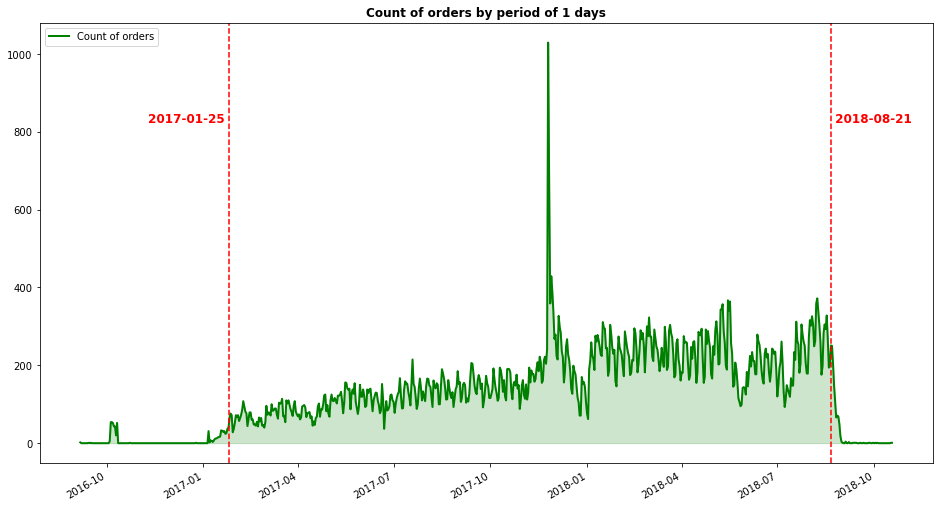

In [1]:
from datetime import datetime
from olist_commons import (
    get_first_order_date,
    get_last_order_date,
    get_time_slices_dict,
    show_orders_by_period 
)

step_in_days = 1
earliest_relevant_date = datetime(2017, 1, 25)
latest_relevant_date = datetime(2018, 8, 21)

# Time, orders and customers indexes slicing
slices_dict = get_time_slices_dict(
    get_first_order_date(),
    get_last_order_date(),
    step_in_days
)

# Show business activity
show_orders_by_period(
    slices_dict, step_in_days,
    earliest_relevant_date,
    latest_relevant_date
)

### Intermediate-grained overview

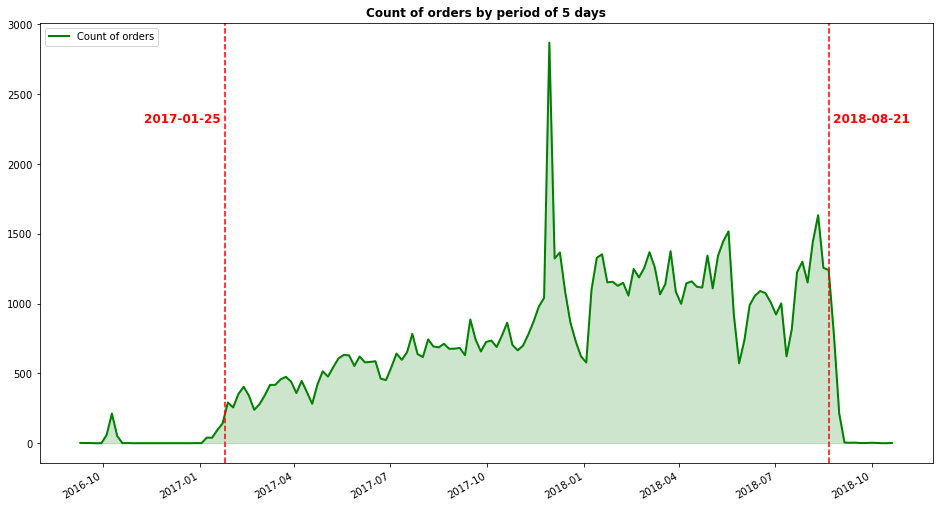

In [2]:
step_in_days = 5

# Time, orders and customers indexes slicing
slices_dict = get_time_slices_dict(
    get_first_order_date(),
    get_last_order_date(),
    step_in_days
)

# Show business activity
show_orders_by_period(
    slices_dict, step_in_days,
    earliest_relevant_date,
    latest_relevant_date
)

### Coarse-grained overview

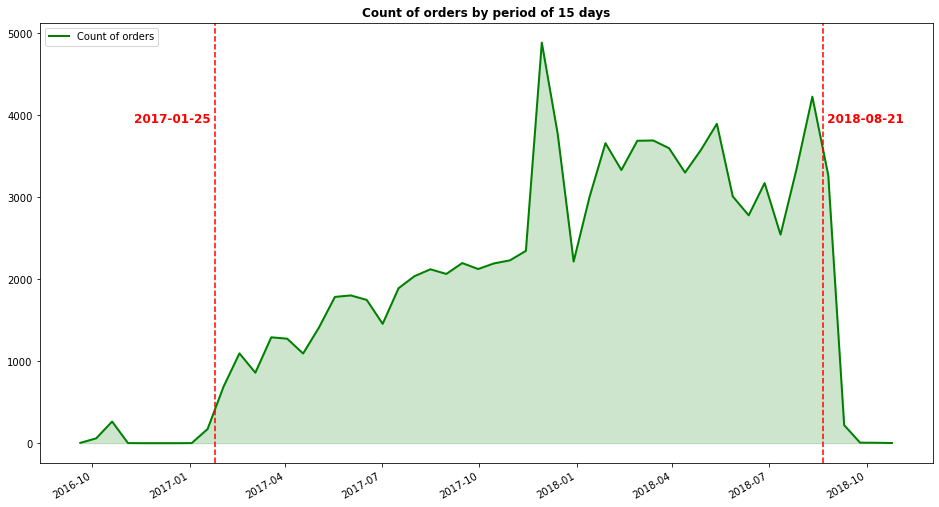

In [3]:
step_in_days = 15

# Time, orders and customers indexes slicing
slices_dict = get_time_slices_dict(
    get_first_order_date(),
    get_last_order_date(),
    step_in_days
)

# Show business activity
show_orders_by_period(
    slices_dict, step_in_days,
    earliest_relevant_date,
    latest_relevant_date
)

### $F_i$ = Customer RFM($T_i$)

In [8]:
from datetime import datetime
from olist_commons import (
    get_time_slices_dict,
    get_customer_RFM,
    kmeans_analysis_v2
)


def machin(from_date, to_date, step_in_days, normalize=False, cumul=False):
    # Time, orders and customers indexes slicing
    slices_dict = get_time_slices_dict(from_date, to_date, step_in_days, cumul)

    print('# slices:', len(slices_dict))
    for k, (end_date, time_slice) in enumerate(slices_dict.items()):
        print(f'SLICE {k} :')
        start_date = time_slice['start_date']
        customers_index = time_slice['customers_index']
        orders_index = time_slice['orders_index']
        n_customers = time_slice['# customers']
        n_orders = time_slice['# orders']
        print('start date:', start_date)
        print('end date:', end_date)
        print('# customers:', n_customers)
        print('# orders:', n_orders)
        crfm = None
        if n_customers * n_orders > 0:
            crfm = get_customer_RFM(
                relative_to_date=end_date,
                customers_index=customers_index,
                orders_index=orders_index,
                from_date=start_date,
                to_date=end_date
            )
            _ = kmeans_analysis_v2(crfm, 5, normalize)
        display(crfm)
        # if k > 5:
        #    break

#### Sans accumulation et sans normalisation

# slices: 39
SLICE 0 :
start date: 2017-01-25 00:00:00
end date: 2017-02-09 00:00:00
# customers: 1014
# orders: 1034


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


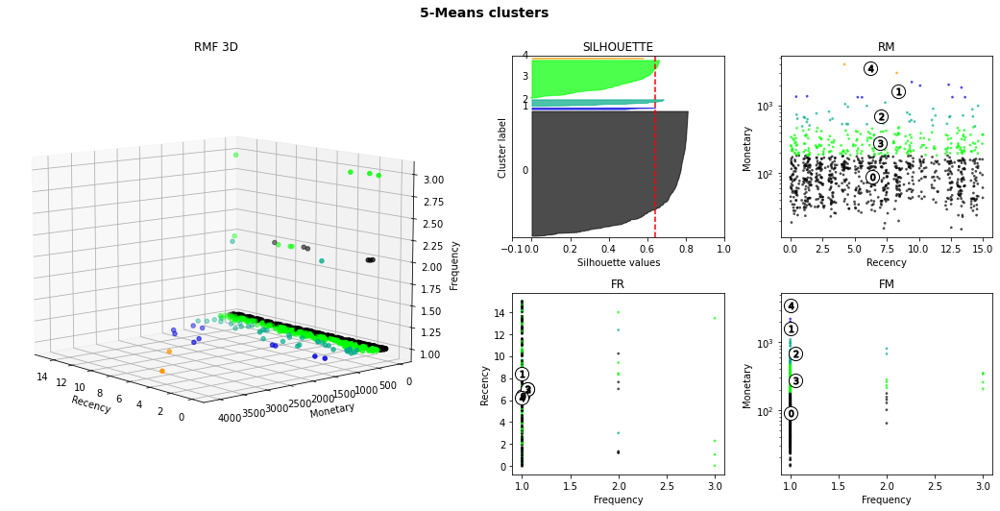

silhouette average : 0.64
k-means fit time : 1.24
silouhette compute time : 0.097


,R,F,M
customer_id,,,
002b4cd83fabaffaa475f78ea5ef3e08,7.421343,1,64.42
0071f46a072a9ae25bbe4438b15efe9c,7.997025,1,174.54
008f3d5f45a11059239a5c452cd00006,13.616933,1,336.56
012e12f54f6e73b1faba89a119dab849,10.196053,1,105.74
0284ca4015977edc8413c917b8e68355,1.619942,1,66.73
...,...,...,...
fe810d4870b11964c5d0ae1817aaa97b,14.154479,1,210.08
fec0f9b88ab21b6b9bd1961500e83665,12.941412,1,239.64
fee302f7605a1022d1a885fa5e2cad6e,5.595602,1,262.26


SLICE 1 :
start date: 2017-02-09 00:00:00
end date: 2017-02-24 00:00:00
# customers: 881
# orders: 893


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


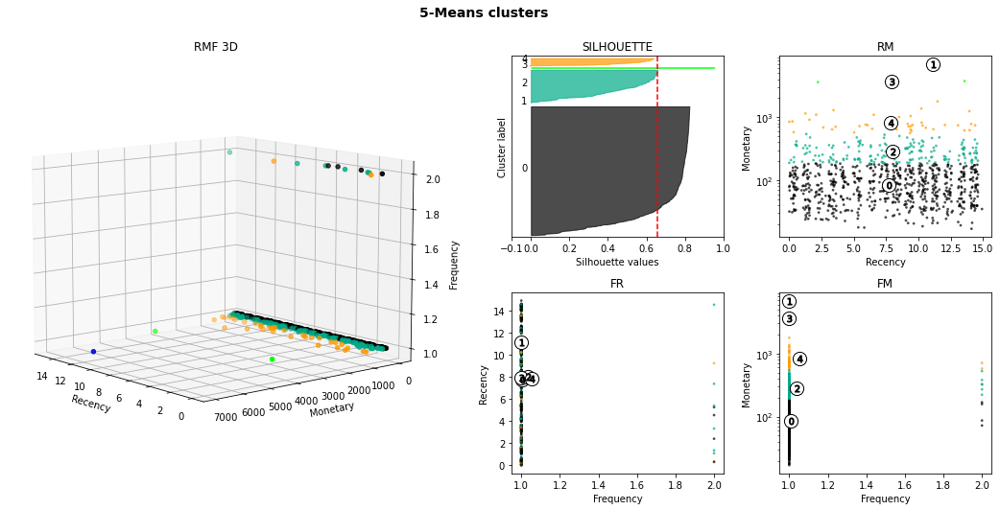

silhouette average : 0.656
k-means fit time : 1.538
silouhette compute time : 0.134


,R,F,M
customer_id,,,
0087eede471173af78d789df249c3a45,7.158299,1,151.11
012b8001e47392df808a454083a74b74,13.581863,1,98.84
01469c41b00bb21cd01d2104b8e81384,12.226759,1,111.01
016feebfaba953a2456d3a063b8eb8ef,10.492373,1,62.83
019d47513bb1164cc83fc2d6d7123ef8,13.098889,1,208.16
...,...,...,...
fe97a20a987dd0adc99328b52be73c4c,11.140729,1,22.86
ff28720521c749234b1ba19c9c986f4c,8.524144,1,192.96
ff3bcc94d97e257e7619a2161375cdfe,14.410880,1,84.16


SLICE 2 :
start date: 2017-02-24 00:00:00
end date: 2017-03-11 00:00:00
# customers: 1082
# orders: 1097


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


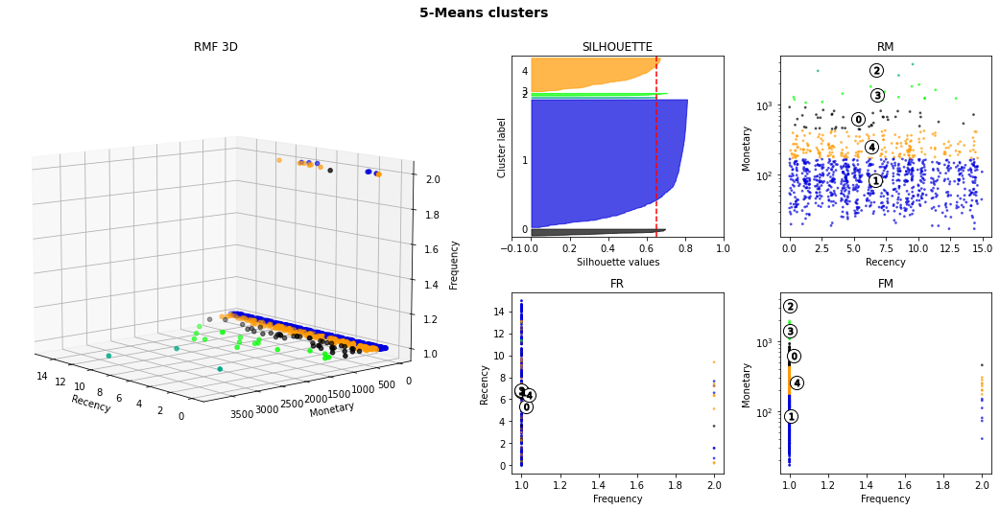

silhouette average : 0.648
k-means fit time : 1.209
silouhette compute time : 0.095


,R,F,M
customer_id,,,
0000f46a3911fa3c0805444483337064,0.121493,1,86.22
0005e1862207bf6ccc02e4228effd9a0,6.019306,1,150.12
00446a03d7a34d191507c9e42870d0a5,4.160567,1,128.95
0049db44bfd6cee26ac9c649329ff6ea,3.438252,1,109.04
0055b522bc89cbfbf376d8b59a628470,7.341007,1,364.75
...,...,...,...
fef01b6698bae7394677113b5e647eda,1.273310,1,65.10
ff4050535c1351cd0b834ccf1c9d07f1,8.688472,1,33.10
ff9bc66daa6702543b16f3c4897e300b,4.452488,1,97.99


SLICE 3 :
start date: 2017-03-11 00:00:00
end date: 2017-03-26 00:00:00
# customers: 1322
# orders: 1340


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


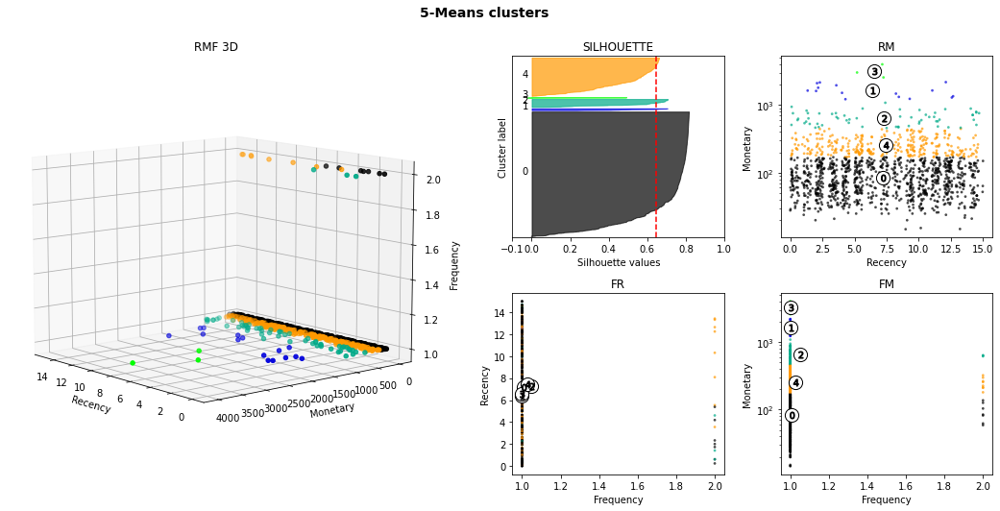

silhouette average : 0.644
k-means fit time : 1.272
silouhette compute time : 0.163


,R,F,M
customer_id,,,
001f3c4211216384d5fe59b041ce1461,6.225972,1,35.84
003e28cb6fab8a0901bff9229612375f,12.378970,1,137.26
0096c18412349537abc45e350581cbbc,11.268426,1,770.24
00c003ed13c76042b78d53fbc26930d0,9.149190,1,204.24
00c3624c55261d9ce593f30e3815a880,7.524931,1,414.06
...,...,...,...
ff51a896842f2bdced342631e2699d49,14.653576,1,106.23
ff64dc057067aecad9bf2c94b272e90a,3.179306,1,181.56
ffa17ff63f95ea3c838670e61d2666e0,12.350799,1,84.16


SLICE 4 :
start date: 2017-03-26 00:00:00
end date: 2017-04-10 00:00:00
# customers: 1195
# orders: 1215


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


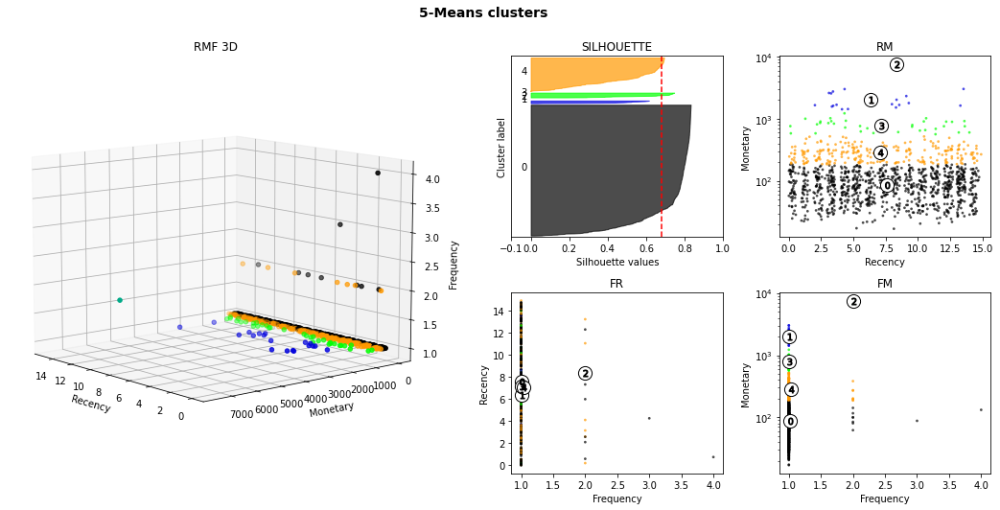

silhouette average : 0.682
k-means fit time : 1.281
silouhette compute time : 0.131


,R,F,M
customer_id,,,
002043098f10ba39a4600b6c52fbfe3c,14.301400,1,237.81
0037d2bbb9ebc39d9114aea27ee16d72,13.483009,1,143.73
00522457bba00bba576a34fd9b4808fd,8.430417,1,127.98
00842c7d0cedb9e1edad8e9b7d148f09,4.106296,1,64.55
00941614a654458b888b8780815bd26c,11.561424,1,185.83
...,...,...,...
ff7014eeb94589da99e822e2618090fa,8.431678,1,72.71
ff8d27e48d6492ebb97e3052142c47bf,1.119896,1,295.00
ff959aedd362b48bb97c0abeb0b36b62,11.389225,1,91.66


SLICE 5 :
start date: 2017-04-10 00:00:00
end date: 2017-04-25 00:00:00
# customers: 1117
# orders: 1129


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


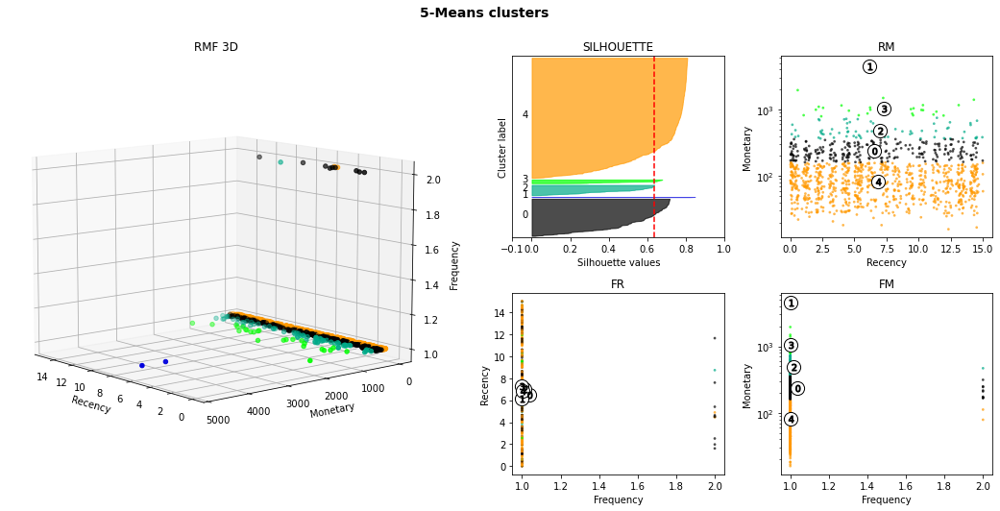

silhouette average : 0.637
k-means fit time : 1.319
silouhette compute time : 0.206


,R,F,M
customer_id,,,
0011805441c0d1b68b48002f1d005526,0.432778,1,297.14
00191a9719ef48ebb5860b130347bf33,5.519340,1,58.86
0043d65f8039b4a4d43bc7b0f450ac2c,4.460255,1,64.42
007953b3182d5ccc9189a694f5c68163,9.083090,1,112.08
0098f4847541cc7d676f9a5efc64c0f0,7.217998,1,147.55
...,...,...,...
fe7780b2659c715218834f592a838f6a,11.999456,1,99.62
ff253dd048167b1feddeb431db05d3d5,0.642118,1,126.81
ff580ab4901e3619925a27db44eec095,13.468681,1,66.62


SLICE 6 :
start date: 2017-04-25 00:00:00
end date: 2017-05-10 00:00:00
# customers: 1577
# orders: 1596


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


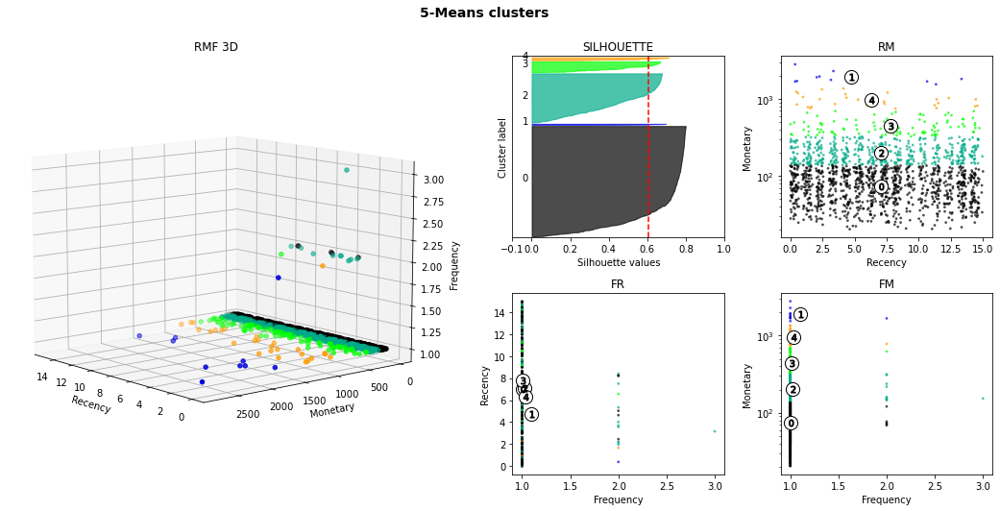

silhouette average : 0.607
k-means fit time : 1.241
silouhette compute time : 0.21


,R,F,M
customer_id,,,
00ac9cd5c4ad19e16e7c6f6864711737,11.402697,1,231.45
011509f63f565e822767bfb89c3cf9b7,0.376100,1,69.07
011fd4914a2d19b2a0e50c29cea5c6a2,3.126076,1,261.90
0139884762afa50d78fe480646fe92b5,6.646713,1,70.79
015557c9912277312b9073947804a7ba,8.382951,1,72.90
...,...,...,...
ff6eae41d4cbdc5af3844a39a89431e6,12.991053,1,143.48
ff86fefe11696b1e957173516339bcd8,8.374271,1,21.95
ffaa5b5559566bb4dbf71d554310e760,4.300752,1,115.73


SLICE 7 :
start date: 2017-05-10 00:00:00
end date: 2017-05-25 00:00:00
# customers: 1855
# orders: 1897


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


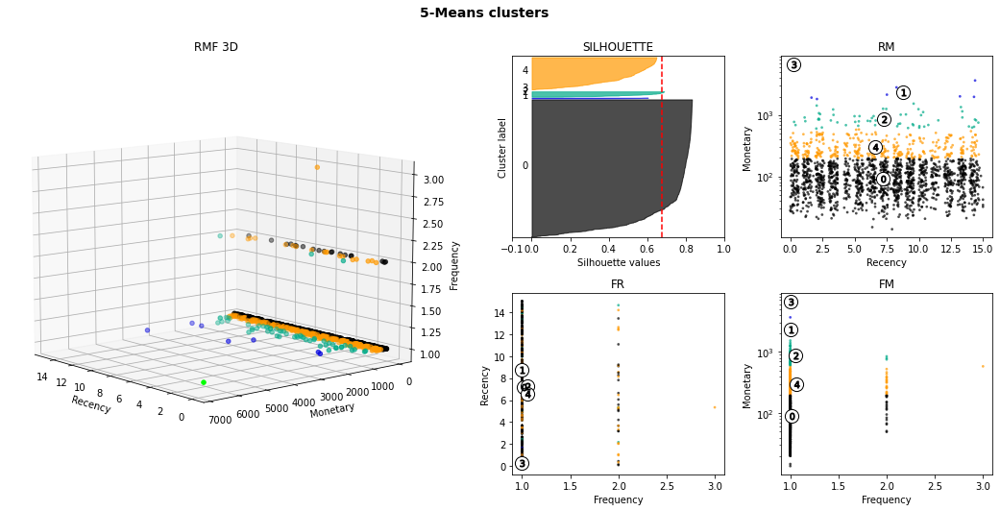

silhouette average : 0.675
k-means fit time : 1.2
silouhette compute time : 0.232


,R,F,M
customer_id,,,
002d71b244beb91ca7030b15ab526446,2.066076,1,130.56
0036a074f98b80c4f1fc33dbbcf9c552,12.608032,1,42.62
00dd4390a8e8ad7a126e8331decc49ce,13.615775,1,109.31
016846e2dd862cba9a2a10eff5ac244f,12.351366,1,474.96
0178b244a5c281fb2ade54038dd4b161,14.163785,1,102.03
...,...,...,...
ff5017601705e932d5545e0eb337cd0b,11.239711,1,158.20
ff70aa1b53f643263ead50eed3166164,7.488542,1,51.75
ff8892f7c26aa0446da53d01b18df463,0.326921,1,263.40


SLICE 8 :
start date: 2017-05-25 00:00:00
end date: 2017-06-09 00:00:00
# customers: 1726
# orders: 1752


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


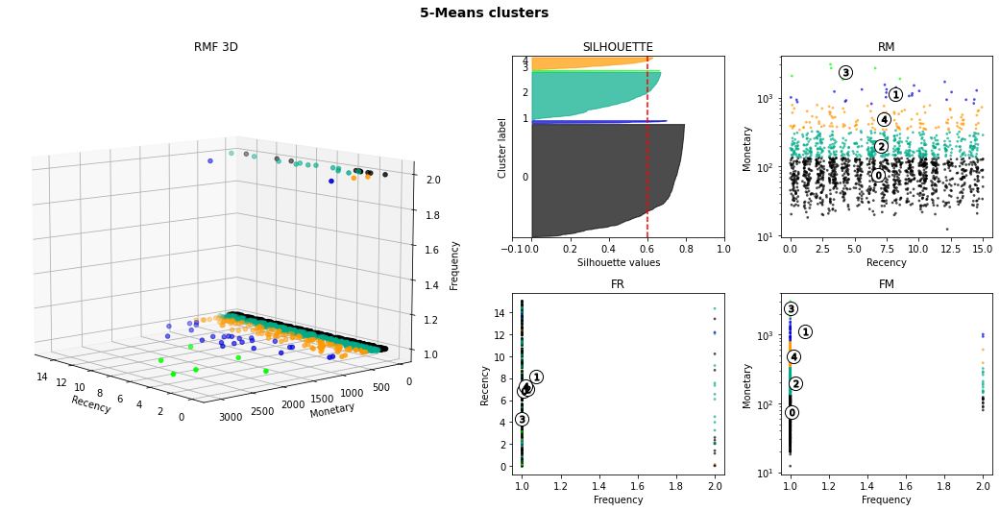

silhouette average : 0.601
k-means fit time : 1.23
silouhette compute time : 0.208


,R,F,M
customer_id,,,
008fb2ecc75561d202dd4db2e0ceec25,8.054109,1,40.77
0103751df12aea8b962cfbcd2b61104c,13.021447,1,35.00
01051cf3719a23faec8b2307b369faeb,12.126123,1,147.96
0189955e61056a22dd6e7cb03603a149,0.008229,1,111.81
0189cca3aa2a0f75ca0cde94ee38be57,3.102326,1,100.33
...,...,...,...
ff4136190ebc2a5c0bff70b569fe9180,3.520775,1,51.75
ffd44de1326179fff550dae07c6884c2,10.262755,1,121.50
ffe4c3aa14d4702fb11fe5b3c4dd755c,14.445312,1,137.30


SLICE 9 :
start date: 2017-06-09 00:00:00
end date: 2017-06-24 00:00:00
# customers: 1505
# orders: 1533


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


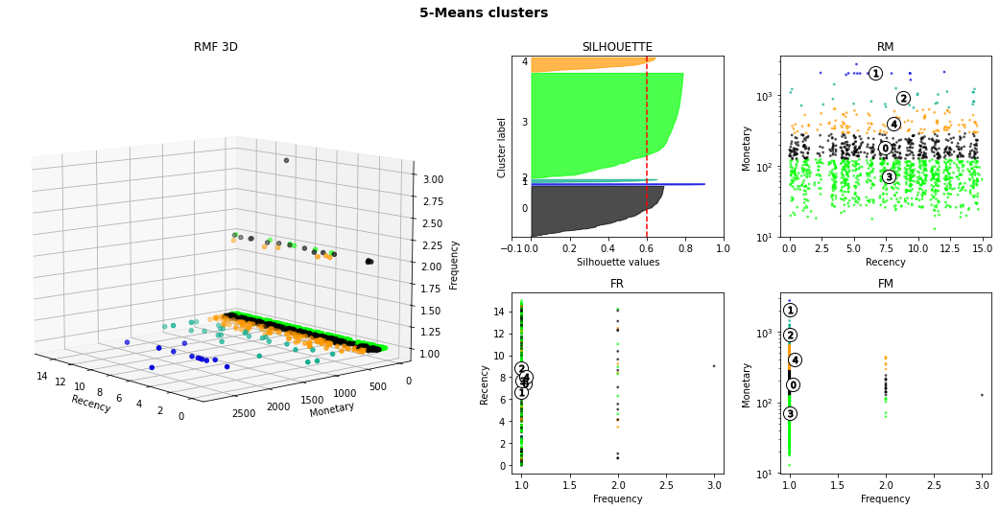

silhouette average : 0.6
k-means fit time : 1.348
silouhette compute time : 0.28


,R,F,M
customer_id,,,
00324c9f4d710e7bac5c5ba679714430,2.138449,1,109.78
00444f48f6c9b55657e49435ce3a97ca,14.322477,1,52.38
0049dadc30da6a277c1e9d371df5a66f,10.173623,1,26.01
0059acd36094bf670ec8b21be6c0044c,11.091285,1,46.69
009301957bc7714394865c44650d8060,0.516887,1,93.78
...,...,...,...
ff9e11d25bd3a13105fbf416eee813c5,10.167847,1,171.85
ffbb8dfaa0e54649d8690b85a3ef890d,4.544306,1,29.47
ffbf790cac0b6cf2e411d9f158c0fbe2,13.996331,1,134.83


SLICE 10 :
start date: 2017-06-24 00:00:00
end date: 2017-07-09 00:00:00
# customers: 1635
# orders: 1658


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


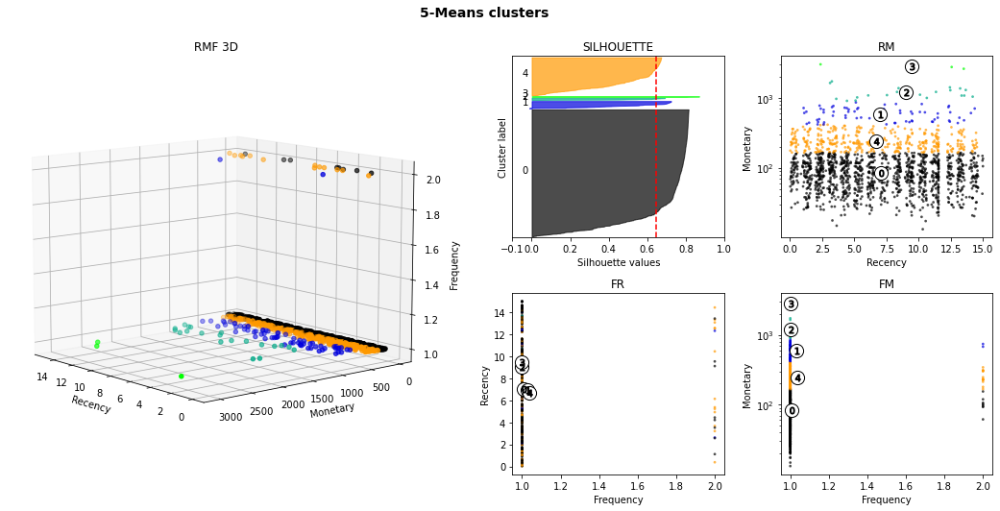

silhouette average : 0.647
k-means fit time : 1.318
silouhette compute time : 0.287


,R,F,M
customer_id,,,
0011857aff0e5871ce5eb429f21cdaf5,10.535671,1,192.83
001a2bf0e46c684031af91fb2bce149d,9.052905,1,36.73
00a6ee75a90222405df9d8d59babc513,2.045625,1,60.05
00cd767526517f8a4fc27db6cc5a52fa,11.532755,1,95.21
00d7e54ab8c5d9916f19209dbaacbb3d,7.577998,1,92.05
...,...,...,...
ff095a5f37e0c0199dfd3f2359ecf6b8,8.396331,1,104.19
ff423b634e7bbec16b9f1466f126eb18,4.694236,1,180.25
ff4aa52d77226e6f84a7da6391604266,10.173287,1,187.94


SLICE 11 :
start date: 2017-07-09 00:00:00
end date: 2017-07-24 00:00:00
# customers: 1980
# orders: 2016


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


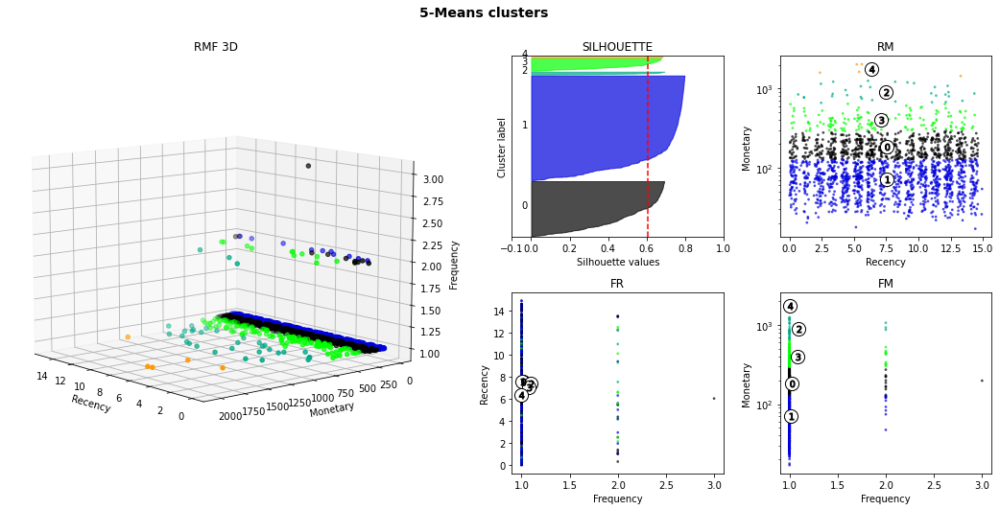

silhouette average : 0.608
k-means fit time : 1.516
silouhette compute time : 0.333


,R,F,M
customer_id,,,
0006fdc98a402fceb4eb0ee528f6a8d4,5.608912,1,29.00
0010a452c6d13139e50b57f19f52e04e,12.525891,1,325.93
002eb8b96288f3804e21d2777ac29895,1.441597,1,137.99
0037eb1ff742ee2e71ba887f65f3c6f3,10.624757,1,228.79
008778a1591d49f6b2464dffaa4fa662,4.178310,1,260.55
...,...,...,...
ff73dbd0440a0f1fac45e49efd6398b4,3.070359,1,27.77
ff84c3cbb72d9419e3f76a6029f6f07d,11.024329,1,341.33
ff983093f2d26e43569f7d58782faffb,5.295081,1,74.16


SLICE 12 :
start date: 2017-07-24 00:00:00
end date: 2017-08-08 00:00:00
# customers: 2030
# orders: 2068


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


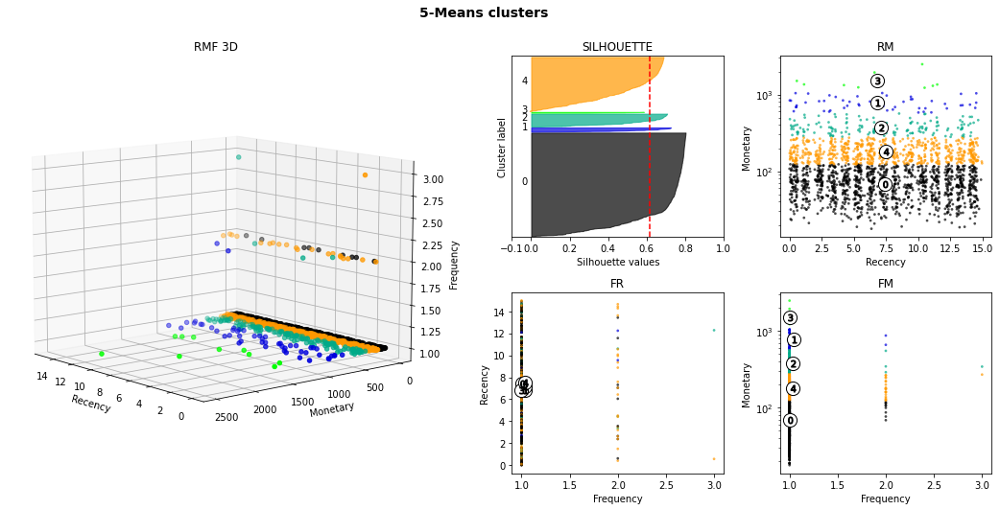

silhouette average : 0.614
k-means fit time : 1.286
silouhette compute time : 0.371


,R,F,M
customer_id,,,
0011c98589159d6149979563c504cb21,2.410567,1,117.94
004288347e5e88a27ded2bb23747066c,11.407604,1,251.09
0046311f458d8041b00063cb99482903,6.191308,1,112.33
004ed862ea4e55f18868d3d782d10879,1.142940,1,109.29
006d763076d74d16d66e828e79ec1544,2.567442,1,99.32
...,...,...,...
ff95640b1b541ba71eaa077fd1853ca0,3.549398,1,61.75
ff9c5dff16d7d6bfefc2acf5088d7b90,2.567384,1,73.34
ffcdafd7d9f69caf44c3aa1ff78c32b4,10.265937,1,89.57


SLICE 13 :
start date: 2017-08-08 00:00:00
end date: 2017-08-23 00:00:00
# customers: 2103
# orders: 2141


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


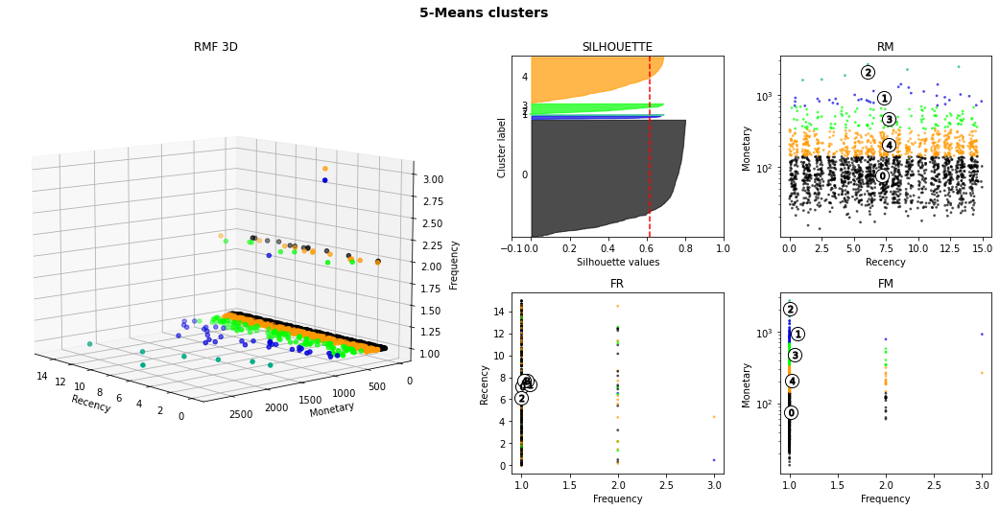

silhouette average : 0.614
k-means fit time : 1.305
silouhette compute time : 0.42


,R,F,M
customer_id,,,
000a5ad9c4601d2bbdd9ed765d5213b3,11.426910,1,91.28
000de6019bb59f34c099a907c151d855,5.201007,1,257.44
001926cef41060fae572e2e7b30bd2a4,5.461262,1,91.21
0036b4a3d09ad551a5188c2e374da402,13.323044,1,162.77
00765d375af0e700f61c57db00a8ee63,12.295567,1,215.01
...,...,...,...
ffc04aafbf624bd130516cc1d195626a,10.282593,1,17.78
ffc142edc6bce329c6df0006387a5a77,0.213021,1,26.68
ffc9d8a98ebd09a78c8adb729c3cfa2a,8.034016,1,77.57


SLICE 14 :
start date: 2017-08-23 00:00:00
end date: 2017-09-07 00:00:00
# customers: 1997
# orders: 2031


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


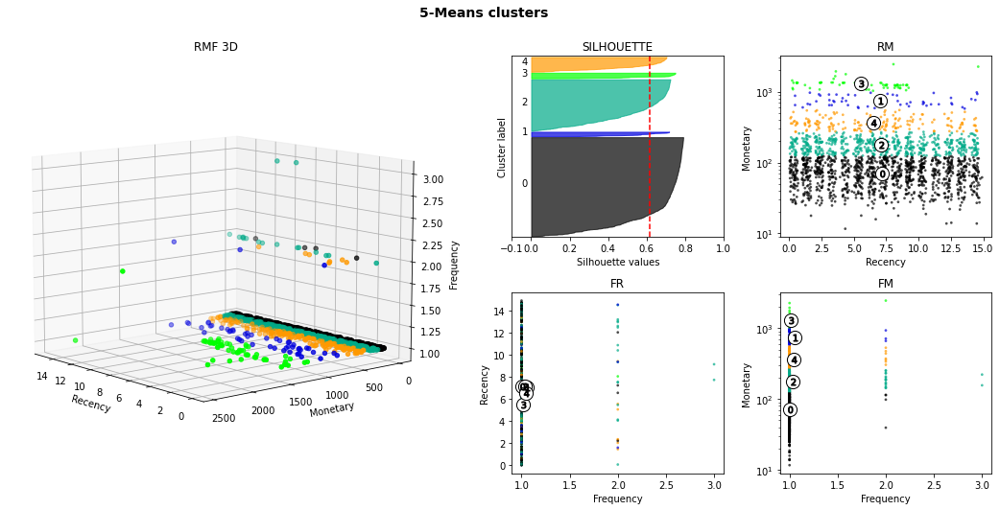

silhouette average : 0.616
k-means fit time : 1.188
silouhette compute time : 0.304


,R,F,M
customer_id,,,
001147e649a7b1afd577e873841632dd,6.282685,1,212.16
003035f5ec76f2220098377482de93c9,9.100602,1,62.47
0047f3e16441284d757a8963344f6c59,9.562639,1,76.18
004b45ec5c64187465168251cd1c9c2f,5.492095,1,97.87
005e32bc930906dc6b65fb9d11cce3e2,3.091227,1,49.60
...,...,...,...
ff9d2f60401262b9da1e868f956fb2a8,8.198113,1,411.63
ffcf1dc25f2222aea1aef48841f20f3a,0.634062,1,104.37
ffdcd85e0e81fc93f49bef4d54a4e61f,8.551146,1,77.57


SLICE 15 :
start date: 2017-09-07 00:00:00
end date: 2017-09-22 00:00:00
# customers: 2236
# orders: 2271


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


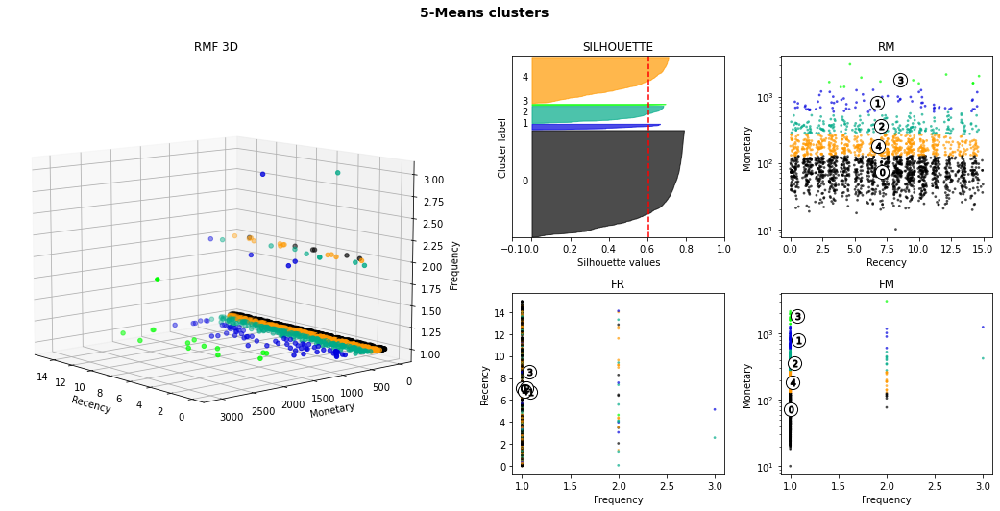

silhouette average : 0.607
k-means fit time : 1.226
silouhette compute time : 0.366


,R,F,M
customer_id,,,
005ff4ebe100db3eebbe6f7b19a8f99a,8.367812,1,236.81
00776f3807b128beca64cd0b27138d92,0.204259,1,321.57
009062f98089a091615b5c9faa13de26,9.046204,1,30.27
00970787f181925ba33bd32b3817f742,5.936840,1,35.40
00ae9ea276a5a4335382c9391059ddf2,8.653461,1,140.00
...,...,...,...
ff48228323a1d52f3b3108316bdc4314,14.029120,1,132.03
ff922bdd6bafcdf99cb90d7f39cea5b3,7.399954,1,42.58
ffa652b0cdf8bba29664149a9e579134,10.043414,1,98.70


SLICE 16 :
start date: 2017-09-22 00:00:00
end date: 2017-10-07 00:00:00
# customers: 2050
# orders: 2076


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


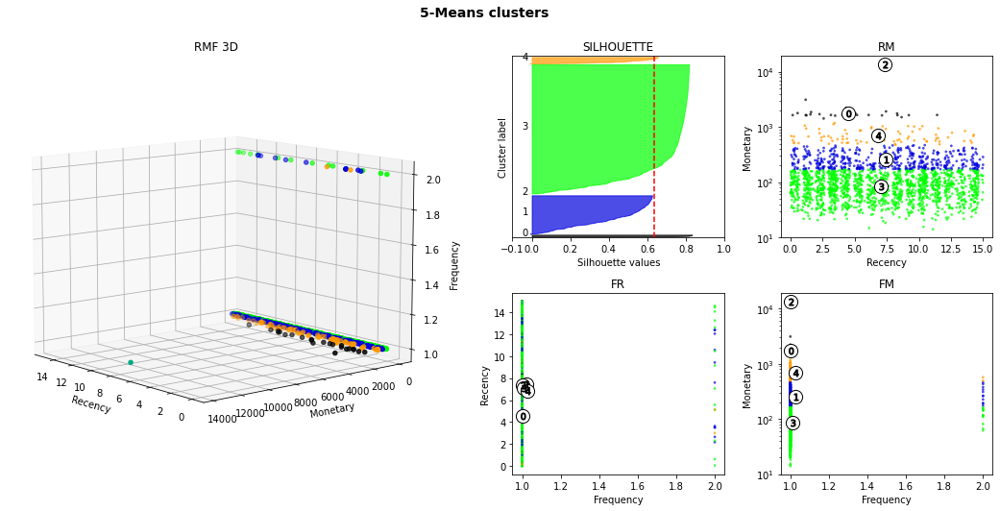

silhouette average : 0.635
k-means fit time : 1.256
silouhette compute time : 0.364


,R,F,M
customer_id,,,
000bfa1d2f1a41876493be685390d6d3,7.384051,1,46.85
004ad212c650c96c8a48f30855a7bcb8,12.551968,1,25.90
005ee3e015ec18092d7782e507cf68fe,5.584826,1,187.96
007ad549acb91673f04eac22c0568114,10.386956,1,90.85
00e5ea6932dffb682bd3d5760e84d176,10.319722,1,68.89
...,...,...,...
ff1e14670fe58a60d27e35069844b3d8,7.378009,1,179.38
ff44084bf8313fa8eae5ce6e43e341ed,2.175613,1,271.08
ff755148365a0062374c353946b68aa3,10.535671,1,206.87


SLICE 17 :
start date: 2017-10-07 00:00:00
end date: 2017-10-22 00:00:00
# customers: 2261
# orders: 2290


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


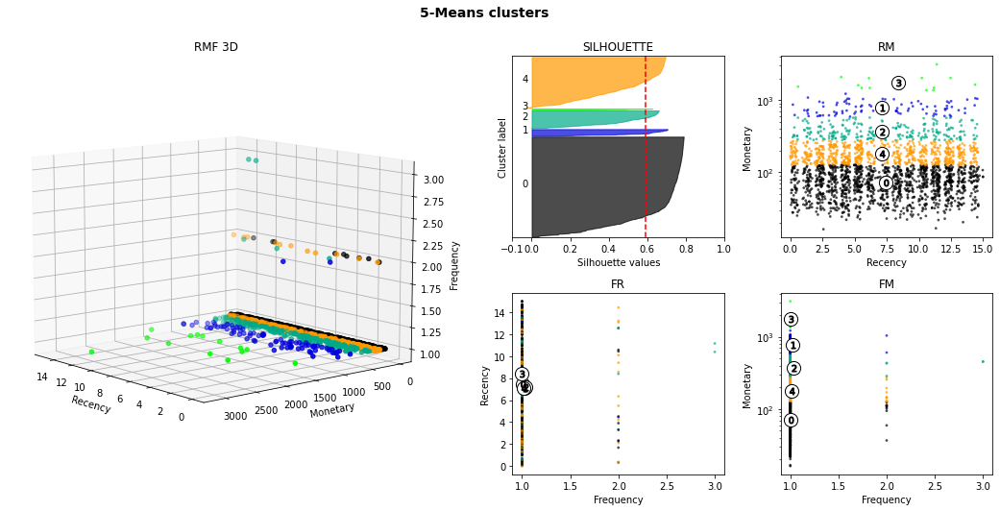

silhouette average : 0.591
k-means fit time : 1.314
silouhette compute time : 0.39


,R,F,M
customer_id,,,
0000f6ccb0745a6a4b88665a16c9f078,9.146053,1,43.62
0012929d977a8d7280bb277c1e5f589d,4.342639,1,155.65
002ae492472e45ad6ebeb7a625409392,13.002755,1,218.66
004177f7bf62929186b32c7fdaa6157b,2.328345,1,433.98
0065f6fb341f013a95a8e11cdc98d07a,12.381574,1,119.32
...,...,...,...
fedd4c0ac17d47475d8178c97f1724fb,1.519549,1,54.78
ff28d873d960260278acba659ac5752d,7.031447,1,56.05
ff36fa1d315d885d3c5171ea09996142,8.135185,1,64.00


SLICE 18 :
start date: 2017-10-22 00:00:00
end date: 2017-11-06 00:00:00
# customers: 2042
# orders: 2078


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


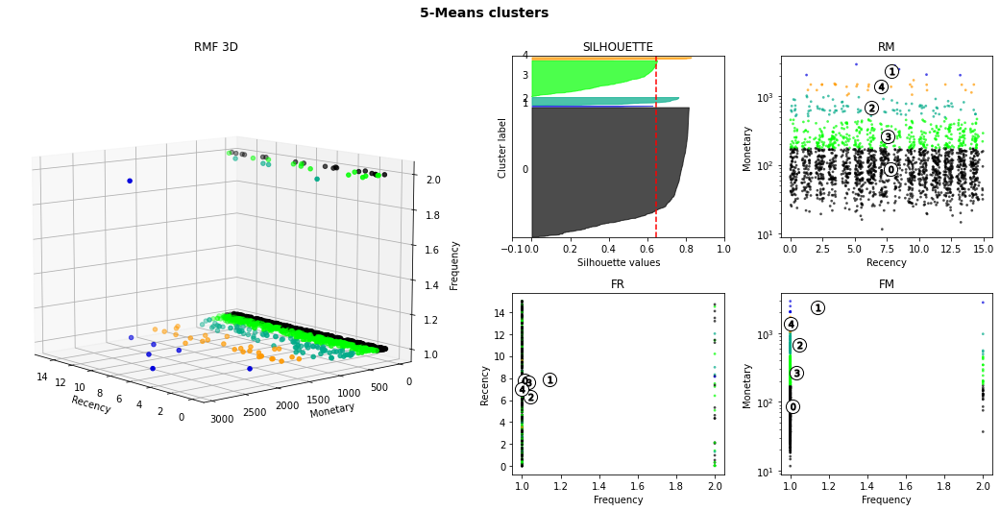

silhouette average : 0.644
k-means fit time : 1.569
silouhette compute time : 0.422


,R,F,M
customer_id,,,
00293787e2aec37a9c253b63fdfe2049,9.398900,1,257.87
0029bd580d3012618731f5abb174a07f,3.441424,1,52.38
002cdf87d4c03f08f7eb4551a923affc,5.269190,1,228.67
002feefec5af0a3b26ee7839c66d205e,7.486215,1,77.57
00575b2023dedcc0f3e81a938834689b,1.149398,1,32.38
...,...,...,...
ff66d86dd60a80525875a584d0f5d399,4.477975,1,125.29
ff6d4669ac6694f4ad278d23c4c7caa5,10.633194,1,148.97
ffba2b15e7a4608fd6ae9aa92f610dc5,7.210521,1,35.00


SLICE 19 :
start date: 2017-11-06 00:00:00
end date: 2017-11-21 00:00:00
# customers: 2733
# orders: 2760


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=11.
  warnings.warn(


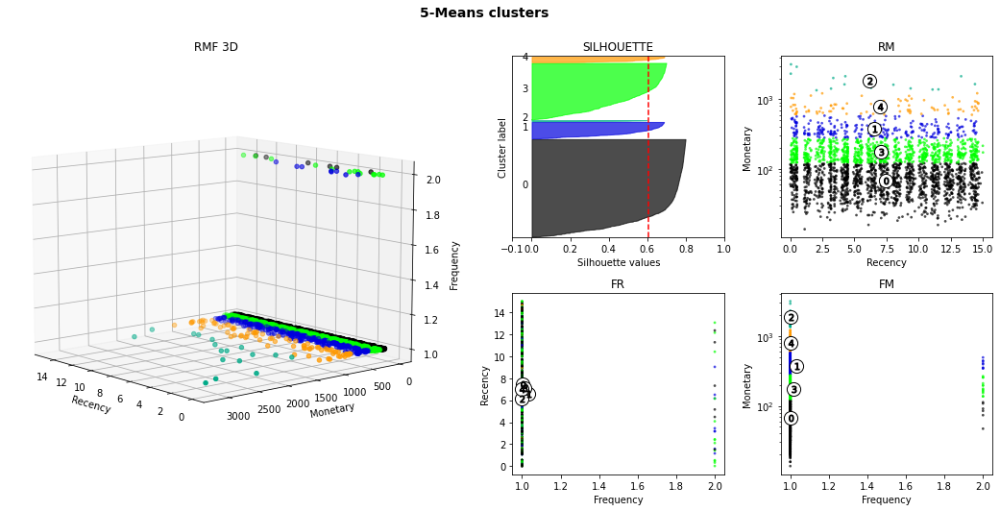

silhouette average : 0.604
k-means fit time : 1.571
silouhette compute time : 0.657


,R,F,M
customer_id,,,
0004aac84e0df4da2b147fca70cf8255,6.176597,1,196.89
00082cbe03e478190aadbea78542e933,1.359699,1,126.26
001ae44fa04911a9e9577356dce6c63c,14.266794,1,116.23
003f4901fdb60ae9c1e2538b84c208e1,1.150845,1,162.79
009a0802534f904b40b9d512b49794e1,4.389873,1,91.29
...,...,...,...
ff7b8116de7a8a5f5c8abbae6399608b,4.191956,1,161.29
ff7c033bfd33a1af06ac30c07492a859,1.339618,1,112.41
ff913fbe58ff8a761c3b01f4c718fc85,0.466840,1,272.50


SLICE 20 :
start date: 2017-11-21 00:00:00
end date: 2017-12-06 00:00:00
# customers: 5413
# orders: 5495


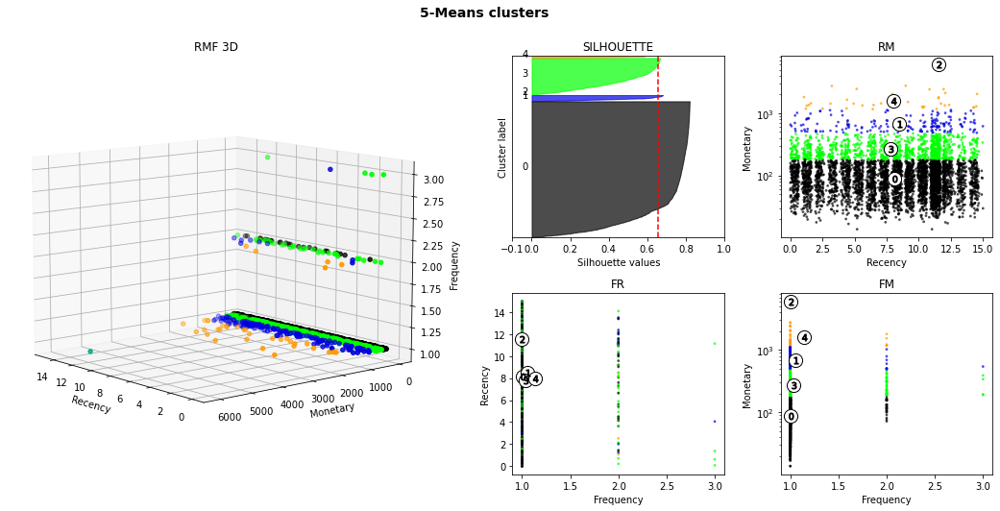

silhouette average : 0.654
k-means fit time : 1.73
silouhette compute time : 1.922


,R,F,M
customer_id,,,
002bdeb33da5b1b3ce8b9c822f749c82,0.205069,1,38.09
00377a18050b898b93e2c774be9947db,10.430498,1,65.78
003d56767e53e08671de00da3fba8d40,4.466424,1,178.59
0042dcca0ae57aaec6e808edc31a2d48,3.498218,1,85.04
00543330561a9088f8b3879114a7b008,11.373507,1,73.96
...,...,...,...
ffbb6557e45f7158781514f0efddb0d5,11.966574,1,128.96
ffc741a42034ec5c25be020c656950eb,6.216609,1,162.45
ffd973d43cadfa3e60340bcad8d87696,9.109606,1,125.52


SLICE 21 :
start date: 2017-12-06 00:00:00
end date: 2017-12-21 00:00:00
# customers: 2992
# orders: 3030


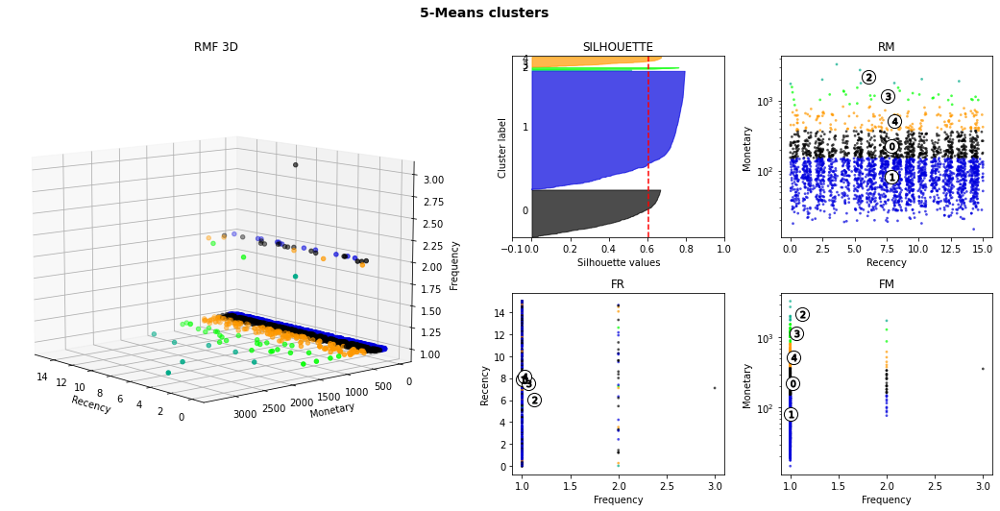

silhouette average : 0.607
k-means fit time : 1.507
silouhette compute time : 0.754


,R,F,M
customer_id,,,
000c8bdb58a29e7115cfc257230fb21b,8.046123,1,29.00
001ae5a1788703d64536c30362503e49,12.518935,1,135.08
0028a7d8db7b0247652509358ad8d755,7.340521,1,354.87
004a432489f6630c6dfd3fc4454603f5,4.607523,1,84.01
006e937bd5a5e32043018a6d1521b5d5,10.165035,1,199.79
...,...,...,...
ff94fd009b5a961313d7b3f2a1536c59,6.407234,1,130.57
ffdde6e4dcb6ec3a882cfc6cddef7996,10.449028,1,796.94
ffdf72e25c6f0503bb567d0a8cf1c159,11.401273,1,170.37


SLICE 22 :
start date: 2017-12-21 00:00:00
end date: 2018-01-05 00:00:00
# customers: 2048
# orders: 2060


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


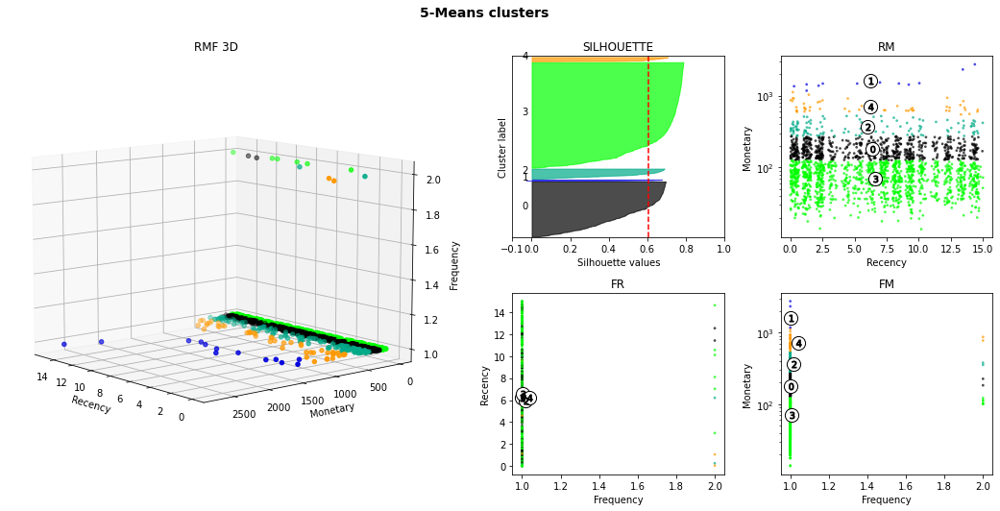

silhouette average : 0.604
k-means fit time : 1.86
silouhette compute time : 0.411


,R,F,M
customer_id,,,
0049a16516d38fc2246696172a257f16,6.538634,1,32.77
0078bb0f0d23e922d08437b7d0e13907,14.002153,1,44.09
007d9f716ead2bc8712255271a38f609,3.356053,1,67.57
00986cafefb6e670cceca01694bda599,4.253391,1,66.91
00a1c6913daeda0b7f9b79f802805fdb,8.497454,1,101.34
...,...,...,...
ffa8a7cd286a3431406fcb483d63df92,4.238981,1,49.10
ffac330ca7f9bff857210af3a40b08d8,13.407928,1,97.92
ffc14413ed1273340b518ad0bc63c862,9.304225,1,51.84


SLICE 23 :
start date: 2018-01-05 00:00:00
end date: 2018-01-20 00:00:00
# customers: 3739
# orders: 3774


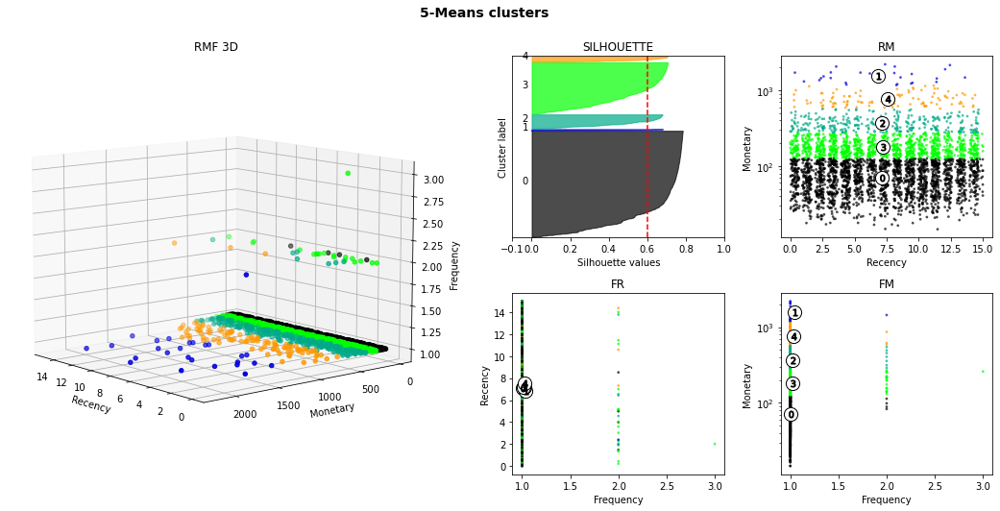

silhouette average : 0.6
k-means fit time : 1.787
silouhette compute time : 1.043


,R,F,M
customer_id,,,
000d460961d6dbfa3ec6c9f5805769e1,12.042072,1,36.68
0014a5a58da615f7b01a4f5e194bf5ea,1.132222,1,99.82
0028cfeb9dfcd3628a56d5b6400deef5,12.991146,1,118.20
002d3bd901608f67c3fc11eaaa842b13,4.222500,1,28.76
003650b504826ea534e02eba0ab58dd5,2.497905,1,21.77
...,...,...,...
ffbd1090fa1840d6cf9106fb238089e9,11.334491,1,81.76
ffbe02226141ca45932dddadda83f9bd,0.450856,1,51.75
ffcda3a0829ba6d3a02cd280e29b19a6,13.246817,1,111.40


SLICE 24 :
start date: 2018-01-20 00:00:00
end date: 2018-02-04 00:00:00
# customers: 3321
# orders: 3371


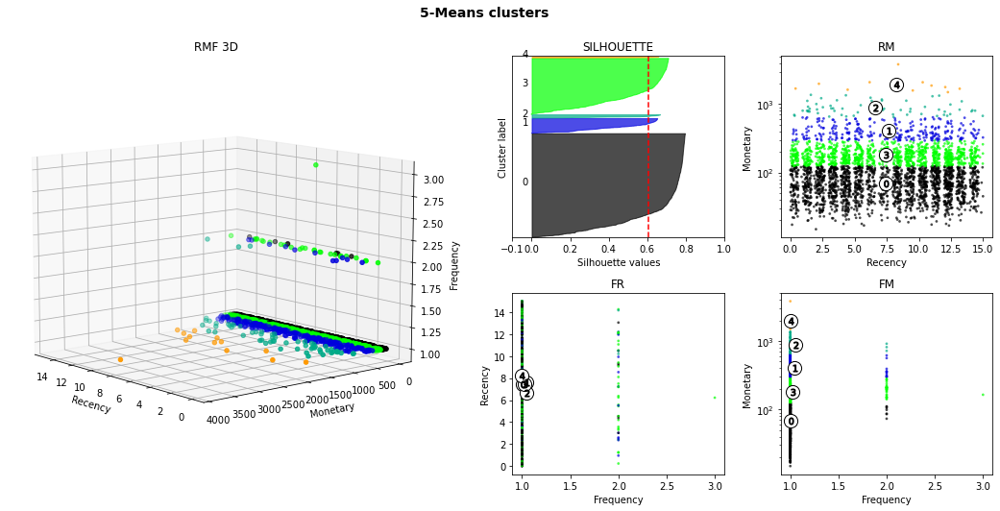

silhouette average : 0.606
k-means fit time : 1.732
silouhette compute time : 0.72


,R,F,M
customer_id,,,
002ed12115742033f015cb3c269ccf68,4.423299,1,109.79
0036d365b138cc0ee06bed755bcb5044,3.388194,1,109.50
00370dfde3d012c420d29657afc2fc8b,5.462060,1,237.00
0037aa56b017c105c3a9d47af71fff98,8.296574,1,443.73
007a2fab7046647dad04fe7d08c57820,0.137778,1,126.48
...,...,...,...
ff6a749412048de53e487708e585a0e4,12.262245,1,57.77
ff6de6cae279ba3f49b5d779351a9a1e,6.587720,1,107.50
ff93b5e71bd5be1bbf74ac93c52adcf2,11.517488,1,359.18


SLICE 25 :
start date: 2018-02-04 00:00:00
end date: 2018-02-19 00:00:00
# customers: 3352
# orders: 3425


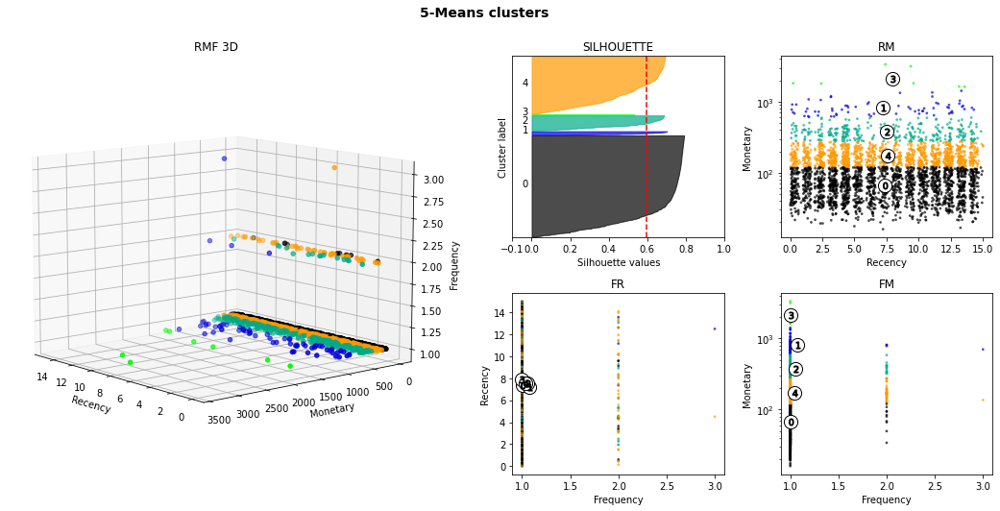

silhouette average : 0.598
k-means fit time : 1.663
silouhette compute time : 0.868


,R,F,M
customer_id,,,
0019da6aa6bcb27cc32f1249bd12da05,7.961458,1,87.71
002ef00822613c94613e60e03b169fef,4.127384,1,114.04
004d17fa2cb102a7c4817f040c884e59,5.696296,1,39.78
0055bbb9c95f6acb8db89d1f6c316407,4.595069,1,83.23
006bbb235068a01d2e3e47fa09ccf53c,3.206725,1,34.00
...,...,...,...
ffab104b9ba797387c58820356eb7551,13.610069,1,234.56
ffb03435e357d6c137b5b24e34808df4,11.571979,1,138.89
ffb5431b49b42c9f3209f087e1bfdcfa,9.267419,1,77.19


SLICE 26 :
start date: 2018-02-19 00:00:00
end date: 2018-03-06 00:00:00
# customers: 3828
# orders: 3923


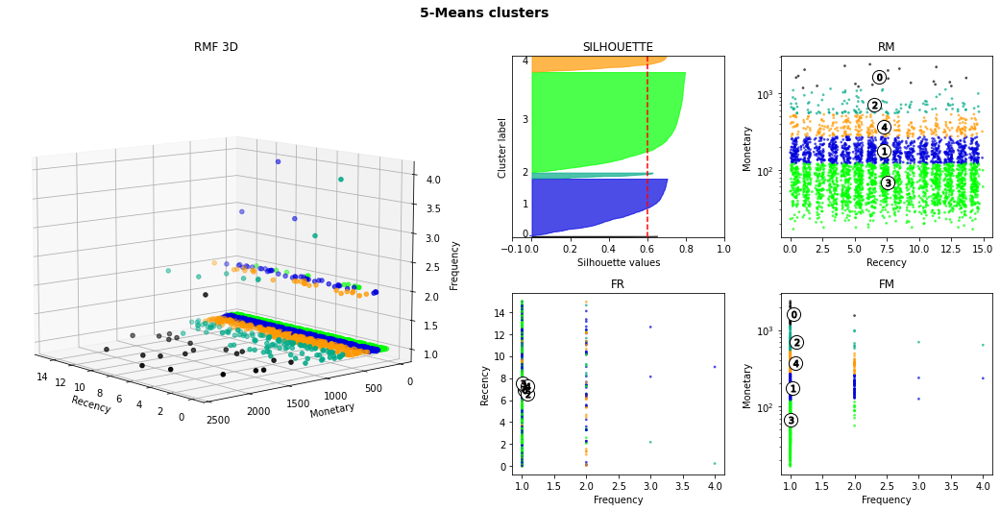

silhouette average : 0.6
k-means fit time : 1.513
silouhette compute time : 1.228


,R,F,M
customer_id,,,
00053a61a98854899e70ed204dd4bafe,5.530775,1,419.18
0010fb34b966d44409382af9e8fd5b77,0.285498,1,61.80
00196fdb2bf9edfc35e88ebfbcf8d781,11.203657,1,27.00
002aba8c1af80acacef6e011f9f23262,6.466806,1,217.74
0058f300f57d7b93c477a131a59b36c3,14.283634,1,79.56
...,...,...,...
ff7bd992a7aac2c563a3e3773a8c63aa,7.407882,1,30.00
ff8fd64c1a5f9bebebc9bf3985dac068,4.111898,1,109.10
ffa6acb325475c3f9816fa472652f1af,9.035359,1,190.88


SLICE 27 :
start date: 2018-03-06 00:00:00
end date: 2018-03-21 00:00:00
# customers: 3537
# orders: 3574


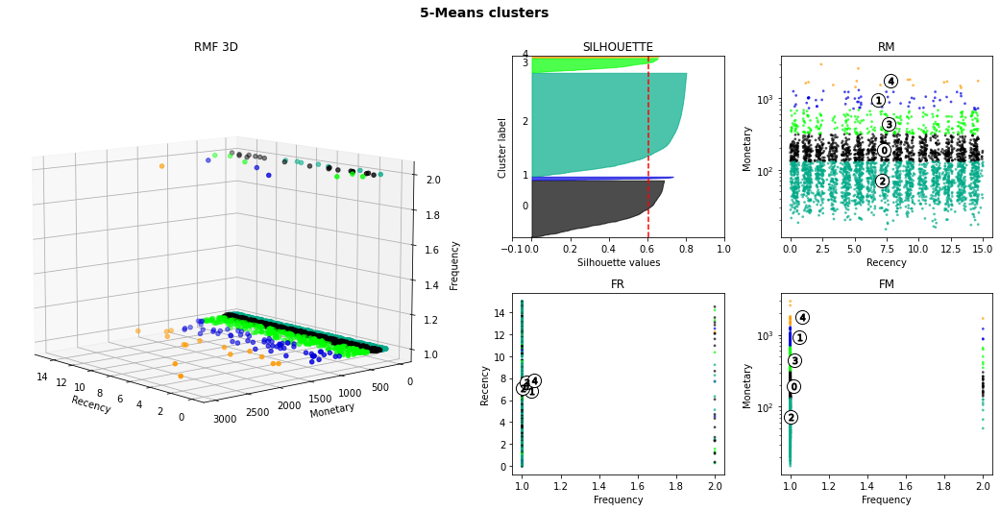

silhouette average : 0.605
k-means fit time : 1.692
silouhette compute time : 1.139


,R,F,M
customer_id,,,
0005ef4cd20d2893f0d9fbd94d3c0d97,8.359583,1,129.76
003ac9408252444b489b1bfc013f5f8c,4.252176,1,36.98
0077dc76aaf02323f03bce9b00878253,9.284780,1,874.42
007e21b7a007c8f8dadfa43c9d5a91db,10.042708,1,70.75
008b82b072c6b564fcce49a325f84097,10.220428,1,45.13
...,...,...,...
ffad6a7a0e13be3dfd9de96a81b77c9e,14.376898,1,90.18
ffbab763e1469af59b9882f0fc6e7d18,5.623356,1,165.04
ffbc87f67c513f71b9ffa68e72a2376e,4.494792,1,126.20


SLICE 28 :
start date: 2018-03-21 00:00:00
end date: 2018-04-05 00:00:00
# customers: 3348
# orders: 3373


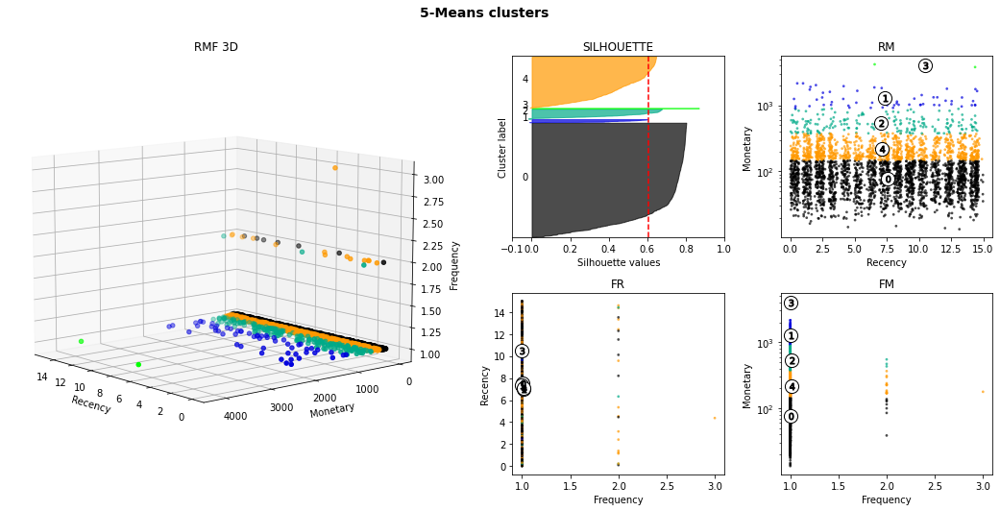

silhouette average : 0.605
k-means fit time : 1.642
silouhette compute time : 0.808


,R,F,M
customer_id,,,
00090324bbad0e9342388303bb71ba0a,11.385637,1,63.66
0023557a94bef0038066b5d1b3dc763e,7.171366,1,107.44
0027324a96d26a2bc7d69262f83c8403,10.505822,1,46.78
003800162424b7b5b3d75c9cf22a66e7,3.104468,1,107.81
004256f082951ec189a4962b6788c214,12.515301,1,259.15
...,...,...,...
ff7bfe25f6e582f062fe91a506aef916,13.120012,1,66.39
ff7e7d4a4669fc03606a21eedad169e3,7.383576,1,30.38
ff9584b796ae561b0085ebc998880a64,12.654444,1,50.05


SLICE 29 :
start date: 2018-04-05 00:00:00
end date: 2018-04-20 00:00:00
# customers: 3450
# orders: 3477


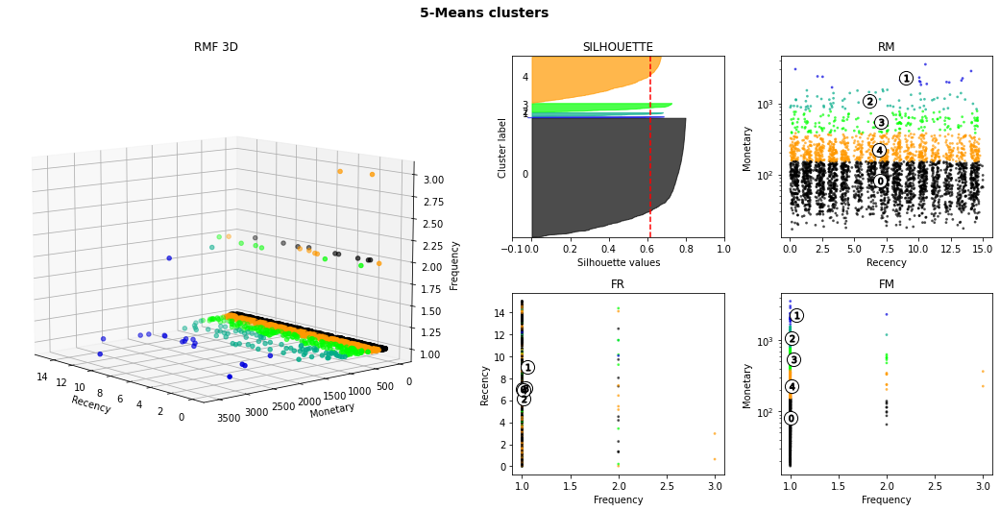

silhouette average : 0.615
k-means fit time : 1.498
silouhette compute time : 0.915


,R,F,M
customer_id,,,
0004bd2a26a76fe21f786e4fbd80607f,14.185231,1,166.98
002da6dde369f6a8b4c999ed61eb5a87,7.539074,1,52.38
003e2af81ea3c72fbdd093f07724a4de,3.125093,1,63.74
00626f29f9b57d3ef7c1739ff03e944e,8.512211,1,154.53
006b297ed73773b17d8874a2eb4466e8,10.340613,1,108.46
...,...,...,...
ffbbb45b560b9ff08bdde6786987c796,10.216331,1,188.12
ffc7d48d48327cf57757436b3f4706b0,1.216424,1,209.00
ffcd4b43c08405501a6bf2c66be83e83,0.484190,1,30.29


SLICE 30 :
start date: 2018-04-20 00:00:00
end date: 2018-05-05 00:00:00
# customers: 3573
# orders: 3591


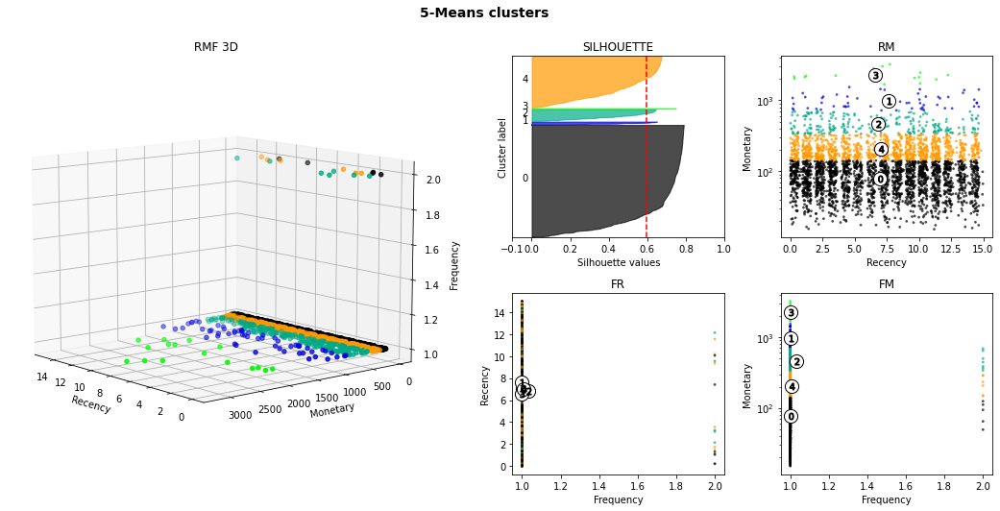

silhouette average : 0.596
k-means fit time : 1.549
silouhette compute time : 1.19


,R,F,M
customer_id,,,
00050ab1314c0e55a6ca13cf7181fecf,14.460150,1,35.38
000949456b182f53c18b68d6babc79c1,11.586273,1,82.05
0019e8c501c85848ac0966d45226fa1d,3.607269,1,197.27
003db7adfcdc49857b095a50191b6c9d,2.471053,1,542.66
004f84d065096f3cedd26cf0adc80b9d,9.029676,1,189.08
...,...,...,...
ffc46f230cc7ce6109908f432eb9eb5b,3.230544,1,279.92
ffe76cb2f4bb39384c432d65ece67441,9.564942,1,66.06
ffecceca389973ef16660d58696f281e,9.494317,1,72.76


SLICE 31 :
start date: 2018-05-05 00:00:00
end date: 2018-05-20 00:00:00
# customers: 4048
# orders: 4071


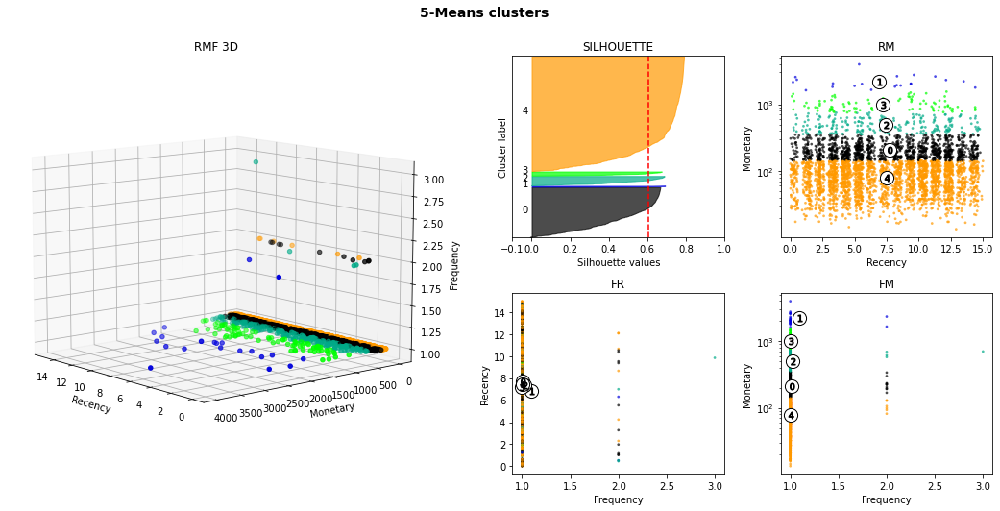

silhouette average : 0.603
k-means fit time : 1.476
silouhette compute time : 1.362


,R,F,M
customer_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,9.544132,1,141.90
0000b849f77a49e4a4ce2b2a4ca5be3f,12.533715,1,27.19
0034c76b7e6a17d738375b99afc2f01e,12.321528,1,44.23
0035029989e6fc5cf030918a5f9f2037,7.397037,1,546.12
003fee4ca17927283128c7ddc6f9311b,11.452384,1,103.47
...,...,...,...
ffca00fb352b5e57db50865d65098b4a,9.022164,1,47.61
ffcb3eb07f2a033d45949fcecd160d98,7.240590,1,206.08
ffd2e2ad95719ab7fedc9e02c5e26a62,2.294155,1,44.23


SLICE 32 :
start date: 2018-05-20 00:00:00
end date: 2018-06-04 00:00:00
# customers: 2184
# orders: 2198


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


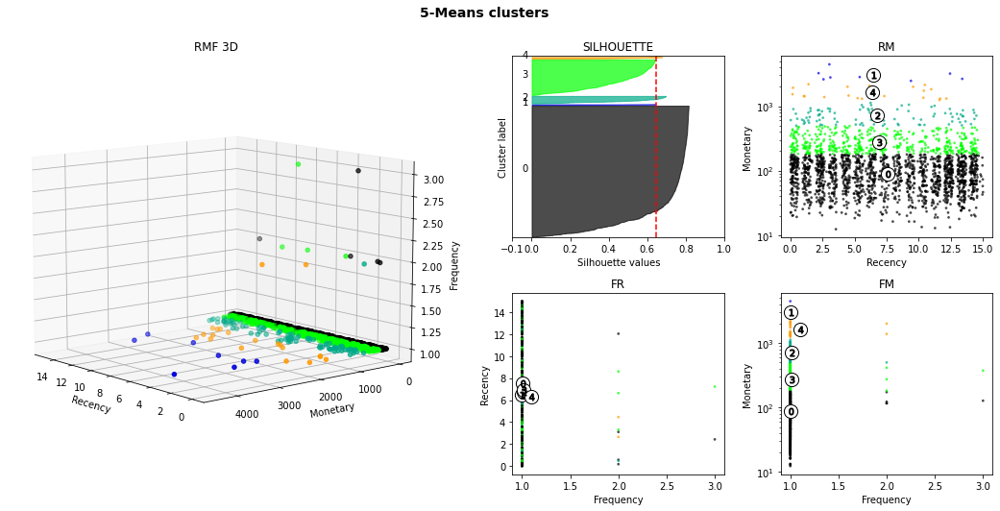

silhouette average : 0.643
k-means fit time : 1.403
silouhette compute time : 0.45


,R,F,M
customer_id,,,
000ed48ceeb6f4bf8ad021a10a3c7b43,14.315208,1,20.75
001a3a8e11d76c9a366c31a4aa2cc529,13.941377,1,24.23
00256bf7b05c08f6a5849df3d0a64f1f,2.262986,1,57.73
004b45ec5c64187465168251cd1c9c2f,8.178611,1,49.85
005f060d4223956c62b64e9567a36f0f,12.057708,1,777.68
...,...,...,...
ff325a460cc15654fa42b324fe0ab64b,13.456505,1,83.41
ff61f2506ff81e50510d8c0ac5570c30,8.497535,1,127.21
ffb1cf5736b51e47fec82cf40dd26303,7.477894,1,267.66


SLICE 33 :
start date: 2018-06-04 00:00:00
end date: 2018-06-19 00:00:00
# customers: 3186
# orders: 3198


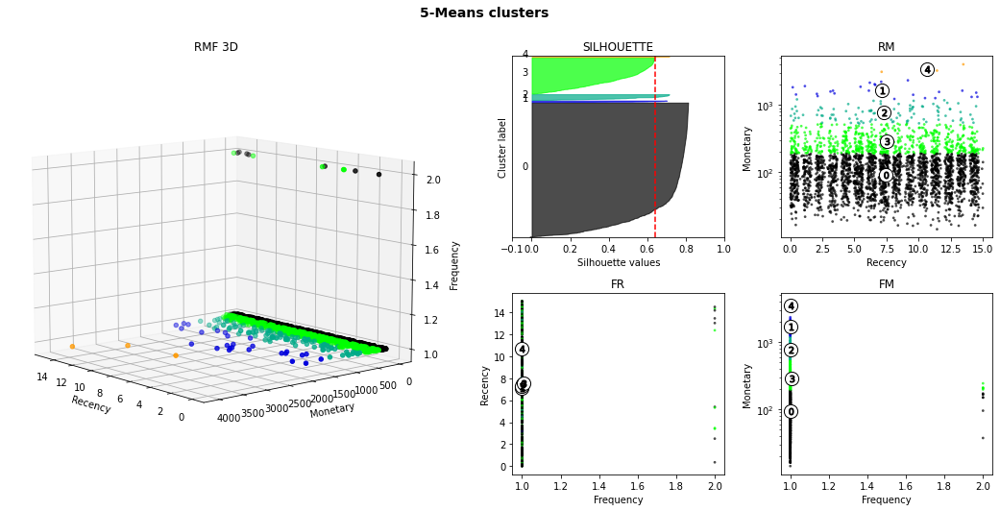

silhouette average : 0.642
k-means fit time : 1.475
silouhette compute time : 0.768


,R,F,M
customer_id,,,
004493e0b0a37317d25665d340c0677d,12.260752,1,83.32
006c10bfead12ac8d90486fb4ce4e603,4.012546,1,77.22
007ba48697b079e78f168b051462dd1b,12.007222,1,147.78
0098853a28531d48988a2fb02b30840e,10.495613,1,79.38
00c05fe9d2f8b245f1f86fe559175f24,4.341840,1,388.74
...,...,...,...
ffa323b33234124b58b25511035c2855,4.308819,1,301.34
ffb52634b4c16223ff808f266332de04,10.489988,1,85.54
ffcb7bc68d6ec38fece3546240bd01e5,10.634236,1,47.05


SLICE 34 :
start date: 2018-06-19 00:00:00
end date: 2018-07-04 00:00:00
# customers: 3011
# orders: 3023


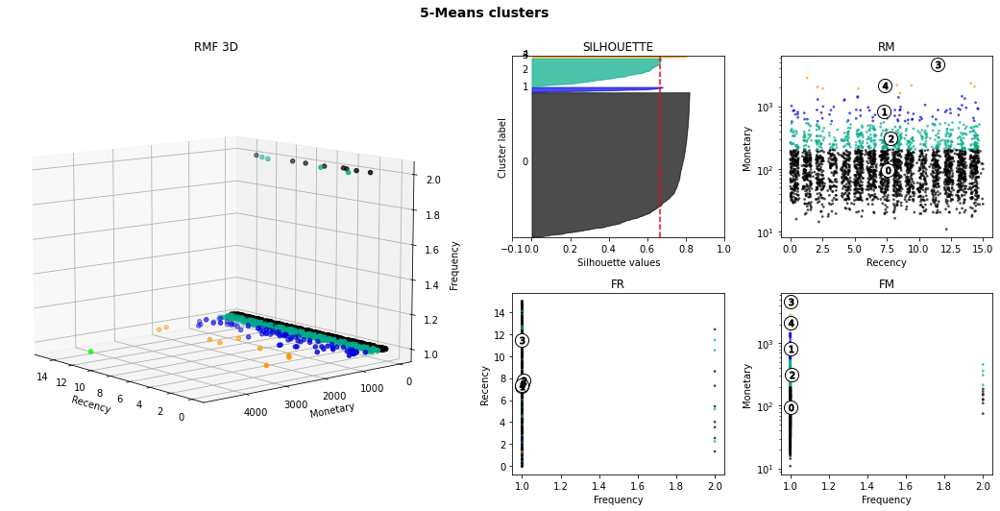

silhouette average : 0.668
k-means fit time : 1.531
silouhette compute time : 0.755


,R,F,M
customer_id,,,
000e309254ab1fc5ba99dd469d36bdb4,8.587535,1,78.42
001deb796b28a3a128d6113857569aa4,11.328137,1,63.33
002311514717ca8b65b09a26cdf7b91a,6.517662,1,124.32
0033f4a2887e07e25aa1204d482f41ba,7.953206,1,425.04
0045e9ad4d6c85d2323a7ab374b76183,14.032373,1,24.13
...,...,...,...
ffc4233210eac4ec1711a8b847196d4e,14.377755,1,94.77
ffd2aac179372f267e7b9186ac7a1bcc,14.401956,1,29.13
ffeb904468642a1ce663a322629801cb,6.501609,1,93.11


SLICE 35 :
start date: 2018-07-04 00:00:00
end date: 2018-07-19 00:00:00
# customers: 2532
# orders: 2559


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=10.
  warnings.warn(


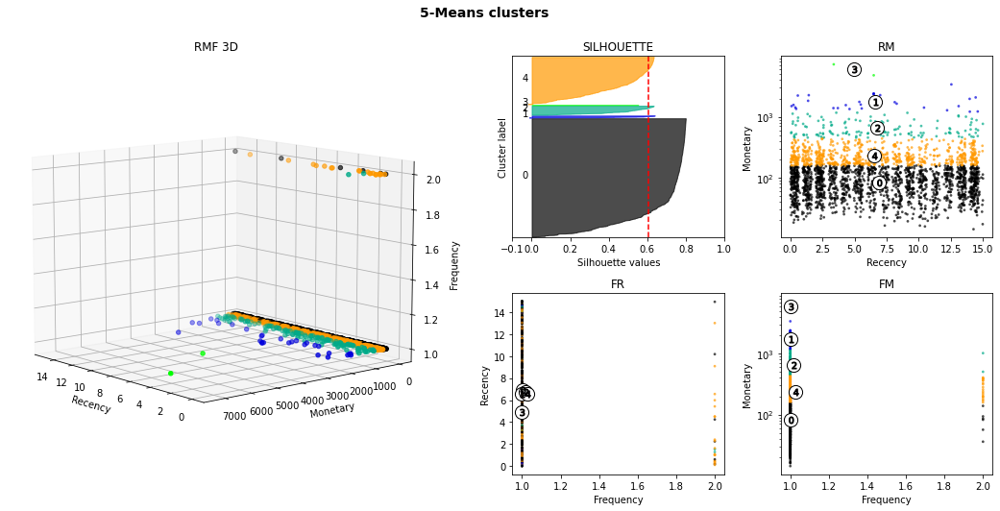

silhouette average : 0.607
k-means fit time : 1.653
silouhette compute time : 0.612


,R,F,M
customer_id,,,
001a34eb30ecb8e3aacb07c475ca4dd1,7.173681,1,161.71
003162bf0351f47a1a247992b8b9b42d,4.343438,1,536.60
0032ca69771a7758ce643258bb9e4ac7,2.352199,1,62.45
00344274804f3b8003de1b0562ae01df,9.410127,1,226.23
004df63539fd5e38d4b0a0506de7549c,2.437431,1,993.55
...,...,...,...
ff6c9c45f6cee4ec0785650b18322d73,0.250058,1,1568.72
ff8a98860a86a0f563a92a43b3344414,1.394745,1,117.58
ffb6123b45cfa6e6ff5ff94d404283b7,9.103299,1,25.04


SLICE 36 :
start date: 2018-07-19 00:00:00
end date: 2018-08-03 00:00:00
# customers: 3744
# orders: 3774


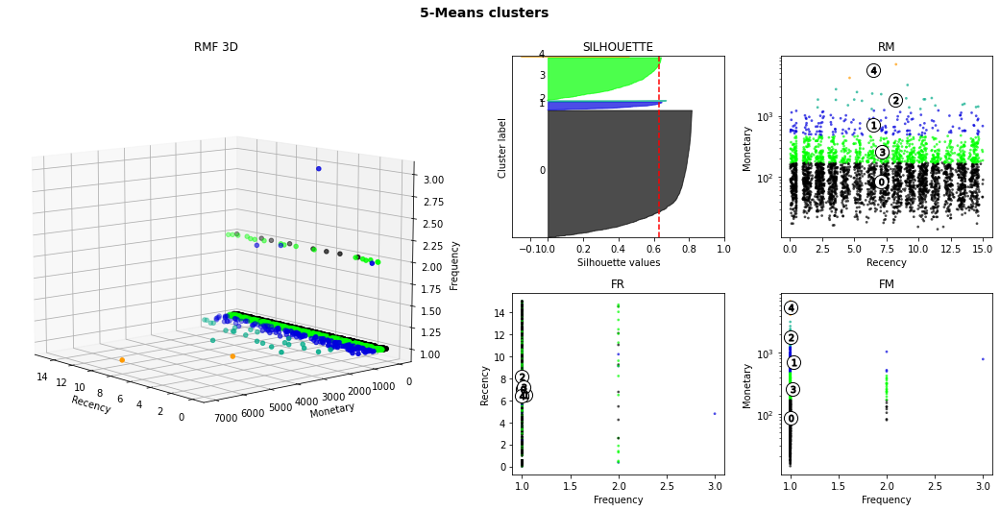

silhouette average : 0.631
k-means fit time : 1.623
silouhette compute time : 1.202


,R,F,M
customer_id,,,
000fbf0473c10fc1ab6f8d2d286ce20c,7.594537,1,362.38
0015752e079902b12cd00b9b7596276b,0.233437,1,74.82
00172711b30d52eea8b313a7f2cced02,5.983461,1,122.07
00196c4c9a3af7dd2ad10eade69c926f,5.604722,1,37.58
0025795df7a7d077c4c90162fa820085,9.535289,1,214.08
...,...,...,...
ffc39051848c3ef2be36d1513aa3ad17,1.442141,1,40.86
ffdf771c03dd683f1ed7017ae4e9efb2,5.280394,1,50.38
ffe96c782a5bc522bd8bad3bc638981a,3.404595,1,245.22


SLICE 37 :
start date: 2018-08-03 00:00:00
end date: 2018-08-18 00:00:00
# customers: 4274
# orders: 4296


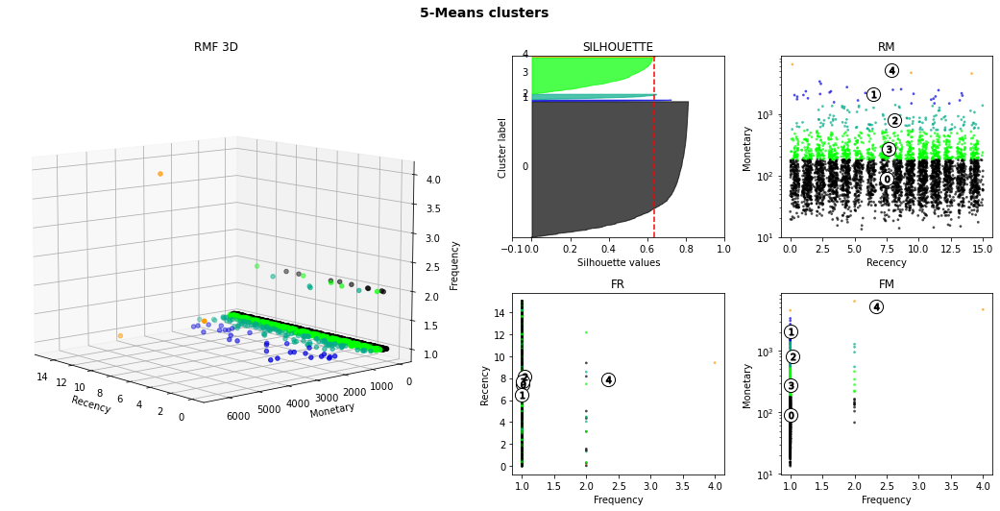

silhouette average : 0.635
k-means fit time : 1.795
silouhette compute time : 1.387


,R,F,M
customer_id,,,
00172711b30d52eea8b313a7f2cced02,4.615197,1,122.07
002471155ecd08d208d1376720e2a907,9.141319,1,92.18
00391594070baf8603f5fdc1d0c6a48c,12.143426,1,119.32
003a7a8eb096ed3cbf713d2def1ca701,3.400012,1,157.46
003ae409f37c3c30cb1c974af3a42692,2.515451,1,216.32
...,...,...,...
ffb3cbd5e1e507679e2db84c515410a5,2.149352,1,110.63
ffb572185af25751289ac38f38c7e2f9,12.436262,1,129.87
ffe204b1bb8026741b839085b2fd10f2,8.374329,1,156.70


SLICE 38 :
start date: 2018-08-18 00:00:00
end date: 2018-09-02 00:00:00
# customers: 1596
# orders: 1603


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


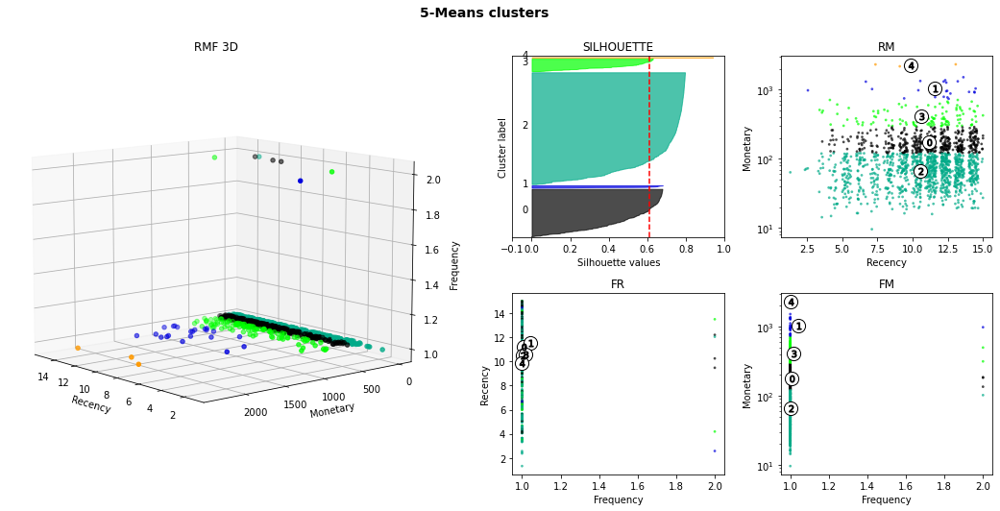

silhouette average : 0.61
k-means fit time : 1.351
silouhette compute time : 0.394


,R,F,M
customer_id,,,
000ec5bff359e1c0ad76a81a45cb598f,11.517755,1,27.75
001928b561575b2821c92254a2327d06,8.113194,1,164.81
0057f64bff87f4698b4cbd338d62a2a8,11.550266,1,82.86
008b06aba4b5f5b5b94f525ccf520624,10.549248,1,90.50
00a33236962b4ac37fd25275be9c206b,13.273808,1,116.84
...,...,...,...
ff22e30958c13ffe219db7d711e8f564,8.290058,1,166.46
ff2959dedacc441cc5ffe7d747a1a299,14.468102,1,1043.32
ff36be26206fffe1eb37afd54c70e18b,9.473519,2,185.52


In [9]:
from olist_commons import (
    get_earliest_relevant_date,
    get_latest_relevant_date
)

earliest_relevant_date = get_earliest_relevant_date()  # datetime(2017, 1, 25)
latest_relevant_date = get_latest_relevant_date()  # datetime(2018, 8, 21)
machin(
    step_in_days = 15,
    from_date=earliest_relevant_date,
    to_date=latest_relevant_date
)

#### Sans accumulation et avec normalisation

# slices: 39
SLICE 0 :
start date: 2017-01-25 00:00:00
end date: 2017-02-09 00:00:00
# customers: 1014
# orders: 1034


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


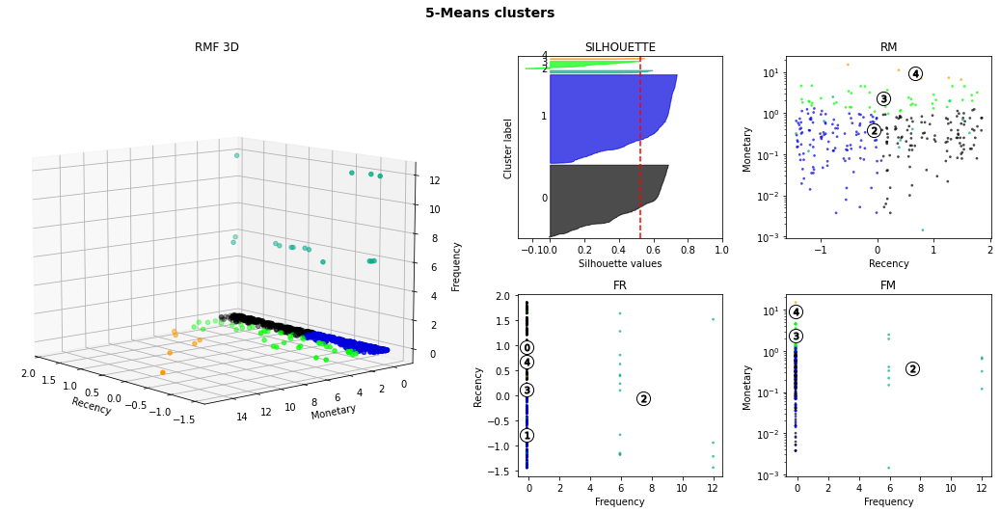

silhouette average : 0.525
k-means fit time : 1.389
silouhette compute time : 0.095


,R,F,M
customer_id,,,
002b4cd83fabaffaa475f78ea5ef3e08,0.186271,-0.11954,-0.434495
0071f46a072a9ae25bbe4438b15efe9c,0.313222,-0.11954,-0.003502
008f3d5f45a11059239a5c452cd00006,1.552541,-0.11954,0.630619
012e12f54f6e73b1faba89a119dab849,0.798158,-0.11954,-0.272775
0284ca4015977edc8413c917b8e68355,-1.093072,-0.11954,-0.425454
...,...,...,...
fe810d4870b11964c5d0ae1817aaa97b,1.671082,-0.11954,0.135596
fec0f9b88ab21b6b9bd1961500e83665,1.403573,-0.11954,0.251289
fee302f7605a1022d1a885fa5e2cad6e,-0.216347,-0.11954,0.339820


SLICE 1 :
start date: 2017-02-09 00:00:00
end date: 2017-02-24 00:00:00
# customers: 881
# orders: 893


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


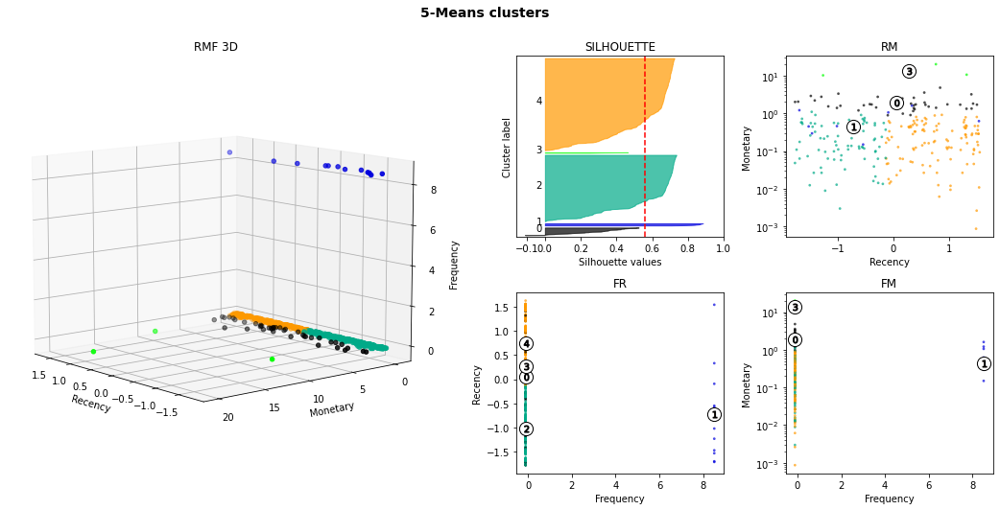

silhouette average : 0.56
k-means fit time : 1.542
silouhette compute time : 0.181


,R,F,M
customer_id,,,
0087eede471173af78d789df249c3a45,-0.144360,-0.117512,-0.062859
012b8001e47392df808a454083a74b74,1.327037,-0.117512,-0.218587
01469c41b00bb21cd01d2104b8e81384,1.016634,-0.117512,-0.182329
016feebfaba953a2456d3a063b8eb8ef,0.619351,-0.117512,-0.325872
019d47513bb1164cc83fc2d6d7123ef8,1.216406,-0.117512,0.107110
...,...,...,...
fe97a20a987dd0adc99328b52be73c4c,0.767865,-0.117512,-0.444955
ff28720521c749234b1ba19c9c986f4c,0.168504,-0.117512,0.061825
ff3bcc94d97e257e7619a2161375cdfe,1.516933,-0.117512,-0.262324


SLICE 2 :
start date: 2017-02-24 00:00:00
end date: 2017-03-11 00:00:00
# customers: 1082
# orders: 1097


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


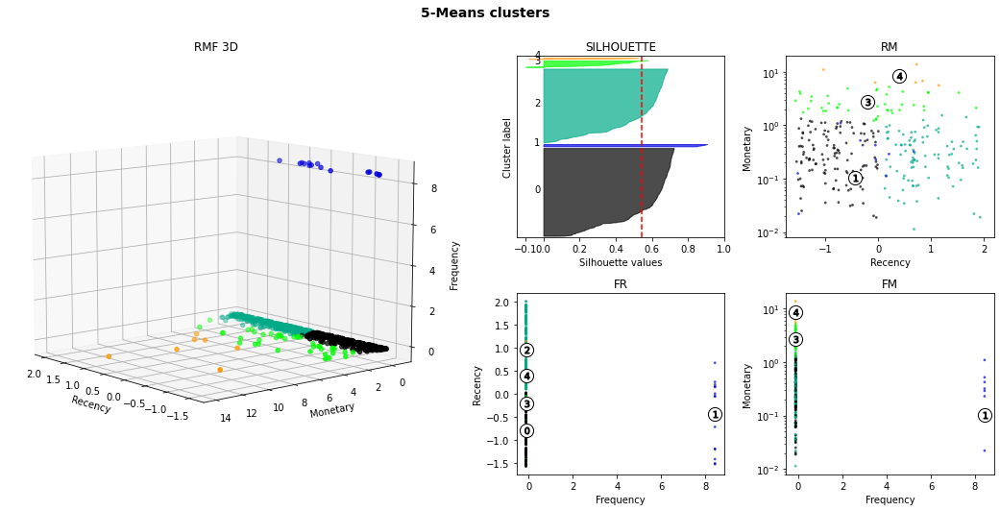

silhouette average : 0.545
k-means fit time : 1.308
silouhette compute time : 0.111


,R,F,M
customer_id,,,
0000f46a3911fa3c0805444483337064,-1.542452,-0.118567,-0.315113
0005e1862207bf6ccc02e4228effd9a0,-0.130855,-0.118567,-0.069921
00446a03d7a34d191507c9e42870d0a5,-0.575730,-0.118567,-0.151153
0049db44bfd6cee26ac9c649329ff6ea,-0.748611,-0.118567,-0.227550
0055b522bc89cbfbf376d8b59a628470,0.185484,-0.118567,0.753638
...,...,...,...
fef01b6698bae7394677113b5e647eda,-1.266773,-0.118567,-0.396153
ff4050535c1351cd0b834ccf1c9d07f1,0.507990,-0.118567,-0.518940
ff9bc66daa6702543b16f3c4897e300b,-0.505861,-0.118567,-0.269950


SLICE 3 :
start date: 2017-03-11 00:00:00
end date: 2017-03-26 00:00:00
# customers: 1322
# orders: 1340


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


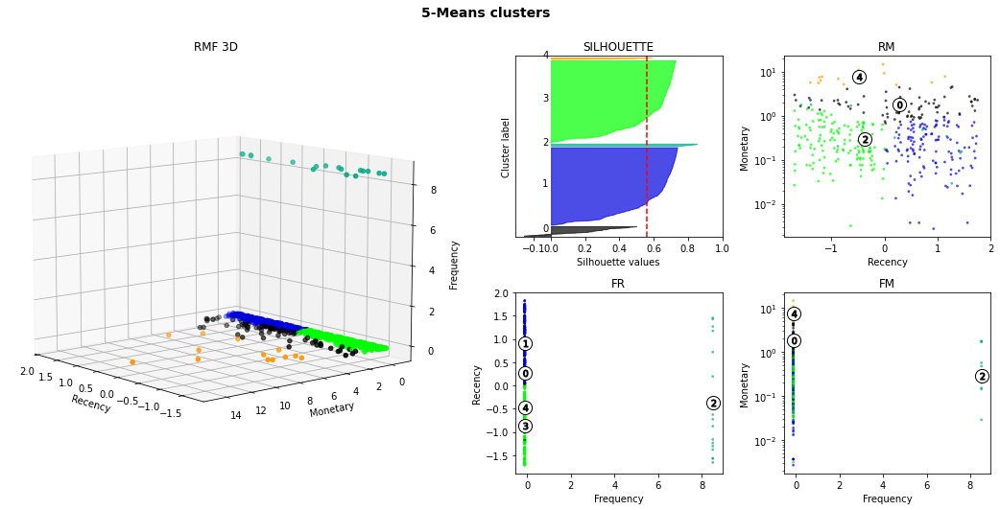

silhouette average : 0.561
k-means fit time : 1.292
silouhette compute time : 0.171


,R,F,M
customer_id,,,
001f3c4211216384d5fe59b041ce1461,-0.244665,-0.117489,-0.523935
003e28cb6fab8a0901bff9229612375f,1.206830,-0.117489,-0.135872
0096c18412349537abc45e350581cbbc,0.944853,-0.117489,2.286100
00c003ed13c76042b78d53fbc26930d0,0.444924,-0.117489,0.120414
00c3624c55261d9ce593f30e3815a880,0.061760,-0.117489,0.923248
...,...,...,...
ff51a896842f2bdced342631e2699d49,1.743411,-0.117489,-0.254602
ff64dc057067aecad9bf2c94b272e90a,-0.963375,-0.117489,0.033633
ffa17ff63f95ea3c838670e61d2666e0,1.200185,-0.117489,-0.339048


SLICE 4 :
start date: 2017-03-26 00:00:00
end date: 2017-04-10 00:00:00
# customers: 1195
# orders: 1215


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


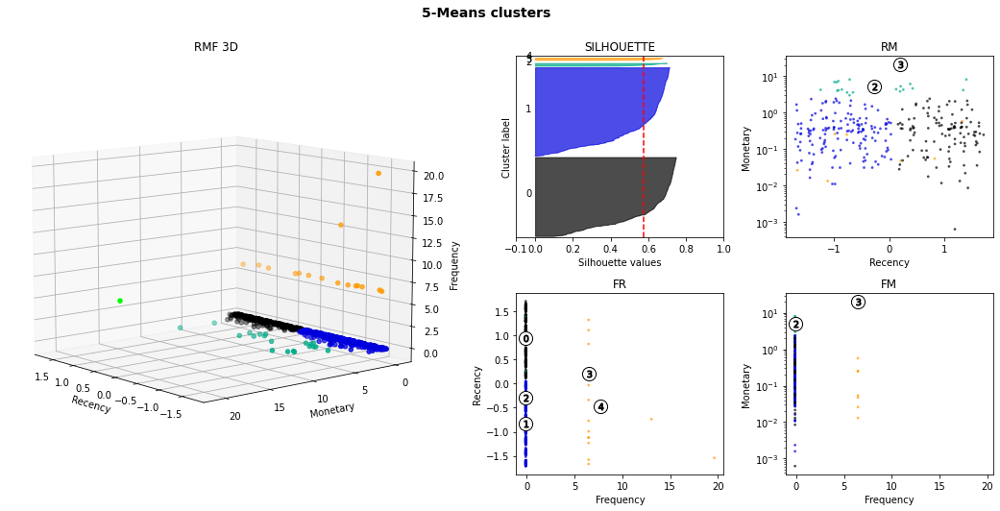

silhouette average : 0.576
k-means fit time : 1.254
silouhette compute time : 0.103


,R,F,M
customer_id,,,
002043098f10ba39a4600b6c52fbfe3c,1.577433,-0.109996,0.158098
0037d2bbb9ebc39d9114aea27ee16d72,1.389042,-0.109996,-0.107267
00522457bba00bba576a34fd9b4808fd,0.225957,-0.109996,-0.151692
00842c7d0cedb9e1edad8e9b7d148f09,-0.769438,-0.109996,-0.330605
00941614a654458b888b8780815bd26c,0.946701,-0.109996,0.011482
...,...,...,...
ff7014eeb94589da99e822e2618090fa,0.226247,-0.109996,-0.307588
ff8d27e48d6492ebb97e3052142c47bf,-1.456895,-0.109996,0.319410
ff959aedd362b48bb97c0abeb0b36b62,0.907062,-0.109996,-0.254137


SLICE 5 :
start date: 2017-04-10 00:00:00
end date: 2017-04-25 00:00:00
# customers: 1117
# orders: 1129


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


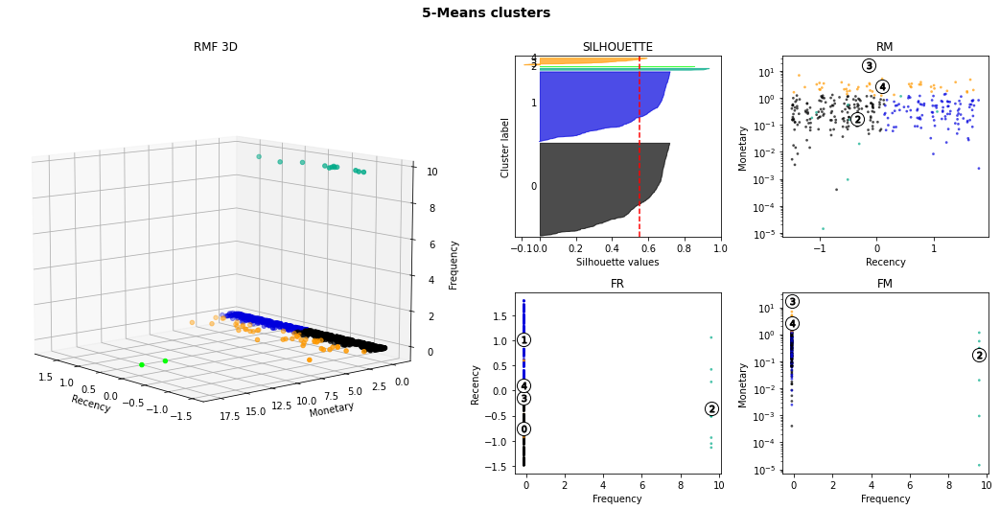

silhouette average : 0.551
k-means fit time : 1.309
silouhette compute time : 0.111


,R,F,M
customer_id,,,
0011805441c0d1b68b48002f1d005526,-1.395510,-0.10421,0.494490
00191a9719ef48ebb5860b130347bf33,-0.280223,-0.10421,-0.428748
0043d65f8039b4a4d43bc7b0f450ac2c,-0.512439,-0.10421,-0.407205
007953b3182d5ccc9189a694f5c68163,0.501170,-0.10421,-0.222542
0098f4847541cc7d676f9a5efc64c0f0,0.092227,-0.10421,-0.085111
...,...,...,...
fe7780b2659c715218834f592a838f6a,1.140617,-0.10421,-0.270820
ff253dd048167b1feddeb431db05d3d5,-1.349610,-0.10421,-0.165470
ff580ab4901e3619925a27db44eec095,1.462762,-0.10421,-0.398681


SLICE 6 :
start date: 2017-04-25 00:00:00
end date: 2017-05-10 00:00:00
# customers: 1577
# orders: 1596


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


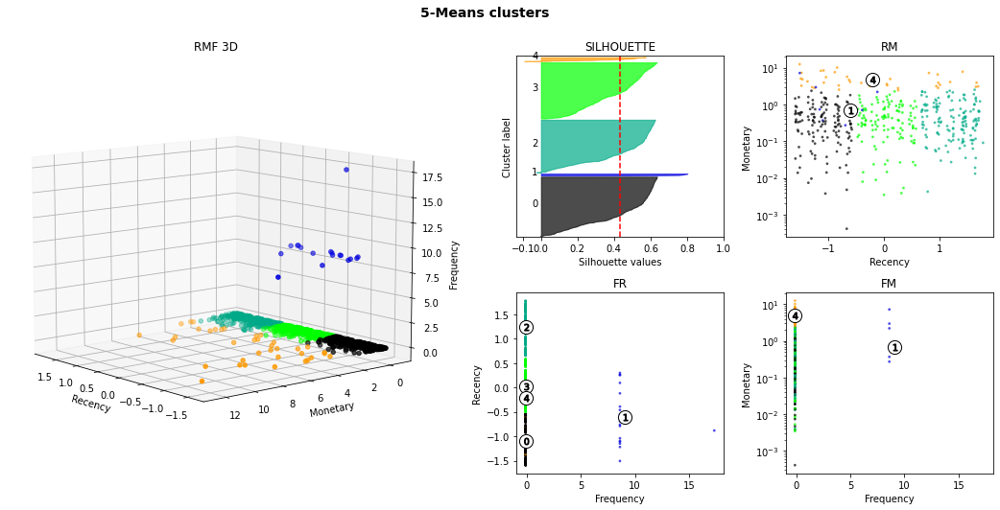

silhouette average : 0.433
k-means fit time : 1.31
silouhette compute time : 0.171


,R,F,M
customer_id,,,
00ac9cd5c4ad19e16e7c6f6864711737,0.973973,-0.10498,0.339013
011509f63f565e822767bfb89c3cf9b7,-1.508076,-0.10498,-0.436256
011fd4914a2d19b2a0e50c29cea5c6a2,-0.889066,-0.10498,0.484394
0139884762afa50d78fe480646fe92b5,-0.096583,-0.10498,-0.428044
015557c9912277312b9073947804a7ba,0.294239,-0.10498,-0.417970
...,...,...,...
ff6eae41d4cbdc5af3844a39a89431e6,1.331506,-0.10498,-0.080992
ff86fefe11696b1e957173516339bcd8,0.292285,-0.10498,-0.661226
ffaa5b5559566bb4dbf71d554310e760,-0.624650,-0.10498,-0.213482


SLICE 7 :
start date: 2017-05-10 00:00:00
end date: 2017-05-25 00:00:00
# customers: 1855
# orders: 1897


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


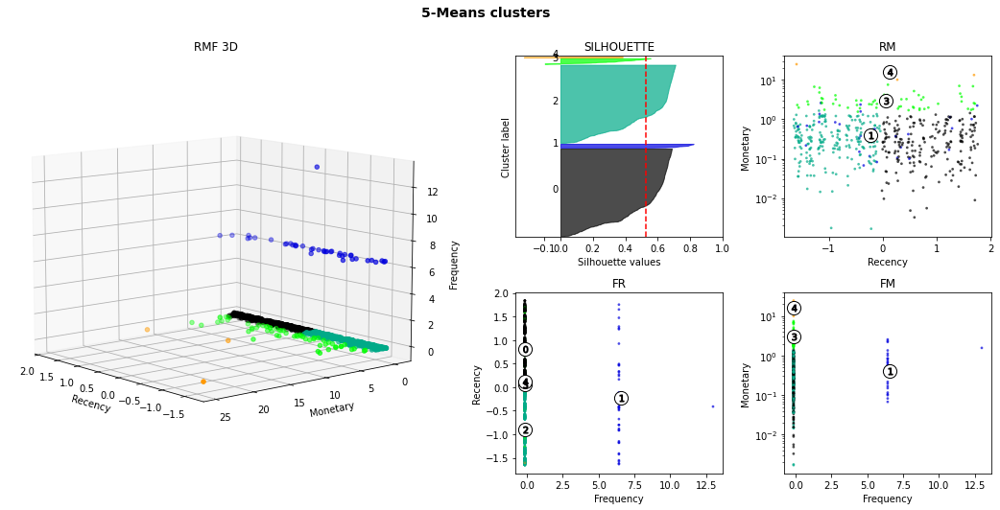

silhouette average : 0.526
k-means fit time : 1.332
silouhette compute time : 0.215


,R,F,M
customer_id,,,
002d71b244beb91ca7030b15ab526446,-1.174892,-0.148626,-0.133207
0036a074f98b80c4f1fc33dbbcf9c552,1.282615,-0.148626,-0.465189
00dd4390a8e8ad7a126e8331decc49ce,1.517536,-0.148626,-0.213428
016846e2dd862cba9a2a10eff5ac244f,1.222781,-0.148626,1.166935
0178b244a5c281fb2ade54038dd4b161,1.645287,-0.148626,-0.240910
...,...,...,...
ff5017601705e932d5545e0eb337cd0b,0.963636,-0.148626,-0.028864
ff70aa1b53f643263ead50eed3166164,0.089175,-0.148626,-0.430722
ff8892f7c26aa0446da53d01b18df463,-1.580318,-0.148626,0.368276


SLICE 8 :
start date: 2017-05-25 00:00:00
end date: 2017-06-09 00:00:00
# customers: 1726
# orders: 1752


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


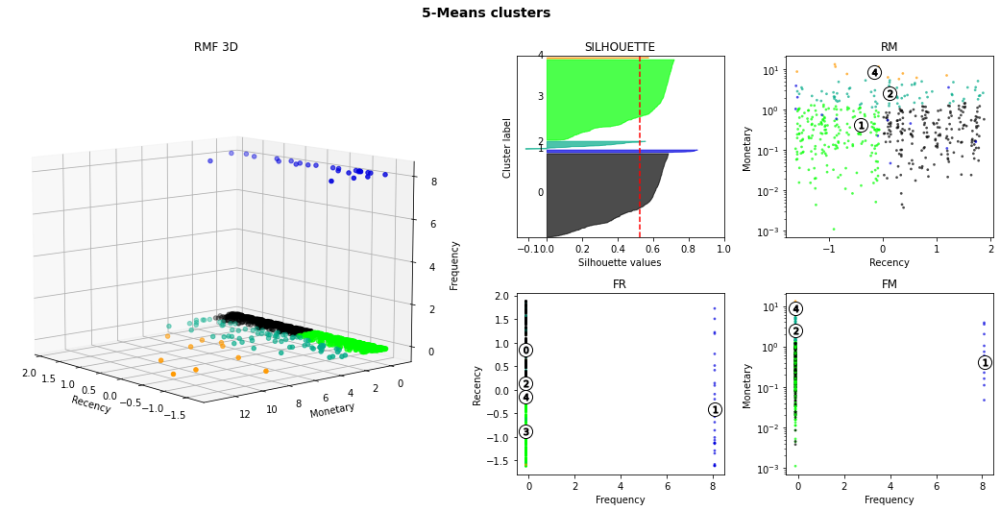

silhouette average : 0.526
k-means fit time : 1.275
silouhette compute time : 0.382


,R,F,M
customer_id,,,
008fb2ecc75561d202dd4db2e0ceec25,0.259063,-0.123669,-0.549097
0103751df12aea8b962cfbcd2b61104c,1.418117,-0.123669,-0.575578
01051cf3719a23faec8b2307b369faeb,1.209206,-0.123669,-0.057142
0189955e61056a22dd6e7cb03603a149,-1.618322,-0.123669,-0.223055
0189cca3aa2a0f75ca0cde94ee38be57,-0.896361,-0.123669,-0.275743
...,...,...,...
ff4136190ebc2a5c0bff70b569fe9180,-0.798722,-0.123669,-0.498703
ffd44de1326179fff550dae07c6884c2,0.774418,-0.123669,-0.178582
ffe4c3aa14d4702fb11fe5b3c4dd755c,1.750355,-0.123669,-0.106067


SLICE 9 :
start date: 2017-06-09 00:00:00
end date: 2017-06-24 00:00:00
# customers: 1505
# orders: 1533


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


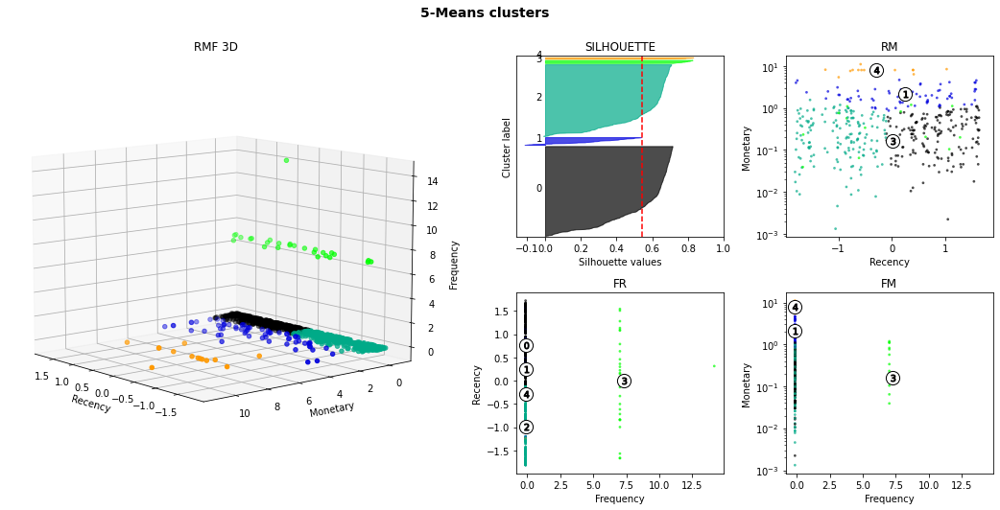

silhouette average : 0.545
k-means fit time : 1.232
silouhette compute time : 0.178


,R,F,M
customer_id,,,
00324c9f4d710e7bac5c5ba679714430,-1.313096,-0.132933,-0.221839
00444f48f6c9b55657e49435ce3a97ca,1.572394,-0.132933,-0.469223
0049dadc30da6a277c1e9d371df5a66f,0.589839,-0.132933,-0.582873
0059acd36094bf670ec8b21be6c0044c,0.807165,-0.132933,-0.493746
009301957bc7714394865c44650d8060,-1.697124,-0.132933,-0.290796
...,...,...,...
ff9e11d25bd3a13105fbf416eee813c5,0.588471,-0.132933,0.045672
ffbb8dfaa0e54649d8690b85a3ef890d,-0.743328,-0.132933,-0.567961
ffbf790cac0b6cf2e411d9f158c0fbe2,1.495155,-0.132933,-0.113878


SLICE 10 :
start date: 2017-06-24 00:00:00
end date: 2017-07-09 00:00:00
# customers: 1635
# orders: 1658


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


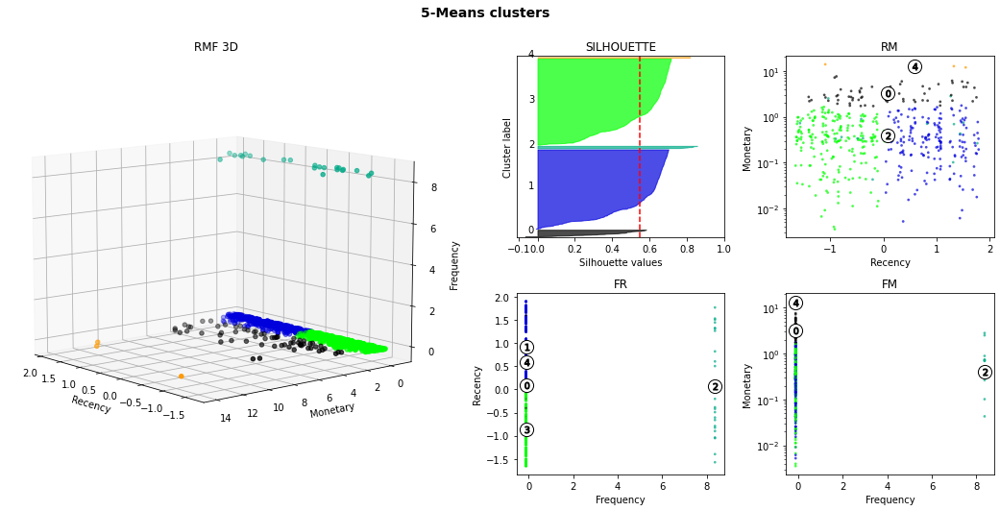

silhouette average : 0.546
k-means fit time : 1.209
silouhette compute time : 0.225


,R,F,M
customer_id,,,
0011857aff0e5871ce5eb429f21cdaf5,0.842640,-0.119449,0.165908
001a2bf0e46c684031af91fb2bce149d,0.490375,-0.119449,-0.588068
00a6ee75a90222405df9d8d59babc513,-1.174368,-0.119449,-0.475430
00cd767526517f8a4fc27db6cc5a52fa,1.079521,-0.119449,-0.305605
00d7e54ab8c5d9916f19209dbaacbb3d,0.139976,-0.119449,-0.320868
...,...,...,...
ff095a5f37e0c0199dfd3f2359ecf6b8,0.334390,-0.119449,-0.262230
ff423b634e7bbec16b9f1466f126eb18,-0.545129,-0.119449,0.105146
ff4aa52d77226e6f84a7da6391604266,0.756548,-0.119449,0.142289


SLICE 11 :
start date: 2017-07-09 00:00:00
end date: 2017-07-24 00:00:00
# customers: 1980
# orders: 2016


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


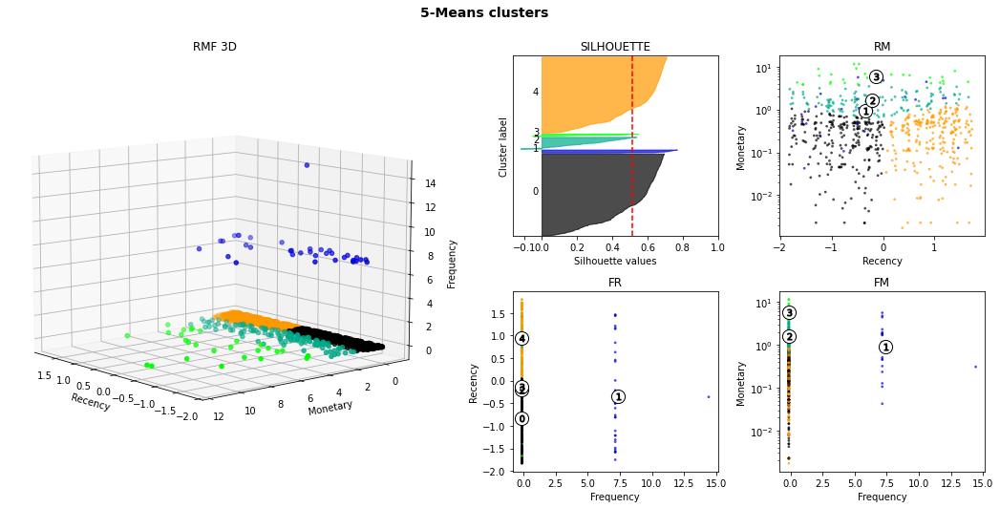

silhouette average : 0.512
k-means fit time : 1.346
silouhette compute time : 0.318


,R,F,M
customer_id,,,
0006fdc98a402fceb4eb0ee528f6a8d4,-0.467457,-0.132389,-0.728413
0010a452c6d13139e50b57f19f52e04e,1.216968,-0.132389,1.092509
002eb8b96288f3804e21d2777ac29895,-1.482282,-0.132389,-0.060032
0037eb1ff742ee2e71ba887f65f3c6f3,0.754003,-0.132389,0.496799
008778a1591d49f6b2464dffaa4fa662,-0.815837,-0.132389,0.691567
...,...,...,...
ff73dbd0440a0f1fac45e49efd6398b4,-1.085646,-0.132389,-0.735956
ff84c3cbb72d9419e3f76a6029f6f07d,0.851307,-0.132389,1.186950
ff983093f2d26e43569f7d58782faffb,-0.543881,-0.132389,-0.451470


SLICE 12 :
start date: 2017-07-24 00:00:00
end date: 2017-08-08 00:00:00
# customers: 2030
# orders: 2068


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


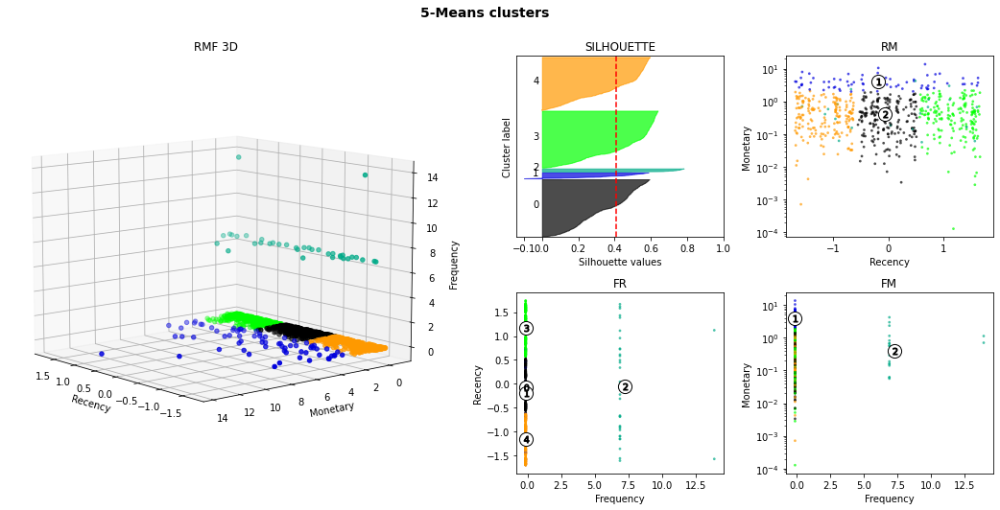

silhouette average : 0.407
k-means fit time : 1.298
silouhette compute time : 0.42


,R,F,M
customer_id,,,
0011c98589159d6149979563c504cb21,-1.145274,-0.131256,-0.184808
004288347e5e88a27ded2bb23747066c,0.922132,-0.131256,0.593207
0046311f458d8041b00063cb99482903,-0.276507,-0.131256,-0.217588
004ed862ea4e55f18868d3d782d10879,-1.436558,-0.131256,-0.235351
006d763076d74d16d66e828e79ec1544,-1.109226,-0.131256,-0.293608
...,...,...,...
ff95640b1b541ba71eaa077fd1853ca0,-0.883585,-0.131256,-0.513135
ff9c5dff16d7d6bfefc2acf5088d7b90,-1.109239,-0.131256,-0.445413
ffcdafd7d9f69caf44c3aa1ff78c32b4,0.659791,-0.131256,-0.350578


SLICE 13 :
start date: 2017-08-08 00:00:00
end date: 2017-08-23 00:00:00
# customers: 2103
# orders: 2141


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


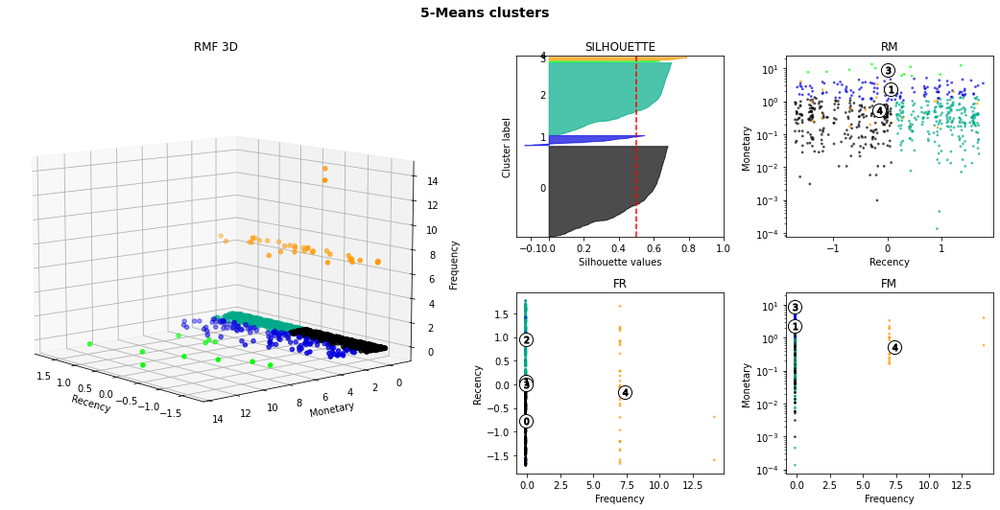

silhouette average : 0.501
k-means fit time : 1.514
silouhette compute time : 0.353


,R,F,M
customer_id,,,
000a5ad9c4601d2bbdd9ed765d5213b3,0.948293,-0.12892,-0.325561
000de6019bb59f34c099a907c151d855,-0.500570,-0.12892,0.549278
001926cef41060fae572e2e7b30bd2a4,-0.440005,-0.12892,-0.325929
0036b4a3d09ad551a5188c2e374da402,1.389553,-0.12892,0.050837
00765d375af0e700f61c57db00a8ee63,1.150443,-0.12892,0.325882
...,...,...,...
ffc04aafbf624bd130516cc1d195626a,0.681993,-0.12892,-0.712541
ffc142edc6bce329c6df0006387a5a77,-1.661352,-0.12892,-0.665682
ffc9d8a98ebd09a78c8adb729c3cfa2a,0.158715,-0.12892,-0.397744


SLICE 14 :
start date: 2017-08-23 00:00:00
end date: 2017-09-07 00:00:00
# customers: 1997
# orders: 2031


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


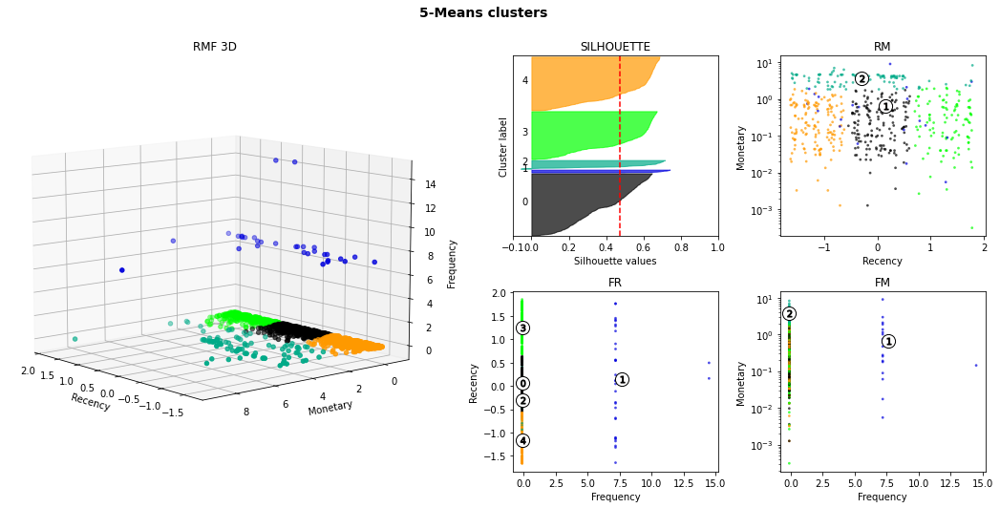

silhouette average : 0.471
k-means fit time : 1.244
silouhette compute time : 0.41


,R,F,M
customer_id,,,
001147e649a7b1afd577e873841632dd,-0.181152,-0.124375,0.108024
003035f5ec76f2220098377482de93c9,0.483649,-0.124375,-0.487815
0047f3e16441284d757a8963344f6c59,0.592652,-0.124375,-0.433243
004b45ec5c64187465168251cd1c9c2f,-0.367668,-0.124375,-0.346906
005e32bc930906dc6b65fb9d11cce3e2,-0.934079,-0.124375,-0.539044
...,...,...,...
ff9d2f60401262b9da1e868f956fb2a8,0.270734,-0.124375,0.902011
ffcf1dc25f2222aea1aef48841f20f3a,-1.513771,-0.124375,-0.321033
ffdcd85e0e81fc93f49bef4d54a4e61f,0.354021,-0.124375,-0.427710


SLICE 15 :
start date: 2017-09-07 00:00:00
end date: 2017-09-22 00:00:00
# customers: 2236
# orders: 2271


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


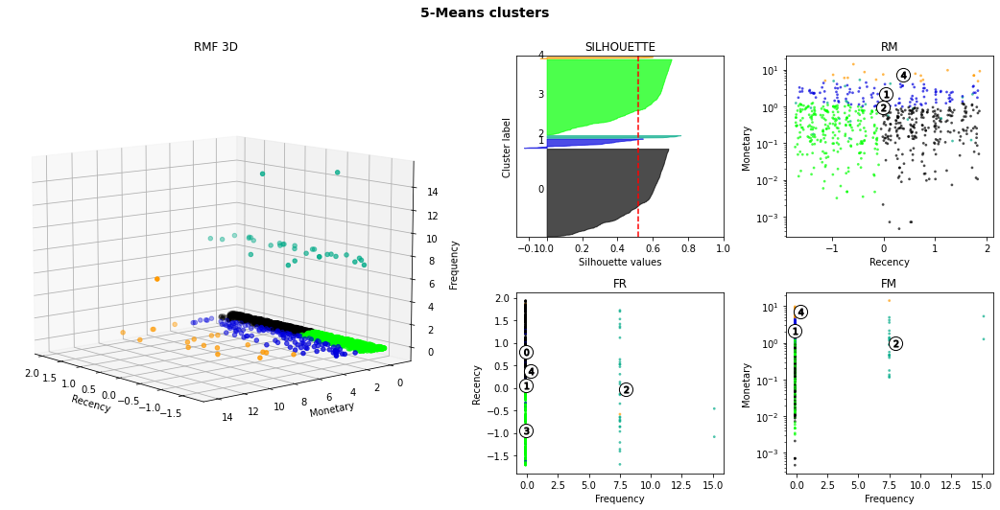

silhouette average : 0.515
k-means fit time : 1.383
silouhette compute time : 0.399


,R,F,M
customer_id,,,
005ff4ebe100db3eebbe6f7b19a8f99a,0.324709,-0.119364,0.353144
00776f3807b128beca64cd0b27138d92,-1.665908,-0.119364,0.763259
009062f98089a091615b5c9faa13de26,0.490129,-0.119364,-0.646208
00970787f181925ba33bd32b3817f742,-0.268064,-0.119364,-0.621386
00ae9ea276a5a4335382c9391059ddf2,0.394362,-0.119364,-0.115275
...,...,...,...
ff48228323a1d52f3b3108316bdc4314,1.705174,-0.119364,-0.153838
ff922bdd6bafcdf99cb90d7f39cea5b3,0.088705,-0.119364,-0.586645
ffa652b0cdf8bba29664149a9e579134,0.733291,-0.119364,-0.315106


SLICE 16 :
start date: 2017-09-22 00:00:00
end date: 2017-10-07 00:00:00
# customers: 2050
# orders: 2076


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


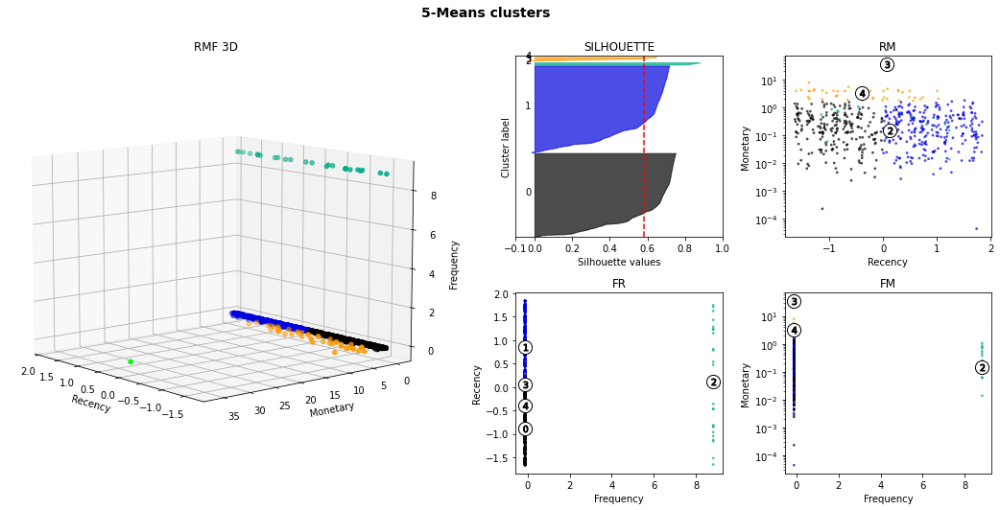

silhouette average : 0.581
k-means fit time : 1.291
silouhette compute time : 0.377


,R,F,M
customer_id,,,
000bfa1d2f1a41876493be685390d6d3,0.063277,-0.11334,-0.330531
004ad212c650c96c8a48f30855a7bcb8,1.273878,-0.11334,-0.386713
005ee3e015ec18092d7782e507cf68fe,-0.358197,-0.11334,0.047886
007ad549acb91673f04eac22c0568114,0.766717,-0.11334,-0.212536
00e5ea6932dffb682bd3d5760e84d176,0.750968,-0.11334,-0.271426
...,...,...,...
ff1e14670fe58a60d27e35069844b3d8,0.061862,-0.11334,0.024877
ff44084bf8313fa8eae5ce6e43e341ed,-1.156816,-0.11334,0.270791
ff755148365a0062374c353946b68aa3,0.801554,-0.11334,0.098598


SLICE 17 :
start date: 2017-10-07 00:00:00
end date: 2017-10-22 00:00:00
# customers: 2261
# orders: 2290


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


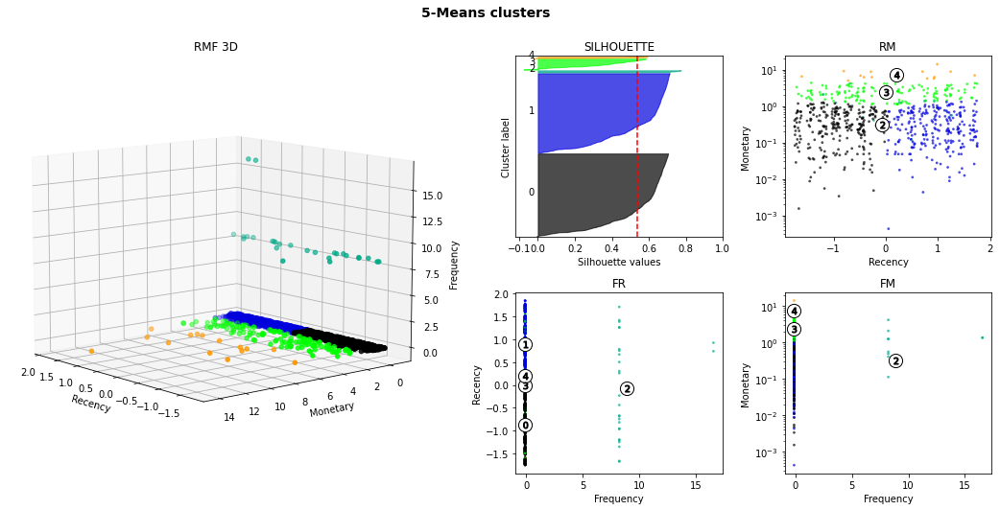

silhouette average : 0.536
k-means fit time : 1.32
silouhette compute time : 0.433


,R,F,M
customer_id,,,
0000f6ccb0745a6a4b88665a16c9f078,0.444474,-0.106771,-0.612832
0012929d977a8d7280bb277c1e5f589d,-0.711742,-0.106771,-0.076045
002ae492472e45ad6ebeb7a625409392,1.372808,-0.106771,0.225865
004177f7bf62929186b32c7fdaa6157b,-1.196596,-0.106771,1.257562
0065f6fb341f013a95a8e11cdc98d07a,1.223286,-0.106771,-0.250119
...,...,...,...
fedd4c0ac17d47475d8178c97f1724fb,-1.391279,-0.106771,-0.559359
ff28d873d960260278acba659ac5752d,-0.064527,-0.106771,-0.553274
ff36fa1d315d885d3c5171ea09996142,0.201151,-0.106771,-0.515182


SLICE 18 :
start date: 2017-10-22 00:00:00
end date: 2017-11-06 00:00:00
# customers: 2042
# orders: 2078


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


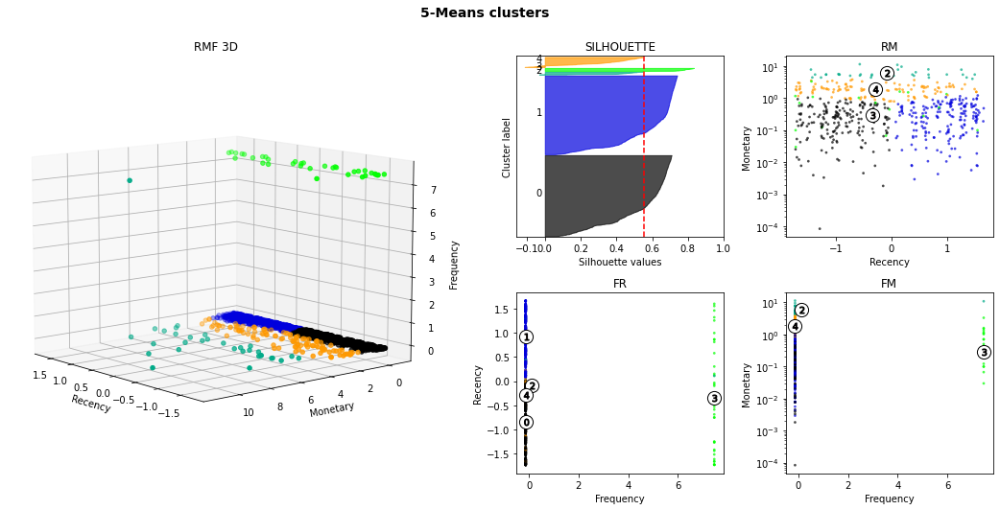

silhouette average : 0.554
k-means fit time : 1.26
silouhette compute time : 0.365


,R,F,M
customer_id,,,
00293787e2aec37a9c253b63fdfe2049,0.395897,-0.133963,0.344455
0029bd580d3012618731f5abb174a07f,-0.958395,-0.133963,-0.508029
002cdf87d4c03f08f7eb4551a923affc,-0.542896,-0.133963,0.223317
002feefec5af0a3b26ee7839c66d205e,-0.038907,-0.133963,-0.403527
00575b2023dedcc0f3e81a938834689b,-1.479434,-0.133963,-0.591000
...,...,...,...
ff66d86dd60a80525875a584d0f5d399,-0.722760,-0.133963,-0.205559
ff6d4669ac6694f4ad278d23c4c7caa5,0.676485,-0.133963,-0.107321
ffba2b15e7a4608fd6ae9aa92f610dc5,-0.101580,-0.133963,-0.580130


SLICE 19 :
start date: 2017-11-06 00:00:00
end date: 2017-11-21 00:00:00
# customers: 2733
# orders: 2760


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=11.
  warnings.warn(


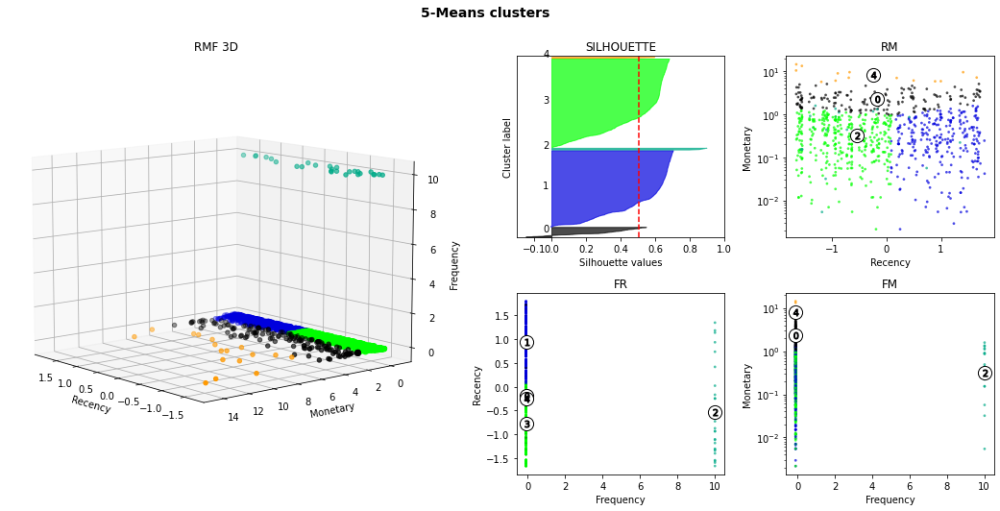

silhouette average : 0.506
k-means fit time : 1.451
silouhette compute time : 0.796


,R,F,M
customer_id,,,
0004aac84e0df4da2b147fca70cf8255,-0.239570,-0.099889,0.155991
00082cbe03e478190aadbea78542e933,-1.353140,-0.099889,-0.182480
001ae44fa04911a9e9577356dce6c63c,1.630719,-0.099889,-0.230546
003f4901fdb60ae9c1e2538b84c208e1,-1.401423,-0.099889,-0.007422
009a0802534f904b40b9d512b49794e1,-0.652625,-0.099889,-0.350062
...,...,...,...
ff7b8116de7a8a5f5c8abbae6399608b,-0.698379,-0.099889,-0.014610
ff7c033bfd33a1af06ac30c07492a859,-1.357782,-0.099889,-0.248852
ff913fbe58ff8a761c3b01f4c718fc85,-1.559551,-0.099889,0.518327


SLICE 20 :
start date: 2017-11-21 00:00:00
end date: 2017-12-06 00:00:00
# customers: 5413
# orders: 5495


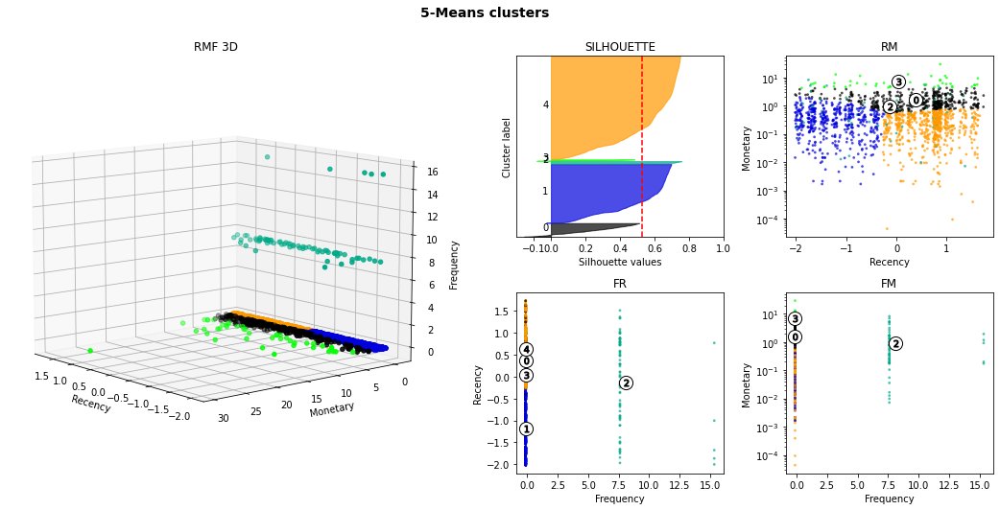

silhouette average : 0.529
k-means fit time : 1.961
silouhette compute time : 1.933


,R,F,M
customer_id,,,
002bdeb33da5b1b3ce8b9c822f749c82,-1.968294,-0.116991,-0.582655
00377a18050b898b93e2c774be9947db,0.592021,-0.116991,-0.445008
003d56767e53e08671de00da3fba8d40,-0.901306,-0.116991,0.115768
0042dcca0ae57aaec6e808edc31a2d48,-1.143733,-0.116991,-0.349267
00543330561a9088f8b3879114a7b008,0.828138,-0.116991,-0.404345
...,...,...,...
ffbb6557e45f7158781514f0efddb0d5,0.976634,-0.116991,-0.130942
ffc741a42034ec5c25be020c656950eb,-0.463083,-0.116991,0.035537
ffd973d43cadfa3e60340bcad8d87696,0.261287,-0.116991,-0.148042


SLICE 21 :
start date: 2017-12-06 00:00:00
end date: 2017-12-21 00:00:00
# customers: 2992
# orders: 3030


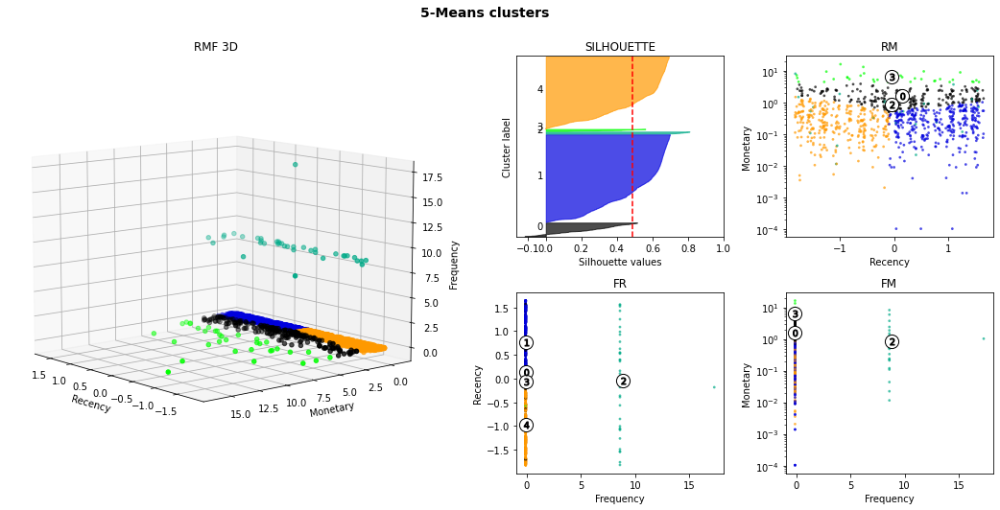

silhouette average : 0.488
k-means fit time : 1.805
silouhette compute time : 0.728


,R,F,M
customer_id,,,
000c8bdb58a29e7115cfc257230fb21b,0.036727,-0.110512,-0.680163
001ae5a1788703d64536c30362503e49,1.071239,-0.110512,-0.131438
0028a7d8db7b0247652509358ad8d755,-0.126471,-0.110512,1.005479
004a432489f6630c6dfd3fc4454603f5,-0.758583,-0.110512,-0.395610
006e937bd5a5e32043018a6d1521b5d5,0.526808,-0.110512,0.203290
...,...,...,...
ff94fd009b5a961313d7b3f2a1536c59,-0.342330,-0.110512,-0.154767
ffdde6e4dcb6ec3a882cfc6cddef7996,0.592493,-0.110512,3.292192
ffdf72e25c6f0503bb567d0a8cf1c159,0.812736,-0.110512,0.051108


SLICE 22 :
start date: 2017-12-21 00:00:00
end date: 2018-01-05 00:00:00
# customers: 2048
# orders: 2060


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


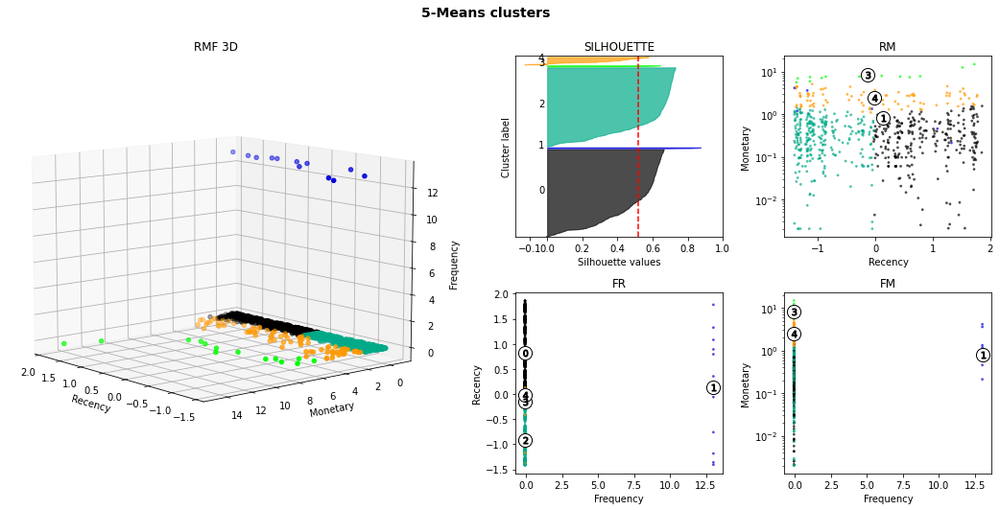

silhouette average : 0.52
k-means fit time : 1.532
silouhette compute time : 0.381


,R,F,M
customer_id,,,
0049a16516d38fc2246696172a257f16,0.012777,-0.076772,-0.651295
0078bb0f0d23e922d08437b7d0e13907,1.645355,-0.076772,-0.586634
007d9f716ead2bc8712255271a38f609,-0.683384,-0.076772,-0.452512
00986cafefb6e670cceca01694bda599,-0.487099,-0.076772,-0.456282
00a1c6913daeda0b7f9b79f802805fdb,0.441251,-0.076772,-0.259613
...,...,...,...
ffa8a7cd286a3431406fcb483d63df92,-0.490251,-0.076772,-0.558016
ffac330ca7f9bff857210af3a40b08d8,1.515374,-0.076772,-0.279148
ffc14413ed1273340b518ad0bc63c862,0.617725,-0.076772,-0.542364


SLICE 23 :
start date: 2018-01-05 00:00:00
end date: 2018-01-20 00:00:00
# customers: 3739
# orders: 3774


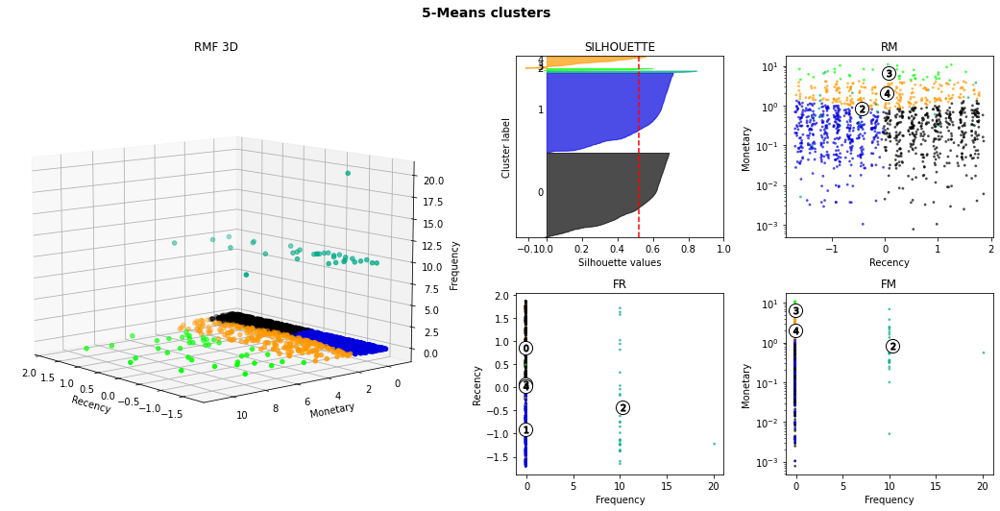

silhouette average : 0.519
k-means fit time : 1.797
silouhette compute time : 0.878


,R,F,M
customer_id,,,
000d460961d6dbfa3ec6c9f5805769e1,1.159739,-0.094519,-0.638663
0014a5a58da615f7b01a4f5e194bf5ea,-1.431863,-0.094519,-0.302182
0028cfeb9dfcd3628a56d5b6400deef5,1.385189,-0.094519,-0.204233
002d3bd901608f67c3fc11eaaa842b13,-0.697777,-0.094519,-0.680870
003650b504826ea534e02eba0ab58dd5,-1.107449,-0.094519,-0.718120
...,...,...,...
ffbd1090fa1840d6cf9106fb238089e9,0.991656,-0.094519,-0.398426
ffbe02226141ca45932dddadda83f9bd,-1.593719,-0.094519,-0.558353
ffcda3a0829ba6d3a02cd280e29b19a6,1.445923,-0.094519,-0.240471


SLICE 24 :
start date: 2018-01-20 00:00:00
end date: 2018-02-04 00:00:00
# customers: 3321
# orders: 3371


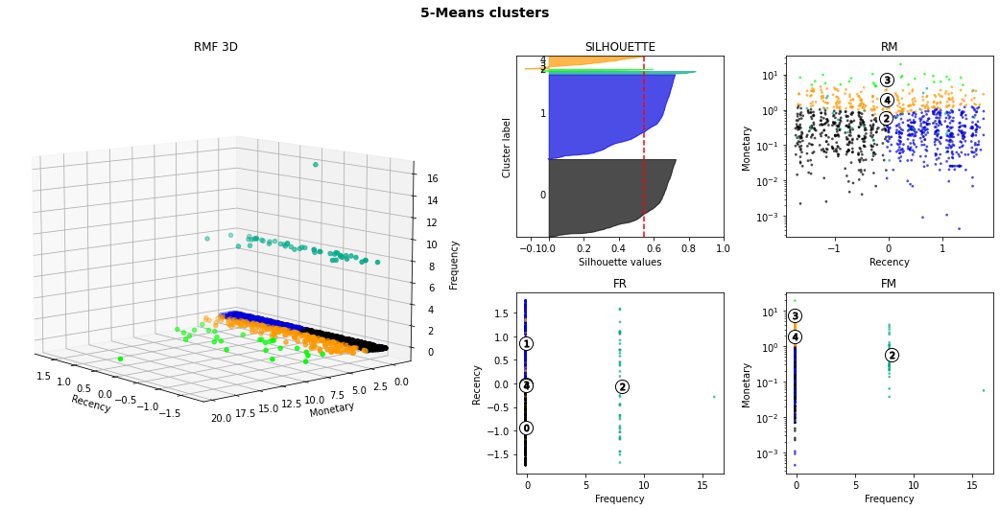

silhouette average : 0.546
k-means fit time : 1.588
silouhette compute time : 0.926


,R,F,M
customer_id,,,
002ed12115742033f015cb3c269ccf68,-0.704270,-0.121199,-0.230497
0036d365b138cc0ee06bed755bcb5044,-0.945649,-0.121199,-0.232029
00370dfde3d012c420d29657afc2fc8b,-0.462039,-0.121199,0.441589
0037aa56b017c105c3a9d47af71fff98,0.198950,-0.121199,1.533801
007a2fab7046647dad04fe7d08c57820,-1.703624,-0.121199,-0.142319
...,...,...,...
ff6a749412048de53e487708e585a0e4,1.123717,-0.121199,-0.505333
ff6de6cae279ba3f49b5d779351a9a1e,-0.199543,-0.121199,-0.242595
ff93b5e71bd5be1bbf74ac93c52adcf2,0.950045,-0.121199,1.087100


SLICE 25 :
start date: 2018-02-04 00:00:00
end date: 2018-02-19 00:00:00
# customers: 3352
# orders: 3425


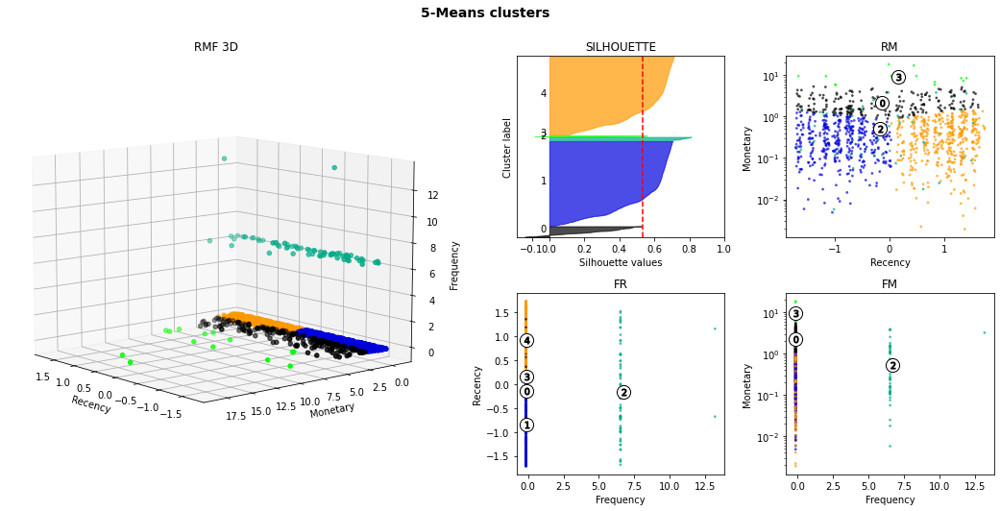

silhouette average : 0.532
k-means fit time : 1.883
silouhette compute time : 1.048


,R,F,M
customer_id,,,
0019da6aa6bcb27cc32f1249bd12da05,0.117995,-0.145196,-0.348040
002ef00822613c94613e60e03b169fef,-0.764841,-0.145196,-0.196846
004d17fa2cb102a7c4817f040c884e59,-0.403583,-0.145196,-0.623267
0055bbb9c95f6acb8db89d1f6c316407,-0.657152,-0.145196,-0.373765
006bbb235068a01d2e3e47fa09ccf53c,-0.976833,-0.145196,-0.656458
...,...,...,...
ffab104b9ba797387c58820356eb7551,1.418647,-0.145196,0.495214
ffb03435e357d6c137b5b24e34808df4,0.949355,-0.145196,-0.054150
ffb5431b49b42c9f3209f087e1bfdcfa,0.418706,-0.145196,-0.408449


SLICE 26 :
start date: 2018-02-19 00:00:00
end date: 2018-03-06 00:00:00
# customers: 3828
# orders: 3923


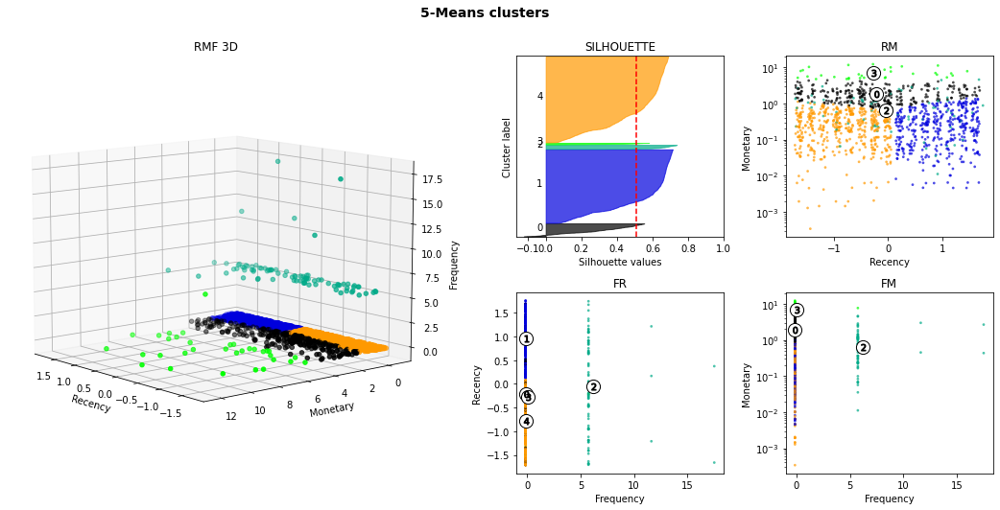

silhouette average : 0.511
k-means fit time : 1.888
silouhette compute time : 0.903


,R,F,M
customer_id,,,
00053a61a98854899e70ed204dd4bafe,-0.433896,-0.145974,1.446234
0010fb34b966d44409382af9e8fd5b77,-1.650966,-0.145974,-0.520479
00196fdb2bf9edfc35e88ebfbcf8d781,0.882391,-0.145974,-0.711988
002aba8c1af80acacef6e011f9f23262,-0.216708,-0.145974,0.337681
0058f300f57d7b93c477a131a59b36c3,1.597043,-0.145974,-0.422743
...,...,...,...
ff7bd992a7aac2c563a3e3773a8c63aa,0.001652,-0.145974,-0.695479
ff8fd64c1a5f9bebebc9bf3985dac068,-0.763121,-0.145974,-0.260180
ffa6acb325475c3f9816fa472652f1af,0.379277,-0.145974,0.189867


SLICE 27 :
start date: 2018-03-06 00:00:00
end date: 2018-03-21 00:00:00
# customers: 3537
# orders: 3574


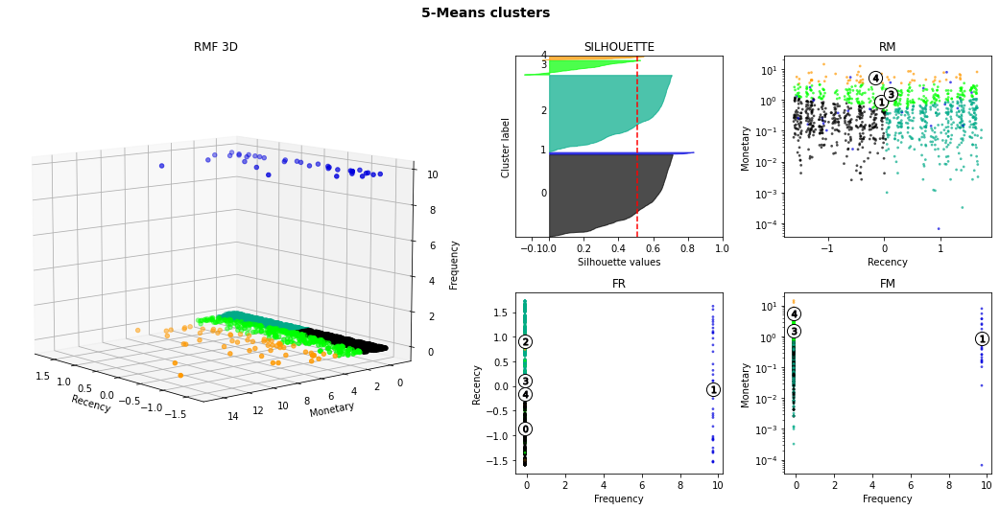

silhouette average : 0.508
k-means fit time : 1.431
silouhette compute time : 1.02


,R,F,M
customer_id,,,
0005ef4cd20d2893f0d9fbd94d3c0d97,0.254887,-0.102817,-0.172461
003ac9408252444b489b1bfc013f5f8c,-0.659982,-0.102817,-0.652868
0077dc76aaf02323f03bce9b00878253,0.460961,-0.102817,3.683324
007e21b7a007c8f8dadfa43c9d5a91db,0.629780,-0.102817,-0.478010
008b82b072c6b564fcce49a325f84097,0.669364,-0.102817,-0.610668
...,...,...,...
ffad6a7a0e13be3dfd9de96a81b77c9e,1.595161,-0.102817,-0.377403
ffbab763e1469af59b9882f0fc6e7d18,-0.354570,-0.102817,0.010216
ffbc87f67c513f71b9ffa68e72a2376e,-0.605943,-0.102817,-0.190895


SLICE 28 :
start date: 2018-03-21 00:00:00
end date: 2018-04-05 00:00:00
# customers: 3348
# orders: 3373


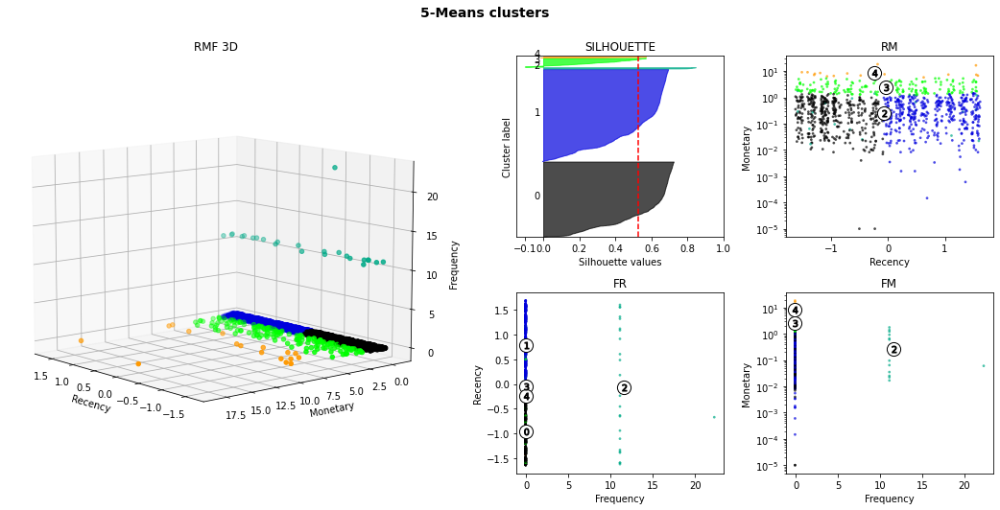

silhouette average : 0.526
k-means fit time : 1.475
silouhette compute time : 1.065


,R,F,M
customer_id,,,
00090324bbad0e9342388303bb71ba0a,0.886169,-0.08344,-0.463832
0023557a94bef0038066b5d1b3dc763e,-0.047519,-0.08344,-0.263031
0027324a96d26a2bc7d69262f83c8403,0.691242,-0.08344,-0.541254
003800162424b7b5b3d75c9cf22a66e7,-0.948556,-0.08344,-0.261334
004256f082951ec189a4962b6788c214,1.136450,-0.08344,0.432801
...,...,...,...
ff7bfe25f6e582f062fe91a506aef916,1.270426,-0.08344,-0.451311
ff7e7d4a4669fc03606a21eedad169e3,-0.000503,-0.08344,-0.616474
ff9584b796ae561b0085ebc998880a64,1.167278,-0.08344,-0.526256


SLICE 29 :
start date: 2018-04-05 00:00:00
end date: 2018-04-20 00:00:00
# customers: 3450
# orders: 3477


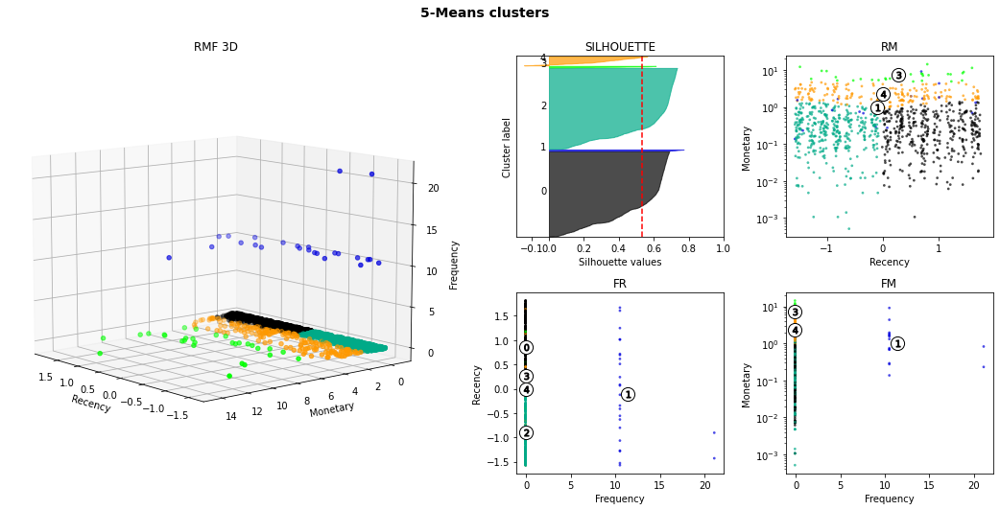

silhouette average : 0.534
k-means fit time : 1.665
silouhette compute time : 1.025


,R,F,M
customer_id,,,
0004bd2a26a76fe21f786e4fbd80607f,1.630499,-0.082844,-0.016135
002da6dde369f6a8b4c999ed61eb5a87,0.127681,-0.082844,-0.506588
003e2af81ea3c72fbdd093f07724a4de,-0.870401,-0.082844,-0.457970
00626f29f9b57d3ef7c1739ff03e944e,0.347725,-0.082844,-0.069417
006b297ed73773b17d8874a2eb4466e8,0.761160,-0.082844,-0.266582
...,...,...,...
ffbbb45b560b9ff08bdde6786987c796,0.733058,-0.082844,0.074338
ffc7d48d48327cf57757436b3f4706b0,-1.301986,-0.082844,0.163698
ffcd4b43c08405501a6bf2c66be83e83,-1.467557,-0.082844,-0.601126


SLICE 30 :
start date: 2018-04-20 00:00:00
end date: 2018-05-05 00:00:00
# customers: 3573
# orders: 3591


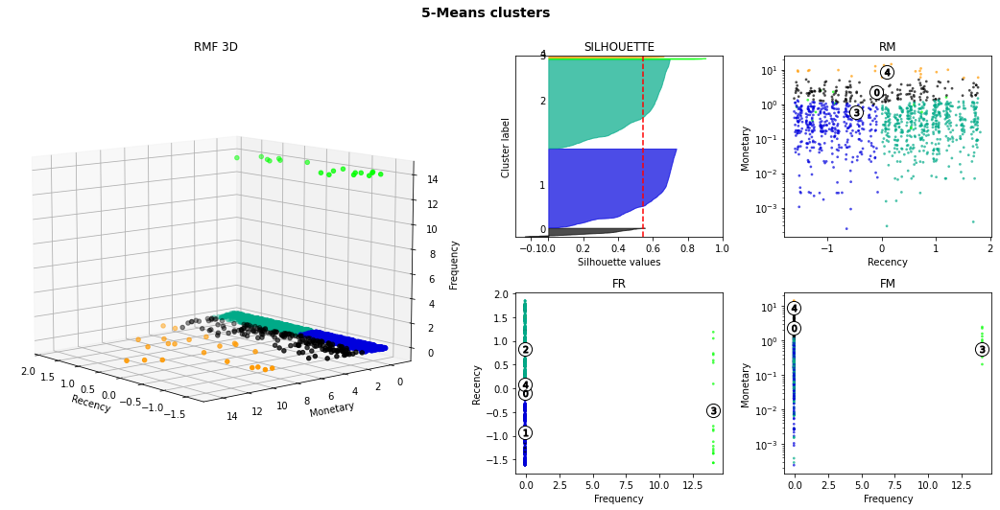

silhouette average : 0.543
k-means fit time : 1.557
silouhette compute time : 1.028


,R,F,M
customer_id,,,
00050ab1314c0e55a6ca13cf7181fecf,1.729093,-0.071157,-0.605509
000949456b182f53c18b68d6babc79c1,1.063694,-0.071157,-0.384646
0019e8c501c85848ac0966d45226fa1d,-0.783712,-0.071157,0.160626
003db7adfcdc49857b095a50191b6c9d,-1.046784,-0.071157,1.795163
004f84d065096f3cedd26cf0adc80b9d,0.471756,-0.071157,0.121867
...,...,...,...
ffc46f230cc7ce6109908f432eb9eb5b,-0.870937,-0.071157,0.551762
ffe76cb2f4bb39384c432d65ece67441,0.595688,-0.071157,-0.460318
ffecceca389973ef16660d58696f281e,0.579336,-0.071157,-0.428610


SLICE 31 :
start date: 2018-05-05 00:00:00
end date: 2018-05-20 00:00:00
# customers: 4048
# orders: 4071


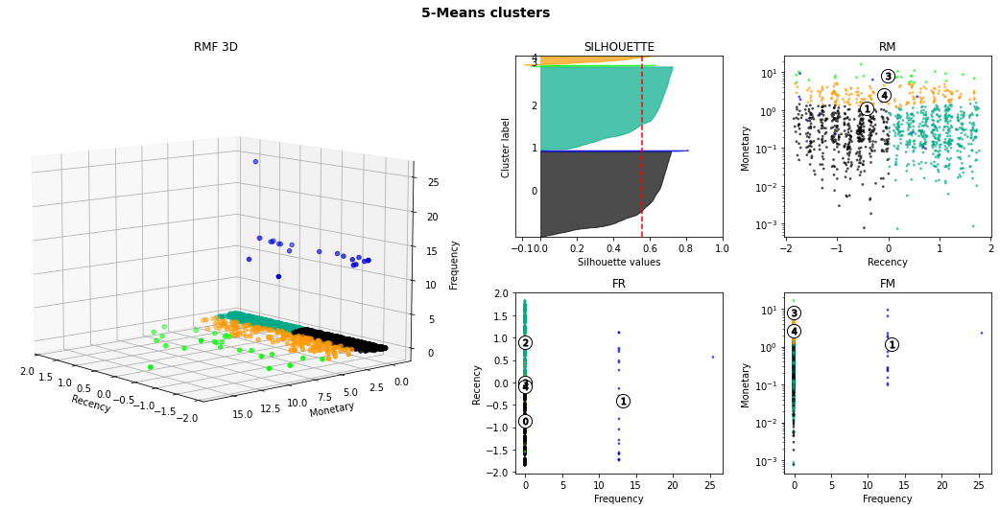

silhouette average : 0.559
k-means fit time : 1.756
silouhette compute time : 1.357


,R,F,M
customer_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.490698,-0.07249,-0.118007
0000b849f77a49e4a4ce2b2a4ca5be3f,1.224150,-0.07249,-0.611526
0034c76b7e6a17d738375b99afc2f01e,1.172092,-0.07249,-0.538215
0035029989e6fc5cf030918a5f9f2037,-0.036062,-0.07249,1.621077
003fee4ca17927283128c7ddc6f9311b,0.958860,-0.07249,-0.283345
...,...,...,...
ffca00fb352b5e57db50865d65098b4a,0.362640,-0.07249,-0.523673
ffcb3eb07f2a033d45949fcecd160d98,-0.074444,-0.07249,0.158116
ffd2e2ad95719ab7fedc9e02c5e26a62,-1.287981,-0.07249,-0.538215


SLICE 32 :
start date: 2018-05-20 00:00:00
end date: 2018-06-04 00:00:00
# customers: 2184
# orders: 2198


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


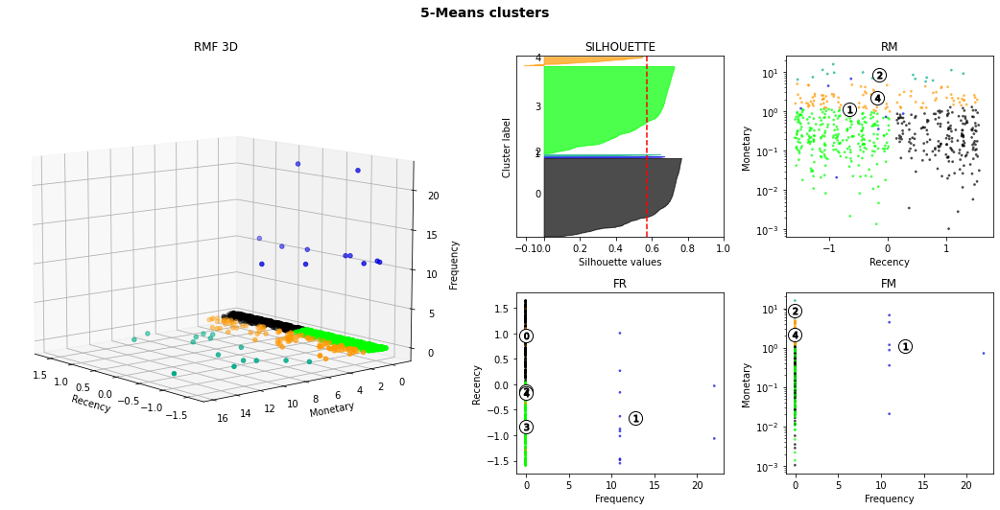

silhouette average : 0.574
k-means fit time : 1.498
silouhette compute time : 0.437


,R,F,M
customer_id,,,
000ed48ceeb6f4bf8ad021a10a3c7b43,1.496346,-0.070787,-0.573994
001a3a8e11d76c9a366c31a4aa2cc529,1.415808,-0.070787,-0.561259
00256bf7b05c08f6a5849df3d0a64f1f,-1.100150,-0.070787,-0.438671
004b45ec5c64187465168251cd1c9c2f,0.174295,-0.070787,-0.467507
005f060d4223956c62b64e9567a36f0f,1.009996,-0.070787,2.195887
...,...,...,...
ff325a460cc15654fa42b324fe0ab64b,1.311349,-0.070787,-0.344698
ff61f2506ff81e50510d8c0ac5570c30,0.243003,-0.070787,-0.184418
ffb1cf5736b51e47fec82cf40dd26303,0.023334,-0.070787,0.329539


SLICE 33 :
start date: 2018-06-04 00:00:00
end date: 2018-06-19 00:00:00
# customers: 3186
# orders: 3198


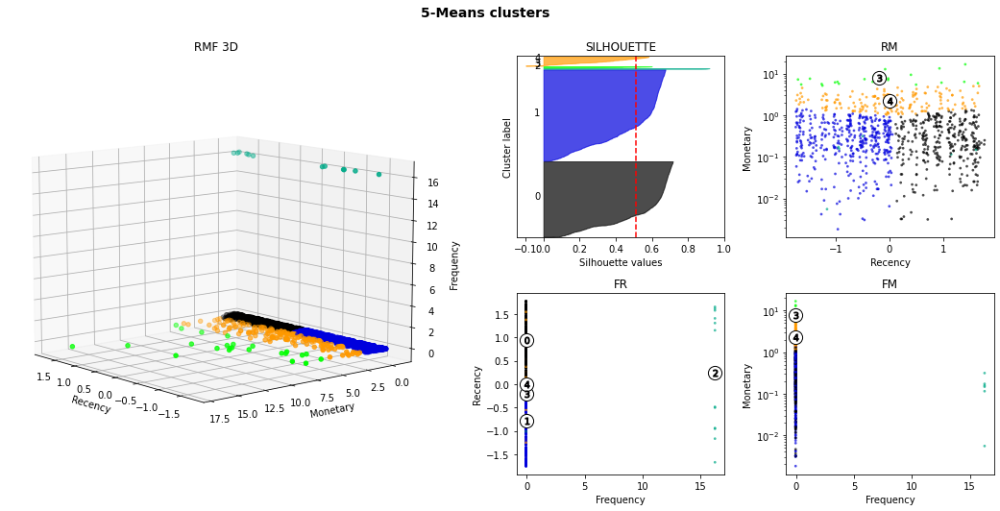

silhouette average : 0.51
k-means fit time : 1.784
silouhette compute time : 0.776


,R,F,M
customer_id,,,
004493e0b0a37317d25665d340c0677d,1.127306,-0.061488,-0.379349
006c10bfead12ac8d90486fb4ce4e603,-0.809696,-0.061488,-0.405965
007ba48697b079e78f168b051462dd1b,1.067767,-0.061488,-0.098096
0098853a28531d48988a2fb02b30840e,0.712782,-0.061488,-0.396540
00c05fe9d2f8b245f1f86fe559175f24,-0.732365,-0.061488,0.953263
...,...,...,...
ffa323b33234124b58b25511035c2855,-0.740120,-0.061488,0.571919
ffb52634b4c16223ff808f266332de04,0.711461,-0.061488,-0.369663
ffcb7bc68d6ec38fece3546240bd01e5,0.745336,-0.061488,-0.537603


SLICE 34 :
start date: 2018-06-19 00:00:00
end date: 2018-07-04 00:00:00
# customers: 3011
# orders: 3023


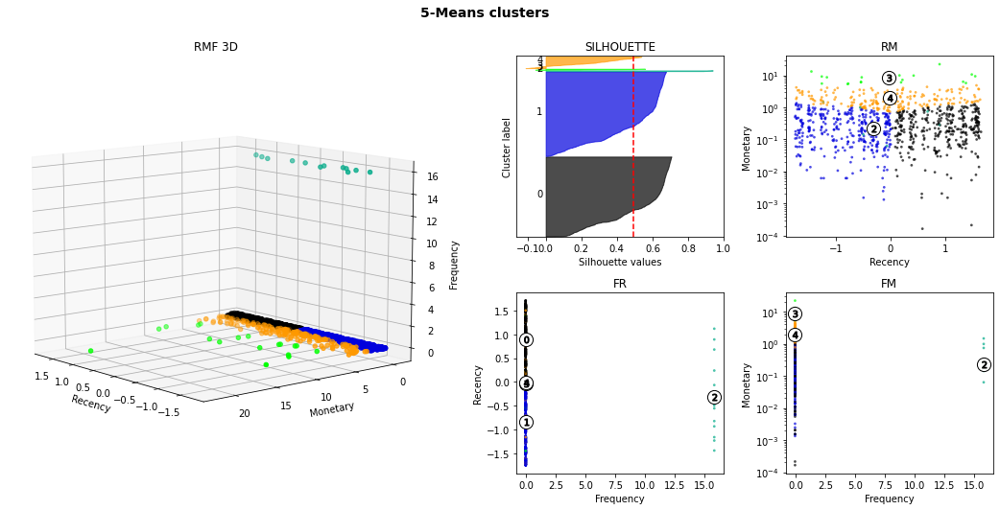

silhouette average : 0.494
k-means fit time : 1.674
silouhette compute time : 0.709


,R,F,M
customer_id,,,
000e309254ab1fc5ba99dd469d36bdb4,0.231421,-0.063256,-0.382591
001deb796b28a3a128d6113857569aa4,0.863957,-0.063256,-0.456253
002311514717ca8b65b09a26cdf7b91a,-0.246310,-0.063256,-0.158531
0033f4a2887e07e25aa1204d482f41ba,0.085016,-0.063256,1.309426
0045e9ad4d6c85d2323a7ab374b76183,1.488100,-0.063256,-0.647606
...,...,...,...
ffc4233210eac4ec1711a8b847196d4e,1.567815,-0.063256,-0.302779
ffd2aac179372f267e7b9186ac7a1bcc,1.573401,-0.063256,-0.623199
ffeb904468642a1ce663a322629801cb,-0.250015,-0.063256,-0.310882


SLICE 35 :
start date: 2018-07-04 00:00:00
end date: 2018-07-19 00:00:00
# customers: 2532
# orders: 2559


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=10.
  warnings.warn(


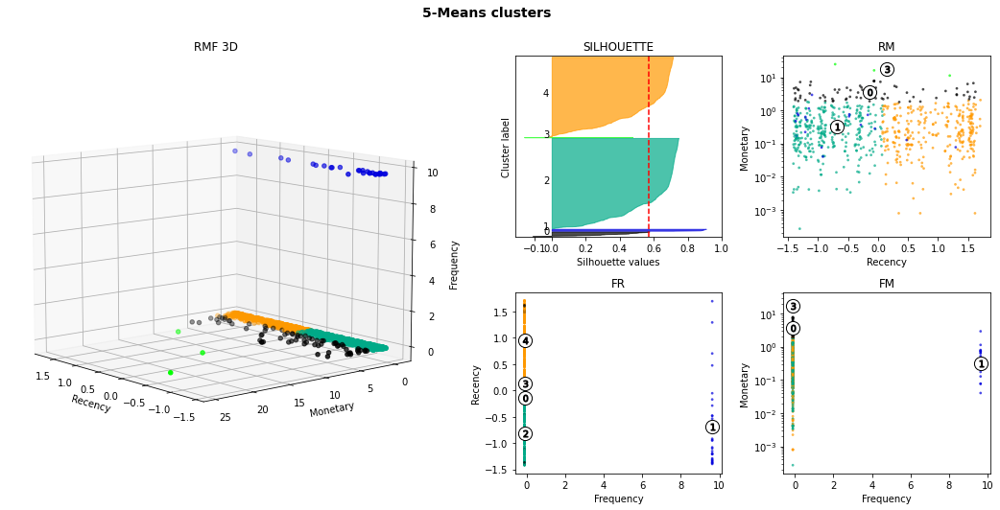

silhouette average : 0.569
k-means fit time : 1.796
silouhette compute time : 0.595


,R,F,M
customer_id,,,
001a34eb30ecb8e3aacb07c475ca4dd1,0.075734,-0.103819,-0.053299
003162bf0351f47a1a247992b8b9b42d,-0.514895,-0.103819,1.251586
0032ca69771a7758ce643258bb9e4ac7,-0.930436,-0.103819,-0.398794
00344274804f3b8003de1b0562ae01df,0.542446,-0.103819,0.171277
004df63539fd5e38d4b0a0506de7549c,-0.912649,-0.103819,2.842099
...,...,...,...
ff6c9c45f6cee4ec0785650b18322d73,-1.369121,-0.103819,4.844101
ff8a98860a86a0f563a92a43b3344414,-1.130242,-0.103819,-0.206902
ffb6123b45cfa6e6ff5ff94d404283b7,0.478416,-0.103819,-0.529008


SLICE 36 :
start date: 2018-07-19 00:00:00
end date: 2018-08-03 00:00:00
# customers: 3744
# orders: 3774


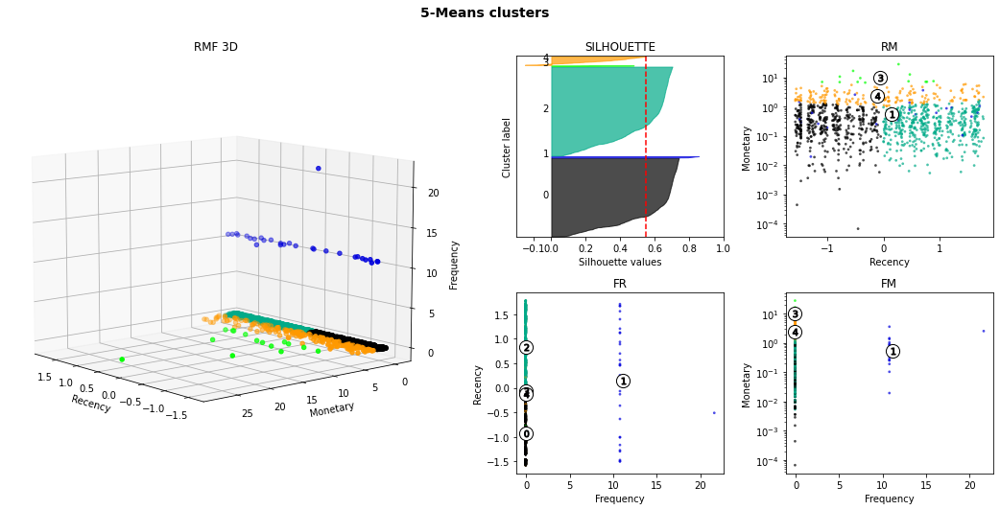

silhouette average : 0.549
k-means fit time : 1.718
silouhette compute time : 1.029


,R,F,M
customer_id,,,
000fbf0473c10fc1ab6f8d2d286ce20c,0.118426,-0.086999,0.810522
0015752e079902b12cd00b9b7596276b,-1.530424,-0.086999,-0.379016
00172711b30d52eea8b313a7f2cced02,-0.242447,-0.086999,-0.183559
00196c4c9a3af7dd2ad10eade69c926f,-0.327283,-0.086999,-0.533066
0025795df7a7d077c4c90162fa820085,0.553145,-0.086999,0.197055
...,...,...,...
ffc39051848c3ef2be36d1513aa3ad17,-1.259681,-0.086999,-0.519497
ffdf771c03dd683f1ed7017ae4e9efb2,-0.399931,-0.086999,-0.480116
ffe96c782a5bc522bd8bad3bc638981a,-0.820101,-0.086999,0.325871


SLICE 37 :
start date: 2018-08-03 00:00:00
end date: 2018-08-18 00:00:00
# customers: 4274
# orders: 4296


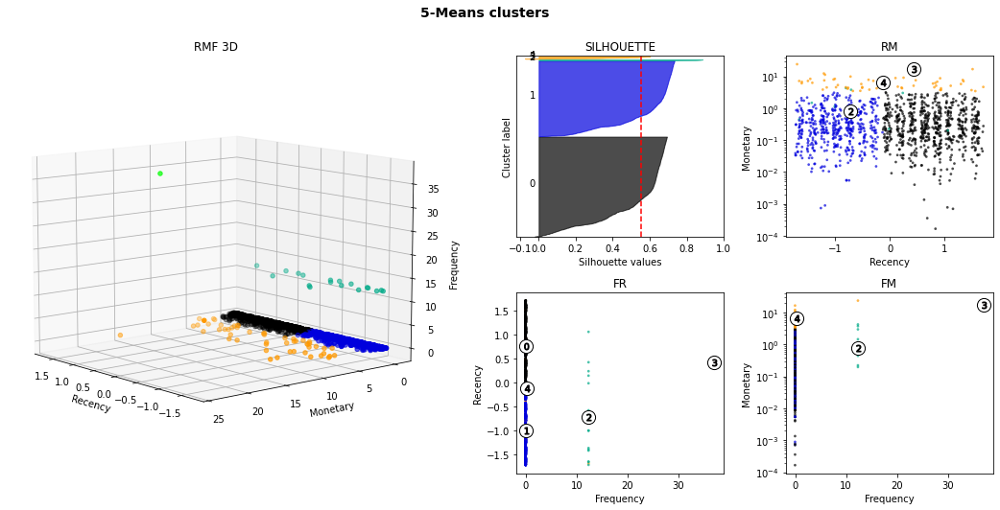

silhouette average : 0.553
k-means fit time : 1.481
silouhette compute time : 1.492


,R,F,M
customer_id,,,
00172711b30d52eea8b313a7f2cced02,-0.667879,-0.063724,-0.164754
002471155ecd08d208d1376720e2a907,0.369222,-0.063724,-0.279660
00391594070baf8603f5fdc1d0c6a48c,1.057115,-0.063724,-0.175326
003a7a8eb096ed3cbf713d2def1ca701,-0.946323,-0.063724,-0.028703
003ae409f37c3c30cb1c974af3a42692,-1.149008,-0.063724,0.197573
...,...,...,...
ffb3cbd5e1e507679e2db84c515410a5,-1.232895,-0.063724,-0.208733
ffb572185af25751289ac38f38c7e2f9,1.124214,-0.063724,-0.134768
ffe204b1bb8026741b839085b2fd10f2,0.193476,-0.063724,-0.031625


SLICE 38 :
start date: 2018-08-18 00:00:00
end date: 2018-09-02 00:00:00
# customers: 1596
# orders: 1603


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


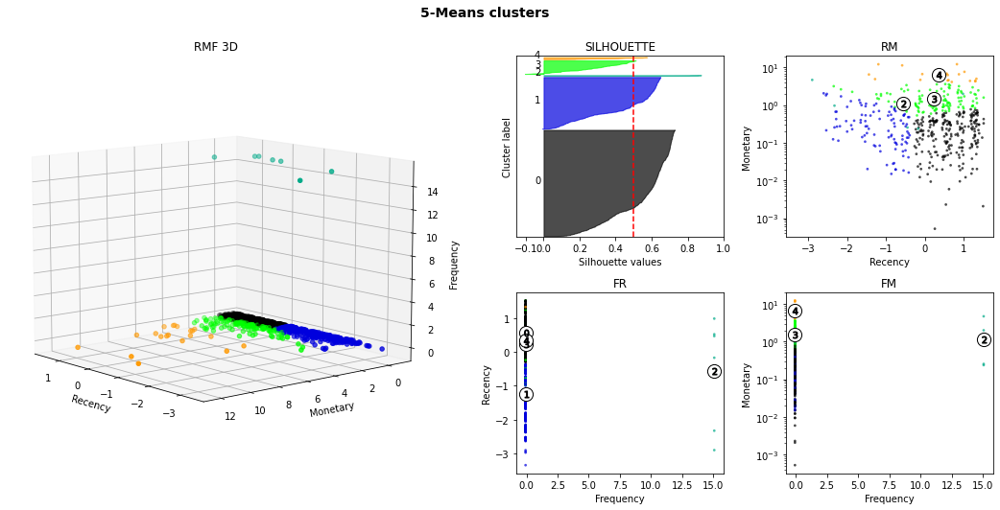

silhouette average : 0.5
k-means fit time : 1.689
silouhette compute time : 0.252


,R,F,M
customer_id,,,
000ec5bff359e1c0ad76a81a45cb598f,0.282524,-0.066372,-0.622394
001928b561575b2821c92254a2327d06,-0.929293,-0.066372,0.140518
0057f64bff87f4698b4cbd338d62a2a8,0.294096,-0.066372,-0.315637
008b06aba4b5f5b5b94f525ccf520624,-0.062206,-0.066372,-0.273111
00a33236962b4ac37fd25275be9c206b,0.907572,-0.066372,-0.126495
...,...,...,...
ff22e30958c13ffe219db7d711e8f564,-0.866340,-0.066372,0.149703
ff2959dedacc441cc5ffe7d747a1a299,1.332668,-0.066372,5.030540
ff36be26206fffe1eb37afd54c70e18b,-0.445100,15.066519,0.255796


In [10]:
machin(
    step_in_days = 15,
    from_date=earliest_relevant_date,
    to_date=latest_relevant_date,
    normalize=True
)

### Version avec accumulation

(toutes les commandes jusqu'à une certaine date)

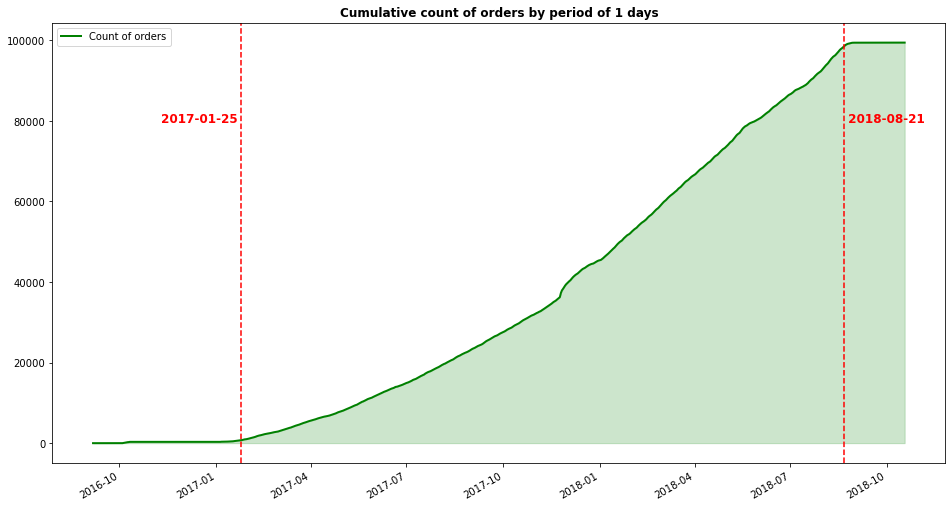

In [11]:
# il faut repartir de time_sclicing et lui ajouter un paramètre accumulate
from olist_commons import (
    get_first_order_date,
    get_last_order_date,
    get_earliest_relevant_date,
    get_latest_relevant_date,
    get_time_slices_dict,
    show_orders_by_period
)

step_in_days = 1
earliest_relevant_date = get_earliest_relevant_date()  # datetime(2017, 1, 25)
latest_relevant_date = get_latest_relevant_date()  # datetime(2018, 8, 21)

# Time, orders and customers indexes slicing
time_slices = get_time_slices_dict(
    get_first_order_date(),
    get_last_order_date(),
    step_in_days,
    cumul=True
)
# Show business activity
show_orders_by_period(
    time_slices, step_in_days,
    earliest_relevant_date,
    latest_relevant_date,
    cumul=True
)

#### Avec accumulation et sans normalisation

# slices: 39
SLICE 0 :
start date: 2017-01-25 00:00:00
end date: 2017-02-09 00:00:00
# customers: 1014
# orders: 1034


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


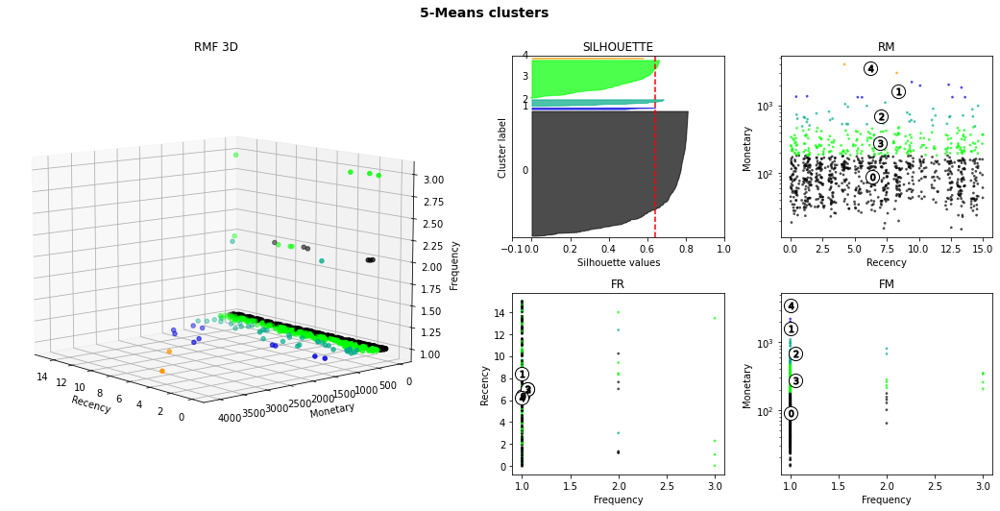

silhouette average : 0.64
k-means fit time : 1.255
silouhette compute time : 0.09


,R,F,M
customer_id,,,
002b4cd83fabaffaa475f78ea5ef3e08,7.421343,1,64.42
0071f46a072a9ae25bbe4438b15efe9c,7.997025,1,174.54
008f3d5f45a11059239a5c452cd00006,13.616933,1,336.56
012e12f54f6e73b1faba89a119dab849,10.196053,1,105.74
0284ca4015977edc8413c917b8e68355,1.619942,1,66.73
...,...,...,...
fe810d4870b11964c5d0ae1817aaa97b,14.154479,1,210.08
fec0f9b88ab21b6b9bd1961500e83665,12.941412,1,239.64
fee302f7605a1022d1a885fa5e2cad6e,5.595602,1,262.26


SLICE 1 :
start date: 2017-02-09 00:00:00
end date: 2017-02-24 00:00:00
# customers: 1893
# orders: 1927


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


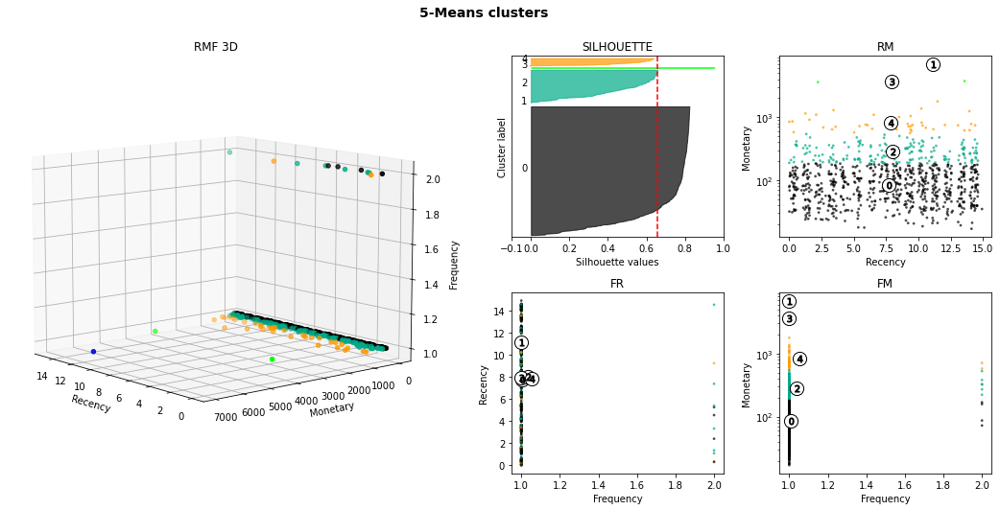

silhouette average : 0.656
k-means fit time : 1.302
silouhette compute time : 0.092


,R,F,M
customer_id,,,
0087eede471173af78d789df249c3a45,7.158299,1,151.11
012b8001e47392df808a454083a74b74,13.581863,1,98.84
01469c41b00bb21cd01d2104b8e81384,12.226759,1,111.01
016feebfaba953a2456d3a063b8eb8ef,10.492373,1,62.83
019d47513bb1164cc83fc2d6d7123ef8,13.098889,1,208.16
...,...,...,...
fe97a20a987dd0adc99328b52be73c4c,11.140729,1,22.86
ff28720521c749234b1ba19c9c986f4c,8.524144,1,192.96
ff3bcc94d97e257e7619a2161375cdfe,14.410880,1,84.16


SLICE 2 :
start date: 2017-02-24 00:00:00
end date: 2017-03-11 00:00:00
# customers: 2969
# orders: 3024


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


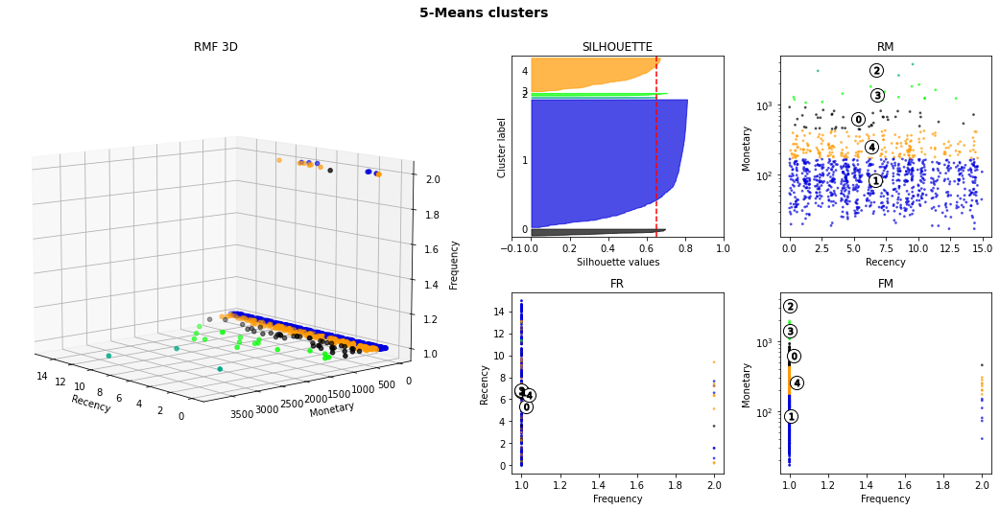

silhouette average : 0.648
k-means fit time : 1.405
silouhette compute time : 0.167


,R,F,M
customer_id,,,
0000f46a3911fa3c0805444483337064,0.121493,1,86.22
0005e1862207bf6ccc02e4228effd9a0,6.019306,1,150.12
00446a03d7a34d191507c9e42870d0a5,4.160567,1,128.95
0049db44bfd6cee26ac9c649329ff6ea,3.438252,1,109.04
0055b522bc89cbfbf376d8b59a628470,7.341007,1,364.75
...,...,...,...
fef01b6698bae7394677113b5e647eda,1.273310,1,65.10
ff4050535c1351cd0b834ccf1c9d07f1,8.688472,1,33.10
ff9bc66daa6702543b16f3c4897e300b,4.452488,1,97.99


SLICE 3 :
start date: 2017-03-11 00:00:00
end date: 2017-03-26 00:00:00
# customers: 4288
# orders: 4364


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


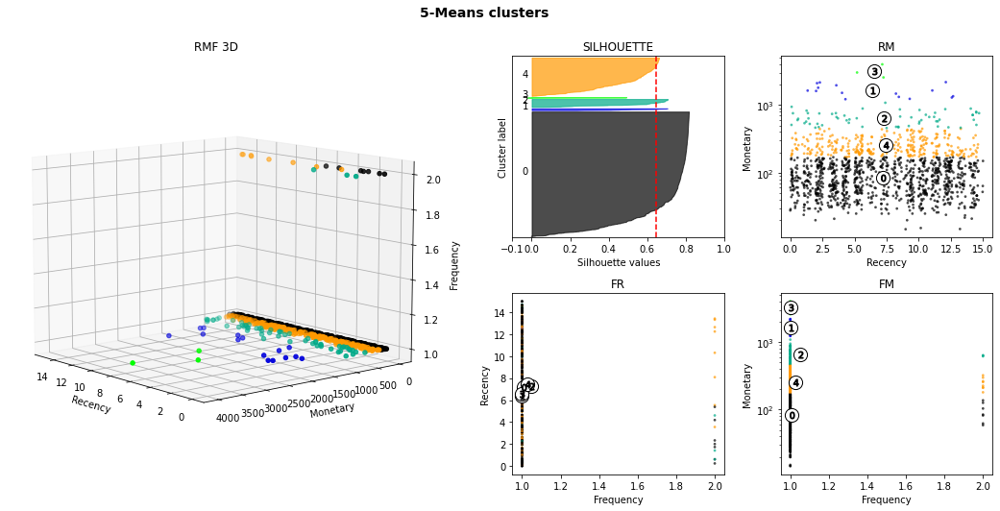

silhouette average : 0.644
k-means fit time : 1.53
silouhette compute time : 0.184


,R,F,M
customer_id,,,
001f3c4211216384d5fe59b041ce1461,6.225972,1,35.84
003e28cb6fab8a0901bff9229612375f,12.378970,1,137.26
0096c18412349537abc45e350581cbbc,11.268426,1,770.24
00c003ed13c76042b78d53fbc26930d0,9.149190,1,204.24
00c3624c55261d9ce593f30e3815a880,7.524931,1,414.06
...,...,...,...
ff51a896842f2bdced342631e2699d49,14.653576,1,106.23
ff64dc057067aecad9bf2c94b272e90a,3.179306,1,181.56
ffa17ff63f95ea3c838670e61d2666e0,12.350799,1,84.16


SLICE 4 :
start date: 2017-03-26 00:00:00
end date: 2017-04-10 00:00:00
# customers: 5474
# orders: 5579


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


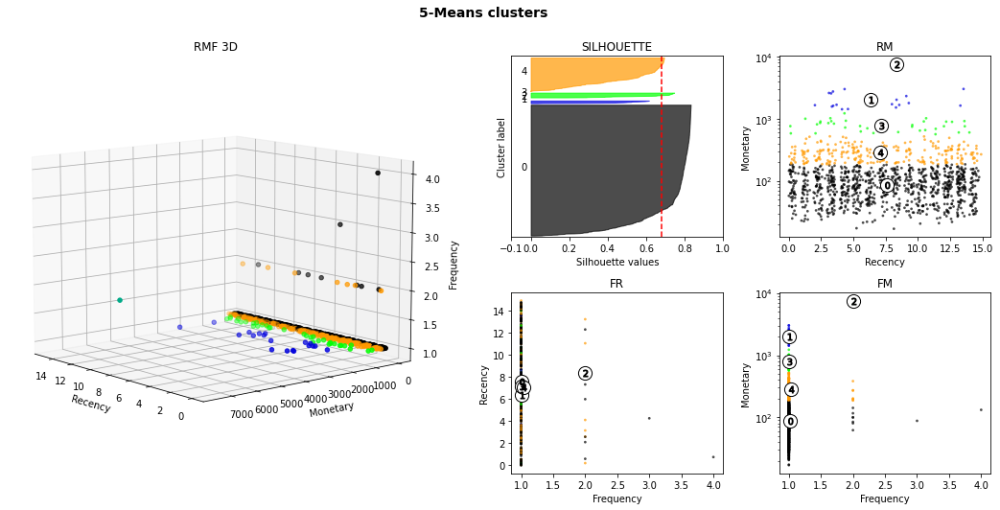

silhouette average : 0.682
k-means fit time : 1.55
silouhette compute time : 0.152


,R,F,M
customer_id,,,
002043098f10ba39a4600b6c52fbfe3c,14.301400,1,237.81
0037d2bbb9ebc39d9114aea27ee16d72,13.483009,1,143.73
00522457bba00bba576a34fd9b4808fd,8.430417,1,127.98
00842c7d0cedb9e1edad8e9b7d148f09,4.106296,1,64.55
00941614a654458b888b8780815bd26c,11.561424,1,185.83
...,...,...,...
ff7014eeb94589da99e822e2618090fa,8.431678,1,72.71
ff8d27e48d6492ebb97e3052142c47bf,1.119896,1,295.00
ff959aedd362b48bb97c0abeb0b36b62,11.389225,1,91.66


SLICE 5 :
start date: 2017-04-10 00:00:00
end date: 2017-04-25 00:00:00
# customers: 6583
# orders: 6708


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


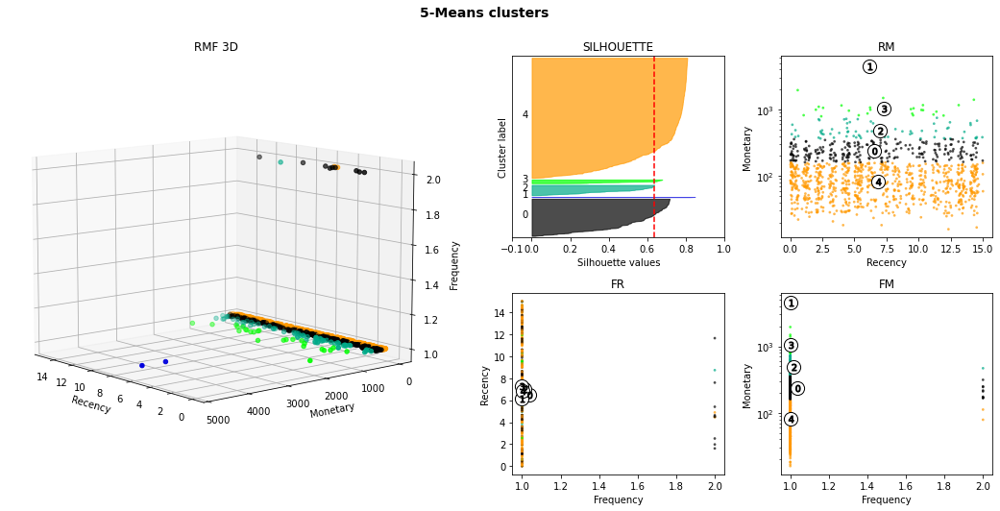

silhouette average : 0.637
k-means fit time : 1.25
silouhette compute time : 0.11


,R,F,M
customer_id,,,
0011805441c0d1b68b48002f1d005526,0.432778,1,297.14
00191a9719ef48ebb5860b130347bf33,5.519340,1,58.86
0043d65f8039b4a4d43bc7b0f450ac2c,4.460255,1,64.42
007953b3182d5ccc9189a694f5c68163,9.083090,1,112.08
0098f4847541cc7d676f9a5efc64c0f0,7.217998,1,147.55
...,...,...,...
fe7780b2659c715218834f592a838f6a,11.999456,1,99.62
ff253dd048167b1feddeb431db05d3d5,0.642118,1,126.81
ff580ab4901e3619925a27db44eec095,13.468681,1,66.62


SLICE 6 :
start date: 2017-04-25 00:00:00
end date: 2017-05-10 00:00:00
# customers: 8144
# orders: 8304


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


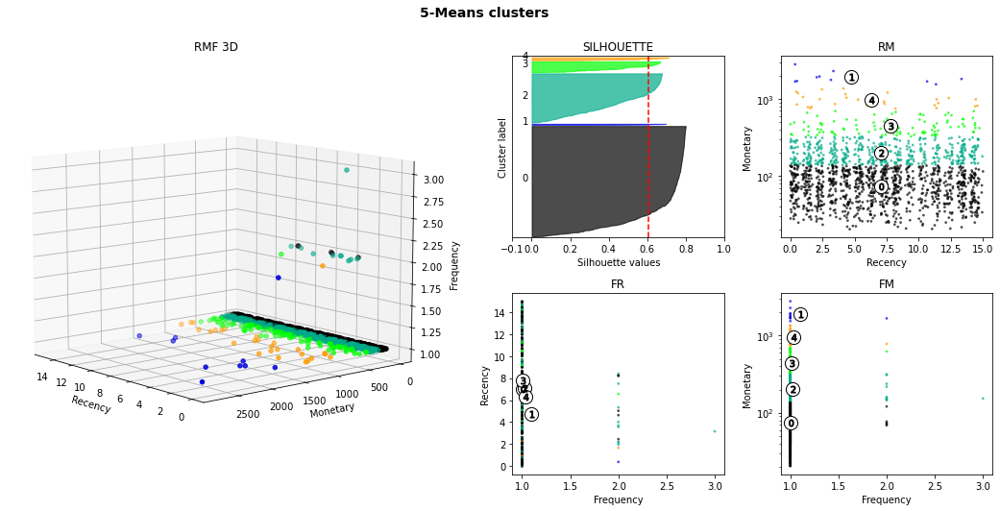

silhouette average : 0.607
k-means fit time : 1.562
silouhette compute time : 0.207


,R,F,M
customer_id,,,
00ac9cd5c4ad19e16e7c6f6864711737,11.402697,1,231.45
011509f63f565e822767bfb89c3cf9b7,0.376100,1,69.07
011fd4914a2d19b2a0e50c29cea5c6a2,3.126076,1,261.90
0139884762afa50d78fe480646fe92b5,6.646713,1,70.79
015557c9912277312b9073947804a7ba,8.382951,1,72.90
...,...,...,...
ff6eae41d4cbdc5af3844a39a89431e6,12.991053,1,143.48
ff86fefe11696b1e957173516339bcd8,8.374271,1,21.95
ffaa5b5559566bb4dbf71d554310e760,4.300752,1,115.73


SLICE 7 :
start date: 2017-05-10 00:00:00
end date: 2017-05-25 00:00:00
# customers: 9985
# orders: 10201


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


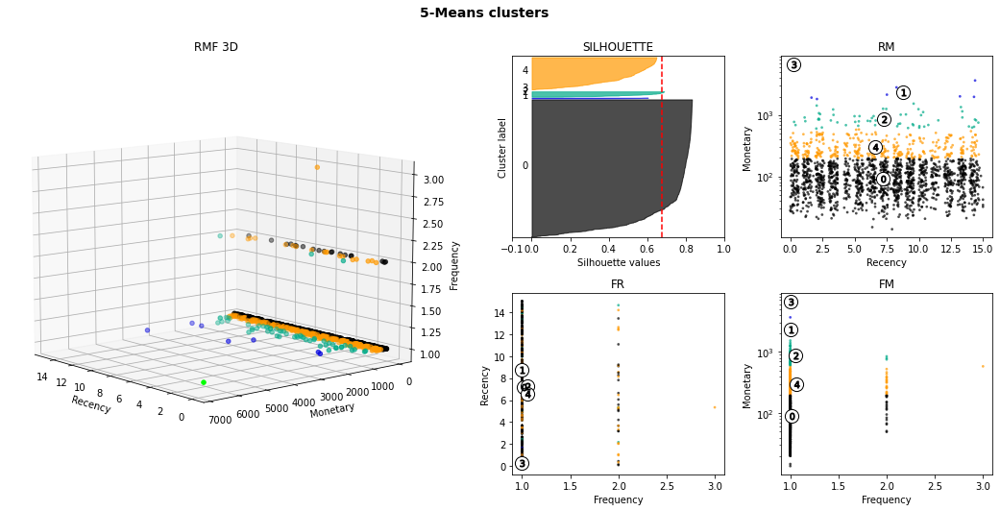

silhouette average : 0.675
k-means fit time : 1.601
silouhette compute time : 0.366


,R,F,M
customer_id,,,
002d71b244beb91ca7030b15ab526446,2.066076,1,130.56
0036a074f98b80c4f1fc33dbbcf9c552,12.608032,1,42.62
00dd4390a8e8ad7a126e8331decc49ce,13.615775,1,109.31
016846e2dd862cba9a2a10eff5ac244f,12.351366,1,474.96
0178b244a5c281fb2ade54038dd4b161,14.163785,1,102.03
...,...,...,...
ff5017601705e932d5545e0eb337cd0b,11.239711,1,158.20
ff70aa1b53f643263ead50eed3166164,7.488542,1,51.75
ff8892f7c26aa0446da53d01b18df463,0.326921,1,263.40


SLICE 8 :
start date: 2017-05-25 00:00:00
end date: 2017-06-09 00:00:00
# customers: 11687
# orders: 11953


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


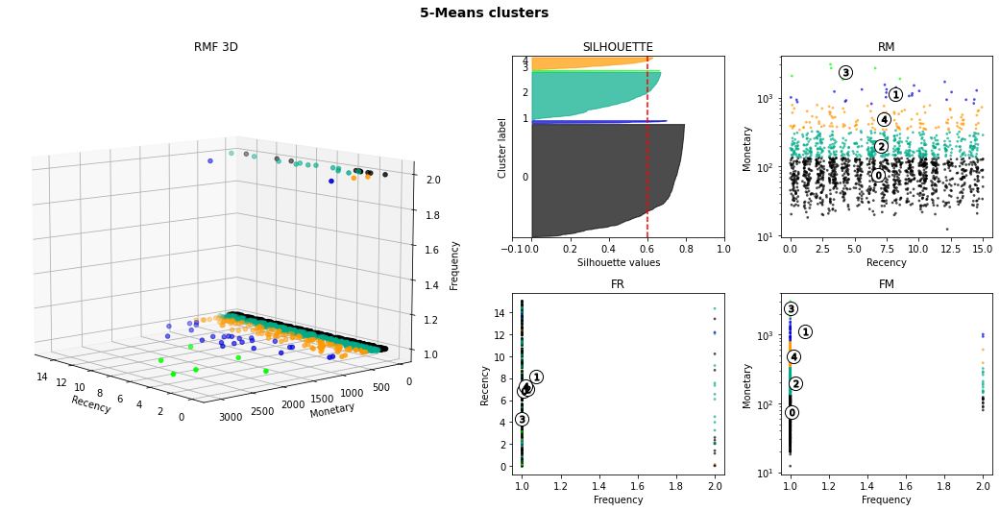

silhouette average : 0.601
k-means fit time : 1.607
silouhette compute time : 0.271


,R,F,M
customer_id,,,
008fb2ecc75561d202dd4db2e0ceec25,8.054109,1,40.77
0103751df12aea8b962cfbcd2b61104c,13.021447,1,35.00
01051cf3719a23faec8b2307b369faeb,12.126123,1,147.96
0189955e61056a22dd6e7cb03603a149,0.008229,1,111.81
0189cca3aa2a0f75ca0cde94ee38be57,3.102326,1,100.33
...,...,...,...
ff4136190ebc2a5c0bff70b569fe9180,3.520775,1,51.75
ffd44de1326179fff550dae07c6884c2,10.262755,1,121.50
ffe4c3aa14d4702fb11fe5b3c4dd755c,14.445312,1,137.30


SLICE 9 :
start date: 2017-06-09 00:00:00
end date: 2017-06-24 00:00:00
# customers: 13167
# orders: 13486


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


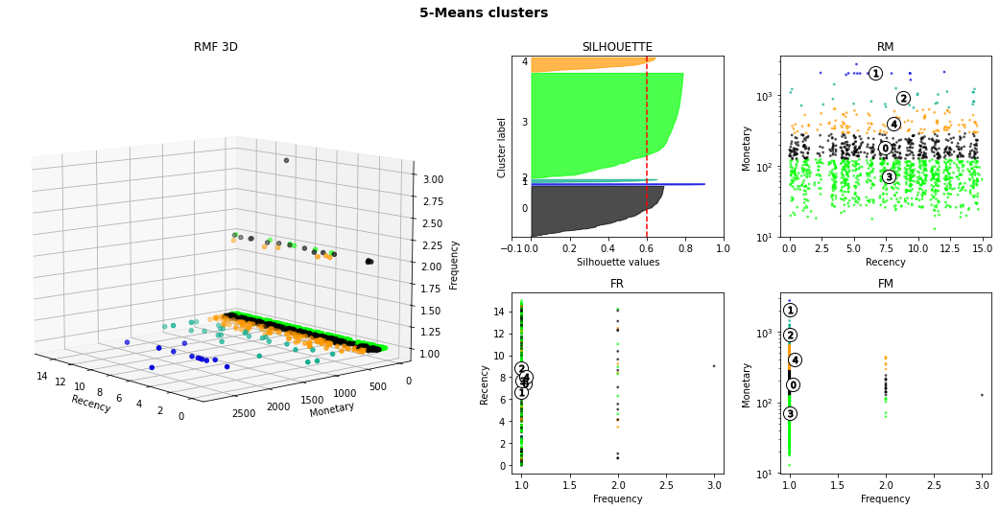

silhouette average : 0.6
k-means fit time : 1.608
silouhette compute time : 0.214


,R,F,M
customer_id,,,
00324c9f4d710e7bac5c5ba679714430,2.138449,1,109.78
00444f48f6c9b55657e49435ce3a97ca,14.322477,1,52.38
0049dadc30da6a277c1e9d371df5a66f,10.173623,1,26.01
0059acd36094bf670ec8b21be6c0044c,11.091285,1,46.69
009301957bc7714394865c44650d8060,0.516887,1,93.78
...,...,...,...
ff9e11d25bd3a13105fbf416eee813c5,10.167847,1,171.85
ffbb8dfaa0e54649d8690b85a3ef890d,4.544306,1,29.47
ffbf790cac0b6cf2e411d9f158c0fbe2,13.996331,1,134.83


SLICE 10 :
start date: 2017-06-24 00:00:00
end date: 2017-07-09 00:00:00
# customers: 14780
# orders: 15144


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


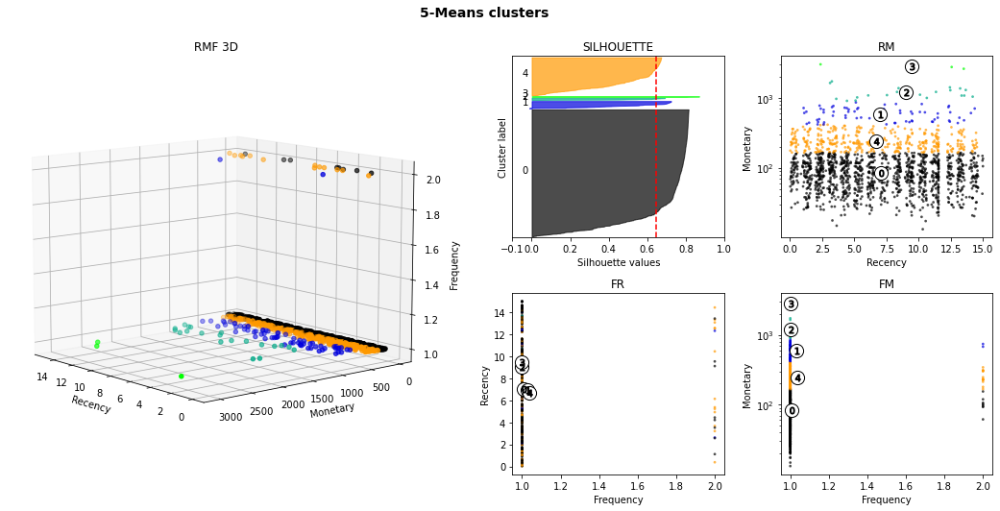

silhouette average : 0.647
k-means fit time : 1.622
silouhette compute time : 0.287


,R,F,M
customer_id,,,
0011857aff0e5871ce5eb429f21cdaf5,10.535671,1,192.83
001a2bf0e46c684031af91fb2bce149d,9.052905,1,36.73
00a6ee75a90222405df9d8d59babc513,2.045625,1,60.05
00cd767526517f8a4fc27db6cc5a52fa,11.532755,1,95.21
00d7e54ab8c5d9916f19209dbaacbb3d,7.577998,1,92.05
...,...,...,...
ff095a5f37e0c0199dfd3f2359ecf6b8,8.396331,1,104.19
ff423b634e7bbec16b9f1466f126eb18,4.694236,1,180.25
ff4aa52d77226e6f84a7da6391604266,10.173287,1,187.94


SLICE 11 :
start date: 2017-07-09 00:00:00
end date: 2017-07-24 00:00:00
# customers: 16733
# orders: 17160


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


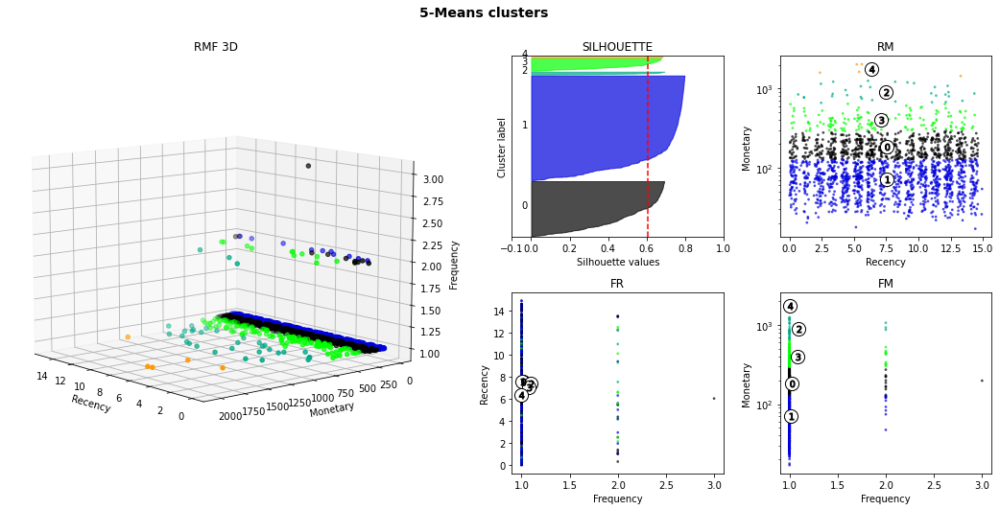

silhouette average : 0.608
k-means fit time : 1.657
silouhette compute time : 0.374


,R,F,M
customer_id,,,
0006fdc98a402fceb4eb0ee528f6a8d4,5.608912,1,29.00
0010a452c6d13139e50b57f19f52e04e,12.525891,1,325.93
002eb8b96288f3804e21d2777ac29895,1.441597,1,137.99
0037eb1ff742ee2e71ba887f65f3c6f3,10.624757,1,228.79
008778a1591d49f6b2464dffaa4fa662,4.178310,1,260.55
...,...,...,...
ff73dbd0440a0f1fac45e49efd6398b4,3.070359,1,27.77
ff84c3cbb72d9419e3f76a6029f6f07d,11.024329,1,341.33
ff983093f2d26e43569f7d58782faffb,5.295081,1,74.16


SLICE 12 :
start date: 2017-07-24 00:00:00
end date: 2017-08-08 00:00:00
# customers: 18733
# orders: 19228


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


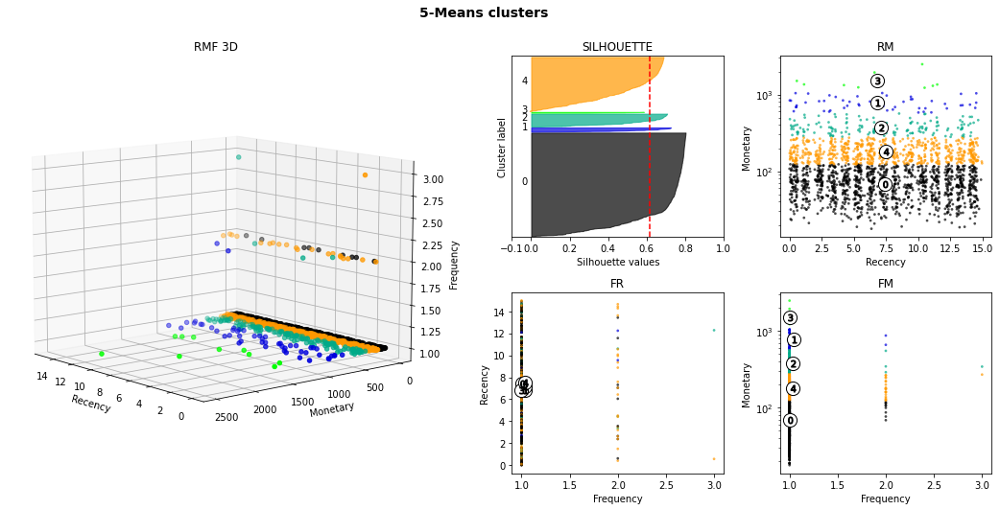

silhouette average : 0.614
k-means fit time : 2.179
silouhette compute time : 0.437


,R,F,M
customer_id,,,
0011c98589159d6149979563c504cb21,2.410567,1,117.94
004288347e5e88a27ded2bb23747066c,11.407604,1,251.09
0046311f458d8041b00063cb99482903,6.191308,1,112.33
004ed862ea4e55f18868d3d782d10879,1.142940,1,109.29
006d763076d74d16d66e828e79ec1544,2.567442,1,99.32
...,...,...,...
ff95640b1b541ba71eaa077fd1853ca0,3.549398,1,61.75
ff9c5dff16d7d6bfefc2acf5088d7b90,2.567384,1,73.34
ffcdafd7d9f69caf44c3aa1ff78c32b4,10.265937,1,89.57


SLICE 13 :
start date: 2017-08-08 00:00:00
end date: 2017-08-23 00:00:00
# customers: 20805
# orders: 21369


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


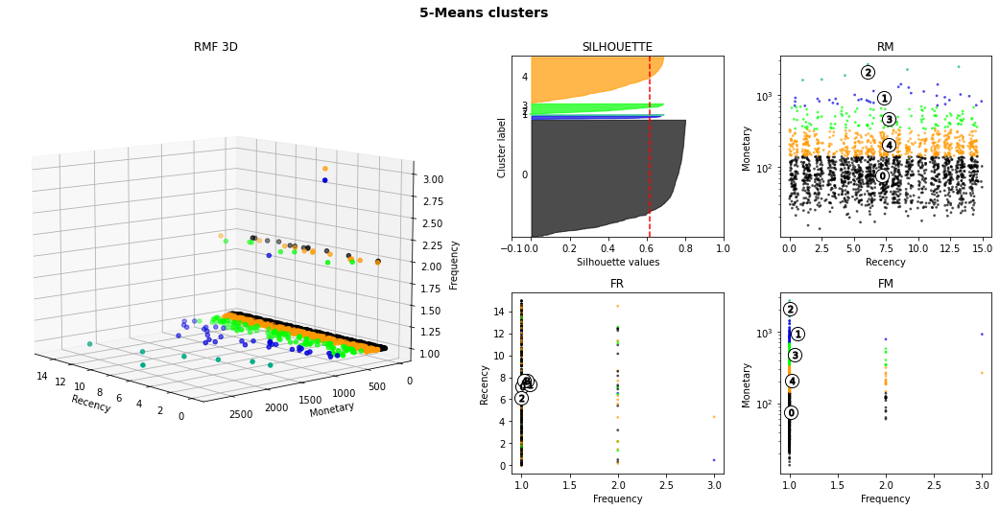

silhouette average : 0.614
k-means fit time : 1.572
silouhette compute time : 0.437


,R,F,M
customer_id,,,
000a5ad9c4601d2bbdd9ed765d5213b3,11.426910,1,91.28
000de6019bb59f34c099a907c151d855,5.201007,1,257.44
001926cef41060fae572e2e7b30bd2a4,5.461262,1,91.21
0036b4a3d09ad551a5188c2e374da402,13.323044,1,162.77
00765d375af0e700f61c57db00a8ee63,12.295567,1,215.01
...,...,...,...
ffc04aafbf624bd130516cc1d195626a,10.282593,1,17.78
ffc142edc6bce329c6df0006387a5a77,0.213021,1,26.68
ffc9d8a98ebd09a78c8adb729c3cfa2a,8.034016,1,77.57


SLICE 14 :
start date: 2017-08-23 00:00:00
end date: 2017-09-07 00:00:00
# customers: 22759
# orders: 23400


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


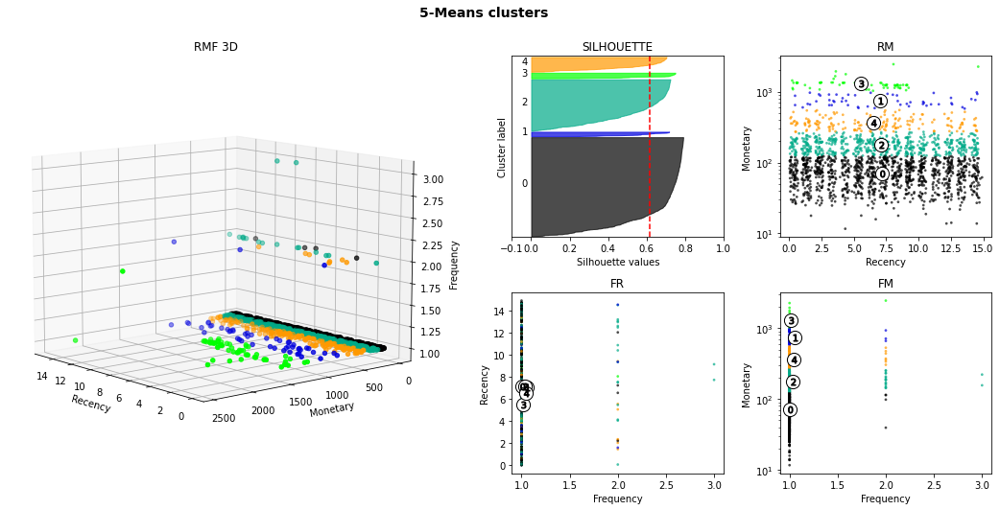

silhouette average : 0.616
k-means fit time : 1.781
silouhette compute time : 0.411


,R,F,M
customer_id,,,
001147e649a7b1afd577e873841632dd,6.282685,1,212.16
003035f5ec76f2220098377482de93c9,9.100602,1,62.47
0047f3e16441284d757a8963344f6c59,9.562639,1,76.18
004b45ec5c64187465168251cd1c9c2f,5.492095,1,97.87
005e32bc930906dc6b65fb9d11cce3e2,3.091227,1,49.60
...,...,...,...
ff9d2f60401262b9da1e868f956fb2a8,8.198113,1,411.63
ffcf1dc25f2222aea1aef48841f20f3a,0.634062,1,104.37
ffdcd85e0e81fc93f49bef4d54a4e61f,8.551146,1,77.57


SLICE 15 :
start date: 2017-09-07 00:00:00
end date: 2017-09-22 00:00:00
# customers: 24947
# orders: 25671


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


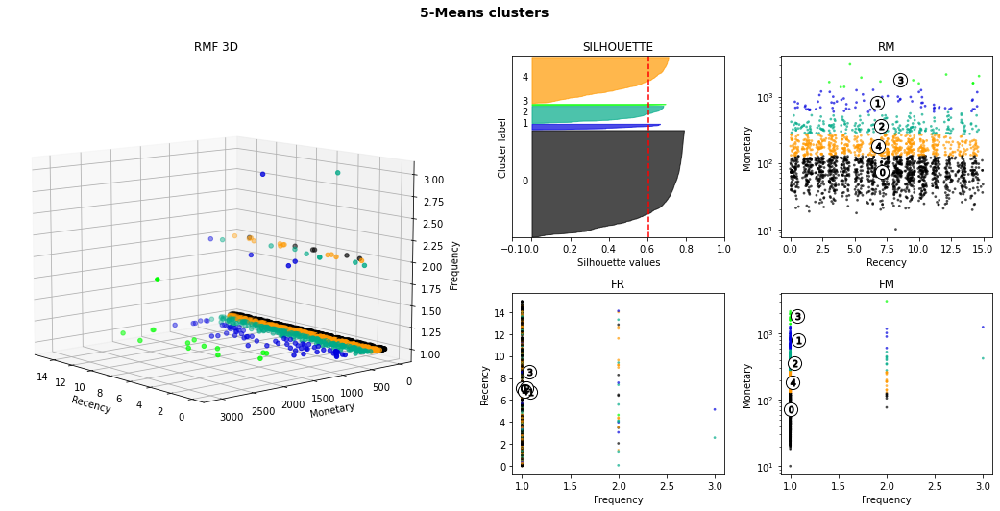

silhouette average : 0.607
k-means fit time : 1.705
silouhette compute time : 0.436


,R,F,M
customer_id,,,
005ff4ebe100db3eebbe6f7b19a8f99a,8.367812,1,236.81
00776f3807b128beca64cd0b27138d92,0.204259,1,321.57
009062f98089a091615b5c9faa13de26,9.046204,1,30.27
00970787f181925ba33bd32b3817f742,5.936840,1,35.40
00ae9ea276a5a4335382c9391059ddf2,8.653461,1,140.00
...,...,...,...
ff48228323a1d52f3b3108316bdc4314,14.029120,1,132.03
ff922bdd6bafcdf99cb90d7f39cea5b3,7.399954,1,42.58
ffa652b0cdf8bba29664149a9e579134,10.043414,1,98.70


SLICE 16 :
start date: 2017-09-22 00:00:00
end date: 2017-10-07 00:00:00
# customers: 26945
# orders: 27747


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


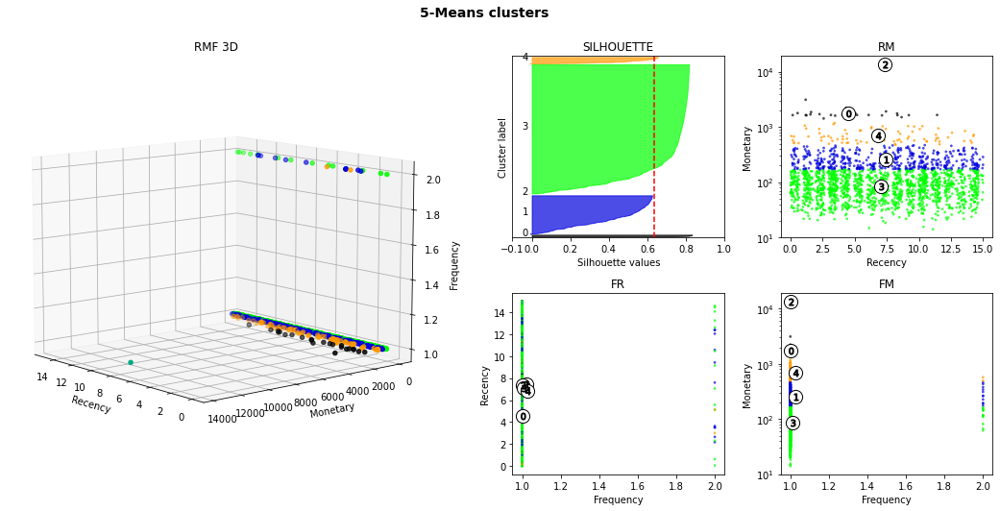

silhouette average : 0.635
k-means fit time : 1.635
silouhette compute time : 0.361


,R,F,M
customer_id,,,
000bfa1d2f1a41876493be685390d6d3,7.384051,1,46.85
004ad212c650c96c8a48f30855a7bcb8,12.551968,1,25.90
005ee3e015ec18092d7782e507cf68fe,5.584826,1,187.96
007ad549acb91673f04eac22c0568114,10.386956,1,90.85
00e5ea6932dffb682bd3d5760e84d176,10.319722,1,68.89
...,...,...,...
ff1e14670fe58a60d27e35069844b3d8,7.378009,1,179.38
ff44084bf8313fa8eae5ce6e43e341ed,2.175613,1,271.08
ff755148365a0062374c353946b68aa3,10.535671,1,206.87


SLICE 17 :
start date: 2017-10-07 00:00:00
end date: 2017-10-22 00:00:00
# customers: 29156
# orders: 30037


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


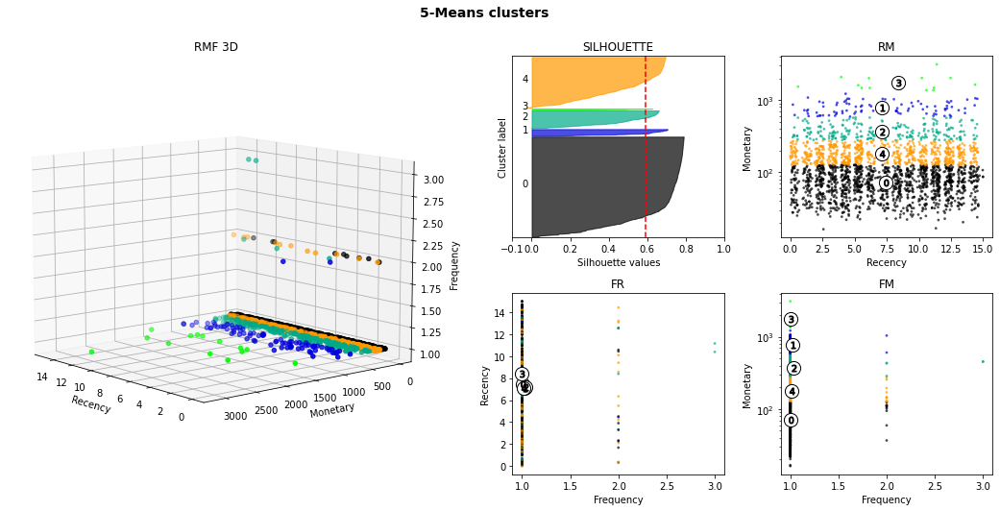

silhouette average : 0.591
k-means fit time : 1.803
silouhette compute time : 0.437


,R,F,M
customer_id,,,
0000f6ccb0745a6a4b88665a16c9f078,9.146053,1,43.62
0012929d977a8d7280bb277c1e5f589d,4.342639,1,155.65
002ae492472e45ad6ebeb7a625409392,13.002755,1,218.66
004177f7bf62929186b32c7fdaa6157b,2.328345,1,433.98
0065f6fb341f013a95a8e11cdc98d07a,12.381574,1,119.32
...,...,...,...
fedd4c0ac17d47475d8178c97f1724fb,1.519549,1,54.78
ff28d873d960260278acba659ac5752d,7.031447,1,56.05
ff36fa1d315d885d3c5171ea09996142,8.135185,1,64.00


SLICE 18 :
start date: 2017-10-22 00:00:00
end date: 2017-11-06 00:00:00
# customers: 31157
# orders: 32115


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


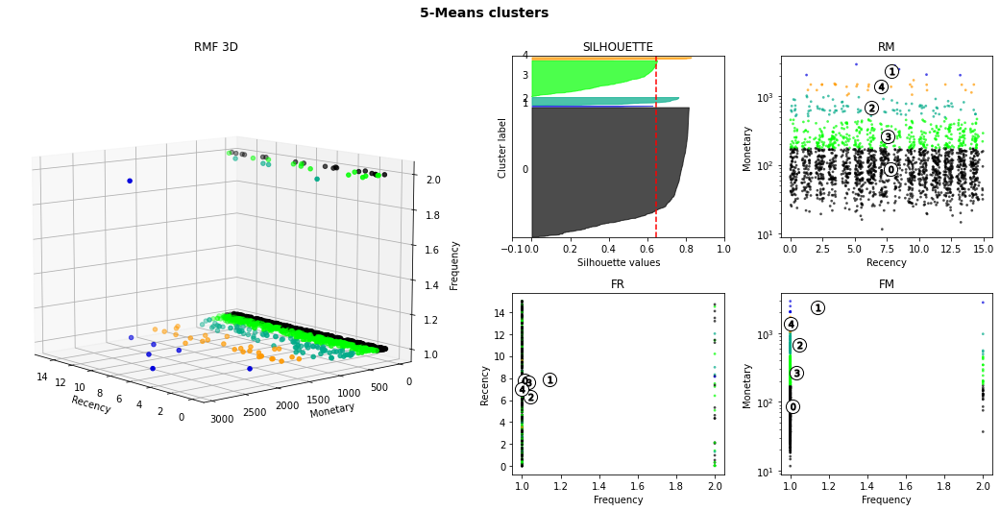

silhouette average : 0.644
k-means fit time : 2.322
silouhette compute time : 0.488


,R,F,M
customer_id,,,
00293787e2aec37a9c253b63fdfe2049,9.398900,1,257.87
0029bd580d3012618731f5abb174a07f,3.441424,1,52.38
002cdf87d4c03f08f7eb4551a923affc,5.269190,1,228.67
002feefec5af0a3b26ee7839c66d205e,7.486215,1,77.57
00575b2023dedcc0f3e81a938834689b,1.149398,1,32.38
...,...,...,...
ff66d86dd60a80525875a584d0f5d399,4.477975,1,125.29
ff6d4669ac6694f4ad278d23c4c7caa5,10.633194,1,148.97
ffba2b15e7a4608fd6ae9aa92f610dc5,7.210521,1,35.00


SLICE 19 :
start date: 2017-11-06 00:00:00
end date: 2017-11-21 00:00:00
# customers: 33838
# orders: 34875


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=11.
  warnings.warn(


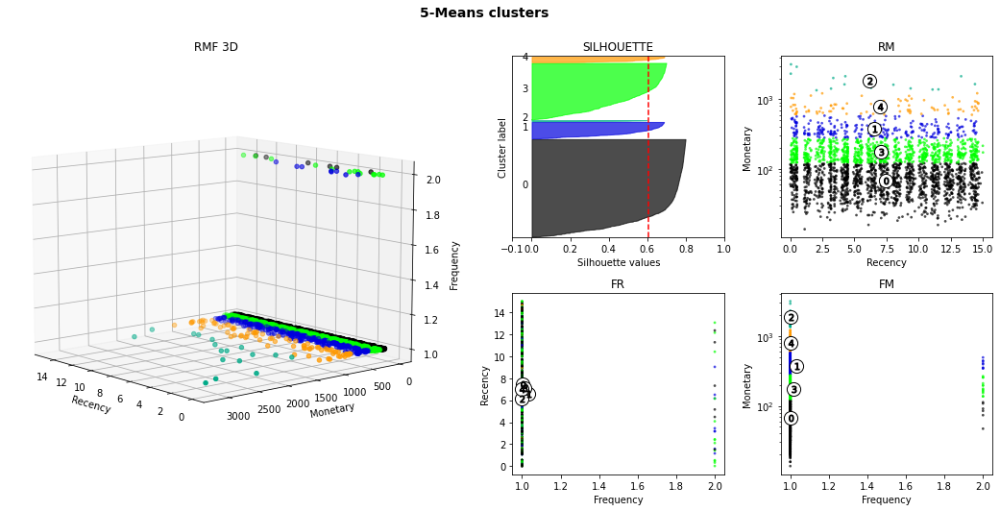

silhouette average : 0.604
k-means fit time : 2.013
silouhette compute time : 0.723


,R,F,M
customer_id,,,
0004aac84e0df4da2b147fca70cf8255,6.176597,1,196.89
00082cbe03e478190aadbea78542e933,1.359699,1,126.26
001ae44fa04911a9e9577356dce6c63c,14.266794,1,116.23
003f4901fdb60ae9c1e2538b84c208e1,1.150845,1,162.79
009a0802534f904b40b9d512b49794e1,4.389873,1,91.29
...,...,...,...
ff7b8116de7a8a5f5c8abbae6399608b,4.191956,1,161.29
ff7c033bfd33a1af06ac30c07492a859,1.339618,1,112.41
ff913fbe58ff8a761c3b01f4c718fc85,0.466840,1,272.50


SLICE 20 :
start date: 2017-11-21 00:00:00
end date: 2017-12-06 00:00:00
# customers: 39146
# orders: 40370


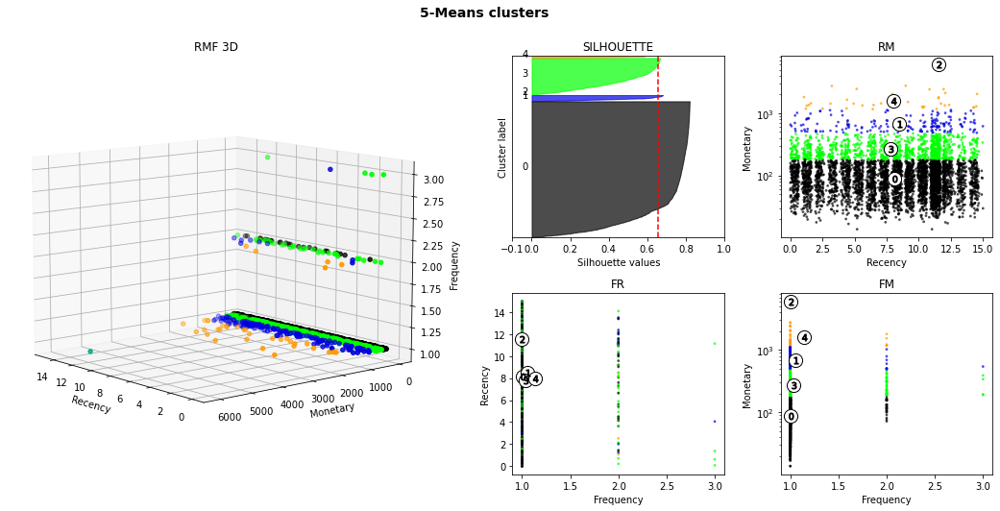

silhouette average : 0.654
k-means fit time : 1.568
silouhette compute time : 2.28


,R,F,M
customer_id,,,
002bdeb33da5b1b3ce8b9c822f749c82,0.205069,1,38.09
00377a18050b898b93e2c774be9947db,10.430498,1,65.78
003d56767e53e08671de00da3fba8d40,4.466424,1,178.59
0042dcca0ae57aaec6e808edc31a2d48,3.498218,1,85.04
00543330561a9088f8b3879114a7b008,11.373507,1,73.96
...,...,...,...
ffbb6557e45f7158781514f0efddb0d5,11.966574,1,128.96
ffc741a42034ec5c25be020c656950eb,6.216609,1,162.45
ffd973d43cadfa3e60340bcad8d87696,9.109606,1,125.52


SLICE 21 :
start date: 2017-12-06 00:00:00
end date: 2017-12-21 00:00:00
# customers: 42079
# orders: 43400


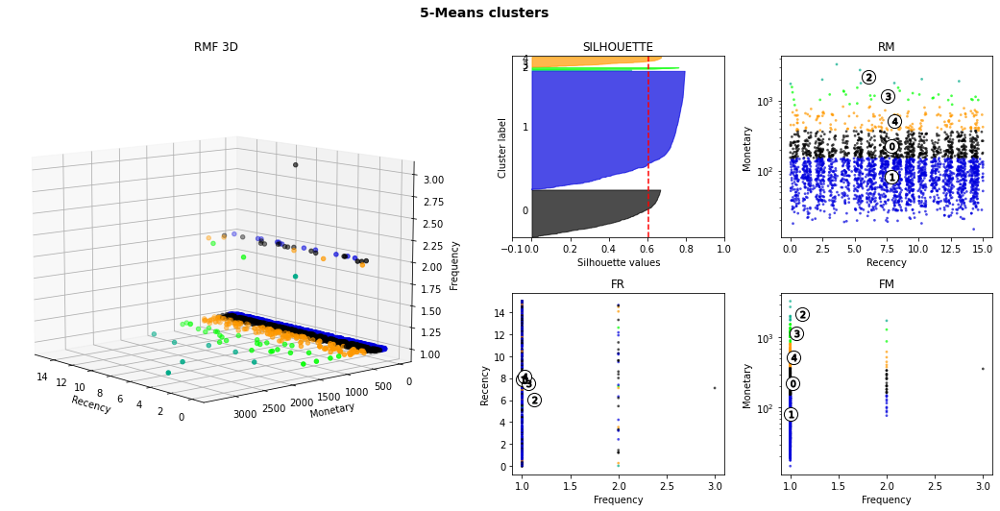

silhouette average : 0.607
k-means fit time : 1.364
silouhette compute time : 0.801


,R,F,M
customer_id,,,
000c8bdb58a29e7115cfc257230fb21b,8.046123,1,29.00
001ae5a1788703d64536c30362503e49,12.518935,1,135.08
0028a7d8db7b0247652509358ad8d755,7.340521,1,354.87
004a432489f6630c6dfd3fc4454603f5,4.607523,1,84.01
006e937bd5a5e32043018a6d1521b5d5,10.165035,1,199.79
...,...,...,...
ff94fd009b5a961313d7b3f2a1536c59,6.407234,1,130.57
ffdde6e4dcb6ec3a882cfc6cddef7996,10.449028,1,796.94
ffdf72e25c6f0503bb567d0a8cf1c159,11.401273,1,170.37


SLICE 22 :
start date: 2017-12-21 00:00:00
end date: 2018-01-05 00:00:00
# customers: 44086
# orders: 45460


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


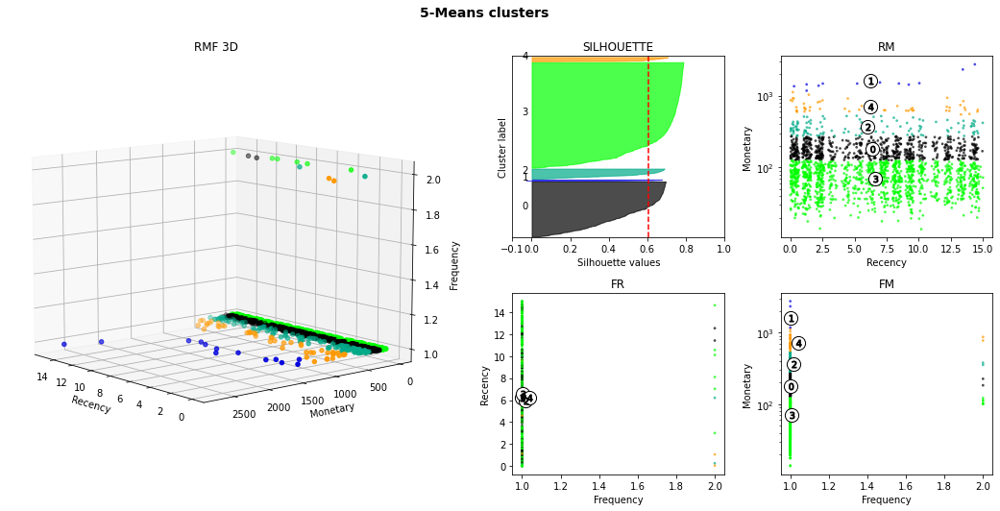

silhouette average : 0.604
k-means fit time : 1.893
silouhette compute time : 0.477


,R,F,M
customer_id,,,
0049a16516d38fc2246696172a257f16,6.538634,1,32.77
0078bb0f0d23e922d08437b7d0e13907,14.002153,1,44.09
007d9f716ead2bc8712255271a38f609,3.356053,1,67.57
00986cafefb6e670cceca01694bda599,4.253391,1,66.91
00a1c6913daeda0b7f9b79f802805fdb,8.497454,1,101.34
...,...,...,...
ffa8a7cd286a3431406fcb483d63df92,4.238981,1,49.10
ffac330ca7f9bff857210af3a40b08d8,13.407928,1,97.92
ffc14413ed1273340b518ad0bc63c862,9.304225,1,51.84


SLICE 23 :
start date: 2018-01-05 00:00:00
end date: 2018-01-20 00:00:00
# customers: 47735
# orders: 49234


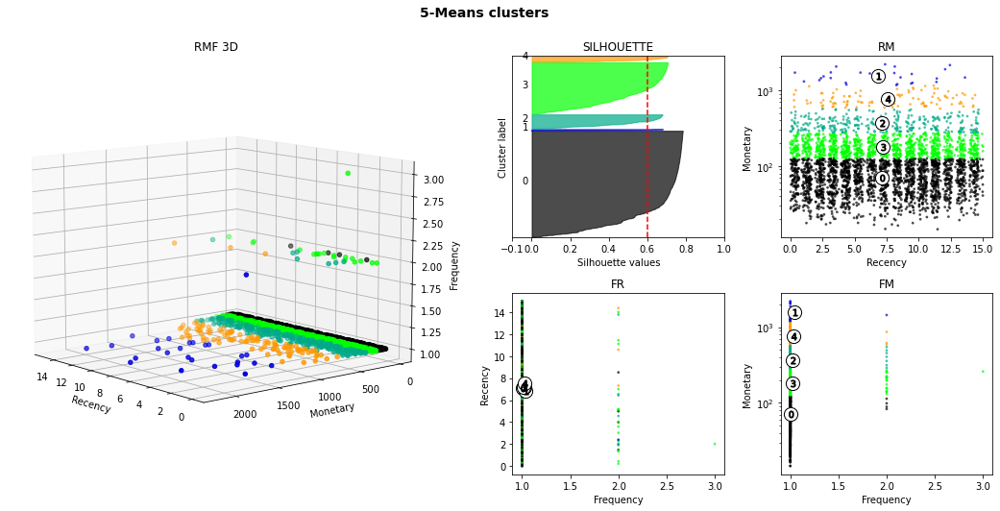

silhouette average : 0.6
k-means fit time : 1.243
silouhette compute time : 1.158


,R,F,M
customer_id,,,
000d460961d6dbfa3ec6c9f5805769e1,12.042072,1,36.68
0014a5a58da615f7b01a4f5e194bf5ea,1.132222,1,99.82
0028cfeb9dfcd3628a56d5b6400deef5,12.991146,1,118.20
002d3bd901608f67c3fc11eaaa842b13,4.222500,1,28.76
003650b504826ea534e02eba0ab58dd5,2.497905,1,21.77
...,...,...,...
ffbd1090fa1840d6cf9106fb238089e9,11.334491,1,81.76
ffbe02226141ca45932dddadda83f9bd,0.450856,1,51.75
ffcda3a0829ba6d3a02cd280e29b19a6,13.246817,1,111.40


SLICE 24 :
start date: 2018-01-20 00:00:00
end date: 2018-02-04 00:00:00
# customers: 50988
# orders: 52605


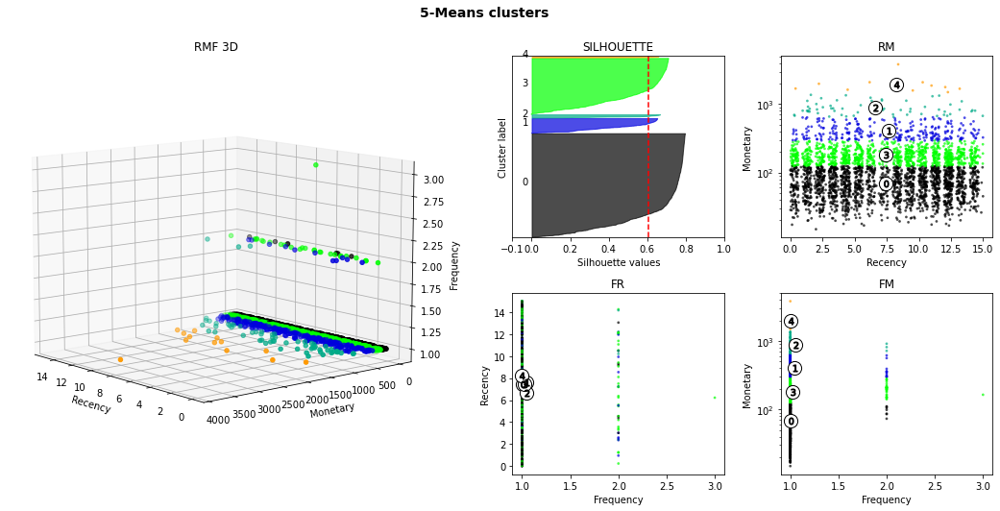

silhouette average : 0.606
k-means fit time : 1.454
silouhette compute time : 0.776


,R,F,M
customer_id,,,
002ed12115742033f015cb3c269ccf68,4.423299,1,109.79
0036d365b138cc0ee06bed755bcb5044,3.388194,1,109.50
00370dfde3d012c420d29657afc2fc8b,5.462060,1,237.00
0037aa56b017c105c3a9d47af71fff98,8.296574,1,443.73
007a2fab7046647dad04fe7d08c57820,0.137778,1,126.48
...,...,...,...
ff6a749412048de53e487708e585a0e4,12.262245,1,57.77
ff6de6cae279ba3f49b5d779351a9a1e,6.587720,1,107.50
ff93b5e71bd5be1bbf74ac93c52adcf2,11.517488,1,359.18


SLICE 25 :
start date: 2018-02-04 00:00:00
end date: 2018-02-19 00:00:00
# customers: 54274
# orders: 56030


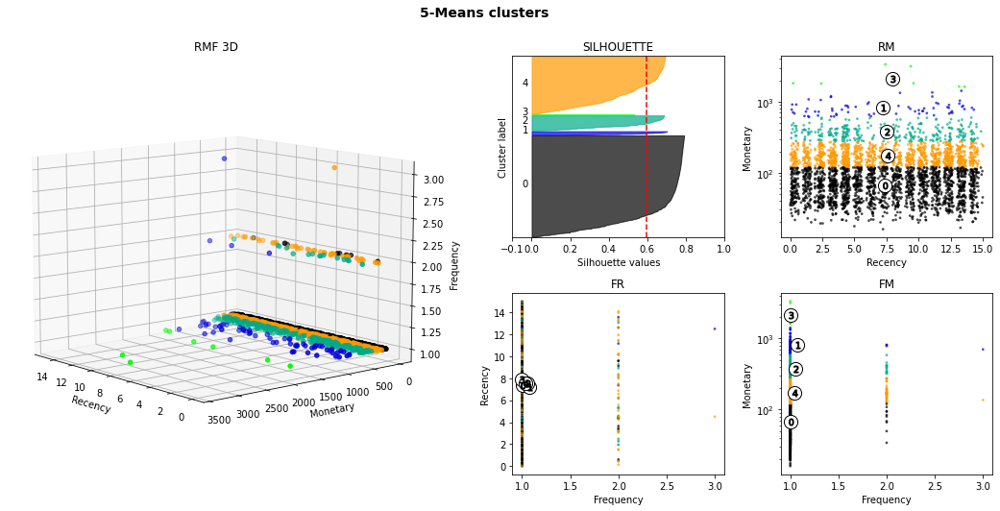

silhouette average : 0.598
k-means fit time : 1.567
silouhette compute time : 0.769


,R,F,M
customer_id,,,
0019da6aa6bcb27cc32f1249bd12da05,7.961458,1,87.71
002ef00822613c94613e60e03b169fef,4.127384,1,114.04
004d17fa2cb102a7c4817f040c884e59,5.696296,1,39.78
0055bbb9c95f6acb8db89d1f6c316407,4.595069,1,83.23
006bbb235068a01d2e3e47fa09ccf53c,3.206725,1,34.00
...,...,...,...
ffab104b9ba797387c58820356eb7551,13.610069,1,234.56
ffb03435e357d6c137b5b24e34808df4,11.571979,1,138.89
ffb5431b49b42c9f3209f087e1bfdcfa,9.267419,1,77.19


SLICE 26 :
start date: 2018-02-19 00:00:00
end date: 2018-03-06 00:00:00
# customers: 58031
# orders: 59953


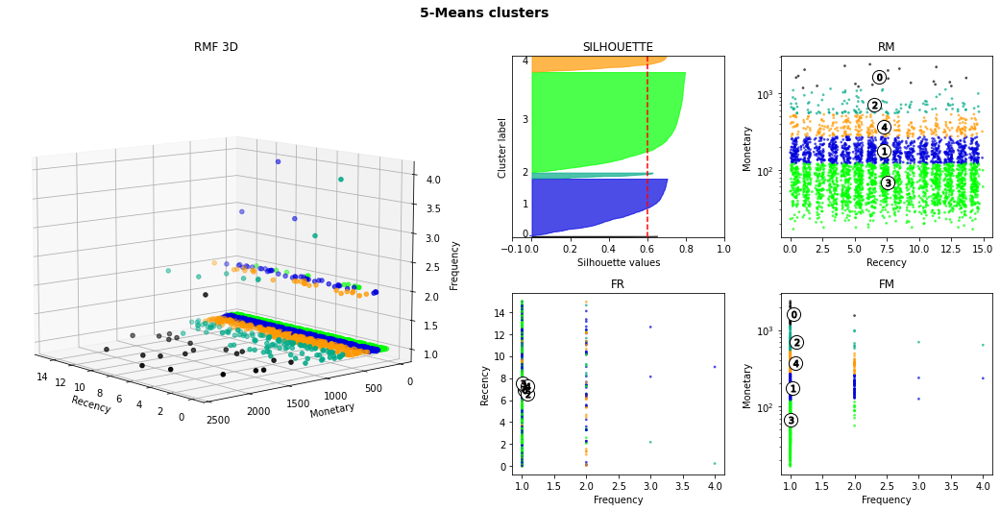

silhouette average : 0.6
k-means fit time : 1.423
silouhette compute time : 1.031


,R,F,M
customer_id,,,
00053a61a98854899e70ed204dd4bafe,5.530775,1,419.18
0010fb34b966d44409382af9e8fd5b77,0.285498,1,61.80
00196fdb2bf9edfc35e88ebfbcf8d781,11.203657,1,27.00
002aba8c1af80acacef6e011f9f23262,6.466806,1,217.74
0058f300f57d7b93c477a131a59b36c3,14.283634,1,79.56
...,...,...,...
ff7bd992a7aac2c563a3e3773a8c63aa,7.407882,1,30.00
ff8fd64c1a5f9bebebc9bf3985dac068,4.111898,1,109.10
ffa6acb325475c3f9816fa472652f1af,9.035359,1,190.88


SLICE 27 :
start date: 2018-03-06 00:00:00
end date: 2018-03-21 00:00:00
# customers: 61491
# orders: 63527


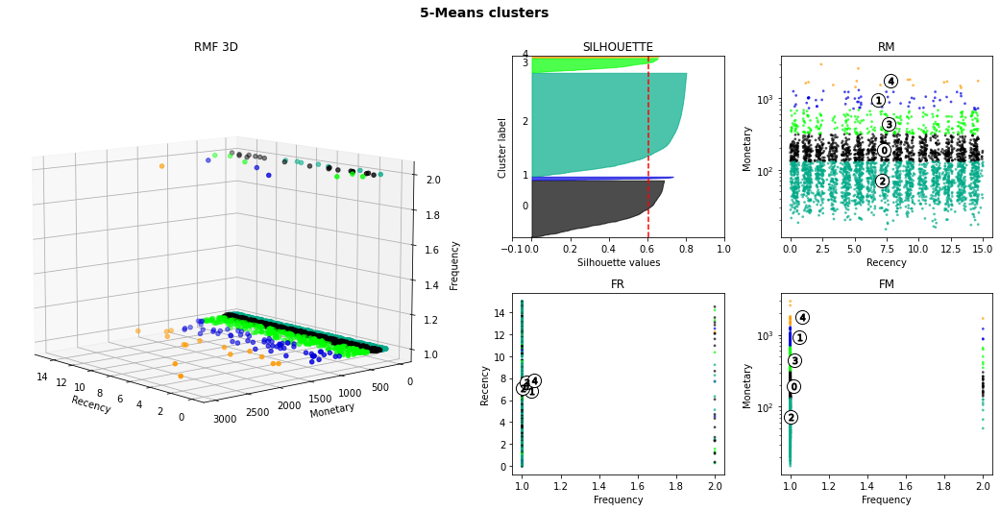

silhouette average : 0.605
k-means fit time : 1.588
silouhette compute time : 0.905


,R,F,M
customer_id,,,
0005ef4cd20d2893f0d9fbd94d3c0d97,8.359583,1,129.76
003ac9408252444b489b1bfc013f5f8c,4.252176,1,36.98
0077dc76aaf02323f03bce9b00878253,9.284780,1,874.42
007e21b7a007c8f8dadfa43c9d5a91db,10.042708,1,70.75
008b82b072c6b564fcce49a325f84097,10.220428,1,45.13
...,...,...,...
ffad6a7a0e13be3dfd9de96a81b77c9e,14.376898,1,90.18
ffbab763e1469af59b9882f0fc6e7d18,5.623356,1,165.04
ffbc87f67c513f71b9ffa68e72a2376e,4.494792,1,126.20


SLICE 28 :
start date: 2018-03-21 00:00:00
end date: 2018-04-05 00:00:00
# customers: 64762
# orders: 66900


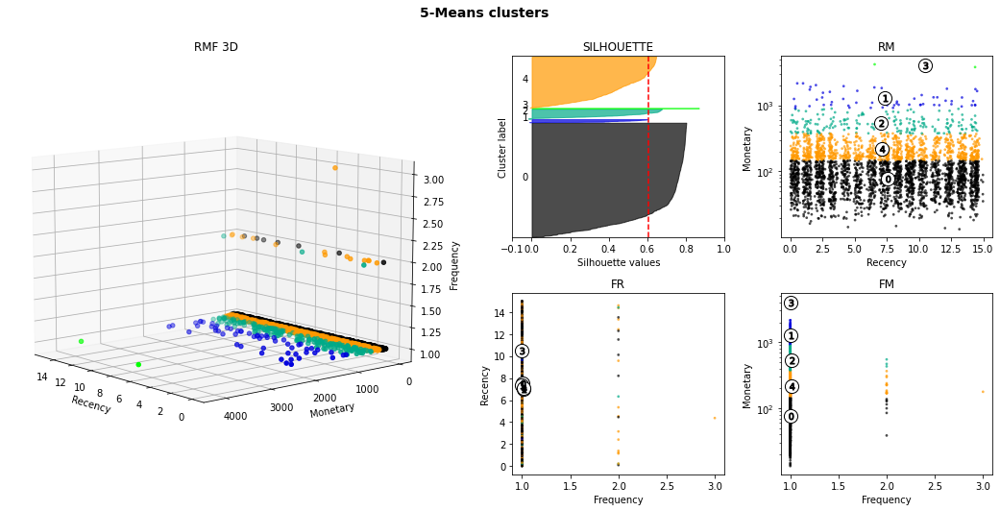

silhouette average : 0.605
k-means fit time : 1.338
silouhette compute time : 0.697


,R,F,M
customer_id,,,
00090324bbad0e9342388303bb71ba0a,11.385637,1,63.66
0023557a94bef0038066b5d1b3dc763e,7.171366,1,107.44
0027324a96d26a2bc7d69262f83c8403,10.505822,1,46.78
003800162424b7b5b3d75c9cf22a66e7,3.104468,1,107.81
004256f082951ec189a4962b6788c214,12.515301,1,259.15
...,...,...,...
ff7bfe25f6e582f062fe91a506aef916,13.120012,1,66.39
ff7e7d4a4669fc03606a21eedad169e3,7.383576,1,30.38
ff9584b796ae561b0085ebc998880a64,12.654444,1,50.05


SLICE 29 :
start date: 2018-04-05 00:00:00
end date: 2018-04-20 00:00:00
# customers: 68113
# orders: 70377


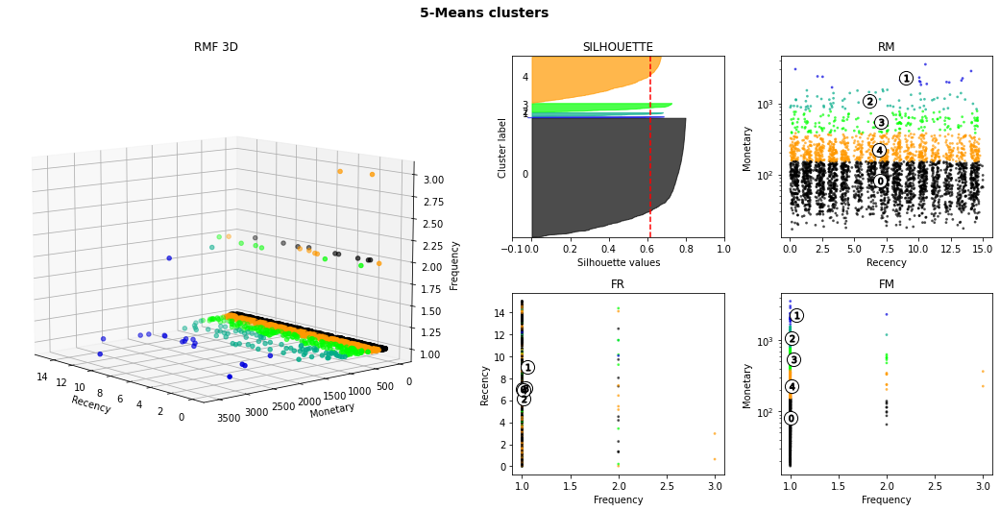

silhouette average : 0.615
k-means fit time : 1.344
silouhette compute time : 0.821


,R,F,M
customer_id,,,
0004bd2a26a76fe21f786e4fbd80607f,14.185231,1,166.98
002da6dde369f6a8b4c999ed61eb5a87,7.539074,1,52.38
003e2af81ea3c72fbdd093f07724a4de,3.125093,1,63.74
00626f29f9b57d3ef7c1739ff03e944e,8.512211,1,154.53
006b297ed73773b17d8874a2eb4466e8,10.340613,1,108.46
...,...,...,...
ffbbb45b560b9ff08bdde6786987c796,10.216331,1,188.12
ffc7d48d48327cf57757436b3f4706b0,1.216424,1,209.00
ffcd4b43c08405501a6bf2c66be83e83,0.484190,1,30.29


SLICE 30 :
start date: 2018-04-20 00:00:00
end date: 2018-05-05 00:00:00
# customers: 71589
# orders: 73968


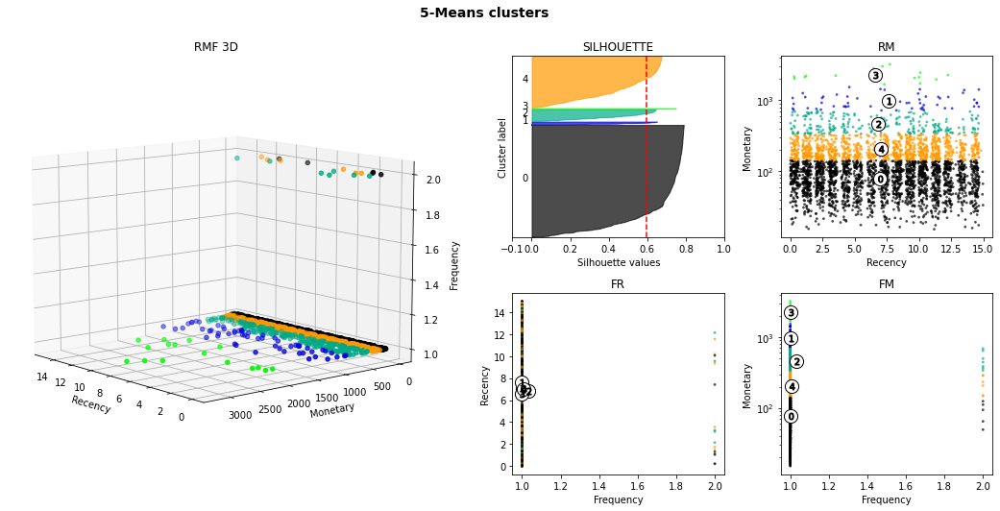

silhouette average : 0.596
k-means fit time : 1.768
silouhette compute time : 0.762


,R,F,M
customer_id,,,
00050ab1314c0e55a6ca13cf7181fecf,14.460150,1,35.38
000949456b182f53c18b68d6babc79c1,11.586273,1,82.05
0019e8c501c85848ac0966d45226fa1d,3.607269,1,197.27
003db7adfcdc49857b095a50191b6c9d,2.471053,1,542.66
004f84d065096f3cedd26cf0adc80b9d,9.029676,1,189.08
...,...,...,...
ffc46f230cc7ce6109908f432eb9eb5b,3.230544,1,279.92
ffe76cb2f4bb39384c432d65ece67441,9.564942,1,66.06
ffecceca389973ef16660d58696f281e,9.494317,1,72.76


SLICE 31 :
start date: 2018-05-05 00:00:00
end date: 2018-05-20 00:00:00
# customers: 75523
# orders: 78039


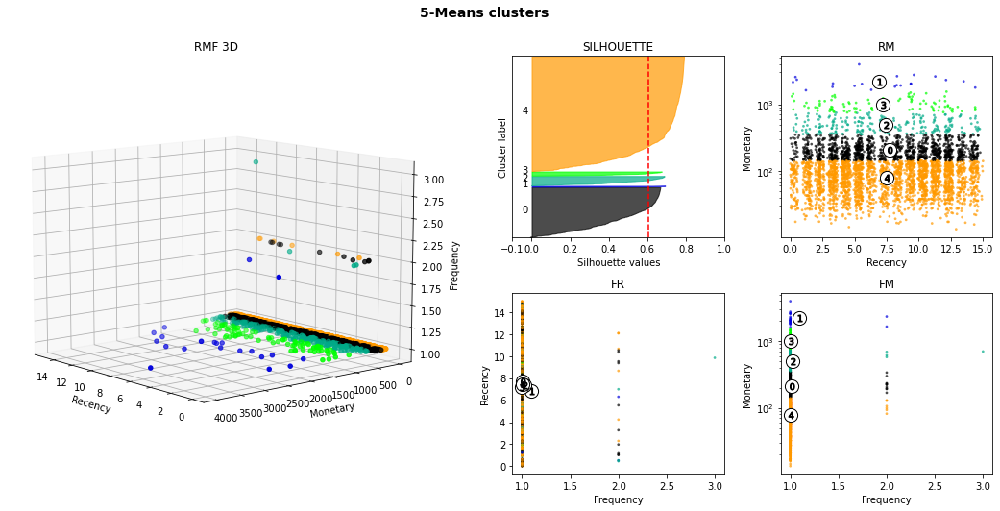

silhouette average : 0.603
k-means fit time : 1.609
silouhette compute time : 0.946


,R,F,M
customer_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,9.544132,1,141.90
0000b849f77a49e4a4ce2b2a4ca5be3f,12.533715,1,27.19
0034c76b7e6a17d738375b99afc2f01e,12.321528,1,44.23
0035029989e6fc5cf030918a5f9f2037,7.397037,1,546.12
003fee4ca17927283128c7ddc6f9311b,11.452384,1,103.47
...,...,...,...
ffca00fb352b5e57db50865d65098b4a,9.022164,1,47.61
ffcb3eb07f2a033d45949fcecd160d98,7.240590,1,206.08
ffd2e2ad95719ab7fedc9e02c5e26a62,2.294155,1,44.23


SLICE 32 :
start date: 2018-05-20 00:00:00
end date: 2018-06-04 00:00:00
# customers: 77625
# orders: 80237


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


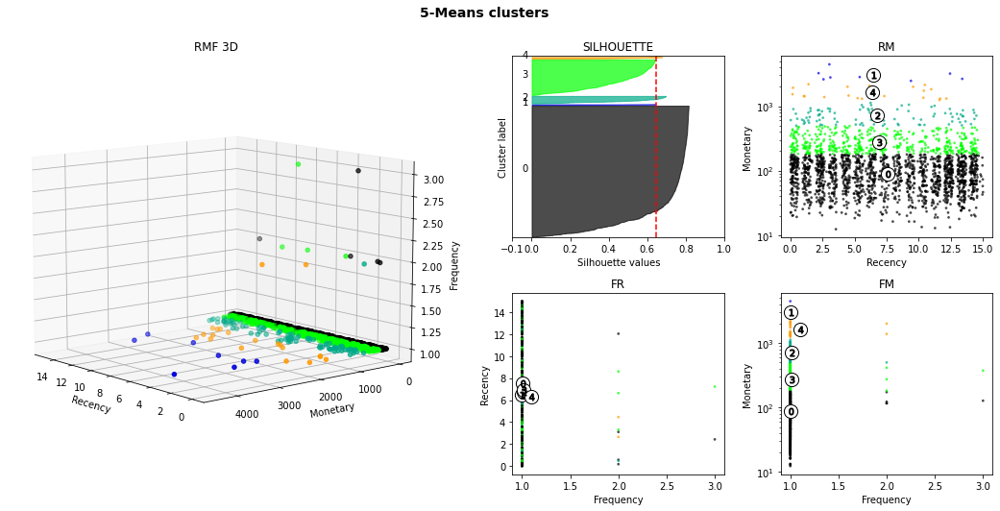

silhouette average : 0.643
k-means fit time : 1.835
silouhette compute time : 0.38


,R,F,M
customer_id,,,
000ed48ceeb6f4bf8ad021a10a3c7b43,14.315208,1,20.75
001a3a8e11d76c9a366c31a4aa2cc529,13.941377,1,24.23
00256bf7b05c08f6a5849df3d0a64f1f,2.262986,1,57.73
004b45ec5c64187465168251cd1c9c2f,8.178611,1,49.85
005f060d4223956c62b64e9567a36f0f,12.057708,1,777.68
...,...,...,...
ff325a460cc15654fa42b324fe0ab64b,13.456505,1,83.41
ff61f2506ff81e50510d8c0ac5570c30,8.497535,1,127.21
ffb1cf5736b51e47fec82cf40dd26303,7.477894,1,267.66


SLICE 33 :
start date: 2018-06-04 00:00:00
end date: 2018-06-19 00:00:00
# customers: 80707
# orders: 83435


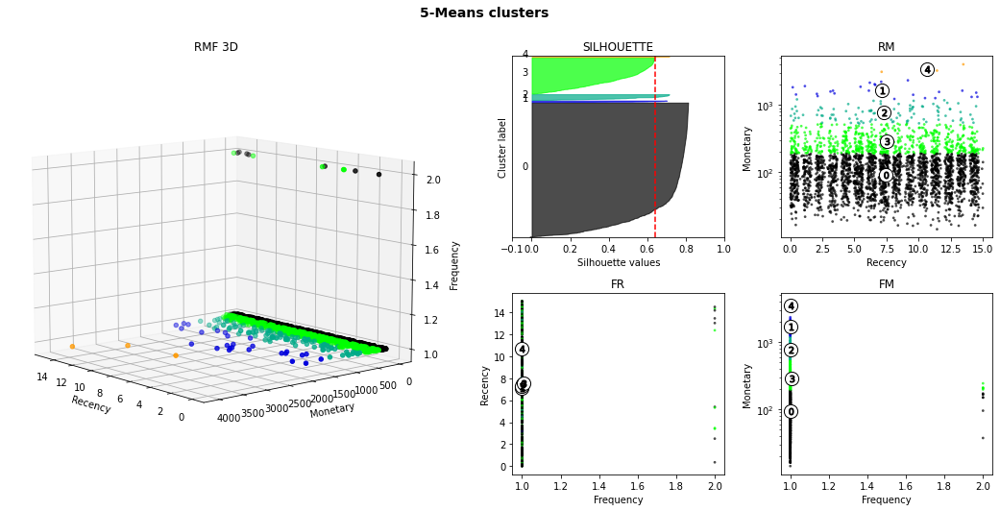

silhouette average : 0.642
k-means fit time : 1.465
silouhette compute time : 0.808


,R,F,M
customer_id,,,
004493e0b0a37317d25665d340c0677d,12.260752,1,83.32
006c10bfead12ac8d90486fb4ce4e603,4.012546,1,77.22
007ba48697b079e78f168b051462dd1b,12.007222,1,147.78
0098853a28531d48988a2fb02b30840e,10.495613,1,79.38
00c05fe9d2f8b245f1f86fe559175f24,4.341840,1,388.74
...,...,...,...
ffa323b33234124b58b25511035c2855,4.308819,1,301.34
ffb52634b4c16223ff808f266332de04,10.489988,1,85.54
ffcb7bc68d6ec38fece3546240bd01e5,10.634236,1,47.05


SLICE 34 :
start date: 2018-06-19 00:00:00
end date: 2018-07-04 00:00:00
# customers: 83629
# orders: 86458


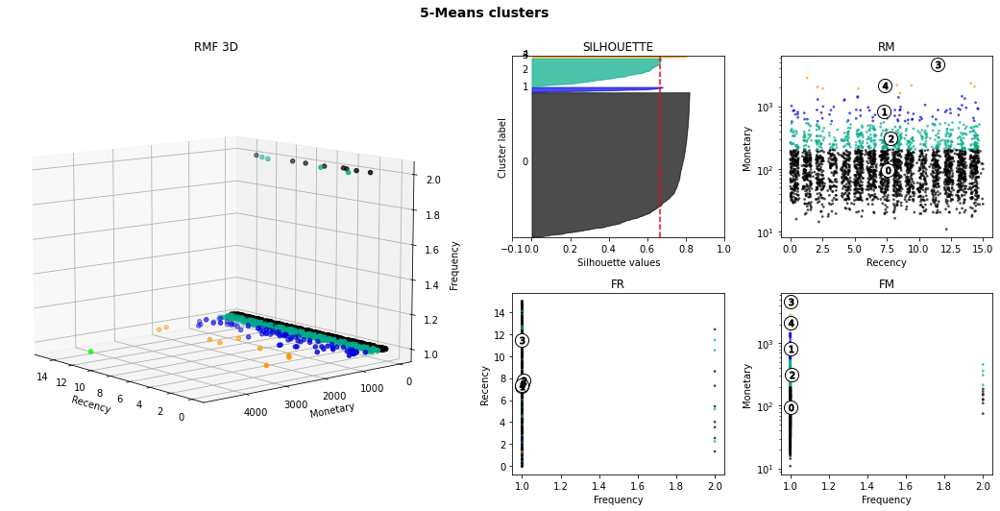

silhouette average : 0.668
k-means fit time : 1.364
silouhette compute time : 0.644


,R,F,M
customer_id,,,
000e309254ab1fc5ba99dd469d36bdb4,8.587535,1,78.42
001deb796b28a3a128d6113857569aa4,11.328137,1,63.33
002311514717ca8b65b09a26cdf7b91a,6.517662,1,124.32
0033f4a2887e07e25aa1204d482f41ba,7.953206,1,425.04
0045e9ad4d6c85d2323a7ab374b76183,14.032373,1,24.13
...,...,...,...
ffc4233210eac4ec1711a8b847196d4e,14.377755,1,94.77
ffd2aac179372f267e7b9186ac7a1bcc,14.401956,1,29.13
ffeb904468642a1ce663a322629801cb,6.501609,1,93.11


SLICE 35 :
start date: 2018-07-04 00:00:00
end date: 2018-07-19 00:00:00
# customers: 86092
# orders: 89017


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=10.
  warnings.warn(


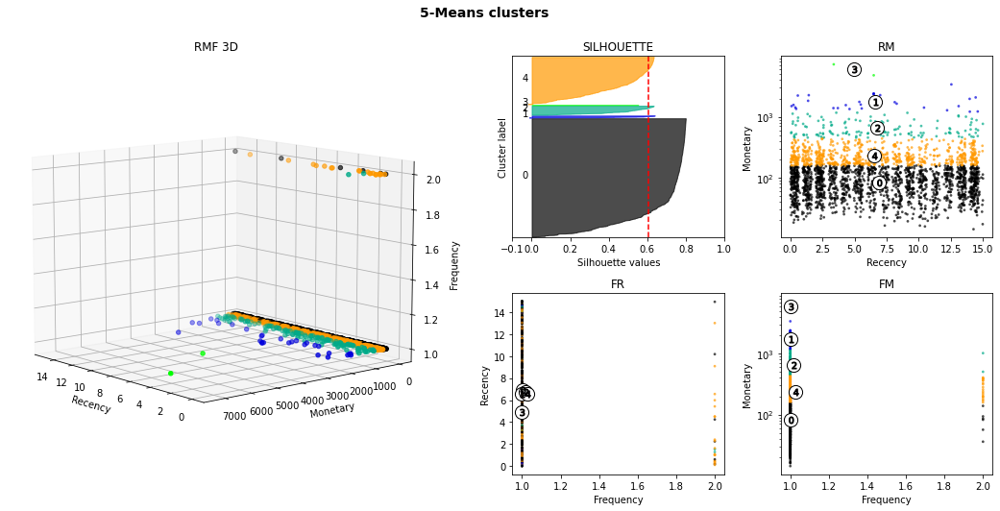

silhouette average : 0.607
k-means fit time : 1.744
silouhette compute time : 0.509


,R,F,M
customer_id,,,
001a34eb30ecb8e3aacb07c475ca4dd1,7.173681,1,161.71
003162bf0351f47a1a247992b8b9b42d,4.343438,1,536.60
0032ca69771a7758ce643258bb9e4ac7,2.352199,1,62.45
00344274804f3b8003de1b0562ae01df,9.410127,1,226.23
004df63539fd5e38d4b0a0506de7549c,2.437431,1,993.55
...,...,...,...
ff6c9c45f6cee4ec0785650b18322d73,0.250058,1,1568.72
ff8a98860a86a0f563a92a43b3344414,1.394745,1,117.58
ffb6123b45cfa6e6ff5ff94d404283b7,9.103299,1,25.04


SLICE 36 :
start date: 2018-07-19 00:00:00
end date: 2018-08-03 00:00:00
# customers: 89738
# orders: 92791


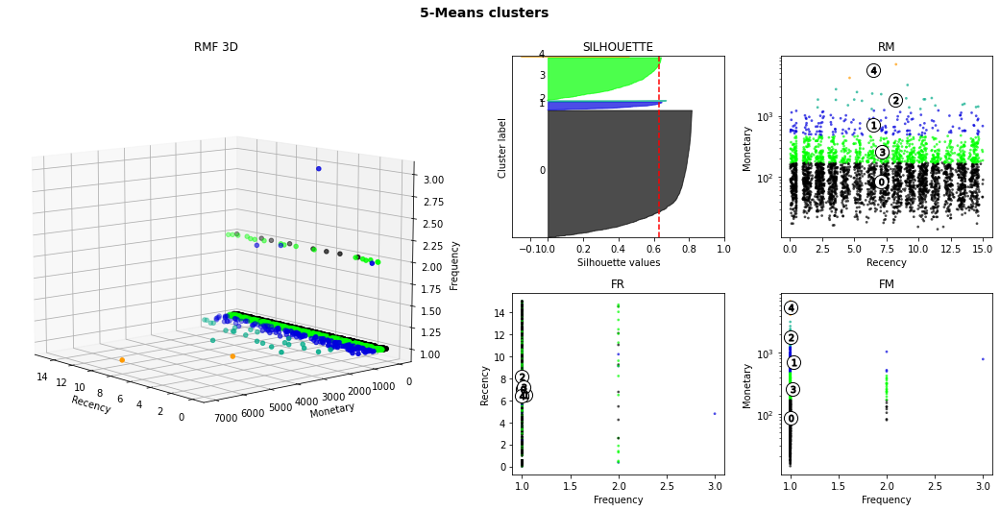

silhouette average : 0.631
k-means fit time : 1.421
silouhette compute time : 0.866


,R,F,M
customer_id,,,
000fbf0473c10fc1ab6f8d2d286ce20c,7.594537,1,362.38
0015752e079902b12cd00b9b7596276b,0.233437,1,74.82
00172711b30d52eea8b313a7f2cced02,5.983461,1,122.07
00196c4c9a3af7dd2ad10eade69c926f,5.604722,1,37.58
0025795df7a7d077c4c90162fa820085,9.535289,1,214.08
...,...,...,...
ffc39051848c3ef2be36d1513aa3ad17,1.442141,1,40.86
ffdf771c03dd683f1ed7017ae4e9efb2,5.280394,1,50.38
ffe96c782a5bc522bd8bad3bc638981a,3.404595,1,245.22


SLICE 37 :
start date: 2018-08-03 00:00:00
end date: 2018-08-18 00:00:00
# customers: 93883
# orders: 97087


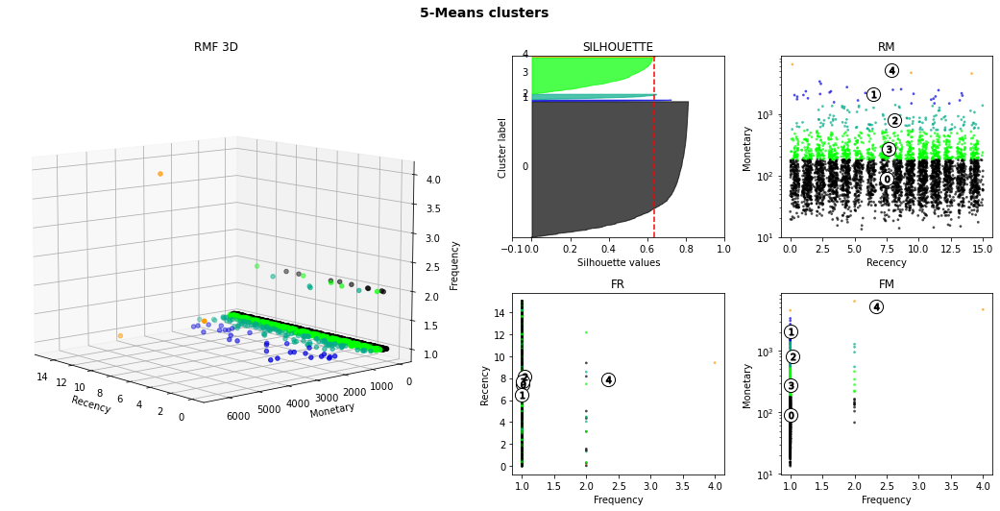

silhouette average : 0.635
k-means fit time : 1.413
silouhette compute time : 1.346


,R,F,M
customer_id,,,
00172711b30d52eea8b313a7f2cced02,4.615197,1,122.07
002471155ecd08d208d1376720e2a907,9.141319,1,92.18
00391594070baf8603f5fdc1d0c6a48c,12.143426,1,119.32
003a7a8eb096ed3cbf713d2def1ca701,3.400012,1,157.46
003ae409f37c3c30cb1c974af3a42692,2.515451,1,216.32
...,...,...,...
ffb3cbd5e1e507679e2db84c515410a5,2.149352,1,110.63
ffb572185af25751289ac38f38c7e2f9,12.436262,1,129.87
ffe204b1bb8026741b839085b2fd10f2,8.374329,1,156.70


SLICE 38 :
start date: 2018-08-18 00:00:00
end date: 2018-09-02 00:00:00
# customers: 95415
# orders: 98690


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


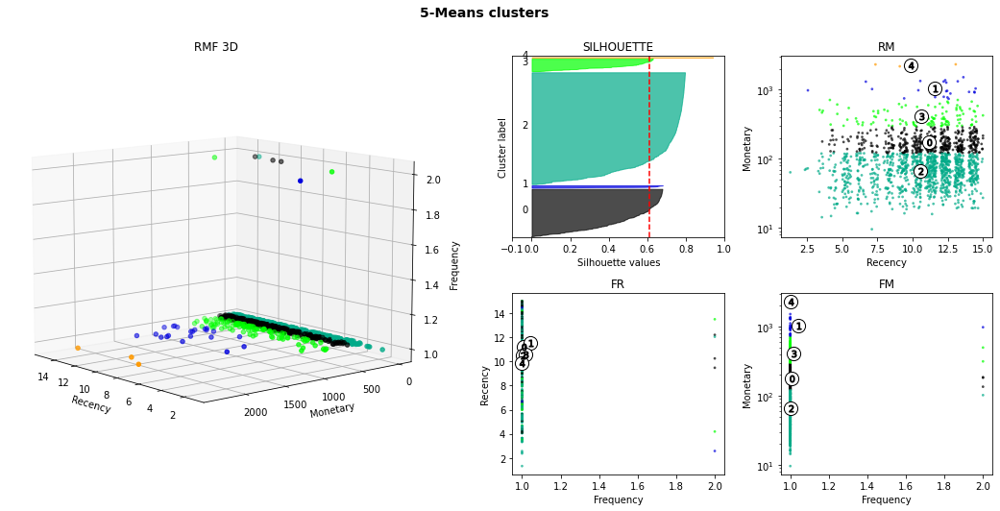

silhouette average : 0.61
k-means fit time : 1.439
silouhette compute time : 0.194


,R,F,M
customer_id,,,
000ec5bff359e1c0ad76a81a45cb598f,11.517755,1,27.75
001928b561575b2821c92254a2327d06,8.113194,1,164.81
0057f64bff87f4698b4cbd338d62a2a8,11.550266,1,82.86
008b06aba4b5f5b5b94f525ccf520624,10.549248,1,90.50
00a33236962b4ac37fd25275be9c206b,13.273808,1,116.84
...,...,...,...
ff22e30958c13ffe219db7d711e8f564,8.290058,1,166.46
ff2959dedacc441cc5ffe7d747a1a299,14.468102,1,1043.32
ff36be26206fffe1eb37afd54c70e18b,9.473519,2,185.52


In [12]:
earliest_relevant_date = get_earliest_relevant_date()  # datetime(2017, 1, 25)
latest_relevant_date = get_latest_relevant_date()  # datetime(2018, 8, 21)
machin(
    step_in_days = 15,
    from_date=earliest_relevant_date,
    to_date=latest_relevant_date,
    cumul=True
)

#### Avec accumulation et avec normalisation

# slices: 39
SLICE 0 :
start date: 2017-01-25 00:00:00
end date: 2017-02-09 00:00:00
# customers: 1014
# orders: 1034


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


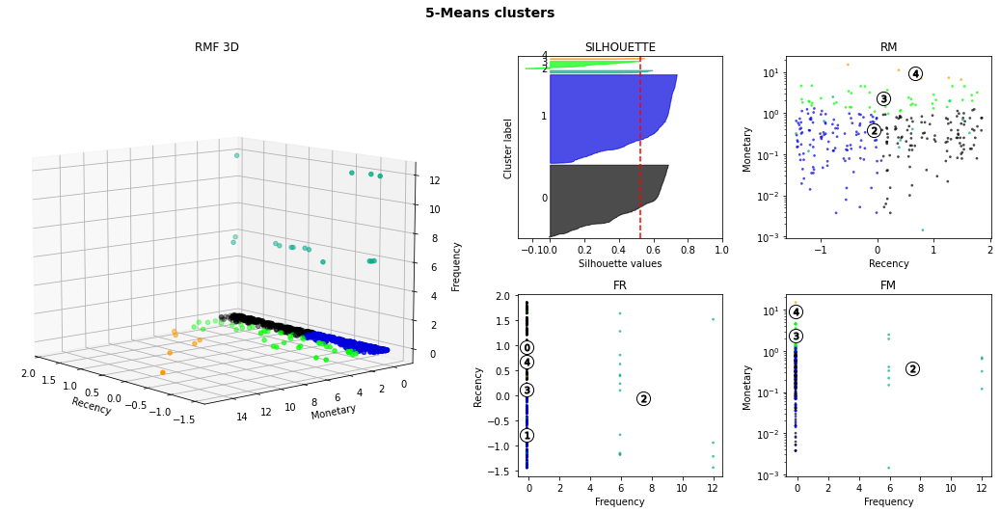

silhouette average : 0.525
k-means fit time : 1.289
silouhette compute time : 0.106


,R,F,M
customer_id,,,
002b4cd83fabaffaa475f78ea5ef3e08,0.186271,-0.11954,-0.434495
0071f46a072a9ae25bbe4438b15efe9c,0.313222,-0.11954,-0.003502
008f3d5f45a11059239a5c452cd00006,1.552541,-0.11954,0.630619
012e12f54f6e73b1faba89a119dab849,0.798158,-0.11954,-0.272775
0284ca4015977edc8413c917b8e68355,-1.093072,-0.11954,-0.425454
...,...,...,...
fe810d4870b11964c5d0ae1817aaa97b,1.671082,-0.11954,0.135596
fec0f9b88ab21b6b9bd1961500e83665,1.403573,-0.11954,0.251289
fee302f7605a1022d1a885fa5e2cad6e,-0.216347,-0.11954,0.339820


SLICE 1 :
start date: 2017-02-09 00:00:00
end date: 2017-02-24 00:00:00
# customers: 1893
# orders: 1927


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


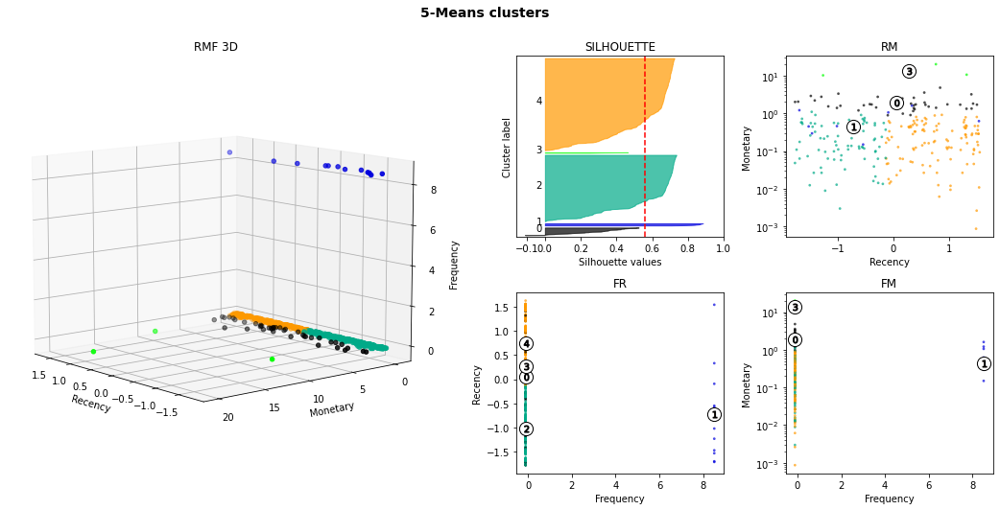

silhouette average : 0.56
k-means fit time : 1.145
silouhette compute time : 0.079


,R,F,M
customer_id,,,
0087eede471173af78d789df249c3a45,-0.144360,-0.117512,-0.062859
012b8001e47392df808a454083a74b74,1.327037,-0.117512,-0.218587
01469c41b00bb21cd01d2104b8e81384,1.016634,-0.117512,-0.182329
016feebfaba953a2456d3a063b8eb8ef,0.619351,-0.117512,-0.325872
019d47513bb1164cc83fc2d6d7123ef8,1.216406,-0.117512,0.107110
...,...,...,...
fe97a20a987dd0adc99328b52be73c4c,0.767865,-0.117512,-0.444955
ff28720521c749234b1ba19c9c986f4c,0.168504,-0.117512,0.061825
ff3bcc94d97e257e7619a2161375cdfe,1.516933,-0.117512,-0.262324


SLICE 2 :
start date: 2017-02-24 00:00:00
end date: 2017-03-11 00:00:00
# customers: 2969
# orders: 3024


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


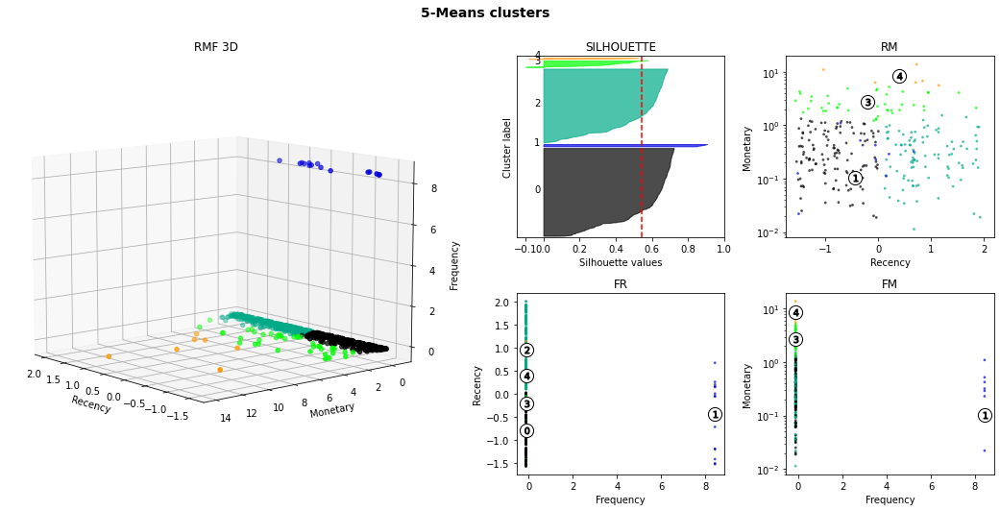

silhouette average : 0.545
k-means fit time : 1.198
silouhette compute time : 0.093


,R,F,M
customer_id,,,
0000f46a3911fa3c0805444483337064,-1.542452,-0.118567,-0.315113
0005e1862207bf6ccc02e4228effd9a0,-0.130855,-0.118567,-0.069921
00446a03d7a34d191507c9e42870d0a5,-0.575730,-0.118567,-0.151153
0049db44bfd6cee26ac9c649329ff6ea,-0.748611,-0.118567,-0.227550
0055b522bc89cbfbf376d8b59a628470,0.185484,-0.118567,0.753638
...,...,...,...
fef01b6698bae7394677113b5e647eda,-1.266773,-0.118567,-0.396153
ff4050535c1351cd0b834ccf1c9d07f1,0.507990,-0.118567,-0.518940
ff9bc66daa6702543b16f3c4897e300b,-0.505861,-0.118567,-0.269950


SLICE 3 :
start date: 2017-03-11 00:00:00
end date: 2017-03-26 00:00:00
# customers: 4288
# orders: 4364


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


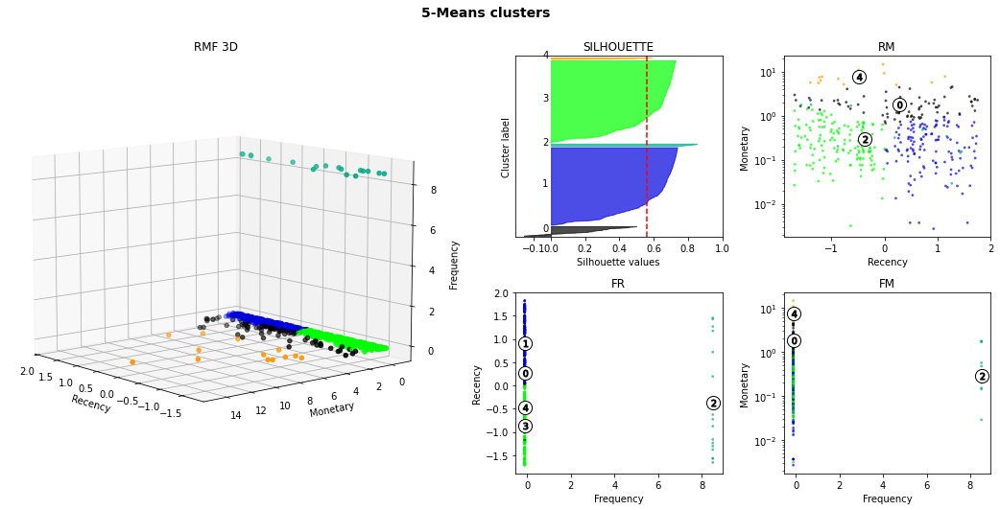

silhouette average : 0.561
k-means fit time : 1.248
silouhette compute time : 0.173


,R,F,M
customer_id,,,
001f3c4211216384d5fe59b041ce1461,-0.244665,-0.117489,-0.523935
003e28cb6fab8a0901bff9229612375f,1.206830,-0.117489,-0.135872
0096c18412349537abc45e350581cbbc,0.944853,-0.117489,2.286100
00c003ed13c76042b78d53fbc26930d0,0.444924,-0.117489,0.120414
00c3624c55261d9ce593f30e3815a880,0.061760,-0.117489,0.923248
...,...,...,...
ff51a896842f2bdced342631e2699d49,1.743411,-0.117489,-0.254602
ff64dc057067aecad9bf2c94b272e90a,-0.963375,-0.117489,0.033633
ffa17ff63f95ea3c838670e61d2666e0,1.200185,-0.117489,-0.339048


SLICE 4 :
start date: 2017-03-26 00:00:00
end date: 2017-04-10 00:00:00
# customers: 5474
# orders: 5579


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


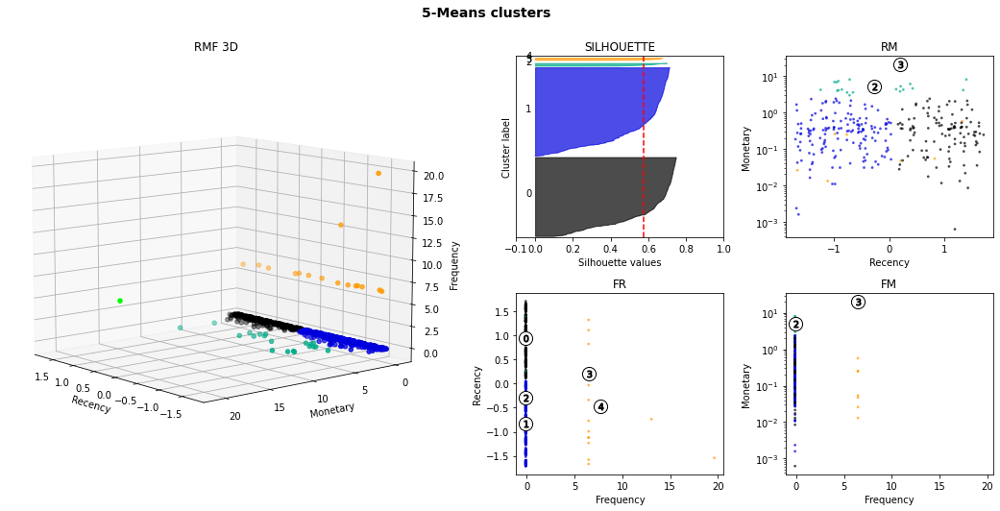

silhouette average : 0.576
k-means fit time : 1.229
silouhette compute time : 0.095


,R,F,M
customer_id,,,
002043098f10ba39a4600b6c52fbfe3c,1.577433,-0.109996,0.158098
0037d2bbb9ebc39d9114aea27ee16d72,1.389042,-0.109996,-0.107267
00522457bba00bba576a34fd9b4808fd,0.225957,-0.109996,-0.151692
00842c7d0cedb9e1edad8e9b7d148f09,-0.769438,-0.109996,-0.330605
00941614a654458b888b8780815bd26c,0.946701,-0.109996,0.011482
...,...,...,...
ff7014eeb94589da99e822e2618090fa,0.226247,-0.109996,-0.307588
ff8d27e48d6492ebb97e3052142c47bf,-1.456895,-0.109996,0.319410
ff959aedd362b48bb97c0abeb0b36b62,0.907062,-0.109996,-0.254137


SLICE 5 :
start date: 2017-04-10 00:00:00
end date: 2017-04-25 00:00:00
# customers: 6583
# orders: 6708


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=5.
  warnings.warn(


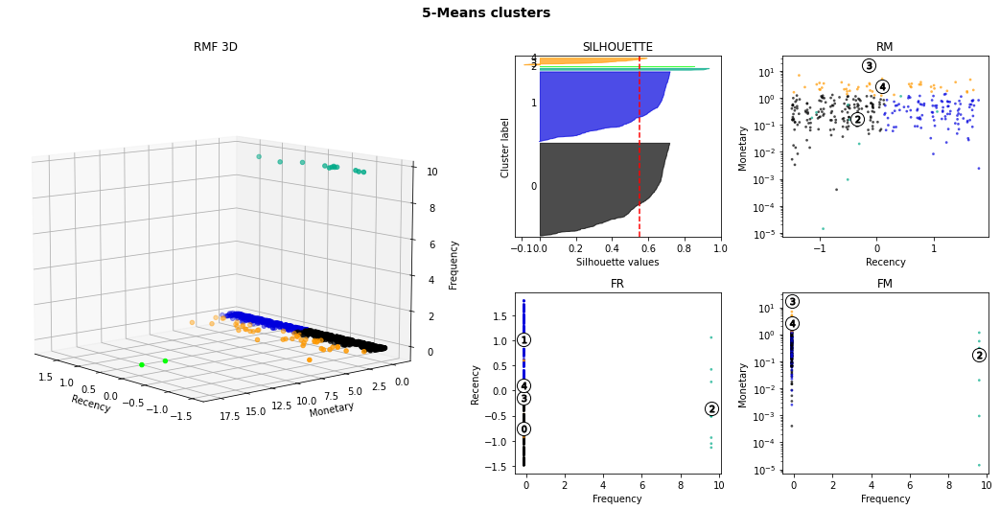

silhouette average : 0.551
k-means fit time : 1.369
silouhette compute time : 0.137


,R,F,M
customer_id,,,
0011805441c0d1b68b48002f1d005526,-1.395510,-0.10421,0.494490
00191a9719ef48ebb5860b130347bf33,-0.280223,-0.10421,-0.428748
0043d65f8039b4a4d43bc7b0f450ac2c,-0.512439,-0.10421,-0.407205
007953b3182d5ccc9189a694f5c68163,0.501170,-0.10421,-0.222542
0098f4847541cc7d676f9a5efc64c0f0,0.092227,-0.10421,-0.085111
...,...,...,...
fe7780b2659c715218834f592a838f6a,1.140617,-0.10421,-0.270820
ff253dd048167b1feddeb431db05d3d5,-1.349610,-0.10421,-0.165470
ff580ab4901e3619925a27db44eec095,1.462762,-0.10421,-0.398681


SLICE 6 :
start date: 2017-04-25 00:00:00
end date: 2017-05-10 00:00:00
# customers: 8144
# orders: 8304


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


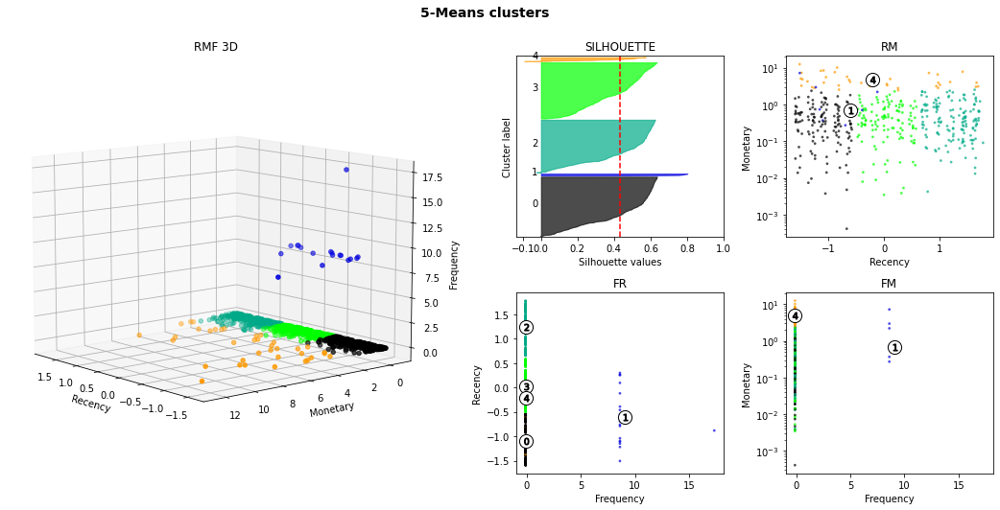

silhouette average : 0.433
k-means fit time : 1.296
silouhette compute time : 0.292


,R,F,M
customer_id,,,
00ac9cd5c4ad19e16e7c6f6864711737,0.973973,-0.10498,0.339013
011509f63f565e822767bfb89c3cf9b7,-1.508076,-0.10498,-0.436256
011fd4914a2d19b2a0e50c29cea5c6a2,-0.889066,-0.10498,0.484394
0139884762afa50d78fe480646fe92b5,-0.096583,-0.10498,-0.428044
015557c9912277312b9073947804a7ba,0.294239,-0.10498,-0.417970
...,...,...,...
ff6eae41d4cbdc5af3844a39a89431e6,1.331506,-0.10498,-0.080992
ff86fefe11696b1e957173516339bcd8,0.292285,-0.10498,-0.661226
ffaa5b5559566bb4dbf71d554310e760,-0.624650,-0.10498,-0.213482


SLICE 7 :
start date: 2017-05-10 00:00:00
end date: 2017-05-25 00:00:00
# customers: 9985
# orders: 10201


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


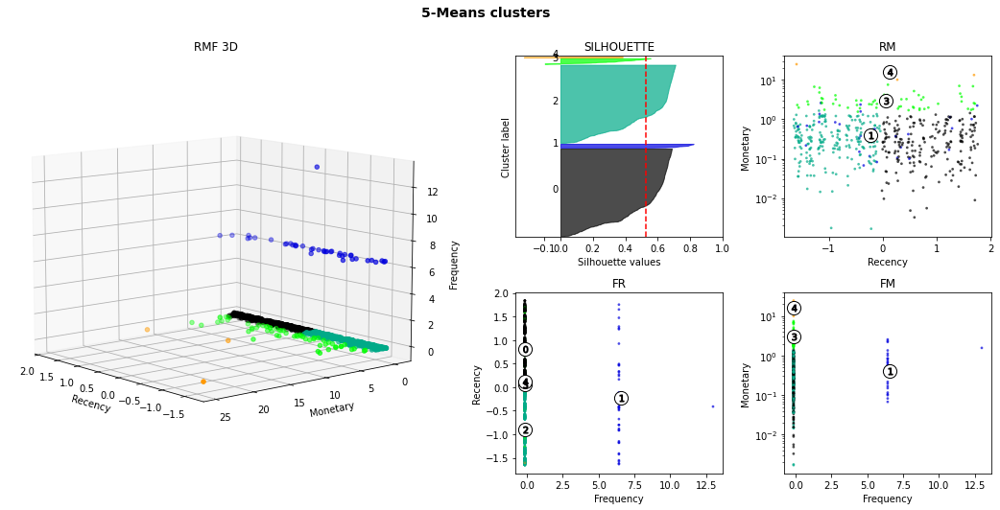

silhouette average : 0.526
k-means fit time : 1.172
silouhette compute time : 0.242


,R,F,M
customer_id,,,
002d71b244beb91ca7030b15ab526446,-1.174892,-0.148626,-0.133207
0036a074f98b80c4f1fc33dbbcf9c552,1.282615,-0.148626,-0.465189
00dd4390a8e8ad7a126e8331decc49ce,1.517536,-0.148626,-0.213428
016846e2dd862cba9a2a10eff5ac244f,1.222781,-0.148626,1.166935
0178b244a5c281fb2ade54038dd4b161,1.645287,-0.148626,-0.240910
...,...,...,...
ff5017601705e932d5545e0eb337cd0b,0.963636,-0.148626,-0.028864
ff70aa1b53f643263ead50eed3166164,0.089175,-0.148626,-0.430722
ff8892f7c26aa0446da53d01b18df463,-1.580318,-0.148626,0.368276


SLICE 8 :
start date: 2017-05-25 00:00:00
end date: 2017-06-09 00:00:00
# customers: 11687
# orders: 11953


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


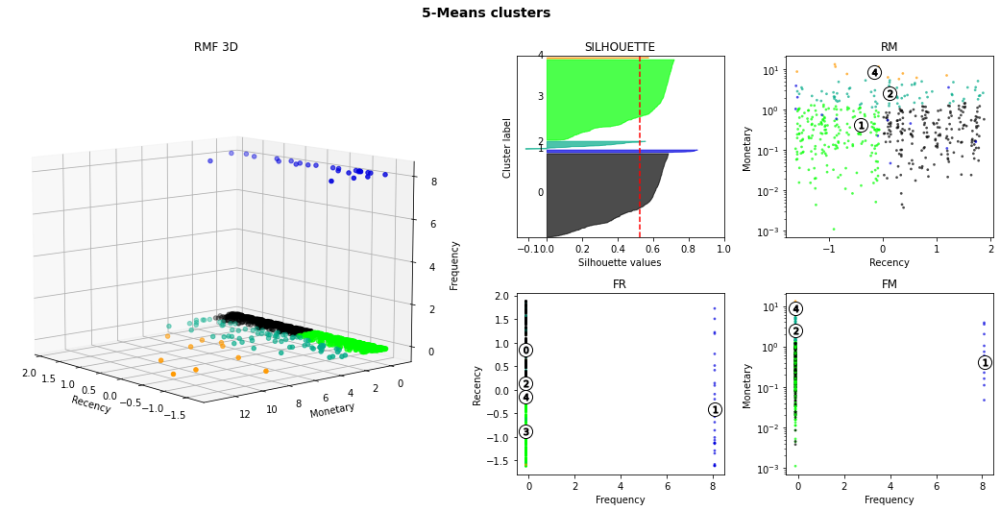

silhouette average : 0.526
k-means fit time : 1.242
silouhette compute time : 0.24


,R,F,M
customer_id,,,
008fb2ecc75561d202dd4db2e0ceec25,0.259063,-0.123669,-0.549097
0103751df12aea8b962cfbcd2b61104c,1.418117,-0.123669,-0.575578
01051cf3719a23faec8b2307b369faeb,1.209206,-0.123669,-0.057142
0189955e61056a22dd6e7cb03603a149,-1.618322,-0.123669,-0.223055
0189cca3aa2a0f75ca0cde94ee38be57,-0.896361,-0.123669,-0.275743
...,...,...,...
ff4136190ebc2a5c0bff70b569fe9180,-0.798722,-0.123669,-0.498703
ffd44de1326179fff550dae07c6884c2,0.774418,-0.123669,-0.178582
ffe4c3aa14d4702fb11fe5b3c4dd755c,1.750355,-0.123669,-0.106067


SLICE 9 :
start date: 2017-06-09 00:00:00
end date: 2017-06-24 00:00:00
# customers: 13167
# orders: 13486


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=6.
  warnings.warn(


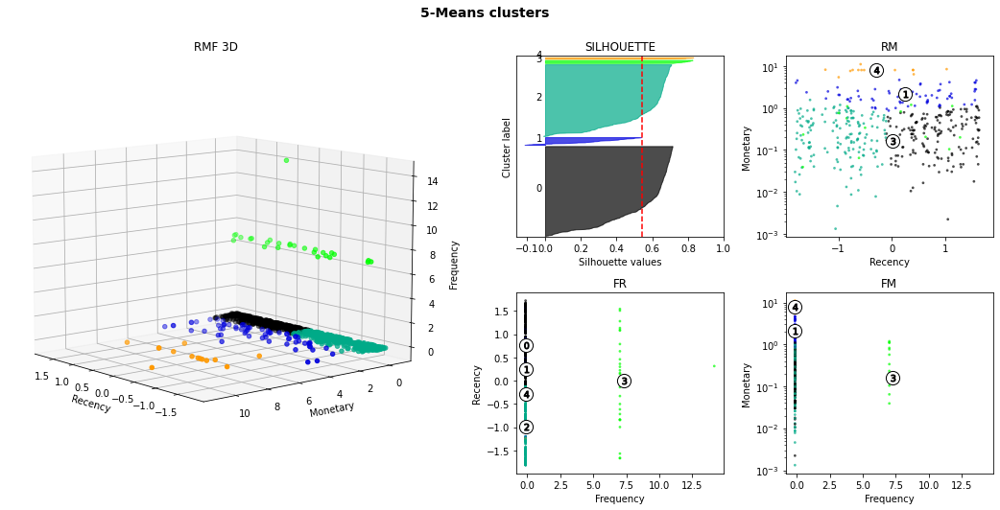

silhouette average : 0.545
k-means fit time : 1.34
silouhette compute time : 0.28


,R,F,M
customer_id,,,
00324c9f4d710e7bac5c5ba679714430,-1.313096,-0.132933,-0.221839
00444f48f6c9b55657e49435ce3a97ca,1.572394,-0.132933,-0.469223
0049dadc30da6a277c1e9d371df5a66f,0.589839,-0.132933,-0.582873
0059acd36094bf670ec8b21be6c0044c,0.807165,-0.132933,-0.493746
009301957bc7714394865c44650d8060,-1.697124,-0.132933,-0.290796
...,...,...,...
ff9e11d25bd3a13105fbf416eee813c5,0.588471,-0.132933,0.045672
ffbb8dfaa0e54649d8690b85a3ef890d,-0.743328,-0.132933,-0.567961
ffbf790cac0b6cf2e411d9f158c0fbe2,1.495155,-0.132933,-0.113878


SLICE 10 :
start date: 2017-06-24 00:00:00
end date: 2017-07-09 00:00:00
# customers: 14780
# orders: 15144


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


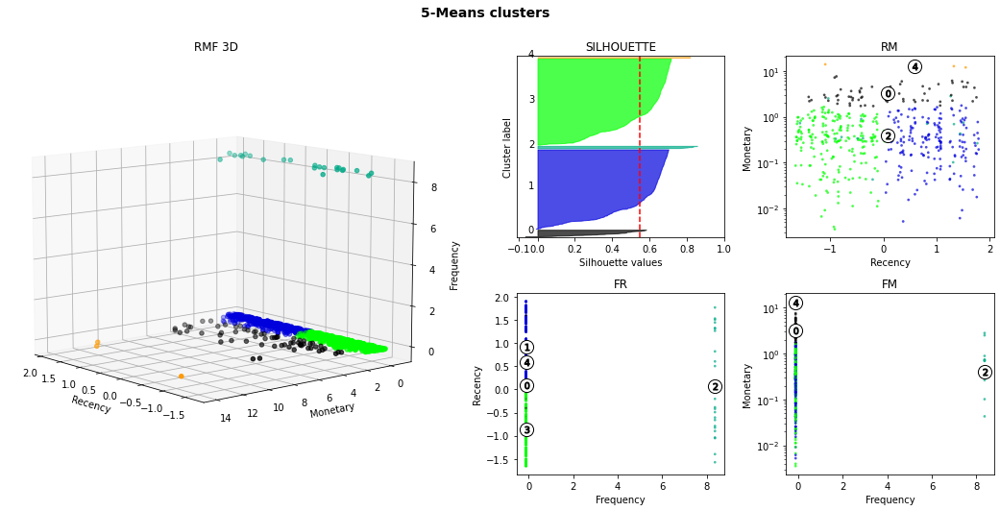

silhouette average : 0.546
k-means fit time : 1.239
silouhette compute time : 0.232


,R,F,M
customer_id,,,
0011857aff0e5871ce5eb429f21cdaf5,0.842640,-0.119449,0.165908
001a2bf0e46c684031af91fb2bce149d,0.490375,-0.119449,-0.588068
00a6ee75a90222405df9d8d59babc513,-1.174368,-0.119449,-0.475430
00cd767526517f8a4fc27db6cc5a52fa,1.079521,-0.119449,-0.305605
00d7e54ab8c5d9916f19209dbaacbb3d,0.139976,-0.119449,-0.320868
...,...,...,...
ff095a5f37e0c0199dfd3f2359ecf6b8,0.334390,-0.119449,-0.262230
ff423b634e7bbec16b9f1466f126eb18,-0.545129,-0.119449,0.105146
ff4aa52d77226e6f84a7da6391604266,0.756548,-0.119449,0.142289


SLICE 11 :
start date: 2017-07-09 00:00:00
end date: 2017-07-24 00:00:00
# customers: 16733
# orders: 17160


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


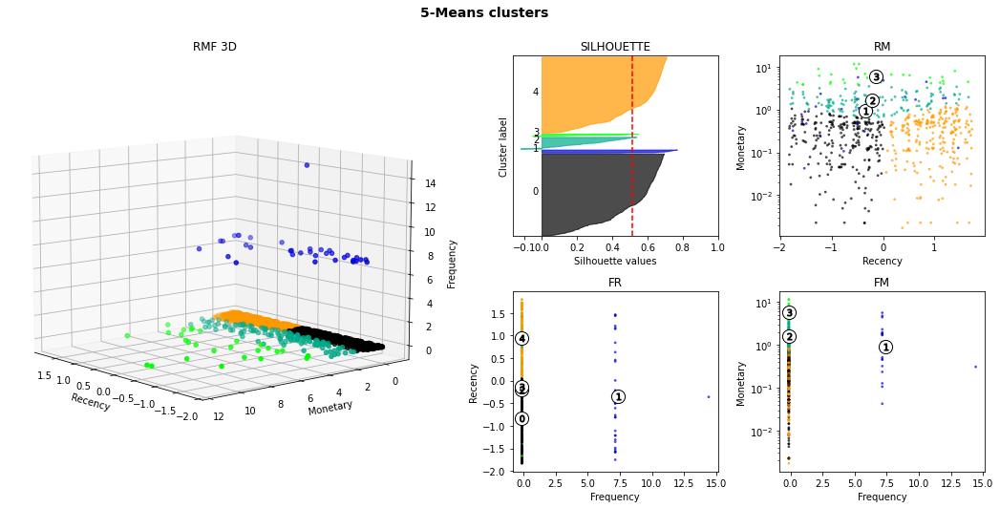

silhouette average : 0.512
k-means fit time : 1.287
silouhette compute time : 0.416


,R,F,M
customer_id,,,
0006fdc98a402fceb4eb0ee528f6a8d4,-0.467457,-0.132389,-0.728413
0010a452c6d13139e50b57f19f52e04e,1.216968,-0.132389,1.092509
002eb8b96288f3804e21d2777ac29895,-1.482282,-0.132389,-0.060032
0037eb1ff742ee2e71ba887f65f3c6f3,0.754003,-0.132389,0.496799
008778a1591d49f6b2464dffaa4fa662,-0.815837,-0.132389,0.691567
...,...,...,...
ff73dbd0440a0f1fac45e49efd6398b4,-1.085646,-0.132389,-0.735956
ff84c3cbb72d9419e3f76a6029f6f07d,0.851307,-0.132389,1.186950
ff983093f2d26e43569f7d58782faffb,-0.543881,-0.132389,-0.451470


SLICE 12 :
start date: 2017-07-24 00:00:00
end date: 2017-08-08 00:00:00
# customers: 18733
# orders: 19228


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


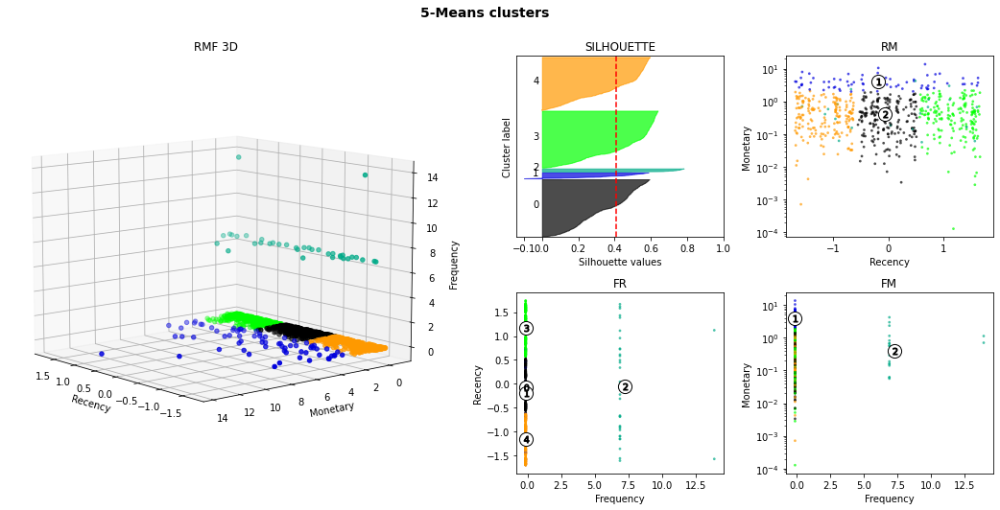

silhouette average : 0.407
k-means fit time : 1.646
silouhette compute time : 0.295


,R,F,M
customer_id,,,
0011c98589159d6149979563c504cb21,-1.145274,-0.131256,-0.184808
004288347e5e88a27ded2bb23747066c,0.922132,-0.131256,0.593207
0046311f458d8041b00063cb99482903,-0.276507,-0.131256,-0.217588
004ed862ea4e55f18868d3d782d10879,-1.436558,-0.131256,-0.235351
006d763076d74d16d66e828e79ec1544,-1.109226,-0.131256,-0.293608
...,...,...,...
ff95640b1b541ba71eaa077fd1853ca0,-0.883585,-0.131256,-0.513135
ff9c5dff16d7d6bfefc2acf5088d7b90,-1.109239,-0.131256,-0.445413
ffcdafd7d9f69caf44c3aa1ff78c32b4,0.659791,-0.131256,-0.350578


SLICE 13 :
start date: 2017-08-08 00:00:00
end date: 2017-08-23 00:00:00
# customers: 20805
# orders: 21369


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


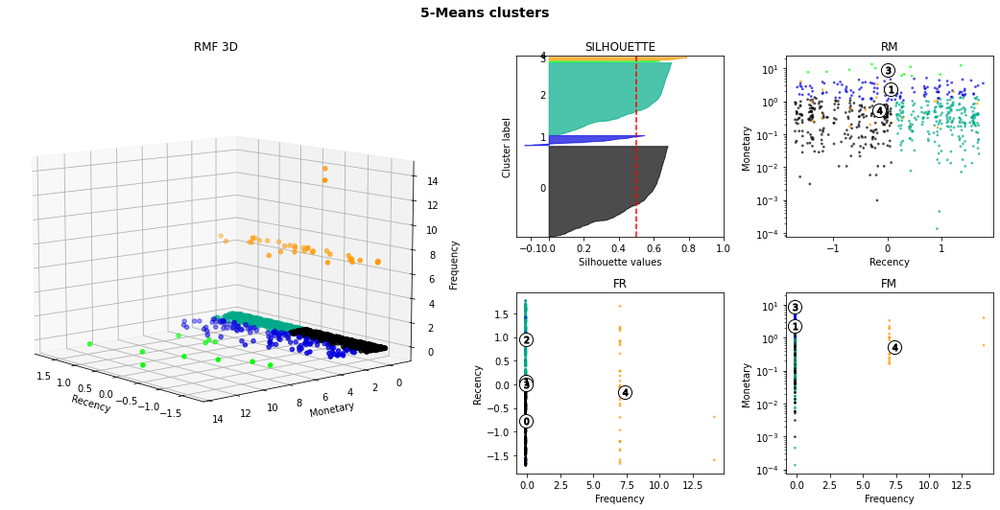

silhouette average : 0.501
k-means fit time : 1.299
silouhette compute time : 0.39


,R,F,M
customer_id,,,
000a5ad9c4601d2bbdd9ed765d5213b3,0.948293,-0.12892,-0.325561
000de6019bb59f34c099a907c151d855,-0.500570,-0.12892,0.549278
001926cef41060fae572e2e7b30bd2a4,-0.440005,-0.12892,-0.325929
0036b4a3d09ad551a5188c2e374da402,1.389553,-0.12892,0.050837
00765d375af0e700f61c57db00a8ee63,1.150443,-0.12892,0.325882
...,...,...,...
ffc04aafbf624bd130516cc1d195626a,0.681993,-0.12892,-0.712541
ffc142edc6bce329c6df0006387a5a77,-1.661352,-0.12892,-0.665682
ffc9d8a98ebd09a78c8adb729c3cfa2a,0.158715,-0.12892,-0.397744


SLICE 14 :
start date: 2017-08-23 00:00:00
end date: 2017-09-07 00:00:00
# customers: 22759
# orders: 23400


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


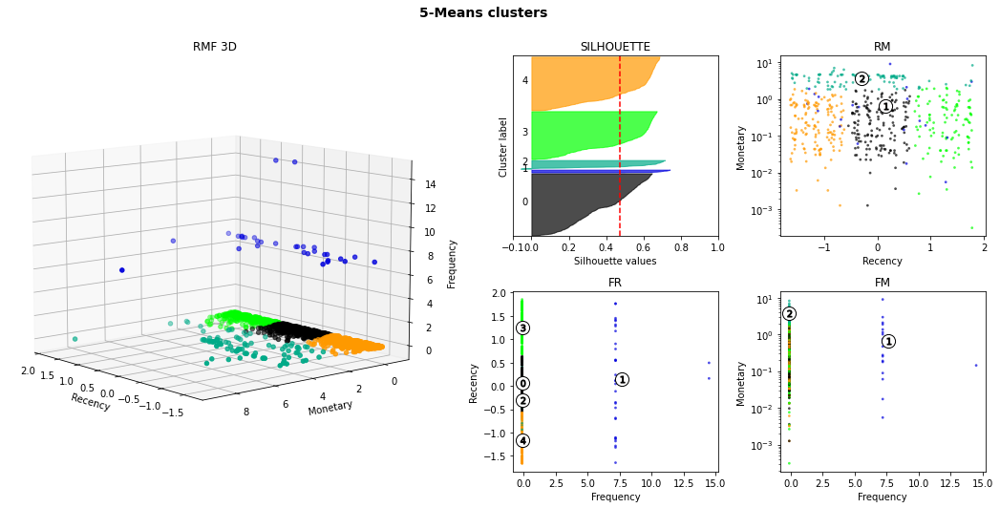

silhouette average : 0.471
k-means fit time : 1.206
silouhette compute time : 0.336


,R,F,M
customer_id,,,
001147e649a7b1afd577e873841632dd,-0.181152,-0.124375,0.108024
003035f5ec76f2220098377482de93c9,0.483649,-0.124375,-0.487815
0047f3e16441284d757a8963344f6c59,0.592652,-0.124375,-0.433243
004b45ec5c64187465168251cd1c9c2f,-0.367668,-0.124375,-0.346906
005e32bc930906dc6b65fb9d11cce3e2,-0.934079,-0.124375,-0.539044
...,...,...,...
ff9d2f60401262b9da1e868f956fb2a8,0.270734,-0.124375,0.902011
ffcf1dc25f2222aea1aef48841f20f3a,-1.513771,-0.124375,-0.321033
ffdcd85e0e81fc93f49bef4d54a4e61f,0.354021,-0.124375,-0.427710


SLICE 15 :
start date: 2017-09-07 00:00:00
end date: 2017-09-22 00:00:00
# customers: 24947
# orders: 25671


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


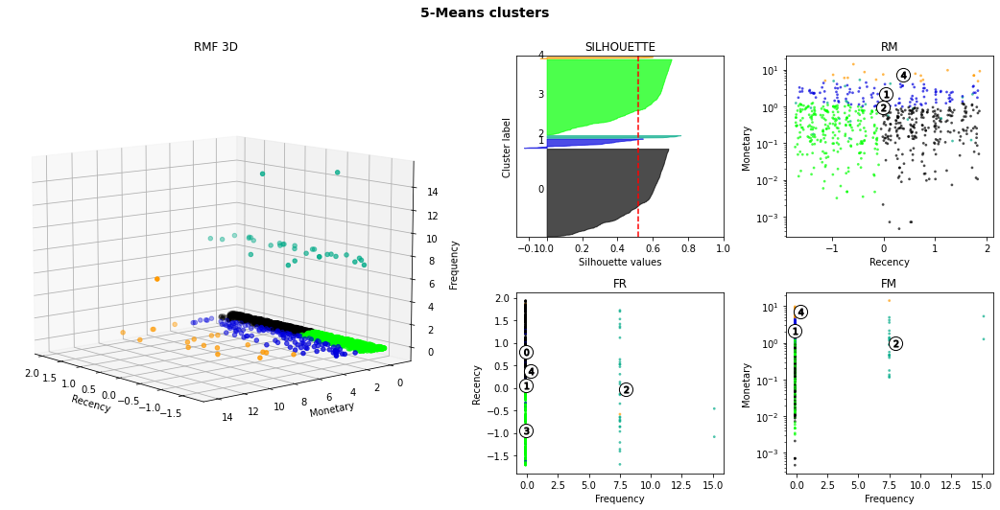

silhouette average : 0.515
k-means fit time : 1.288
silouhette compute time : 0.515


,R,F,M
customer_id,,,
005ff4ebe100db3eebbe6f7b19a8f99a,0.324709,-0.119364,0.353144
00776f3807b128beca64cd0b27138d92,-1.665908,-0.119364,0.763259
009062f98089a091615b5c9faa13de26,0.490129,-0.119364,-0.646208
00970787f181925ba33bd32b3817f742,-0.268064,-0.119364,-0.621386
00ae9ea276a5a4335382c9391059ddf2,0.394362,-0.119364,-0.115275
...,...,...,...
ff48228323a1d52f3b3108316bdc4314,1.705174,-0.119364,-0.153838
ff922bdd6bafcdf99cb90d7f39cea5b3,0.088705,-0.119364,-0.586645
ffa652b0cdf8bba29664149a9e579134,0.733291,-0.119364,-0.315106


SLICE 16 :
start date: 2017-09-22 00:00:00
end date: 2017-10-07 00:00:00
# customers: 26945
# orders: 27747


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


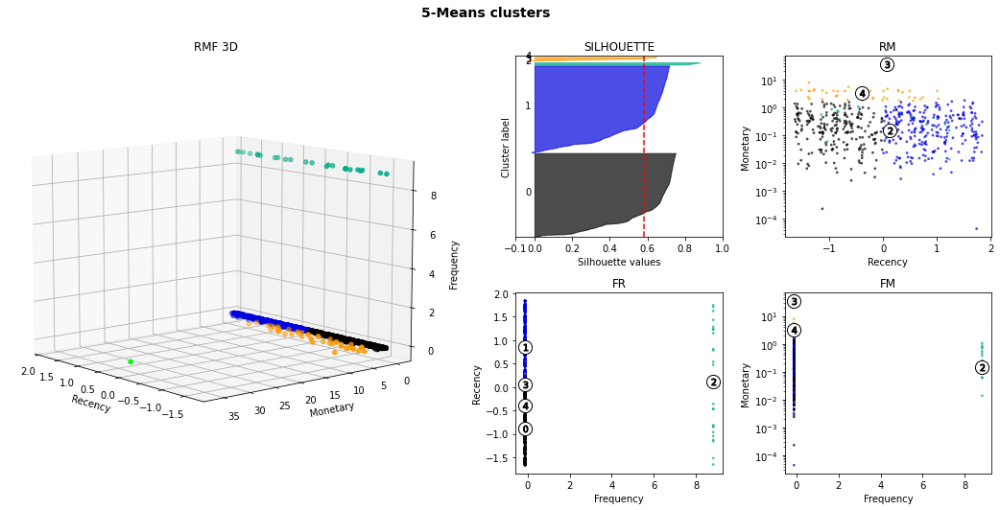

silhouette average : 0.581
k-means fit time : 1.799
silouhette compute time : 0.372


,R,F,M
customer_id,,,
000bfa1d2f1a41876493be685390d6d3,0.063277,-0.11334,-0.330531
004ad212c650c96c8a48f30855a7bcb8,1.273878,-0.11334,-0.386713
005ee3e015ec18092d7782e507cf68fe,-0.358197,-0.11334,0.047886
007ad549acb91673f04eac22c0568114,0.766717,-0.11334,-0.212536
00e5ea6932dffb682bd3d5760e84d176,0.750968,-0.11334,-0.271426
...,...,...,...
ff1e14670fe58a60d27e35069844b3d8,0.061862,-0.11334,0.024877
ff44084bf8313fa8eae5ce6e43e341ed,-1.156816,-0.11334,0.270791
ff755148365a0062374c353946b68aa3,0.801554,-0.11334,0.098598


SLICE 17 :
start date: 2017-10-07 00:00:00
end date: 2017-10-22 00:00:00
# customers: 29156
# orders: 30037


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


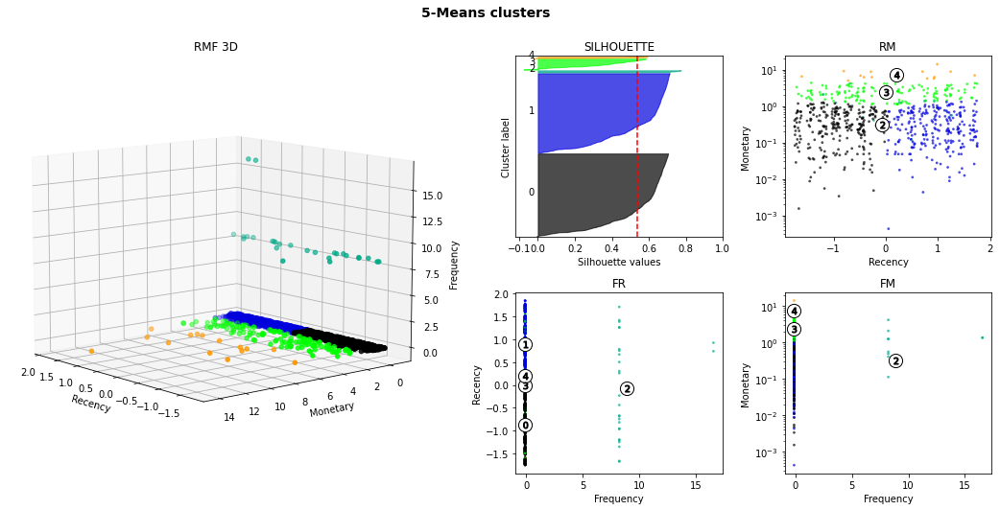

silhouette average : 0.536
k-means fit time : 1.496
silouhette compute time : 0.396


,R,F,M
customer_id,,,
0000f6ccb0745a6a4b88665a16c9f078,0.444474,-0.106771,-0.612832
0012929d977a8d7280bb277c1e5f589d,-0.711742,-0.106771,-0.076045
002ae492472e45ad6ebeb7a625409392,1.372808,-0.106771,0.225865
004177f7bf62929186b32c7fdaa6157b,-1.196596,-0.106771,1.257562
0065f6fb341f013a95a8e11cdc98d07a,1.223286,-0.106771,-0.250119
...,...,...,...
fedd4c0ac17d47475d8178c97f1724fb,-1.391279,-0.106771,-0.559359
ff28d873d960260278acba659ac5752d,-0.064527,-0.106771,-0.553274
ff36fa1d315d885d3c5171ea09996142,0.201151,-0.106771,-0.515182


SLICE 18 :
start date: 2017-10-22 00:00:00
end date: 2017-11-06 00:00:00
# customers: 31157
# orders: 32115


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


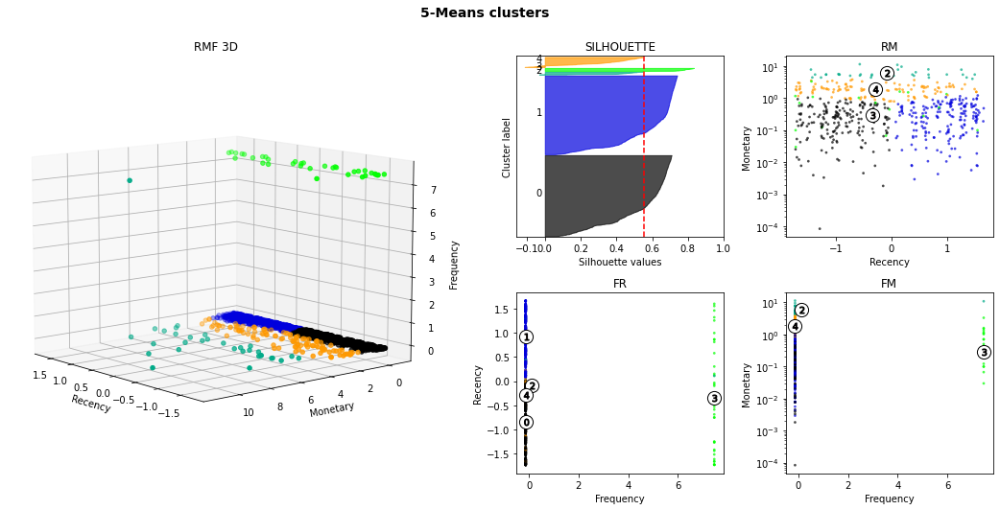

silhouette average : 0.554
k-means fit time : 1.645
silouhette compute time : 0.288


,R,F,M
customer_id,,,
00293787e2aec37a9c253b63fdfe2049,0.395897,-0.133963,0.344455
0029bd580d3012618731f5abb174a07f,-0.958395,-0.133963,-0.508029
002cdf87d4c03f08f7eb4551a923affc,-0.542896,-0.133963,0.223317
002feefec5af0a3b26ee7839c66d205e,-0.038907,-0.133963,-0.403527
00575b2023dedcc0f3e81a938834689b,-1.479434,-0.133963,-0.591000
...,...,...,...
ff66d86dd60a80525875a584d0f5d399,-0.722760,-0.133963,-0.205559
ff6d4669ac6694f4ad278d23c4c7caa5,0.676485,-0.133963,-0.107321
ffba2b15e7a4608fd6ae9aa92f610dc5,-0.101580,-0.133963,-0.580130


SLICE 19 :
start date: 2017-11-06 00:00:00
end date: 2017-11-21 00:00:00
# customers: 33838
# orders: 34875


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=11.
  warnings.warn(


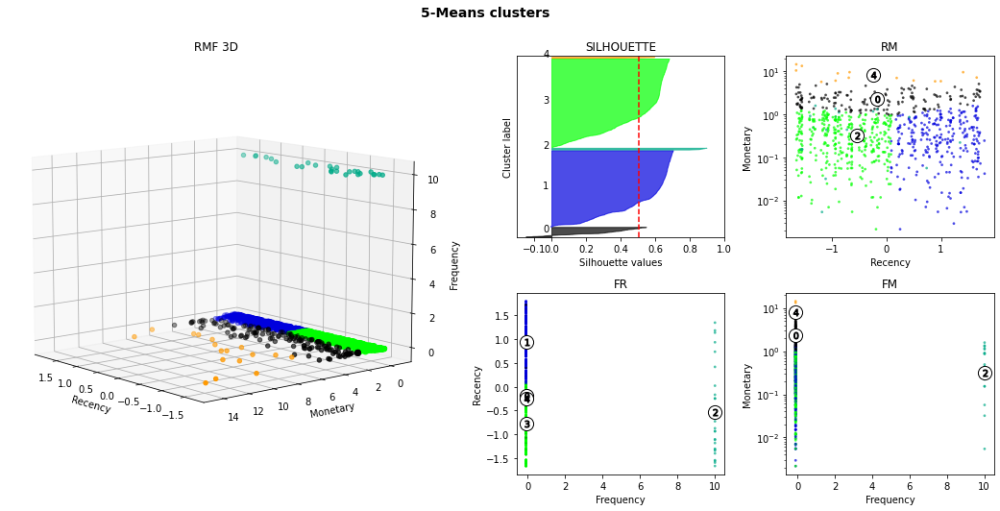

silhouette average : 0.506
k-means fit time : 1.894
silouhette compute time : 0.67


,R,F,M
customer_id,,,
0004aac84e0df4da2b147fca70cf8255,-0.239570,-0.099889,0.155991
00082cbe03e478190aadbea78542e933,-1.353140,-0.099889,-0.182480
001ae44fa04911a9e9577356dce6c63c,1.630719,-0.099889,-0.230546
003f4901fdb60ae9c1e2538b84c208e1,-1.401423,-0.099889,-0.007422
009a0802534f904b40b9d512b49794e1,-0.652625,-0.099889,-0.350062
...,...,...,...
ff7b8116de7a8a5f5c8abbae6399608b,-0.698379,-0.099889,-0.014610
ff7c033bfd33a1af06ac30c07492a859,-1.357782,-0.099889,-0.248852
ff913fbe58ff8a761c3b01f4c718fc85,-1.559551,-0.099889,0.518327


SLICE 20 :
start date: 2017-11-21 00:00:00
end date: 2017-12-06 00:00:00
# customers: 39146
# orders: 40370


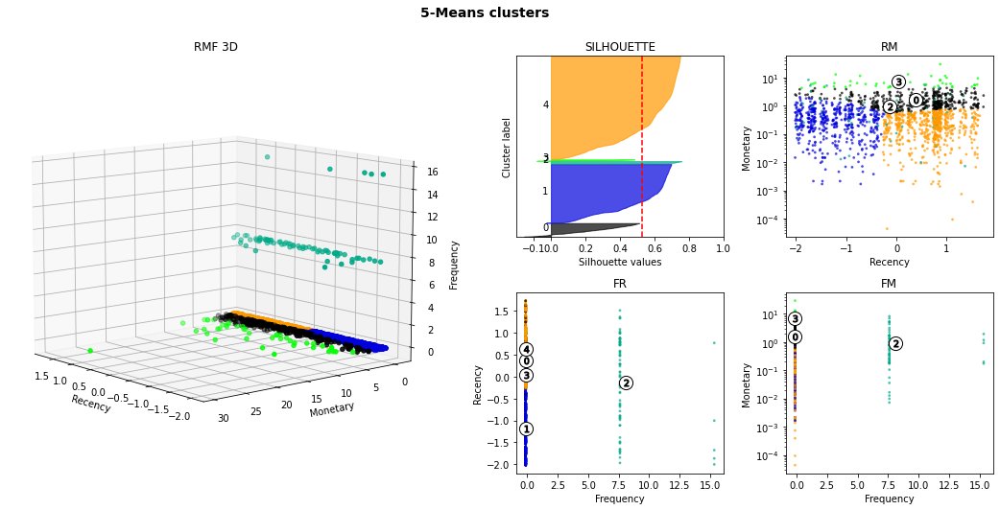

silhouette average : 0.529
k-means fit time : 1.692
silouhette compute time : 1.754


,R,F,M
customer_id,,,
002bdeb33da5b1b3ce8b9c822f749c82,-1.968294,-0.116991,-0.582655
00377a18050b898b93e2c774be9947db,0.592021,-0.116991,-0.445008
003d56767e53e08671de00da3fba8d40,-0.901306,-0.116991,0.115768
0042dcca0ae57aaec6e808edc31a2d48,-1.143733,-0.116991,-0.349267
00543330561a9088f8b3879114a7b008,0.828138,-0.116991,-0.404345
...,...,...,...
ffbb6557e45f7158781514f0efddb0d5,0.976634,-0.116991,-0.130942
ffc741a42034ec5c25be020c656950eb,-0.463083,-0.116991,0.035537
ffd973d43cadfa3e60340bcad8d87696,0.261287,-0.116991,-0.148042


SLICE 21 :
start date: 2017-12-06 00:00:00
end date: 2017-12-21 00:00:00
# customers: 42079
# orders: 43400


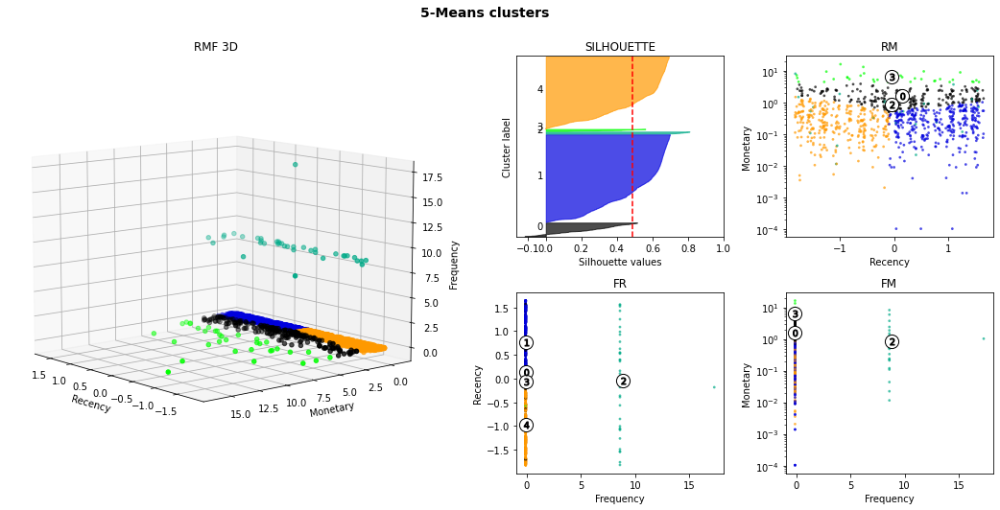

silhouette average : 0.488
k-means fit time : 1.434
silouhette compute time : 0.672


,R,F,M
customer_id,,,
000c8bdb58a29e7115cfc257230fb21b,0.036727,-0.110512,-0.680163
001ae5a1788703d64536c30362503e49,1.071239,-0.110512,-0.131438
0028a7d8db7b0247652509358ad8d755,-0.126471,-0.110512,1.005479
004a432489f6630c6dfd3fc4454603f5,-0.758583,-0.110512,-0.395610
006e937bd5a5e32043018a6d1521b5d5,0.526808,-0.110512,0.203290
...,...,...,...
ff94fd009b5a961313d7b3f2a1536c59,-0.342330,-0.110512,-0.154767
ffdde6e4dcb6ec3a882cfc6cddef7996,0.592493,-0.110512,3.292192
ffdf72e25c6f0503bb567d0a8cf1c159,0.812736,-0.110512,0.051108


SLICE 22 :
start date: 2017-12-21 00:00:00
end date: 2018-01-05 00:00:00
# customers: 44086
# orders: 45460


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


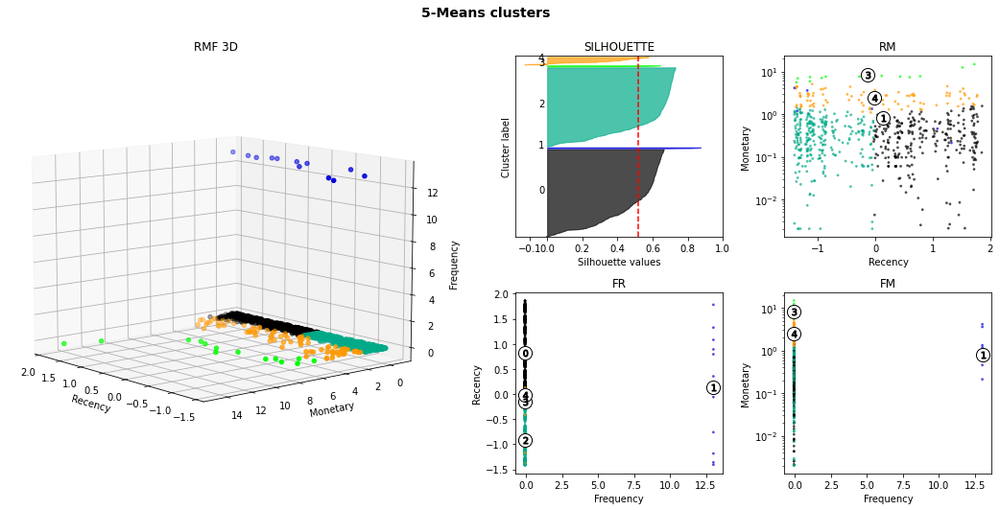

silhouette average : 0.52
k-means fit time : 1.625
silouhette compute time : 0.328


,R,F,M
customer_id,,,
0049a16516d38fc2246696172a257f16,0.012777,-0.076772,-0.651295
0078bb0f0d23e922d08437b7d0e13907,1.645355,-0.076772,-0.586634
007d9f716ead2bc8712255271a38f609,-0.683384,-0.076772,-0.452512
00986cafefb6e670cceca01694bda599,-0.487099,-0.076772,-0.456282
00a1c6913daeda0b7f9b79f802805fdb,0.441251,-0.076772,-0.259613
...,...,...,...
ffa8a7cd286a3431406fcb483d63df92,-0.490251,-0.076772,-0.558016
ffac330ca7f9bff857210af3a40b08d8,1.515374,-0.076772,-0.279148
ffc14413ed1273340b518ad0bc63c862,0.617725,-0.076772,-0.542364


SLICE 23 :
start date: 2018-01-05 00:00:00
end date: 2018-01-20 00:00:00
# customers: 47735
# orders: 49234


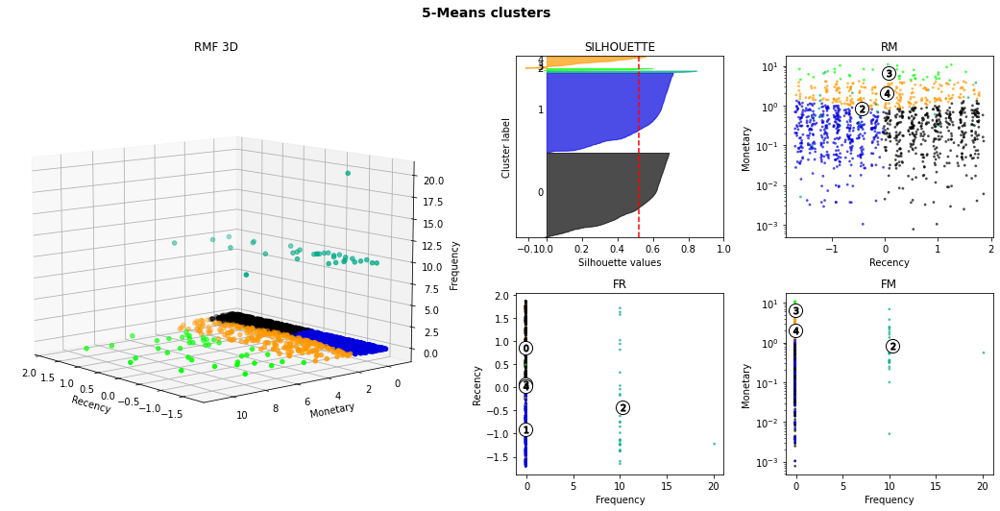

silhouette average : 0.519
k-means fit time : 1.969
silouhette compute time : 0.916


,R,F,M
customer_id,,,
000d460961d6dbfa3ec6c9f5805769e1,1.159739,-0.094519,-0.638663
0014a5a58da615f7b01a4f5e194bf5ea,-1.431863,-0.094519,-0.302182
0028cfeb9dfcd3628a56d5b6400deef5,1.385189,-0.094519,-0.204233
002d3bd901608f67c3fc11eaaa842b13,-0.697777,-0.094519,-0.680870
003650b504826ea534e02eba0ab58dd5,-1.107449,-0.094519,-0.718120
...,...,...,...
ffbd1090fa1840d6cf9106fb238089e9,0.991656,-0.094519,-0.398426
ffbe02226141ca45932dddadda83f9bd,-1.593719,-0.094519,-0.558353
ffcda3a0829ba6d3a02cd280e29b19a6,1.445923,-0.094519,-0.240471


SLICE 24 :
start date: 2018-01-20 00:00:00
end date: 2018-02-04 00:00:00
# customers: 50988
# orders: 52605


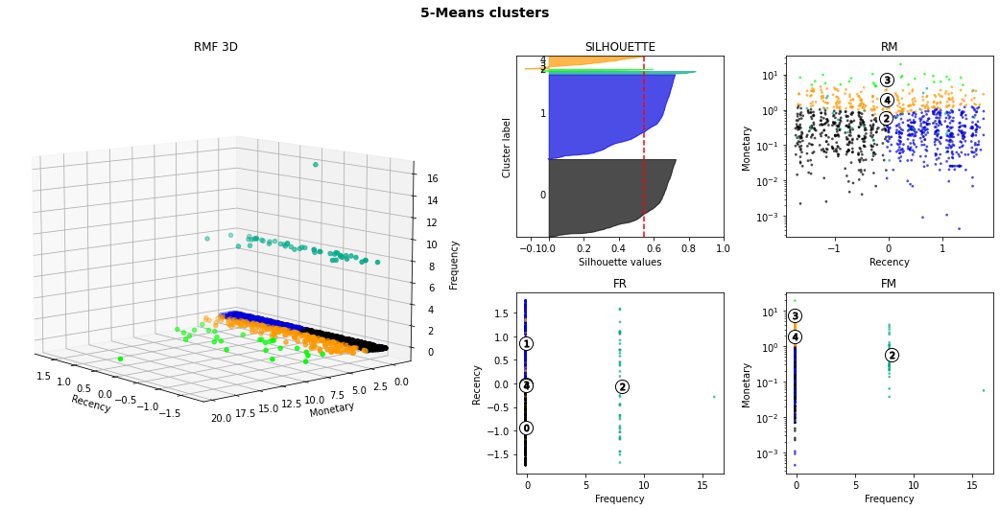

silhouette average : 0.546
k-means fit time : 1.566
silouhette compute time : 0.999


,R,F,M
customer_id,,,
002ed12115742033f015cb3c269ccf68,-0.704270,-0.121199,-0.230497
0036d365b138cc0ee06bed755bcb5044,-0.945649,-0.121199,-0.232029
00370dfde3d012c420d29657afc2fc8b,-0.462039,-0.121199,0.441589
0037aa56b017c105c3a9d47af71fff98,0.198950,-0.121199,1.533801
007a2fab7046647dad04fe7d08c57820,-1.703624,-0.121199,-0.142319
...,...,...,...
ff6a749412048de53e487708e585a0e4,1.123717,-0.121199,-0.505333
ff6de6cae279ba3f49b5d779351a9a1e,-0.199543,-0.121199,-0.242595
ff93b5e71bd5be1bbf74ac93c52adcf2,0.950045,-0.121199,1.087100


SLICE 25 :
start date: 2018-02-04 00:00:00
end date: 2018-02-19 00:00:00
# customers: 54274
# orders: 56030


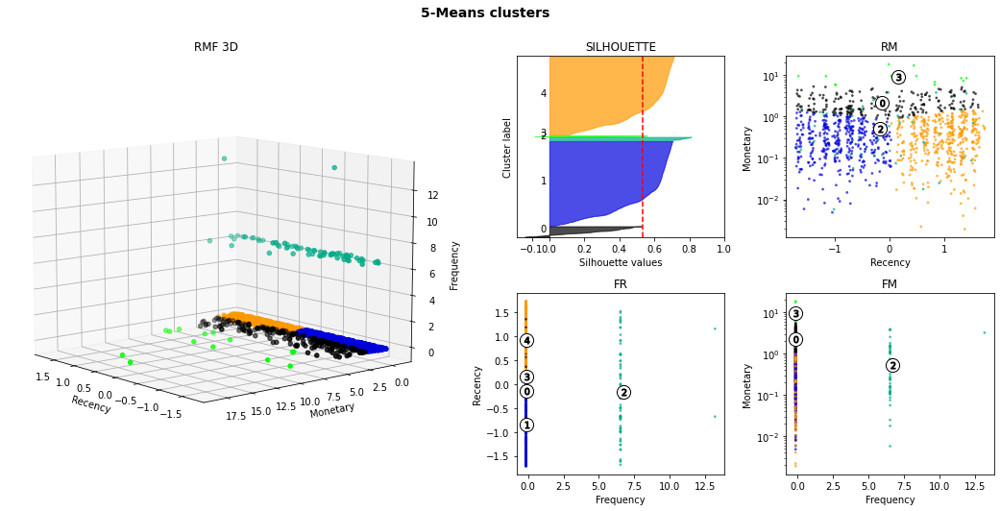

silhouette average : 0.532
k-means fit time : 1.249
silouhette compute time : 0.762


,R,F,M
customer_id,,,
0019da6aa6bcb27cc32f1249bd12da05,0.117995,-0.145196,-0.348040
002ef00822613c94613e60e03b169fef,-0.764841,-0.145196,-0.196846
004d17fa2cb102a7c4817f040c884e59,-0.403583,-0.145196,-0.623267
0055bbb9c95f6acb8db89d1f6c316407,-0.657152,-0.145196,-0.373765
006bbb235068a01d2e3e47fa09ccf53c,-0.976833,-0.145196,-0.656458
...,...,...,...
ffab104b9ba797387c58820356eb7551,1.418647,-0.145196,0.495214
ffb03435e357d6c137b5b24e34808df4,0.949355,-0.145196,-0.054150
ffb5431b49b42c9f3209f087e1bfdcfa,0.418706,-0.145196,-0.408449


SLICE 26 :
start date: 2018-02-19 00:00:00
end date: 2018-03-06 00:00:00
# customers: 58031
# orders: 59953


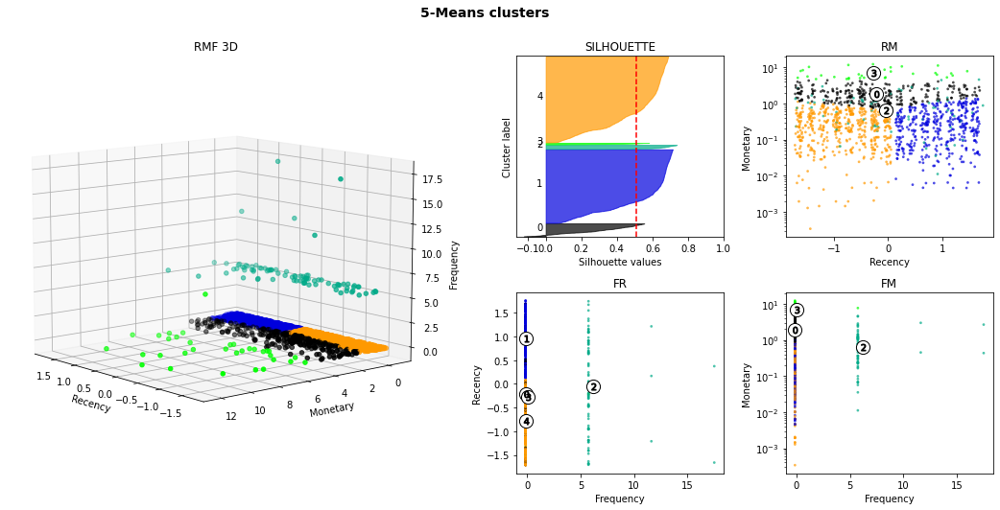

silhouette average : 0.511
k-means fit time : 1.488
silouhette compute time : 1.315


,R,F,M
customer_id,,,
00053a61a98854899e70ed204dd4bafe,-0.433896,-0.145974,1.446234
0010fb34b966d44409382af9e8fd5b77,-1.650966,-0.145974,-0.520479
00196fdb2bf9edfc35e88ebfbcf8d781,0.882391,-0.145974,-0.711988
002aba8c1af80acacef6e011f9f23262,-0.216708,-0.145974,0.337681
0058f300f57d7b93c477a131a59b36c3,1.597043,-0.145974,-0.422743
...,...,...,...
ff7bd992a7aac2c563a3e3773a8c63aa,0.001652,-0.145974,-0.695479
ff8fd64c1a5f9bebebc9bf3985dac068,-0.763121,-0.145974,-0.260180
ffa6acb325475c3f9816fa472652f1af,0.379277,-0.145974,0.189867


SLICE 27 :
start date: 2018-03-06 00:00:00
end date: 2018-03-21 00:00:00
# customers: 61491
# orders: 63527


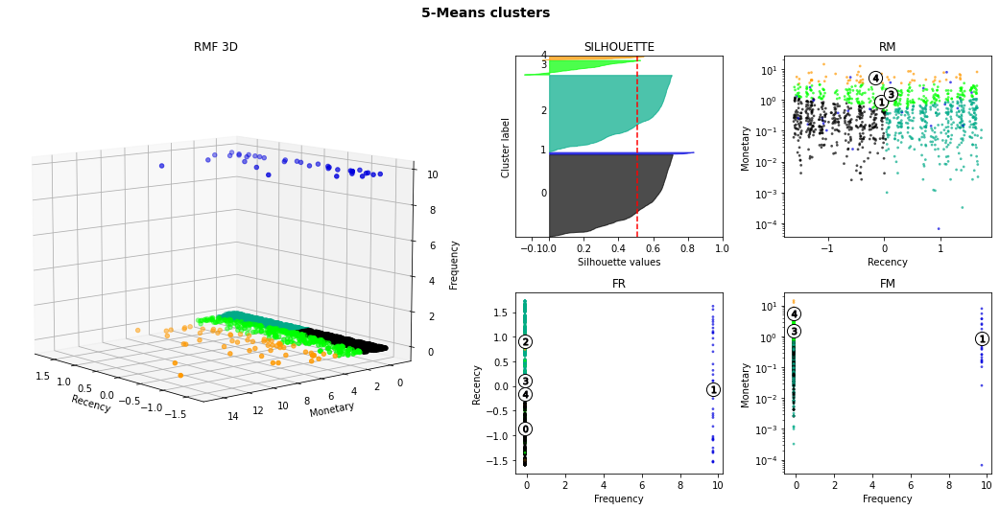

silhouette average : 0.508
k-means fit time : 1.41
silouhette compute time : 1.02


,R,F,M
customer_id,,,
0005ef4cd20d2893f0d9fbd94d3c0d97,0.254887,-0.102817,-0.172461
003ac9408252444b489b1bfc013f5f8c,-0.659982,-0.102817,-0.652868
0077dc76aaf02323f03bce9b00878253,0.460961,-0.102817,3.683324
007e21b7a007c8f8dadfa43c9d5a91db,0.629780,-0.102817,-0.478010
008b82b072c6b564fcce49a325f84097,0.669364,-0.102817,-0.610668
...,...,...,...
ffad6a7a0e13be3dfd9de96a81b77c9e,1.595161,-0.102817,-0.377403
ffbab763e1469af59b9882f0fc6e7d18,-0.354570,-0.102817,0.010216
ffbc87f67c513f71b9ffa68e72a2376e,-0.605943,-0.102817,-0.190895


SLICE 28 :
start date: 2018-03-21 00:00:00
end date: 2018-04-05 00:00:00
# customers: 64762
# orders: 66900


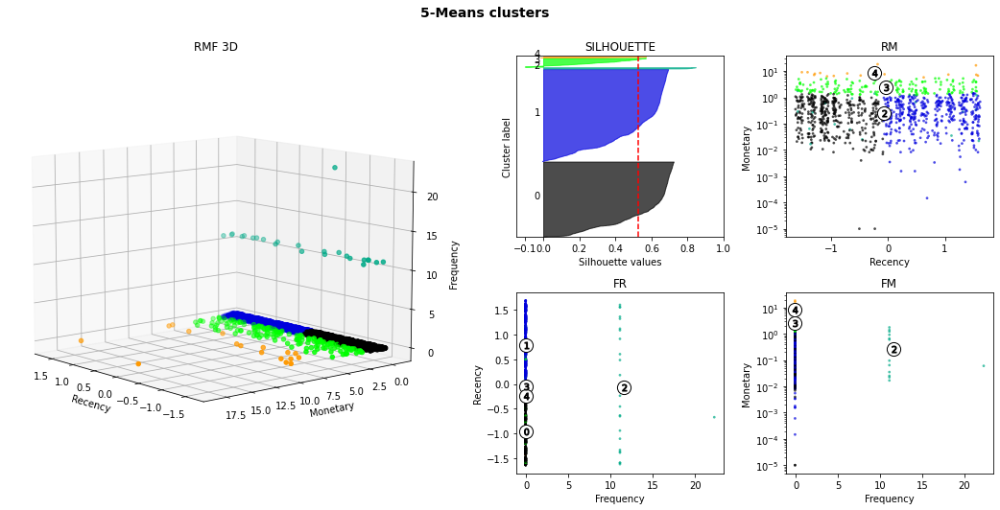

silhouette average : 0.526
k-means fit time : 1.23
silouhette compute time : 0.648


,R,F,M
customer_id,,,
00090324bbad0e9342388303bb71ba0a,0.886169,-0.08344,-0.463832
0023557a94bef0038066b5d1b3dc763e,-0.047519,-0.08344,-0.263031
0027324a96d26a2bc7d69262f83c8403,0.691242,-0.08344,-0.541254
003800162424b7b5b3d75c9cf22a66e7,-0.948556,-0.08344,-0.261334
004256f082951ec189a4962b6788c214,1.136450,-0.08344,0.432801
...,...,...,...
ff7bfe25f6e582f062fe91a506aef916,1.270426,-0.08344,-0.451311
ff7e7d4a4669fc03606a21eedad169e3,-0.000503,-0.08344,-0.616474
ff9584b796ae561b0085ebc998880a64,1.167278,-0.08344,-0.526256


SLICE 29 :
start date: 2018-04-05 00:00:00
end date: 2018-04-20 00:00:00
# customers: 68113
# orders: 70377


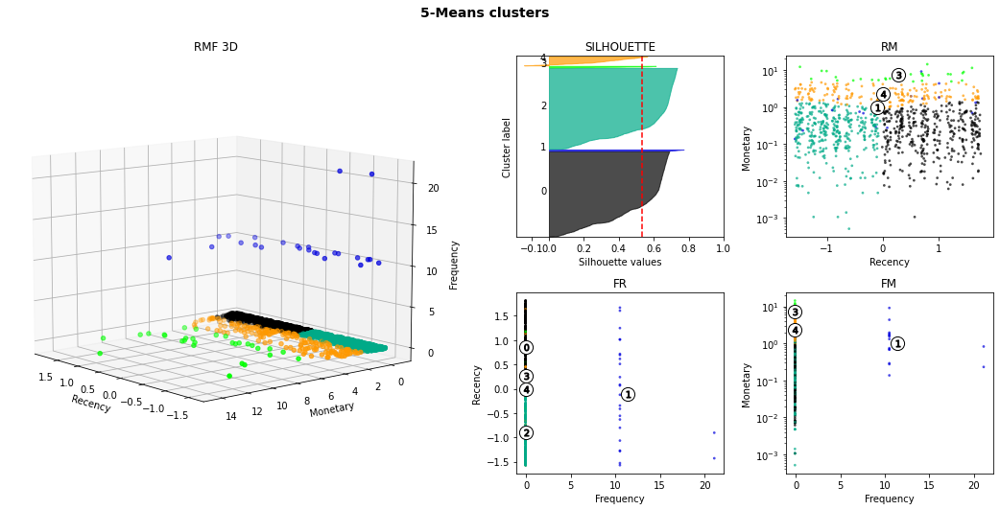

silhouette average : 0.534
k-means fit time : 1.685
silouhette compute time : 1.029


,R,F,M
customer_id,,,
0004bd2a26a76fe21f786e4fbd80607f,1.630499,-0.082844,-0.016135
002da6dde369f6a8b4c999ed61eb5a87,0.127681,-0.082844,-0.506588
003e2af81ea3c72fbdd093f07724a4de,-0.870401,-0.082844,-0.457970
00626f29f9b57d3ef7c1739ff03e944e,0.347725,-0.082844,-0.069417
006b297ed73773b17d8874a2eb4466e8,0.761160,-0.082844,-0.266582
...,...,...,...
ffbbb45b560b9ff08bdde6786987c796,0.733058,-0.082844,0.074338
ffc7d48d48327cf57757436b3f4706b0,-1.301986,-0.082844,0.163698
ffcd4b43c08405501a6bf2c66be83e83,-1.467557,-0.082844,-0.601126


SLICE 30 :
start date: 2018-04-20 00:00:00
end date: 2018-05-05 00:00:00
# customers: 71589
# orders: 73968


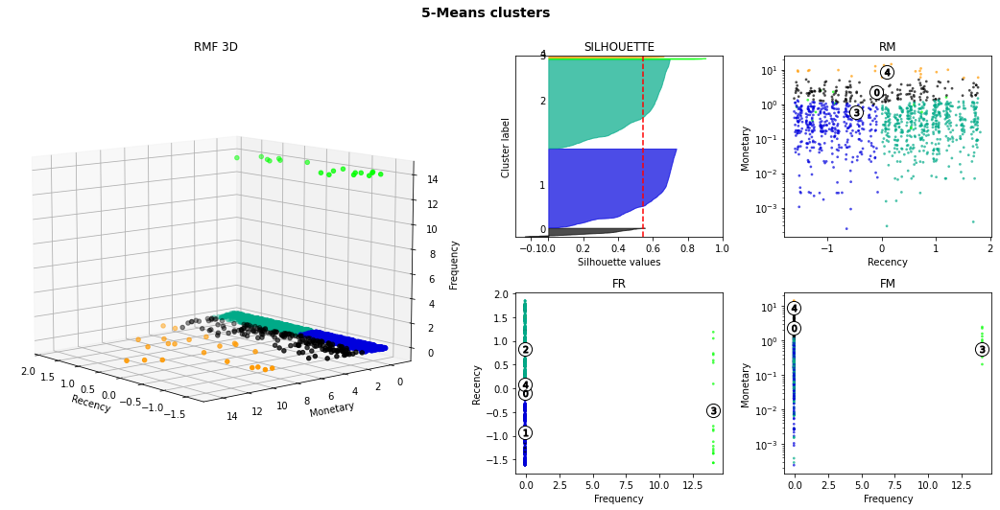

silhouette average : 0.543
k-means fit time : 1.417
silouhette compute time : 0.956


,R,F,M
customer_id,,,
00050ab1314c0e55a6ca13cf7181fecf,1.729093,-0.071157,-0.605509
000949456b182f53c18b68d6babc79c1,1.063694,-0.071157,-0.384646
0019e8c501c85848ac0966d45226fa1d,-0.783712,-0.071157,0.160626
003db7adfcdc49857b095a50191b6c9d,-1.046784,-0.071157,1.795163
004f84d065096f3cedd26cf0adc80b9d,0.471756,-0.071157,0.121867
...,...,...,...
ffc46f230cc7ce6109908f432eb9eb5b,-0.870937,-0.071157,0.551762
ffe76cb2f4bb39384c432d65ece67441,0.595688,-0.071157,-0.460318
ffecceca389973ef16660d58696f281e,0.579336,-0.071157,-0.428610


SLICE 31 :
start date: 2018-05-05 00:00:00
end date: 2018-05-20 00:00:00
# customers: 75523
# orders: 78039


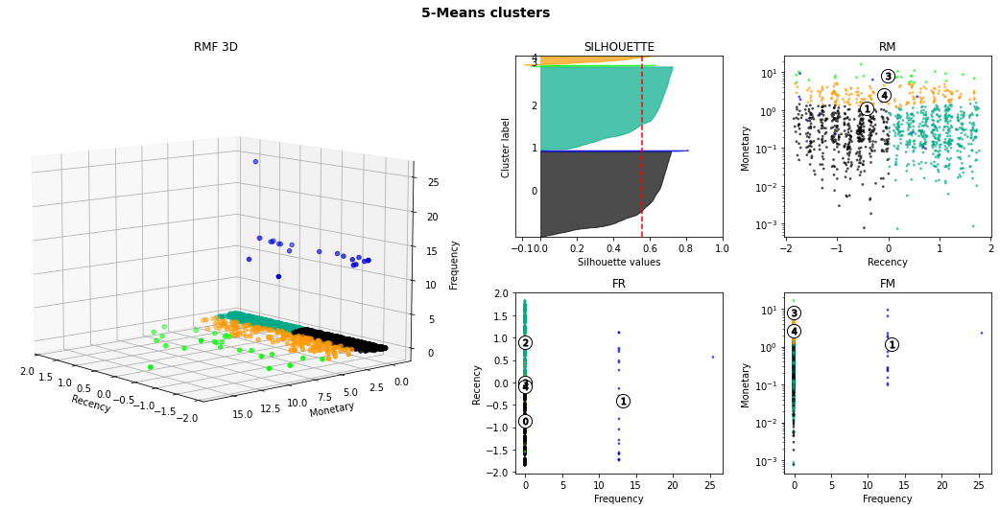

silhouette average : 0.559
k-means fit time : 1.53
silouhette compute time : 1.133


,R,F,M
customer_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,0.490698,-0.07249,-0.118007
0000b849f77a49e4a4ce2b2a4ca5be3f,1.224150,-0.07249,-0.611526
0034c76b7e6a17d738375b99afc2f01e,1.172092,-0.07249,-0.538215
0035029989e6fc5cf030918a5f9f2037,-0.036062,-0.07249,1.621077
003fee4ca17927283128c7ddc6f9311b,0.958860,-0.07249,-0.283345
...,...,...,...
ffca00fb352b5e57db50865d65098b4a,0.362640,-0.07249,-0.523673
ffcb3eb07f2a033d45949fcecd160d98,-0.074444,-0.07249,0.158116
ffd2e2ad95719ab7fedc9e02c5e26a62,-1.287981,-0.07249,-0.538215


SLICE 32 :
start date: 2018-05-20 00:00:00
end date: 2018-06-04 00:00:00
# customers: 77625
# orders: 80237


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=9.
  warnings.warn(


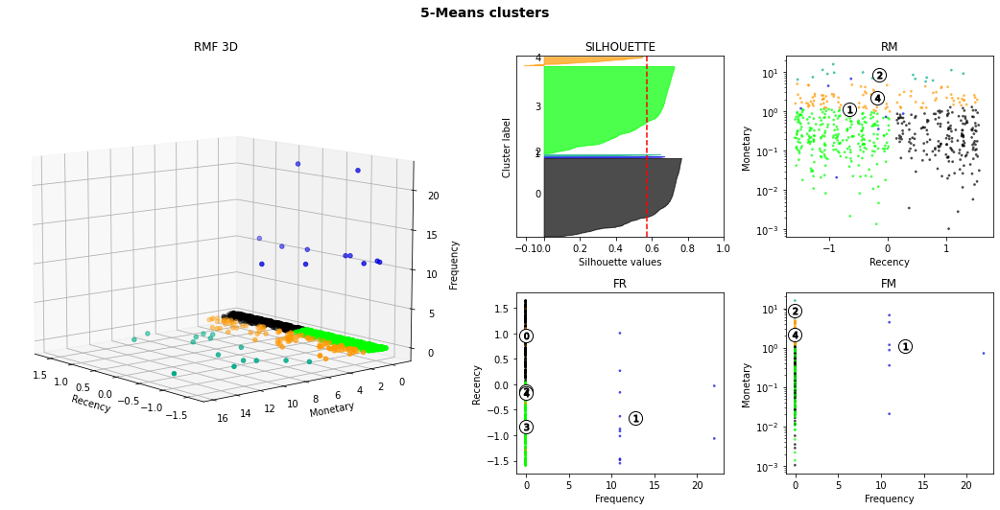

silhouette average : 0.574
k-means fit time : 1.919
silouhette compute time : 0.386


,R,F,M
customer_id,,,
000ed48ceeb6f4bf8ad021a10a3c7b43,1.496346,-0.070787,-0.573994
001a3a8e11d76c9a366c31a4aa2cc529,1.415808,-0.070787,-0.561259
00256bf7b05c08f6a5849df3d0a64f1f,-1.100150,-0.070787,-0.438671
004b45ec5c64187465168251cd1c9c2f,0.174295,-0.070787,-0.467507
005f060d4223956c62b64e9567a36f0f,1.009996,-0.070787,2.195887
...,...,...,...
ff325a460cc15654fa42b324fe0ab64b,1.311349,-0.070787,-0.344698
ff61f2506ff81e50510d8c0ac5570c30,0.243003,-0.070787,-0.184418
ffb1cf5736b51e47fec82cf40dd26303,0.023334,-0.070787,0.329539


SLICE 33 :
start date: 2018-06-04 00:00:00
end date: 2018-06-19 00:00:00
# customers: 80707
# orders: 83435


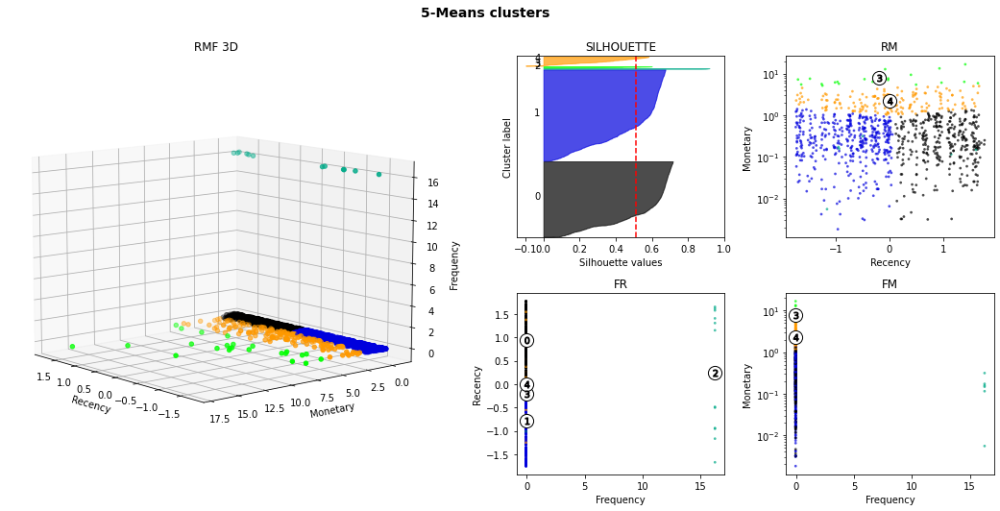

silhouette average : 0.51
k-means fit time : 1.278
silouhette compute time : 0.785


,R,F,M
customer_id,,,
004493e0b0a37317d25665d340c0677d,1.127306,-0.061488,-0.379349
006c10bfead12ac8d90486fb4ce4e603,-0.809696,-0.061488,-0.405965
007ba48697b079e78f168b051462dd1b,1.067767,-0.061488,-0.098096
0098853a28531d48988a2fb02b30840e,0.712782,-0.061488,-0.396540
00c05fe9d2f8b245f1f86fe559175f24,-0.732365,-0.061488,0.953263
...,...,...,...
ffa323b33234124b58b25511035c2855,-0.740120,-0.061488,0.571919
ffb52634b4c16223ff808f266332de04,0.711461,-0.061488,-0.369663
ffcb7bc68d6ec38fece3546240bd01e5,0.745336,-0.061488,-0.537603


SLICE 34 :
start date: 2018-06-19 00:00:00
end date: 2018-07-04 00:00:00
# customers: 83629
# orders: 86458


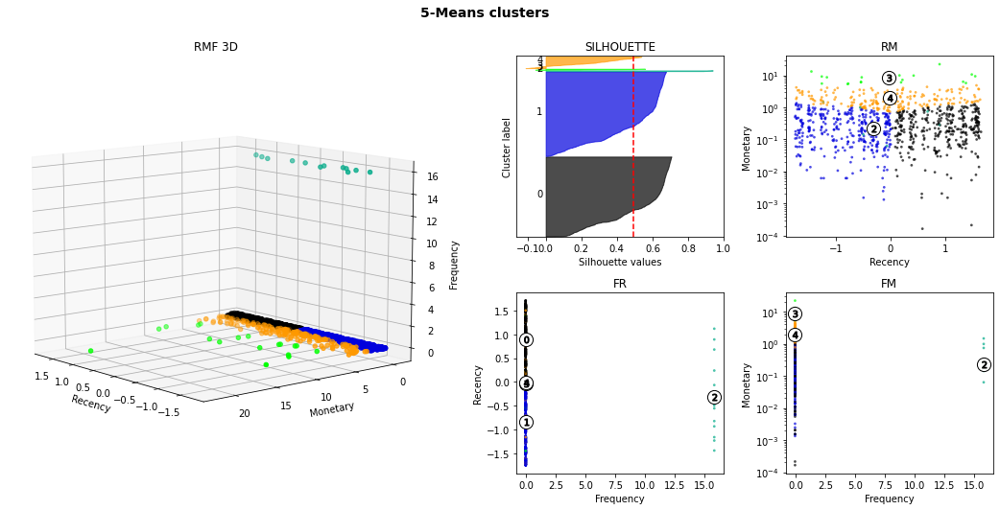

silhouette average : 0.494
k-means fit time : 1.379
silouhette compute time : 0.667


,R,F,M
customer_id,,,
000e309254ab1fc5ba99dd469d36bdb4,0.231421,-0.063256,-0.382591
001deb796b28a3a128d6113857569aa4,0.863957,-0.063256,-0.456253
002311514717ca8b65b09a26cdf7b91a,-0.246310,-0.063256,-0.158531
0033f4a2887e07e25aa1204d482f41ba,0.085016,-0.063256,1.309426
0045e9ad4d6c85d2323a7ab374b76183,1.488100,-0.063256,-0.647606
...,...,...,...
ffc4233210eac4ec1711a8b847196d4e,1.567815,-0.063256,-0.302779
ffd2aac179372f267e7b9186ac7a1bcc,1.573401,-0.063256,-0.623199
ffeb904468642a1ce663a322629801cb,-0.250015,-0.063256,-0.310882


SLICE 35 :
start date: 2018-07-04 00:00:00
end date: 2018-07-19 00:00:00
# customers: 86092
# orders: 89017


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=10.
  warnings.warn(


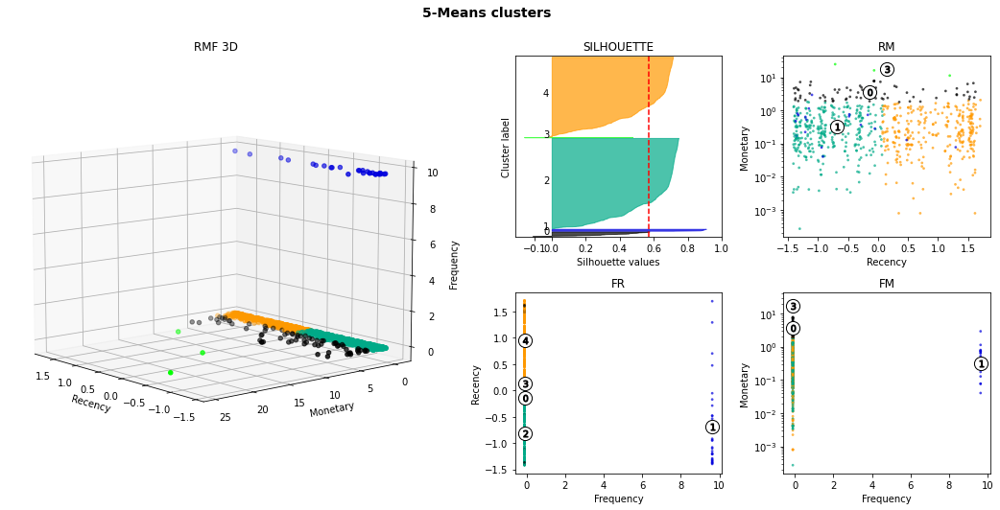

silhouette average : 0.569
k-means fit time : 1.668
silouhette compute time : 0.477


,R,F,M
customer_id,,,
001a34eb30ecb8e3aacb07c475ca4dd1,0.075734,-0.103819,-0.053299
003162bf0351f47a1a247992b8b9b42d,-0.514895,-0.103819,1.251586
0032ca69771a7758ce643258bb9e4ac7,-0.930436,-0.103819,-0.398794
00344274804f3b8003de1b0562ae01df,0.542446,-0.103819,0.171277
004df63539fd5e38d4b0a0506de7549c,-0.912649,-0.103819,2.842099
...,...,...,...
ff6c9c45f6cee4ec0785650b18322d73,-1.369121,-0.103819,4.844101
ff8a98860a86a0f563a92a43b3344414,-1.130242,-0.103819,-0.206902
ffb6123b45cfa6e6ff5ff94d404283b7,0.478416,-0.103819,-0.529008


SLICE 36 :
start date: 2018-07-19 00:00:00
end date: 2018-08-03 00:00:00
# customers: 89738
# orders: 92791


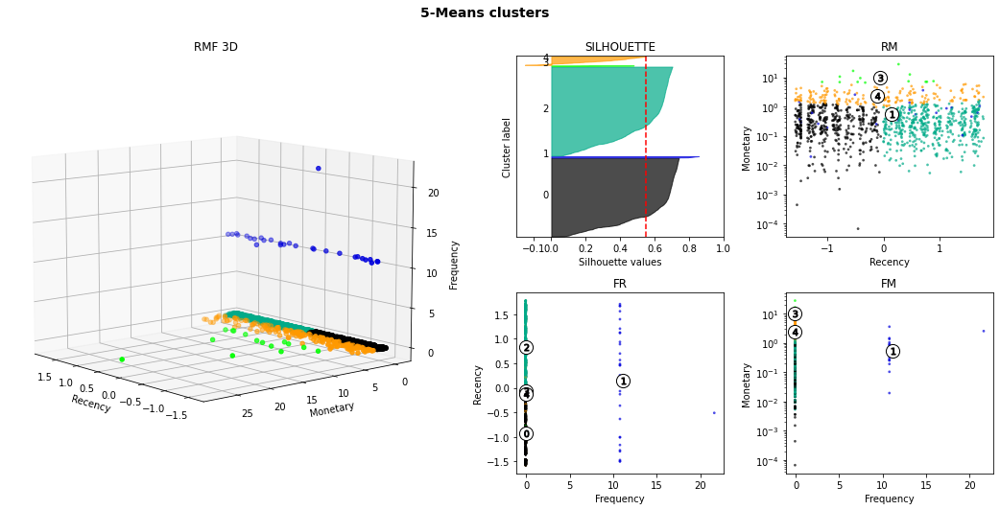

silhouette average : 0.549
k-means fit time : 1.752
silouhette compute time : 1.219


,R,F,M
customer_id,,,
000fbf0473c10fc1ab6f8d2d286ce20c,0.118426,-0.086999,0.810522
0015752e079902b12cd00b9b7596276b,-1.530424,-0.086999,-0.379016
00172711b30d52eea8b313a7f2cced02,-0.242447,-0.086999,-0.183559
00196c4c9a3af7dd2ad10eade69c926f,-0.327283,-0.086999,-0.533066
0025795df7a7d077c4c90162fa820085,0.553145,-0.086999,0.197055
...,...,...,...
ffc39051848c3ef2be36d1513aa3ad17,-1.259681,-0.086999,-0.519497
ffdf771c03dd683f1ed7017ae4e9efb2,-0.399931,-0.086999,-0.480116
ffe96c782a5bc522bd8bad3bc638981a,-0.820101,-0.086999,0.325871


SLICE 37 :
start date: 2018-08-03 00:00:00
end date: 2018-08-18 00:00:00
# customers: 93883
# orders: 97087


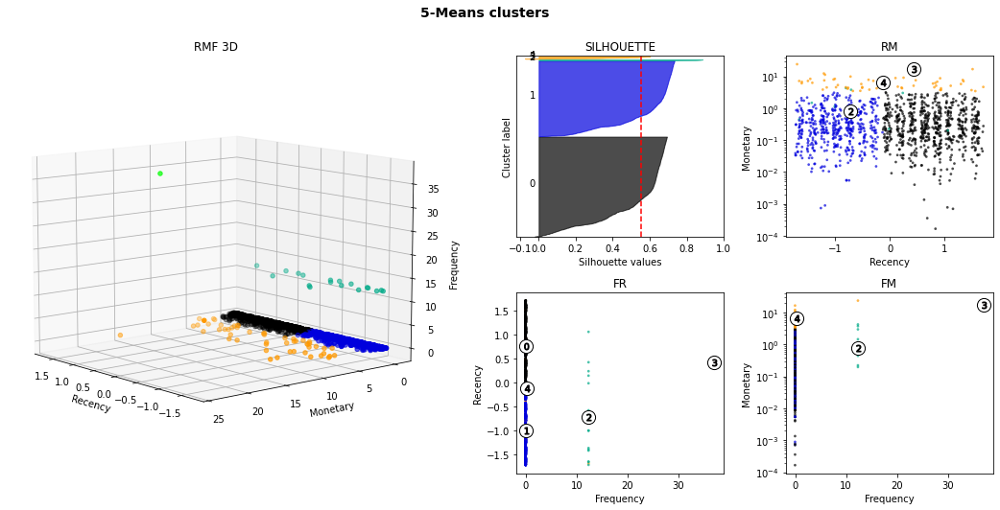

silhouette average : 0.553
k-means fit time : 1.373
silouhette compute time : 1.325


,R,F,M
customer_id,,,
00172711b30d52eea8b313a7f2cced02,-0.667879,-0.063724,-0.164754
002471155ecd08d208d1376720e2a907,0.369222,-0.063724,-0.279660
00391594070baf8603f5fdc1d0c6a48c,1.057115,-0.063724,-0.175326
003a7a8eb096ed3cbf713d2def1ca701,-0.946323,-0.063724,-0.028703
003ae409f37c3c30cb1c974af3a42692,-1.149008,-0.063724,0.197573
...,...,...,...
ffb3cbd5e1e507679e2db84c515410a5,-1.232895,-0.063724,-0.208733
ffb572185af25751289ac38f38c7e2f9,1.124214,-0.063724,-0.134768
ffe204b1bb8026741b839085b2fd10f2,0.193476,-0.063724,-0.031625


SLICE 38 :
start date: 2018-08-18 00:00:00
end date: 2018-09-02 00:00:00
# customers: 95415
# orders: 98690


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=7.
  warnings.warn(


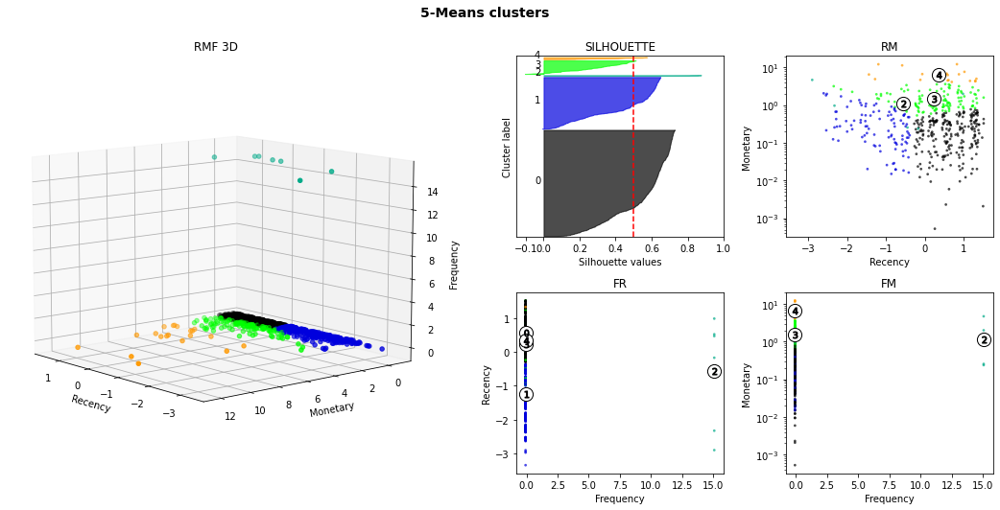

silhouette average : 0.5
k-means fit time : 1.816
silouhette compute time : 0.192


,R,F,M
customer_id,,,
000ec5bff359e1c0ad76a81a45cb598f,0.282524,-0.066372,-0.622394
001928b561575b2821c92254a2327d06,-0.929293,-0.066372,0.140518
0057f64bff87f4698b4cbd338d62a2a8,0.294096,-0.066372,-0.315637
008b06aba4b5f5b5b94f525ccf520624,-0.062206,-0.066372,-0.273111
00a33236962b4ac37fd25275be9c206b,0.907572,-0.066372,-0.126495
...,...,...,...
ff22e30958c13ffe219db7d711e8f564,-0.866340,-0.066372,0.149703
ff2959dedacc441cc5ffe7d747a1a299,1.332668,-0.066372,5.030540
ff36be26206fffe1eb37afd54c70e18b,-0.445100,15.066519,0.255796


In [13]:
earliest_relevant_date = get_earliest_relevant_date()  # datetime(2017, 1, 25)
latest_relevant_date = get_latest_relevant_date()  # datetime(2018, 8, 21)
machin(
    step_in_days = 15,
    from_date=earliest_relevant_date,
    to_date=latest_relevant_date,
    normalize=True,
    cumul=True
)

# Notations

A little notation to represent what we propose to do to identify the optimal model update period in the context of a maintenance contract.

Given the time period $T$, which is established between two dates, we slice this period into $n$ equal time intervals of duration $dT$ called the step (of time).

NB - In practice, $T$, which is counted in number of days, is not necessarily a multiple of $n$ or $dT$ depending on which of these two related parameters you choose to specify (you will prefer to fix $dT$, which is the parameter whose optimal value you aim to determine). So you will adjust $T$ by extending its end date by a few days, to obtain an integer ratio $n = T / dT$.

We associate an index $i, i \in [0, n-1]$ with each successive slice, following their temporal order, and we note $T_i$ the $i$-th slice.

We note $t_i$ the start date of the period $T_i$, and $t_{i+1}$ its end date.

We note $dF_i$ the samples of the customer file whose orders were placed between $t_i$ and $t_{i+1}$.

We note $F_i$ the samples of the customer file whose orders were placed between $t_0$ and $t_{i+1}$, and we note using addition the union of several samples ($F_i = \sum{dF_i}$).

We note $dM_i$ the model trained with the file $dFi$ and $M_i$ the model trained with $F_i$.

We note $d^2C_i$ the set of clusters predicted by the model $dM_i$ on the file $dF_i$, $dC_i$ that predicted by $M_i$ on $dF_i$, and $C_i$ that predicted by $M_i$ on $F_i$.

Regarding predictions on data that was not used for training, we start by setting an integer parameter $p$ that represents a number of intervals $dT$. We note $C_{i, 0} = C_i$ the set of clusters predicted by the model $M_i$ on the file $F_i$, and $C_{i, j}$ the set of clusters predicted by $M_i$ on the file $F_{i+j}$, and $dC_{i, j}$ the set of clusters predicted by $M_i$ on the samples $dF_{i+1}+ \cdots + dF_{j}$.

# Obsolescence measurement based on ARI

## Models and predictions recording

We start with silent training with recording of trained clusterers $M_i$ and their `clu_labels` $C_i$.

Note - $k$ is set to 4, which is its optimal value.

In [28]:
from datetime import datetime
from olist_commons import (
    get_time_slices_dict,
    get_customer_RFM,
    kmeans_analysis_v2
)

def truc(from_date, to_date, step_in_days, k=4, normalize=False, cumul=False):
    # Time, orders and customers indexes slicing
    slices_dict = get_time_slices_dict(from_date, to_date, step_in_days, cumul)
    #sizes = [time_slice['# orders'] for time_slice in slices_dict.values()]
    #display(sizes)
    print('# slices:', len(slices_dict))
    for i, (end_date, time_slice) in enumerate(slices_dict.items()):
        print(f'SLICE {i} :')
        start_date = from_date
        if not cumul:
            start_date = slice['start_date']
        customers_index = time_slice['customers_index']
        orders_index = time_slice['orders_index']
        n_customers = time_slice['# customers']
        n_orders = time_slice['# orders']
        print('start date:', start_date)
        print('end date:', end_date)
        print('# customers:', n_customers)
        print('# orders:', n_orders)
        crfm = None
        if n_customers * n_orders > 0:
            crfm = get_customer_RFM(
                relative_to_date=end_date,
                customers_index=customers_index,
                orders_index=orders_index,
                from_date=start_date,
                to_date=end_date
            )
            #display(crfm.info())
            #display(crfm)
            #print('k:', k, 'normalize:', normalize)
            (
                kmeans, clu_labels, clu_centers, slh_avg, km_t, slh_t
            ) = kmeans_analysis_v2(crfm, k=k, normalize=normalize)
            time_slice['clusterer'] = kmeans
            time_slice['clu_labels'] = clu_labels
            time_slice['clu_centers'] = clu_centers
            time_slice['slh_avg'] = slh_avg
            time_slice['fit time'] = km_t
            time_slice['slh time'] = slh_t
            # stats sur les clusters => d'abord un parcours de ce qu'on a déjà   
        #display(crfm)
    return slices_dict

# slices: 39
SLICE 0 :
start date: 2017-01-25 00:00:00
end date: 2017-02-09 00:00:00
# customers: 1014
# orders: 1034


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


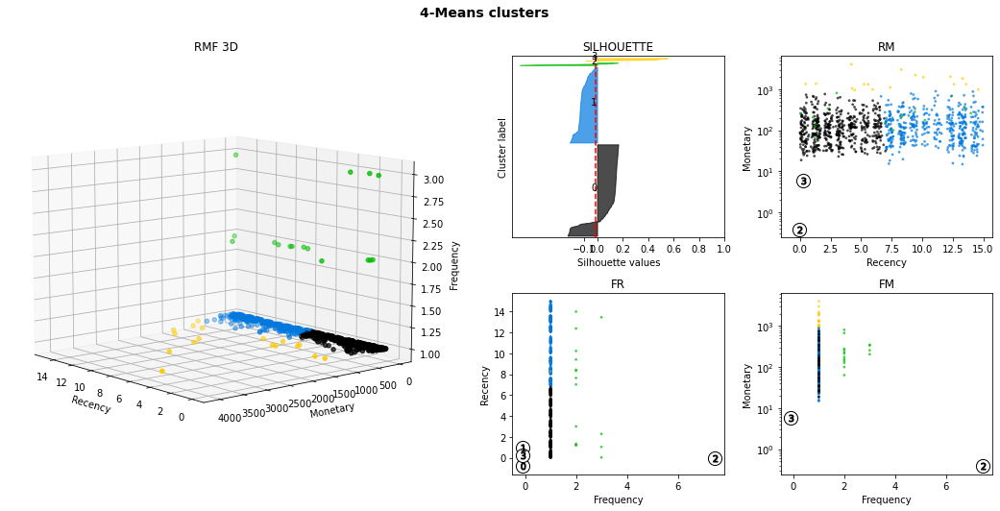

silhouette average : -0.008
k-means fit time : 1.283
silouhette compute time : 0.074
SLICE 1 :
start date: 2017-01-25 00:00:00
end date: 2017-02-24 00:00:00
# customers: 1893
# orders: 1927


c:\Users\franc\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1334: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


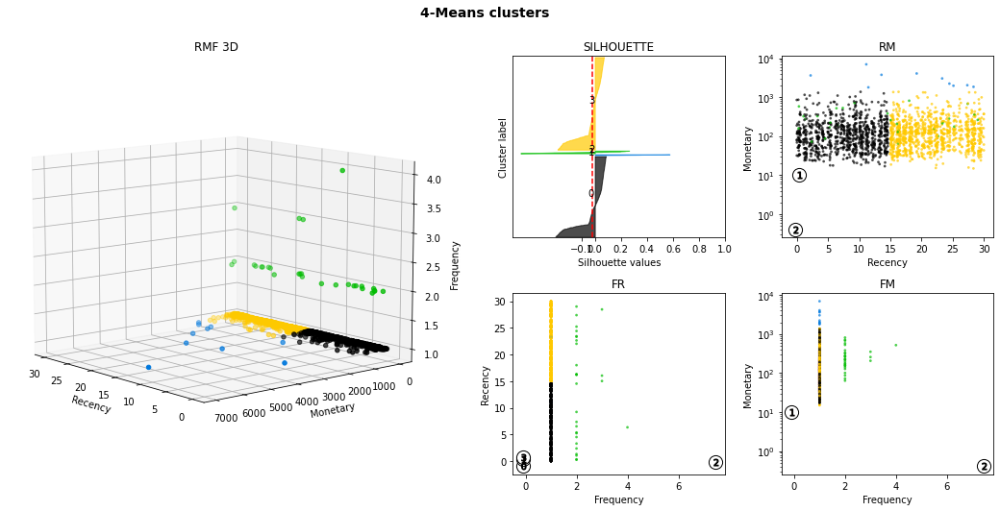

silhouette average : -0.016
k-means fit time : 1.106
silouhette compute time : 0.185
SLICE 2 :
start date: 2017-01-25 00:00:00
end date: 2017-03-11 00:00:00
# customers: 2969
# orders: 3024


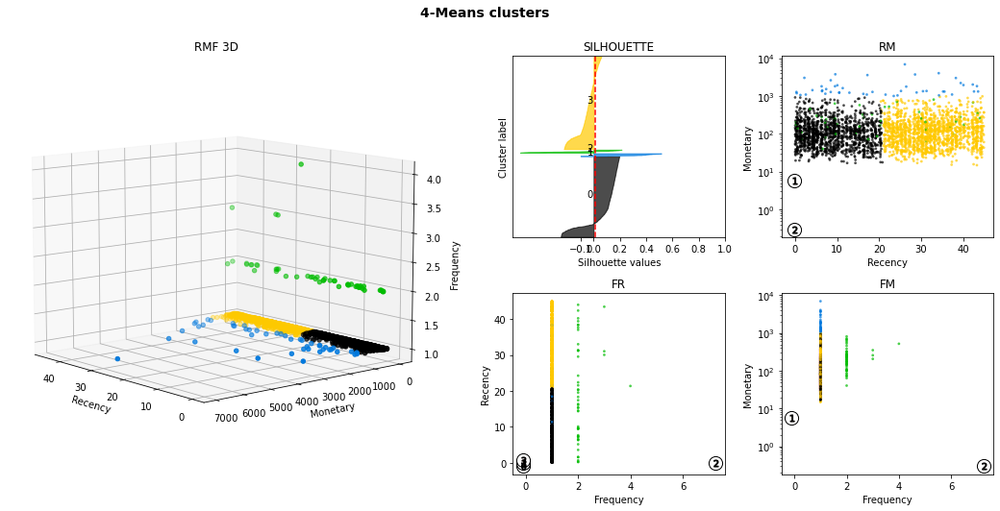

silhouette average : 0.014
k-means fit time : 1.16
silouhette compute time : 0.535
SLICE 3 :
start date: 2017-01-25 00:00:00
end date: 2017-03-26 00:00:00
# customers: 4288
# orders: 4364


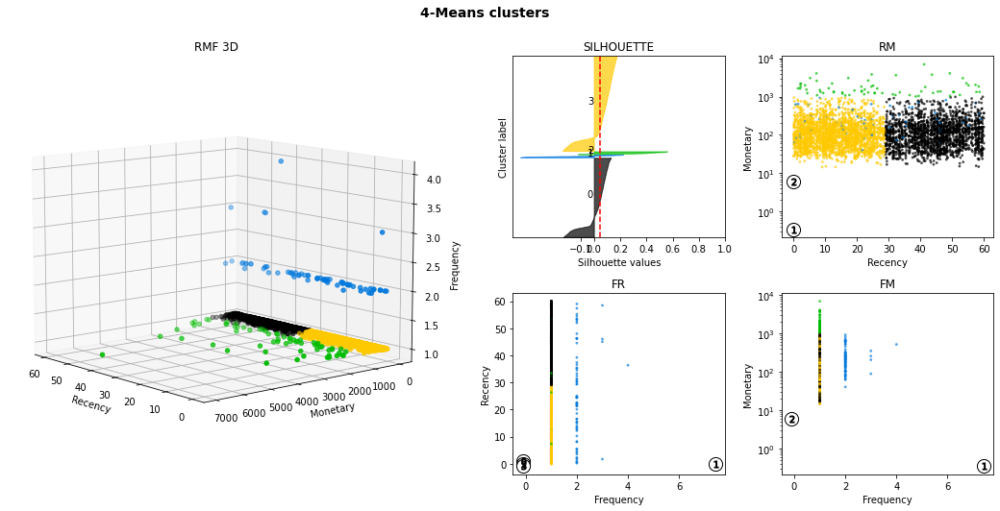

silhouette average : 0.047
k-means fit time : 1.109
silouhette compute time : 1.0
SLICE 4 :
start date: 2017-01-25 00:00:00
end date: 2017-04-10 00:00:00
# customers: 5474
# orders: 5579


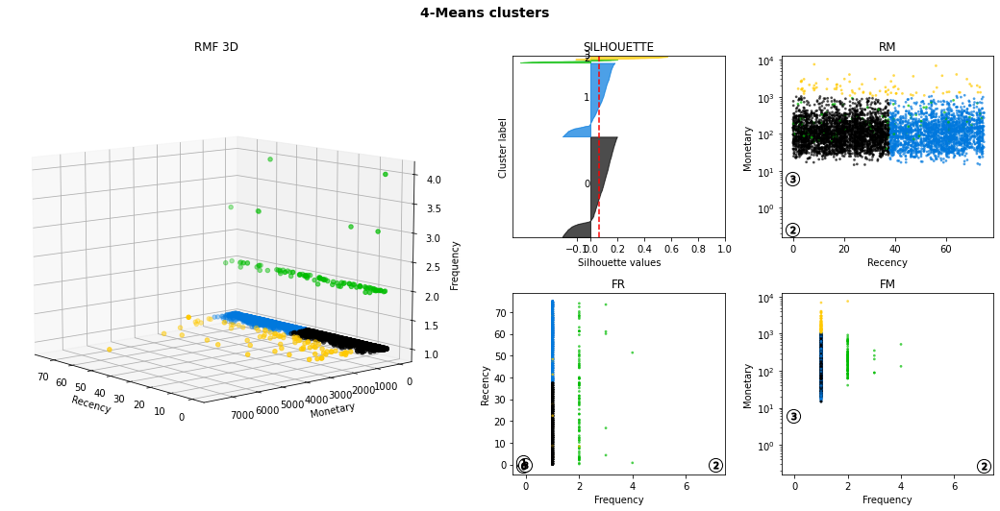

silhouette average : 0.063
k-means fit time : 1.095
silouhette compute time : 1.451
SLICE 5 :
start date: 2017-01-25 00:00:00
end date: 2017-04-25 00:00:00
# customers: 6583
# orders: 6708


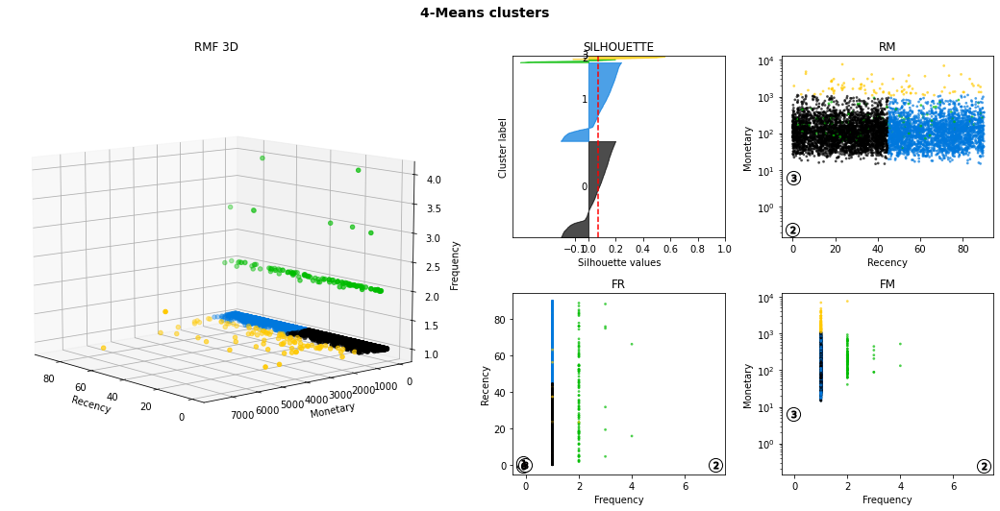

silhouette average : 0.067
k-means fit time : 1.122
silouhette compute time : 1.964
SLICE 6 :
start date: 2017-01-25 00:00:00
end date: 2017-05-10 00:00:00
# customers: 8144
# orders: 8304


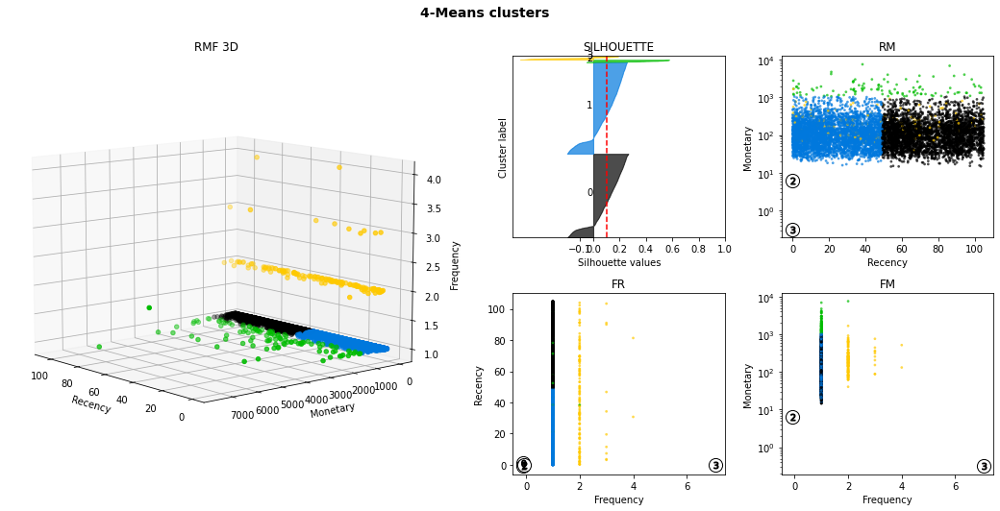

silhouette average : 0.1
k-means fit time : 1.166
silouhette compute time : 2.842
SLICE 7 :
start date: 2017-01-25 00:00:00
end date: 2017-05-25 00:00:00
# customers: 9985
# orders: 10201


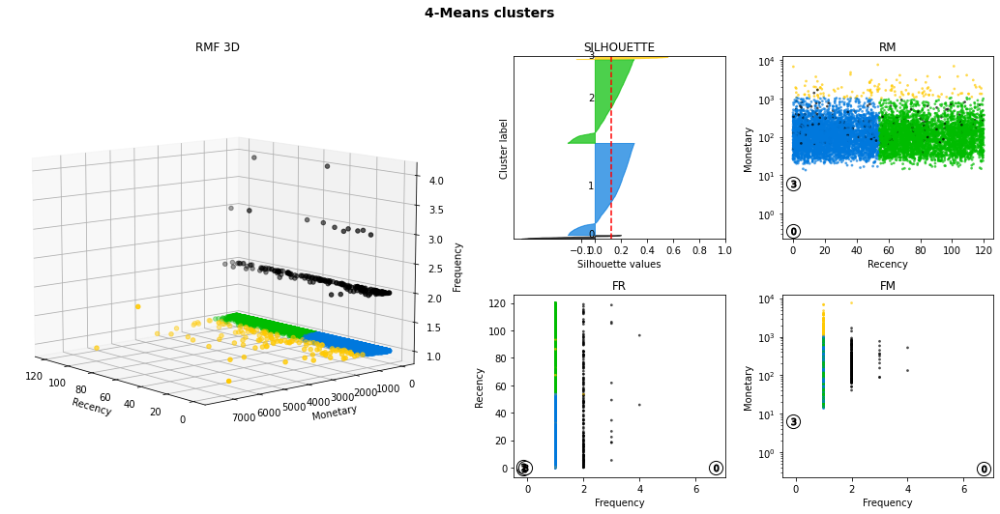

silhouette average : 0.129
k-means fit time : 1.207
silouhette compute time : 4.05
SLICE 8 :
start date: 2017-01-25 00:00:00
end date: 2017-06-09 00:00:00
# customers: 11687
# orders: 11953


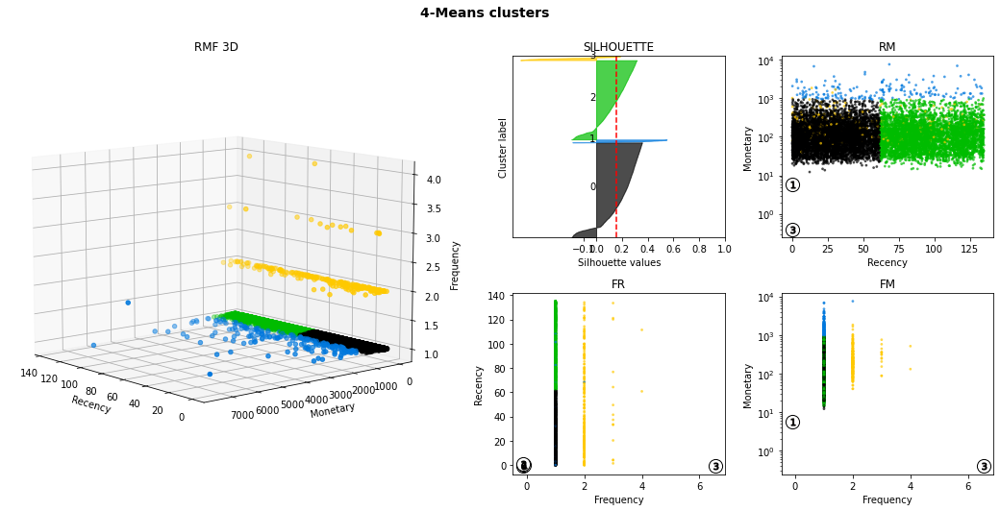

silhouette average : 0.159
k-means fit time : 1.204
silouhette compute time : 3.759
SLICE 9 :
start date: 2017-01-25 00:00:00
end date: 2017-06-24 00:00:00
# customers: 13167
# orders: 13486


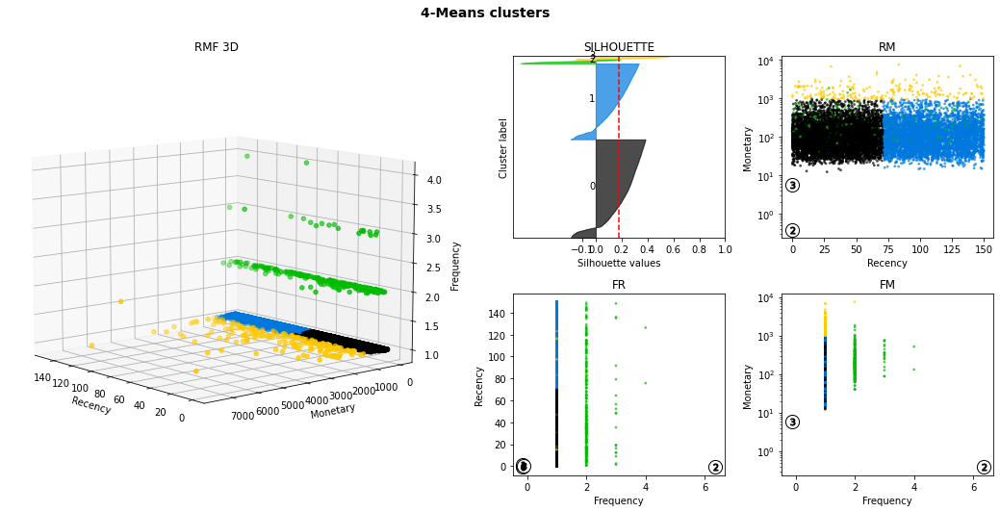

silhouette average : 0.176
k-means fit time : 1.378
silouhette compute time : 4.641
SLICE 10 :
start date: 2017-01-25 00:00:00
end date: 2017-07-09 00:00:00
# customers: 14780
# orders: 15144


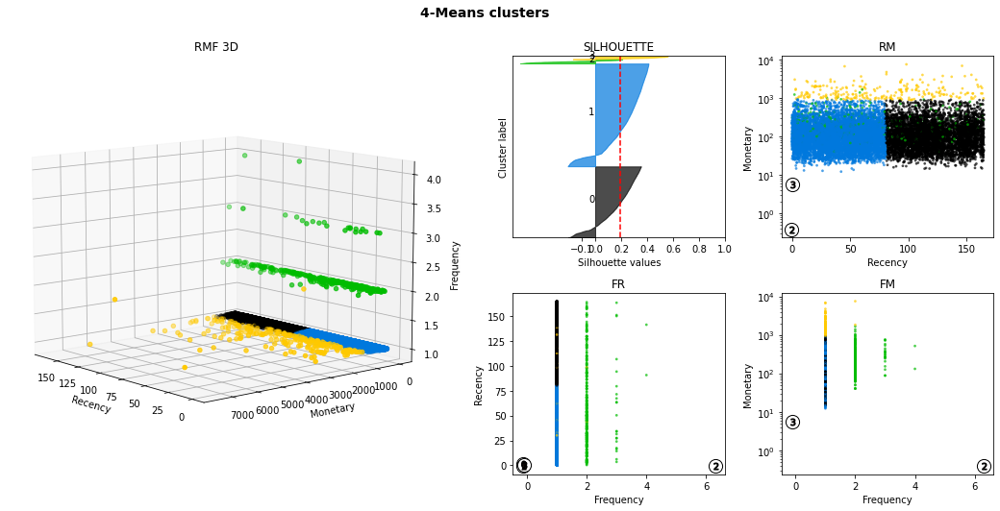

silhouette average : 0.191
k-means fit time : 1.452
silouhette compute time : 5.51
SLICE 11 :
start date: 2017-01-25 00:00:00
end date: 2017-07-24 00:00:00
# customers: 16733
# orders: 17160


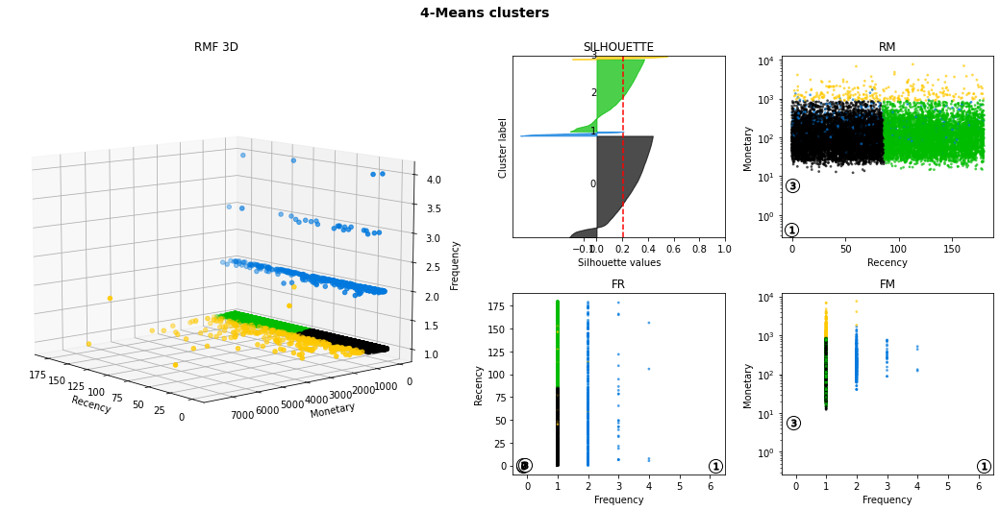

silhouette average : 0.206
k-means fit time : 1.463
silouhette compute time : 7.053
SLICE 12 :
start date: 2017-01-25 00:00:00
end date: 2017-08-08 00:00:00
# customers: 18733
# orders: 19228


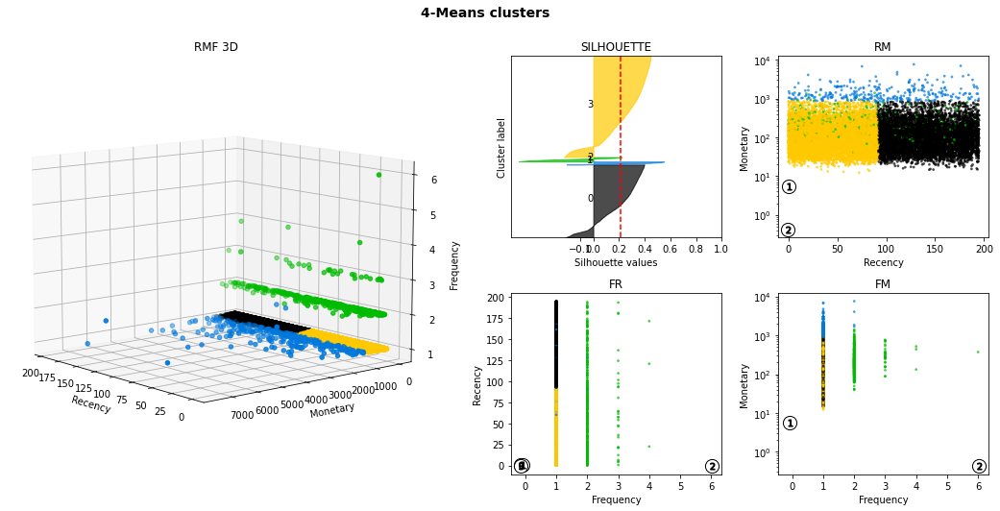

silhouette average : 0.215
k-means fit time : 1.653
silouhette compute time : 8.831
SLICE 13 :
start date: 2017-01-25 00:00:00
end date: 2017-08-23 00:00:00
# customers: 20805
# orders: 21369


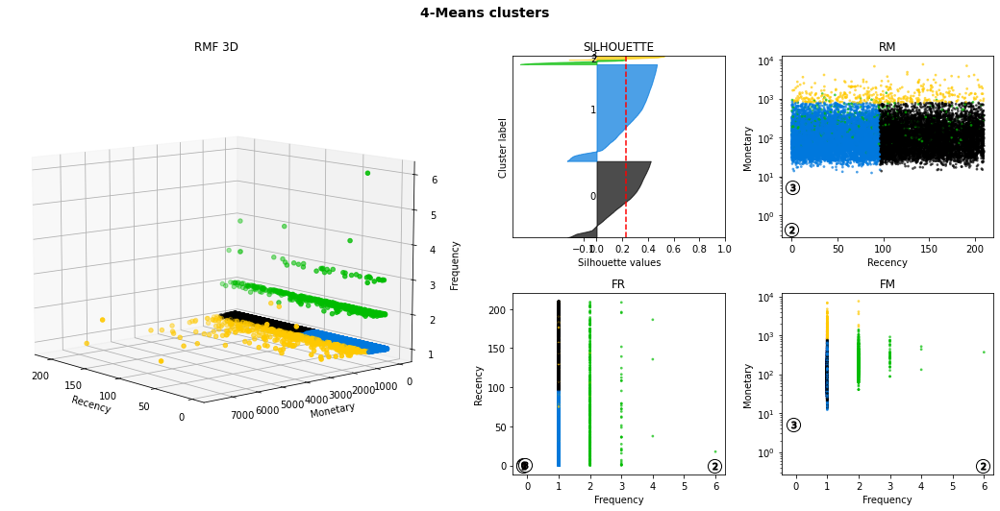

silhouette average : 0.229
k-means fit time : 1.487
silouhette compute time : 10.853
SLICE 14 :
start date: 2017-01-25 00:00:00
end date: 2017-09-07 00:00:00
# customers: 22759
# orders: 23400


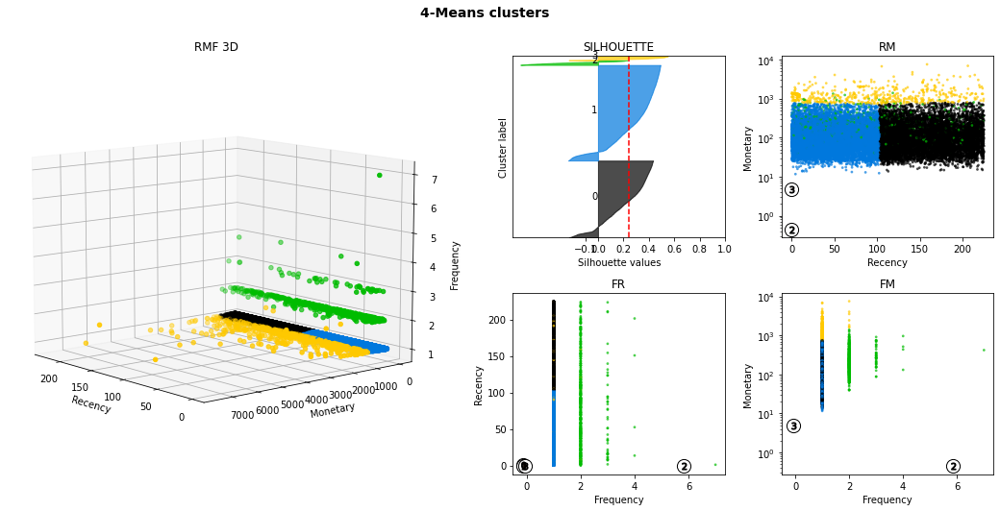

silhouette average : 0.246
k-means fit time : 1.324
silouhette compute time : 12.961
SLICE 15 :
start date: 2017-01-25 00:00:00
end date: 2017-09-22 00:00:00
# customers: 24947
# orders: 25671


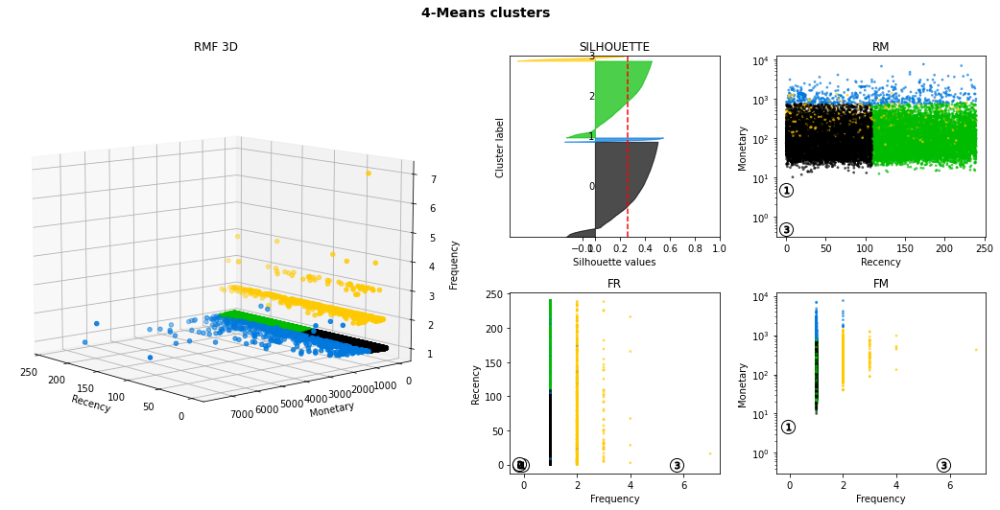

silhouette average : 0.26
k-means fit time : 1.281
silouhette compute time : 17.063
SLICE 16 :
start date: 2017-01-25 00:00:00
end date: 2017-10-07 00:00:00
# customers: 26945
# orders: 27747


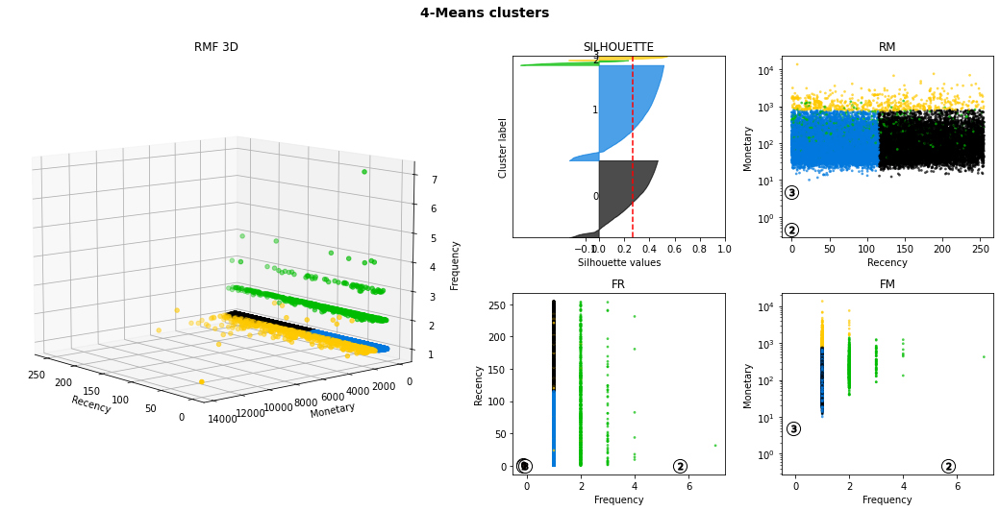

silhouette average : 0.27
k-means fit time : 1.331
silouhette compute time : 20.092
SLICE 17 :
start date: 2017-01-25 00:00:00
end date: 2017-10-22 00:00:00
# customers: 29156
# orders: 30037


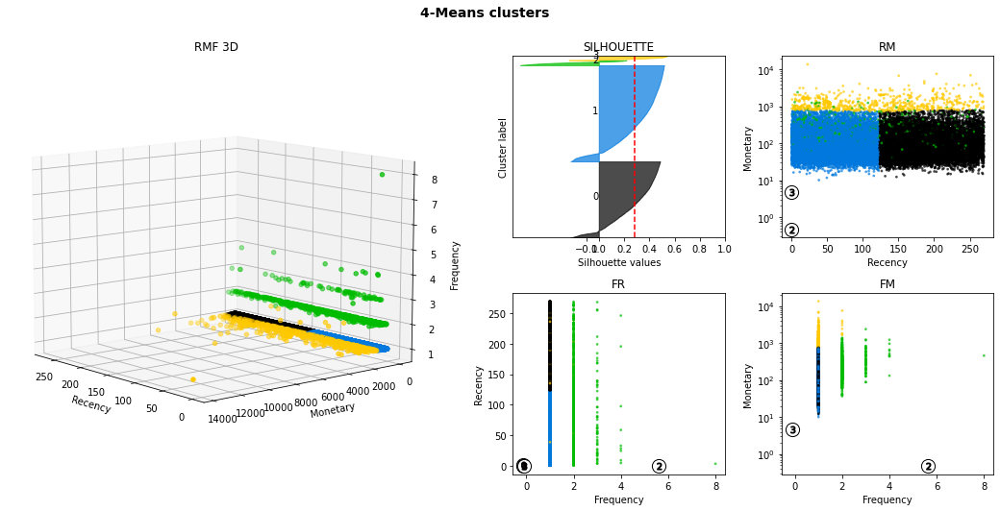

silhouette average : 0.28
k-means fit time : 1.352
silouhette compute time : 23.677
SLICE 18 :
start date: 2017-01-25 00:00:00
end date: 2017-11-06 00:00:00
# customers: 31157
# orders: 32115


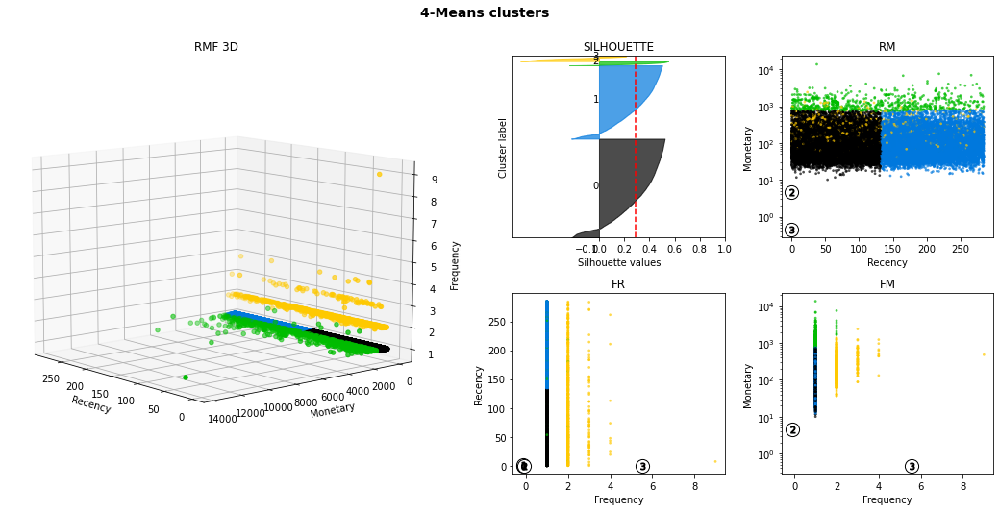

silhouette average : 0.287
k-means fit time : 1.402
silouhette compute time : 26.698
SLICE 19 :
start date: 2017-01-25 00:00:00
end date: 2017-11-21 00:00:00
# customers: 33838
# orders: 34875


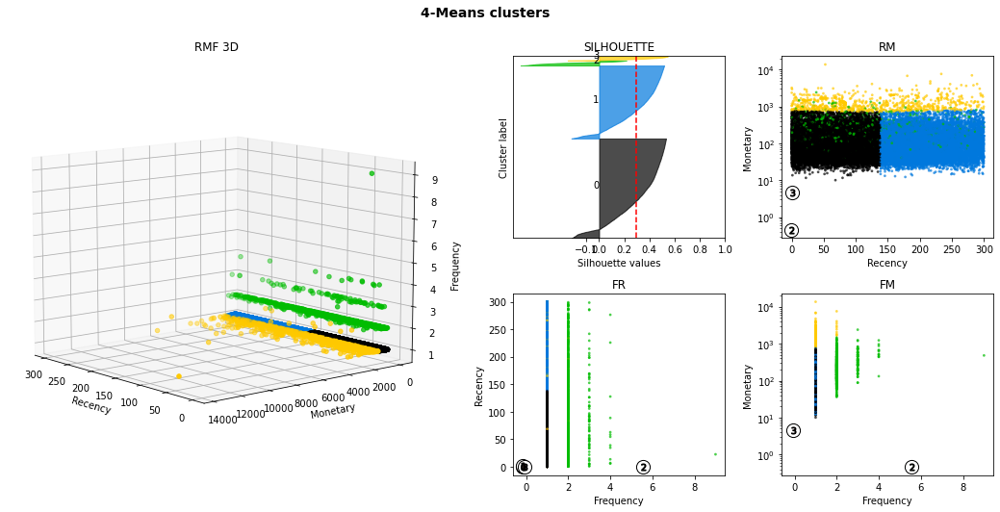

silhouette average : 0.295
k-means fit time : 1.433
silouhette compute time : 31.825
SLICE 20 :
start date: 2017-01-25 00:00:00
end date: 2017-12-06 00:00:00
# customers: 39146
# orders: 40370


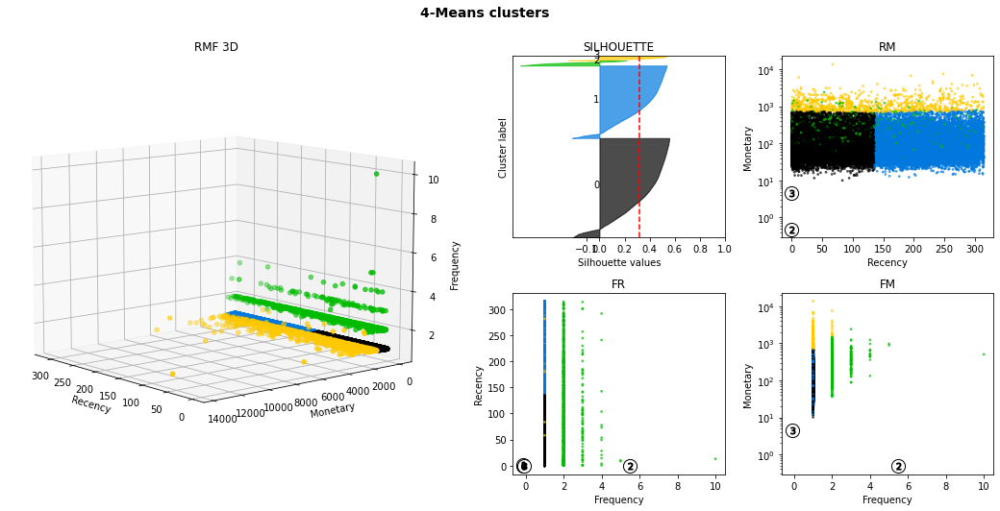

silhouette average : 0.315
k-means fit time : 1.564
silouhette compute time : 43.103
SLICE 21 :
start date: 2017-01-25 00:00:00
end date: 2017-12-21 00:00:00
# customers: 42079
# orders: 43400


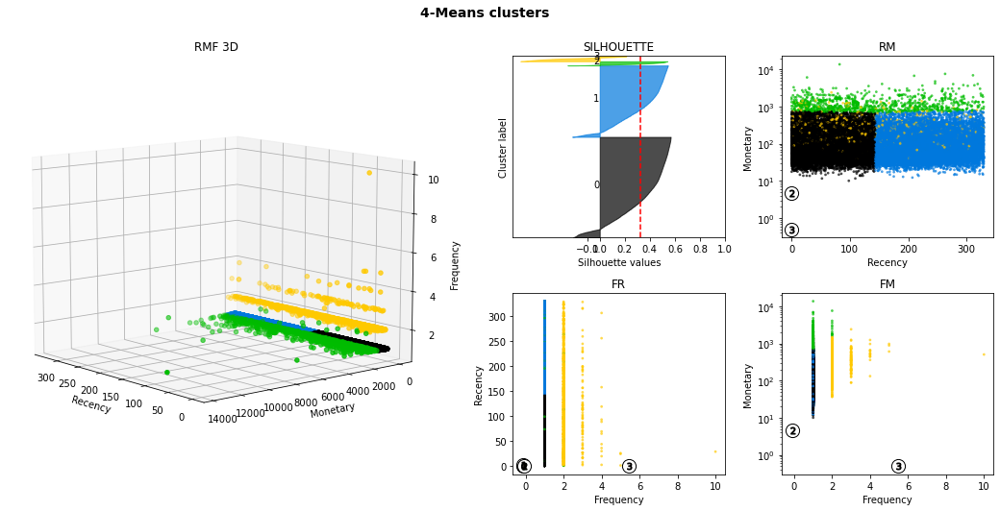

silhouette average : 0.324
k-means fit time : 1.57
silouhette compute time : 51.865
SLICE 22 :
start date: 2017-01-25 00:00:00
end date: 2018-01-05 00:00:00
# customers: 44086
# orders: 45460


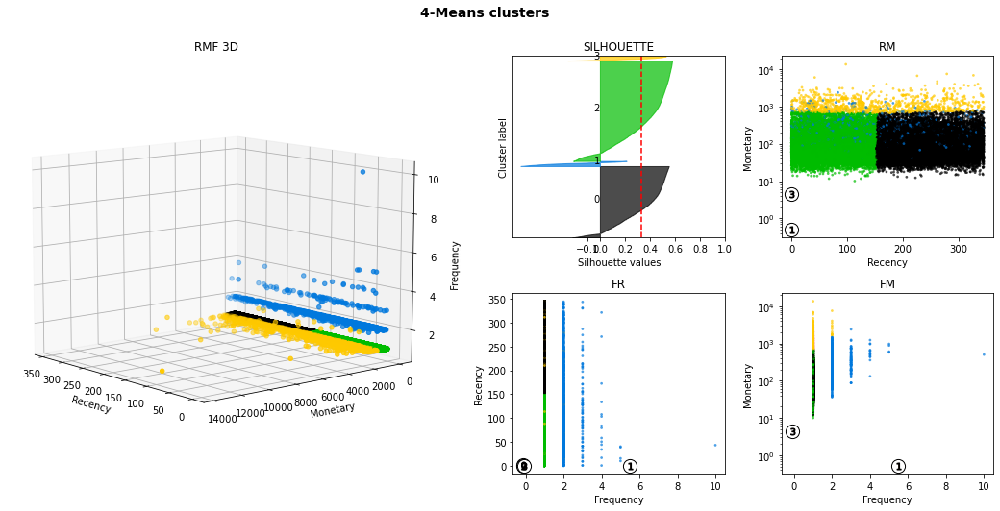

silhouette average : 0.333
k-means fit time : 1.761
silouhette compute time : 56.964
SLICE 23 :
start date: 2017-01-25 00:00:00
end date: 2018-01-20 00:00:00
# customers: 47735
# orders: 49234


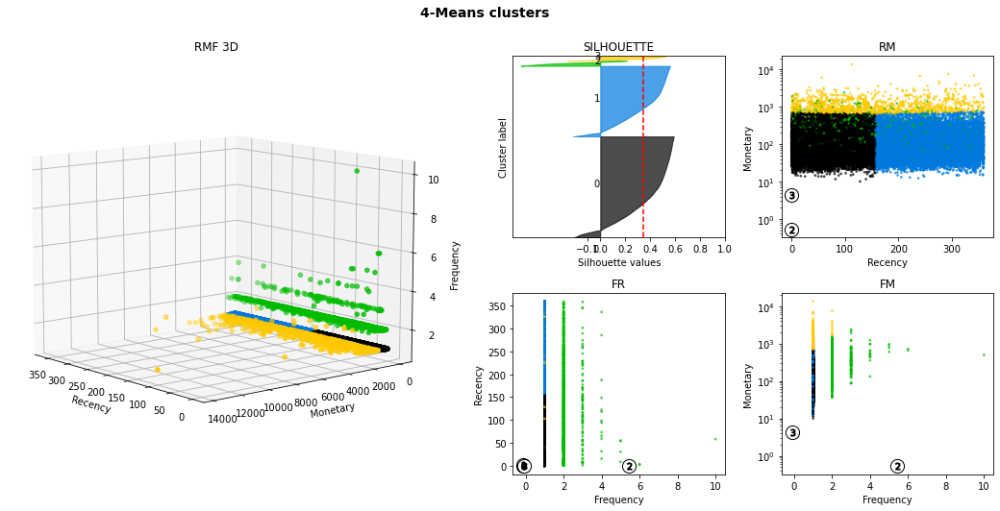

silhouette average : 0.344
k-means fit time : 1.651
silouhette compute time : 65.291
SLICE 24 :
start date: 2017-01-25 00:00:00
end date: 2018-02-04 00:00:00
# customers: 50988
# orders: 52605


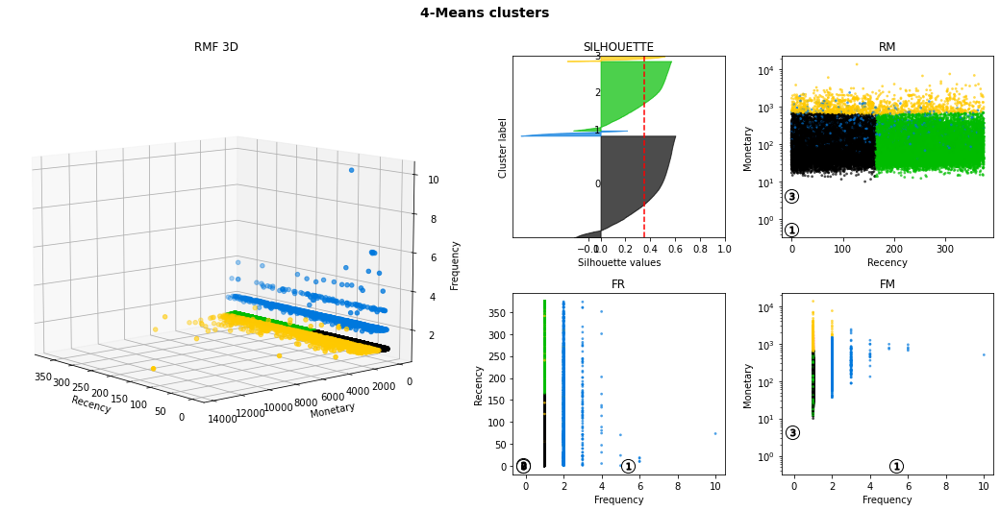

silhouette average : 0.353
k-means fit time : 1.786
silouhette compute time : 78.167
SLICE 25 :
start date: 2017-01-25 00:00:00
end date: 2018-02-19 00:00:00
# customers: 54274
# orders: 56030


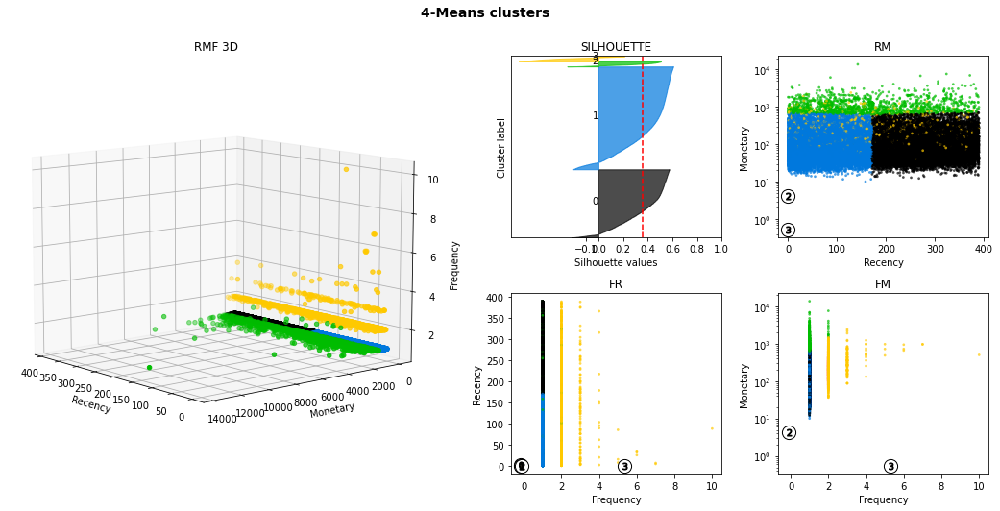

silhouette average : 0.359
k-means fit time : 1.822
silouhette compute time : 91.152
SLICE 26 :
start date: 2017-01-25 00:00:00
end date: 2018-03-06 00:00:00
# customers: 58031
# orders: 59953


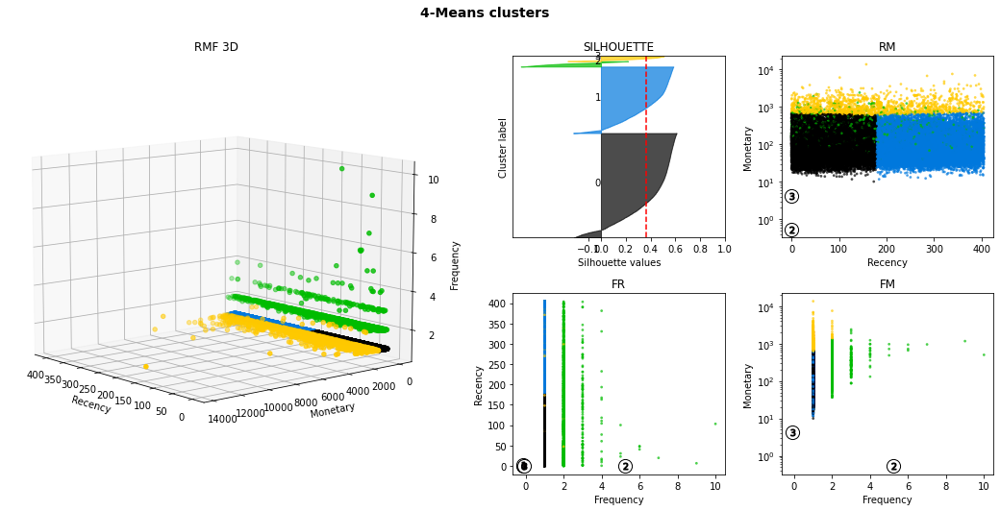

silhouette average : 0.362
k-means fit time : 2.165
silouhette compute time : 108.26
SLICE 27 :
start date: 2017-01-25 00:00:00
end date: 2018-03-21 00:00:00
# customers: 61491
# orders: 63527


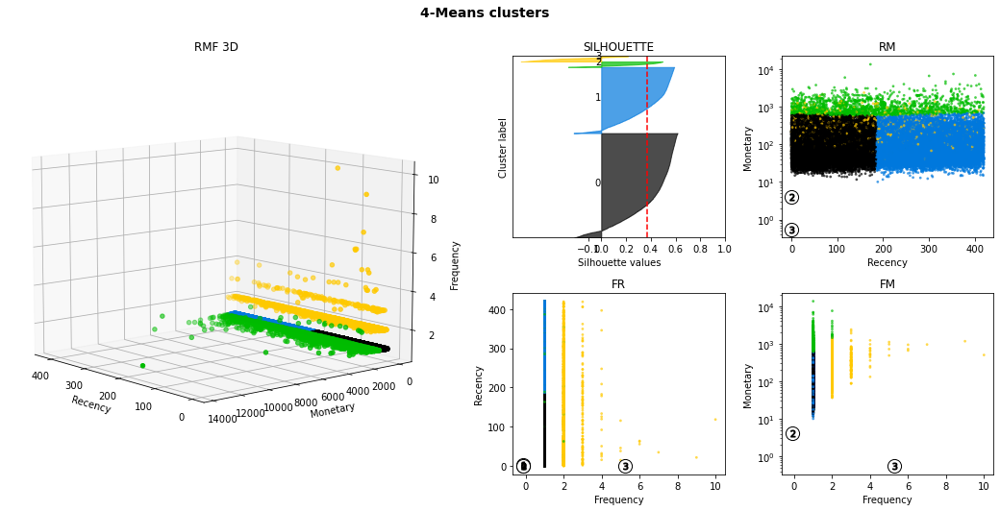

silhouette average : 0.368
k-means fit time : 1.859
silouhette compute time : 113.438
SLICE 28 :
start date: 2017-01-25 00:00:00
end date: 2018-04-05 00:00:00
# customers: 64762
# orders: 66900


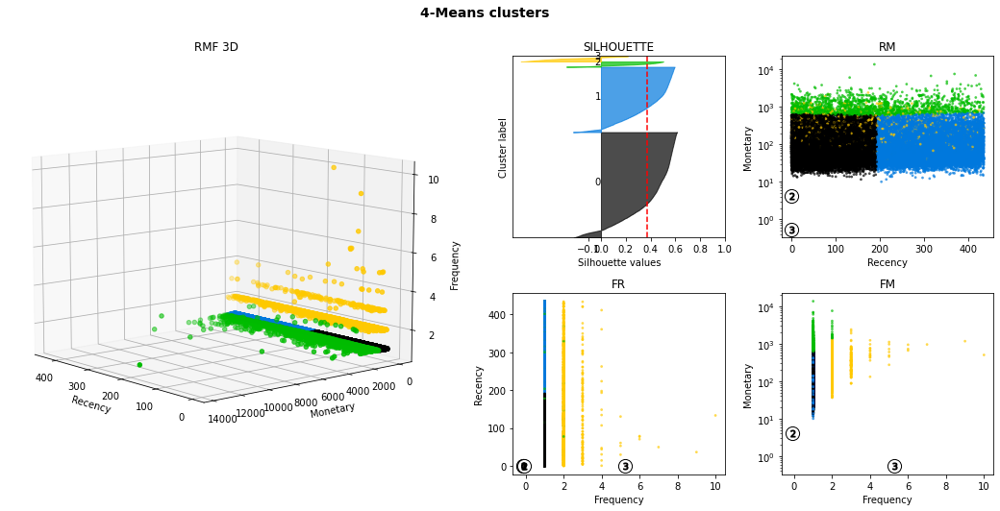

silhouette average : 0.369
k-means fit time : 2.063
silouhette compute time : 126.267
SLICE 29 :
start date: 2017-01-25 00:00:00
end date: 2018-04-20 00:00:00
# customers: 68113
# orders: 70377


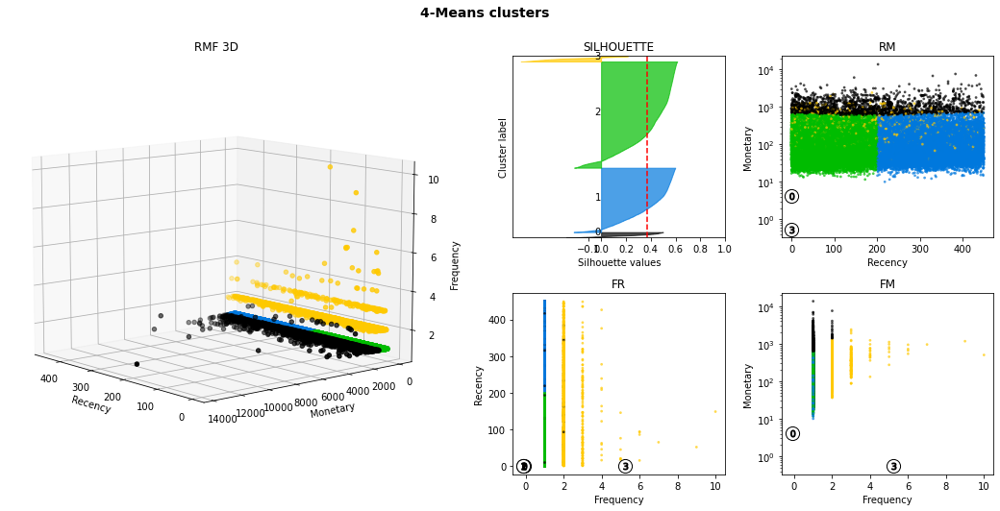

silhouette average : 0.371
k-means fit time : 2.004
silouhette compute time : 139.316
SLICE 30 :
start date: 2017-01-25 00:00:00
end date: 2018-05-05 00:00:00
# customers: 71589
# orders: 73968


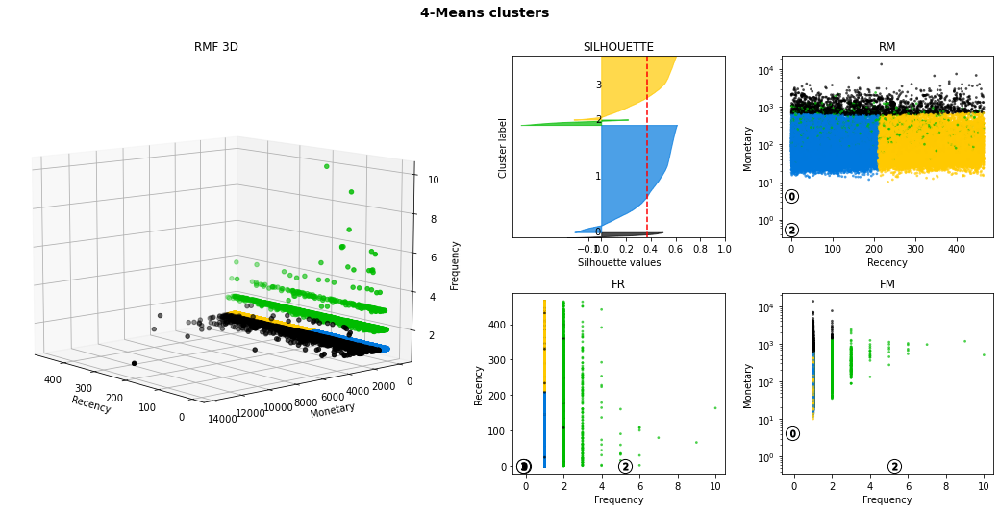

silhouette average : 0.373
k-means fit time : 1.893
silouhette compute time : 150.152
SLICE 31 :
start date: 2017-01-25 00:00:00
end date: 2018-05-20 00:00:00
# customers: 75523
# orders: 78039


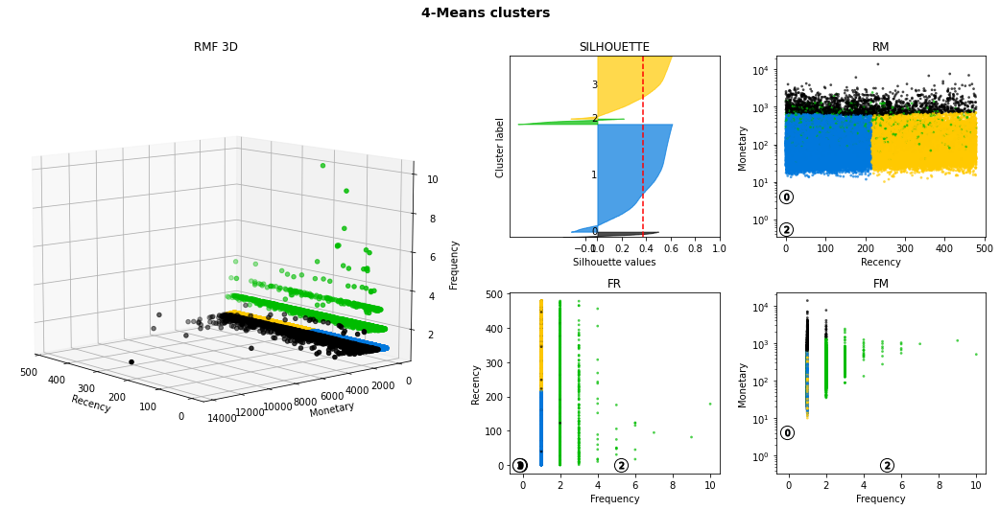

silhouette average : 0.375
k-means fit time : 1.978
silouhette compute time : 166.46
SLICE 32 :
start date: 2017-01-25 00:00:00
end date: 2018-06-04 00:00:00
# customers: 77625
# orders: 80237


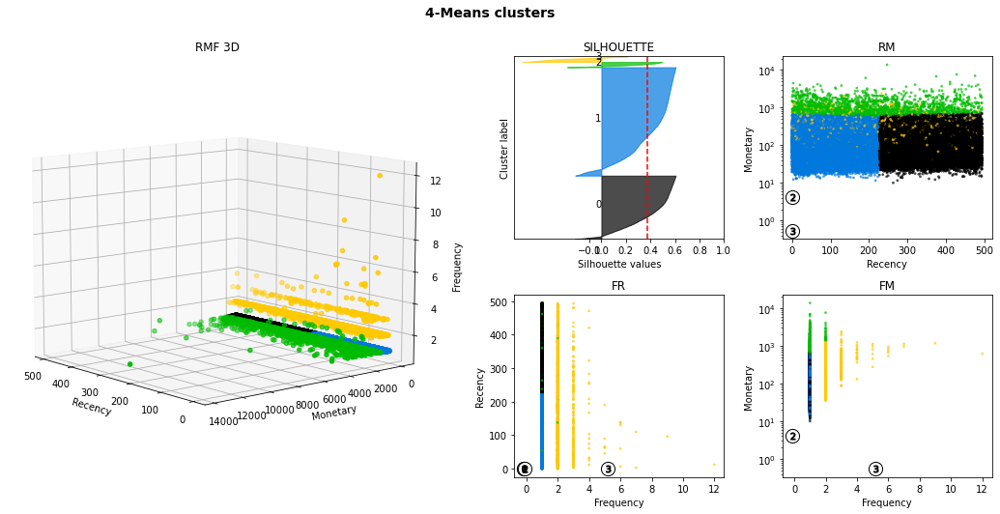

silhouette average : 0.372
k-means fit time : 2.105
silouhette compute time : 170.957
SLICE 33 :
start date: 2017-01-25 00:00:00
end date: 2018-06-19 00:00:00
# customers: 80707
# orders: 83435


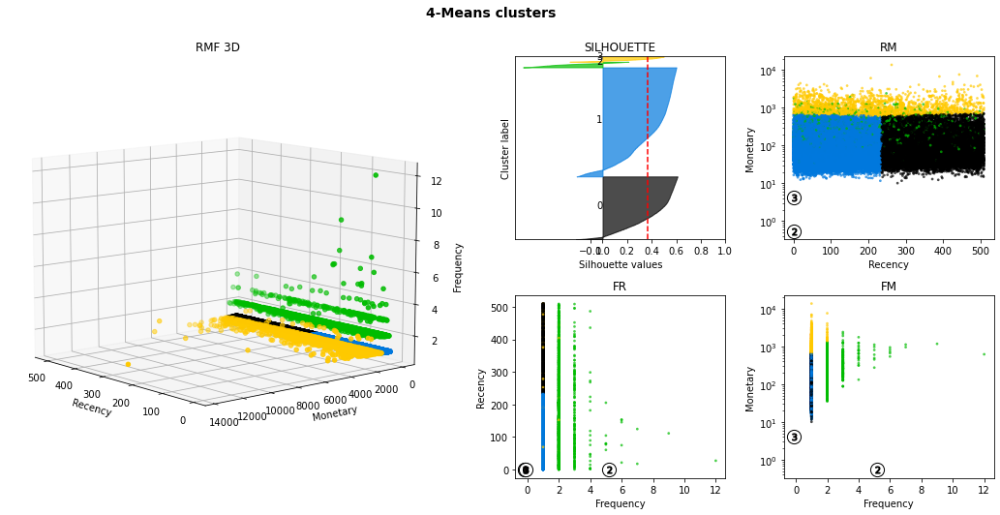

silhouette average : 0.371
k-means fit time : 1.914
silouhette compute time : 188.402
SLICE 34 :
start date: 2017-01-25 00:00:00
end date: 2018-07-04 00:00:00
# customers: 83629
# orders: 86458


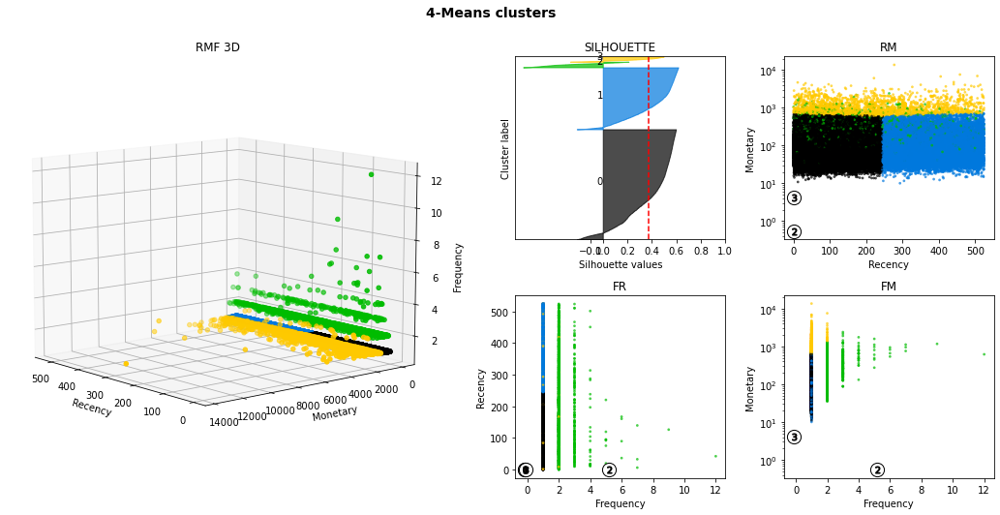

silhouette average : 0.371
k-means fit time : 2.04
silouhette compute time : 198.576
SLICE 35 :
start date: 2017-01-25 00:00:00
end date: 2018-07-19 00:00:00
# customers: 86092
# orders: 89017


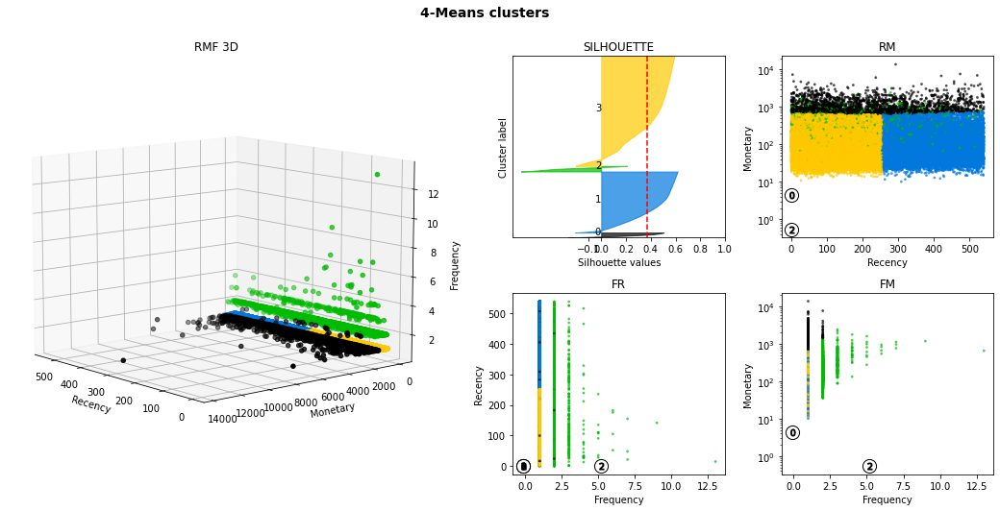

silhouette average : 0.367
k-means fit time : 2.172
silouhette compute time : 210.6
SLICE 36 :
start date: 2017-01-25 00:00:00
end date: 2018-08-03 00:00:00
# customers: 89738
# orders: 92791


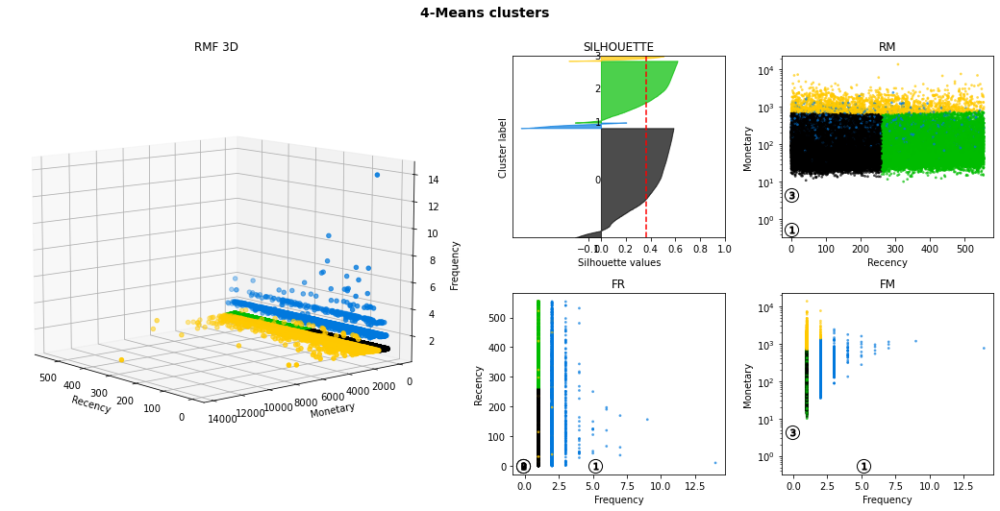

silhouette average : 0.363
k-means fit time : 2.188
silouhette compute time : 233.625
SLICE 37 :
start date: 2017-01-25 00:00:00
end date: 2018-08-18 00:00:00
# customers: 93883
# orders: 97087


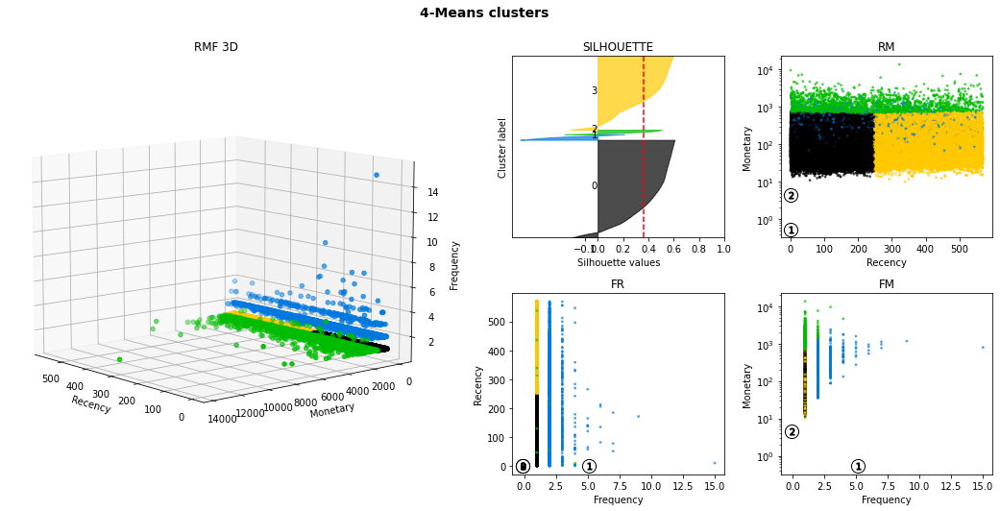

silhouette average : 0.364
k-means fit time : 1.99
silouhette compute time : 251.076
SLICE 38 :
start date: 2017-01-25 00:00:00
end date: 2018-09-02 00:00:00
# customers: 95415
# orders: 98690


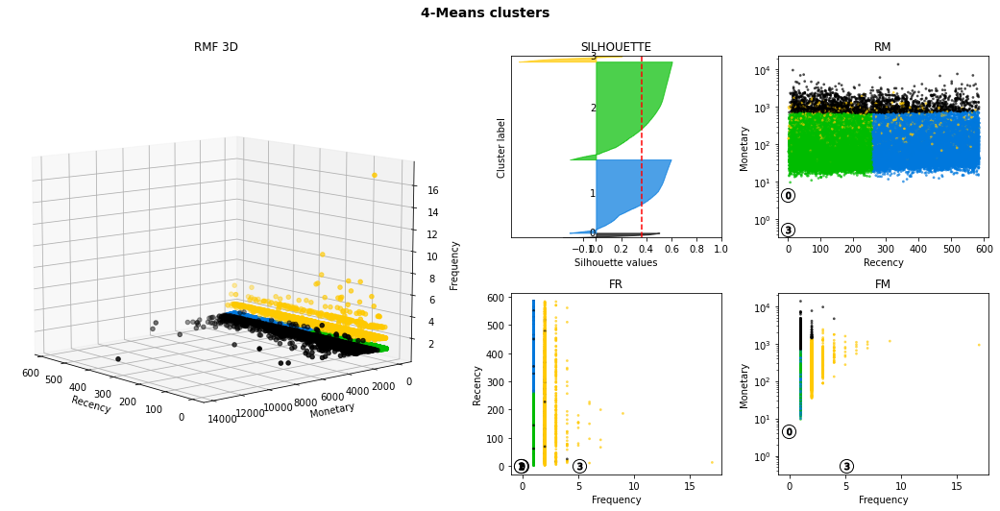

silhouette average : 0.366
k-means fit time : 2.438
silouhette compute time : 268.383


In [29]:
earliest_relevant_date = get_earliest_relevant_date()  # datetime(2017, 1, 25)
latest_relevant_date = get_latest_relevant_date()  # datetime(2018, 8, 21)
slices_dict = truc(
    step_in_days=15,
    from_date=earliest_relevant_date,
    to_date=latest_relevant_date,
    normalize=True,
    cumul=True
)


### Fit and score times table

In [34]:
import pandas as pd
results = pd.DataFrame([
    [
        time_slice['start_date'],
        time_slice['end_date'],
        time_slice['slh_avg'],
        time_slice['fit time'],
        time_slice['slh time']
    ]
    for time_slice in slices_dict.values()
])
results.columns = ['start_date', 'end_date', 'slh_avg', 'fit time', 'slh time']
display(results)

,start_date,end_date,slh_avg,fit time,slh time
0,2017-01-25,2017-02-09,-0.008135,1.283001,0.073999
1,2017-02-09,2017-02-24,-0.016398,1.106002,0.185000
2,2017-02-24,2017-03-11,0.013780,1.159977,0.535000
3,2017-03-11,2017-03-26,0.047465,1.108959,1.000003
4,2017-03-26,2017-04-10,0.062911,1.094963,1.451001
5,2017-04-10,2017-04-25,0.067288,1.121958,1.963999
6,2017-04-25,2017-05-10,0.100219,1.166004,2.842000
7,2017-05-10,2017-05-25,0.129187,1.206964,4.050000
8,2017-05-25,2017-06-09,0.159406,1.203999,3.759001
9,2017-06-09,2017-06-24,0.176198,1.377997,4.640997


## ARI measurement

The parameter $p$ is defined, which indicates the number of models associated with the immediately preceding slices, whose predictions are to be compared with those of the current slice.

In [37]:
x = 0
p = 7
q = [None,] * p
i = 0
while i < 30:
    print(str(i) + ')', q)
    for x in q:
        if x is not None:
            print(x, 'is not None')
    q.pop(0)
    q.append(i)
    i += 1

0) [None, None, None, None, None, None, None]
1) [None, None, None, None, None, None, 0]
0 is not None
2) [None, None, None, None, None, 0, 1]
0 is not None
1 is not None
3) [None, None, None, None, 0, 1, 2]
0 is not None
1 is not None
2 is not None
4) [None, None, None, 0, 1, 2, 3]
0 is not None
1 is not None
2 is not None
3 is not None
5) [None, None, 0, 1, 2, 3, 4]
0 is not None
1 is not None
2 is not None
3 is not None
4 is not None
6) [None, 0, 1, 2, 3, 4, 5]
0 is not None
1 is not None
2 is not None
3 is not None
4 is not None
5 is not None
7) [0, 1, 2, 3, 4, 5, 6]
0 is not None
1 is not None
2 is not None
3 is not None
4 is not None
5 is not None
6 is not None
8) [1, 2, 3, 4, 5, 6, 7]
1 is not None
2 is not None
3 is not None
4 is not None
5 is not None
6 is not None
7 is not None
9) [2, 3, 4, 5, 6, 7, 8]
2 is not None
3 is not None
4 is not None
5 is not None
6 is not None
7 is not None
8 is not None
10) [3, 4, 5, 6, 7, 8, 9]
3 is not None
4 is not None
5 is not None
6 is not N

In [62]:
from sklearn.preprocessing import StandardScaler
from sklearn import metrics

def bidule(slices_dict, p=5, normalize=False, verbose=False):
    from_date = list(slices_dict.values())[0]['start_date']
    previous_models = [None, ] * p

    print('# slices:', len(slices_dict))
    for i, (end_date, time_slice) in enumerate(slices_dict.items()):
        if verbose:
            print(f'SLICE {i} :')
        start_date = time_slice['start_date']
        customers_index = time_slice['customers_index']
        orders_index = time_slice['orders_index']
        n_customers = time_slice['# customers']
        n_orders = time_slice['# orders']
        clusterer = time_slice['clusterer']
        clu_labels = time_slice['clu_labels']
        if verbose:
            print('from date:', from_date)
            print('start date:', start_date)
            print('end date:', end_date)
            print('# customers:', n_customers)
            print('# orders:', n_orders)

        crfm = None
        predictions = time_slice['predictions'] = []
        if n_customers * n_orders > 0:
            crfm = get_customer_RFM(
                relative_to_date=end_date,
                customers_index=customers_index,
                orders_index=orders_index,
                from_date=from_date,
                to_date=end_date
            )
            # Normalize the data
            if normalize:
                crfm = pd.DataFrame(
                    StandardScaler().fit_transform(crfm),
                    index=crfm.index,
                    columns=crfm.columns
                )
            q = p
            for model in previous_models:
                if verbose:
                    print('Model', q, 'steps updstream')
                    display(model)
                q -= 1
                if model is None:
                    predictions.append(None)
                else:
                    pred_details = {}
                    predictions.append(pred_details)
                    model_clu_labels = model.predict(crfm)
                    pred_details['clu_labels'] = model_clu_labels
                    RI = pred_details['RI'] = metrics.rand_score(
                        clu_labels,
                        model_clu_labels
                    )
                    if verbose:
                        print('RI:', RI)
                    ARI = pred_details['ARI'] = metrics.adjusted_rand_score(
                        clu_labels,
                        model_clu_labels
                    )
                    if verbose:
                        print('ARI:', ARI)
            previous_models.pop(0)
            previous_models.append(clusterer)

bidule(slices_dict, p=20, normalize=True)

# slices: 39


### Scores table

In [64]:
import pandas as pd
def unpack_ari(x):
    if x is None or not isinstance(x, dict):
        return None
    return x['ARI']

p = 20

results = pd.DataFrame([
    [
        time_slice['start_date'],
        time_slice['end_date'],
        time_slice['slh_avg'],
        time_slice['fit time'],
        time_slice['slh time'],
        *[unpack_ari(time_slice['predictions'][p-i-1]) for i in range(p)]
    ]
    for time_slice in slices_dict.values()
])
results.columns = pd.MultiIndex.from_tuples([
    ('slice_infos', 'start_date'),
    ('slice_infos', 'end_date'),
    ('slice_infos', 'slh_avg'),
    ('slice_infos', 'fit time'),
    ('slice_infos', 'slh time'),
    *[('predictions ARI', f'-{i+1}') for i in range(p)]
])
display(results)

slice_infos                                            predictions ARI  \
    start_date   end_date   slh_avg  fit time    slh time              -1   
0   2017-01-25 2017-02-09 -0.008135  1.283001    0.073999             NaN   
1   2017-02-09 2017-02-24 -0.016398  1.106002    0.185000        0.809968   
2   2017-02-24 2017-03-11  0.013780  1.159977    0.535000        0.979556   
3   2017-03-11 2017-03-26  0.047465  1.108959    1.000003        0.917574   
4   2017-03-26 2017-04-10  0.062911  1.094963    1.451001        0.951444   
5   2017-04-10 2017-04-25  0.067288  1.121958    1.963999        0.939297   
6   2017-04-25 2017-05-10  0.100219  1.166004    2.842000        0.926742   
7   2017-05-10 2017-05-25  0.129187  1.206964    4.050000        0.996115   
8   2017-05-25 2017-06-09  0.159406  1.203999    3.759001        0.968358   
9   2017-06-09 2017-06-24  0.176198  1.377997    4.640997        0.980034   
10  2017-06-24 2017-07-09  0.190818  1.452002    5.510035        0.952870   
11  2017-07-09 2017-07-24  0.206333  1.462993    7.053039        0.982226   
12  2017-07-24 2017-08-08  0.214691  1.652994    8.831002        0.987439   
13  2017-08-08 2017-08-23  0.229075  1.486956   10.853042        0.939617   
14  2017-08-23 2017-09-07  0.245760  1.323996   12.961004        0.994524   
15  2017-09-07 2017-09-22  0.260058  1.280959   17.063008        0.998035   
16  2017-09-22 2017-10-07  0.270014  1.330969   20.091870        0.998415   
17  2017-10-07 2017-10-22  0.280344  1.351966   23.677365        0.997006   
18  2017-10-22 2017-11-06  0.286968  1.402002   26.698169        0.973571   
19  2017-11-06 2017-11-21  0.295485  1.432960   31.825032        0.996589   
20  2017-11-21 2017-12-06  0.314673  1.563966   43.103014        0.998567   
21  2017-12-06 2017-12-21  0.323563  1.570000   51.864589        0.986240   
22  2017-12-21 2018-01-05  0.332916  1.761001   56.964040        0.996339   
23  2018-01-05 2018-01-20  0.344313  1.651000   65.291243        0.988142   
24  2018-01-20 2018-02-04  0.353265  1.786000   78.166757        0.988638   
25  2018-02-04 2018-02-19  0.359316  1.822001   91.152017        0.985681   
26  2018-02-19 2018-03-06  0.362002  2.165000  108.259753        0.988859   
27  2018-03-06 2018-03-21  0.368381  1.858542  113.437803        0.994734   
28  2018-03-21 2018-04-05  0.368521  2.062997  126.266784        0.992250   
29  2018-04-05 2018-04-20  0.371369  2.004004  139.315919        0.992866   
30  2018-04-20 2018-05-05  0.372645  1.892998  150.152086        0.993163   
31  2018-05-05 2018-05-20  0.374902  1.977966  166.460452        0.991082   
32  2018-05-20 2018-06-04  0.372490  2.104959  170.957144        0.998477   
33  2018-06-04 2018-06-19  0.370946  1.914001  188.402139        0.996600   
34  2018-06-19 2018-07-04  0.370617  2.040002  198.575730        0.993316   
35  2018-07-04 2018-07-19  0.367046  2.171983  210.600146        0.993823   
36  2018-07-19 2018-08-03  0.363086  2.187962  233.624900        0.991526   
37  2018-08-03 2018-08-18  0.364324  1.989964  251.076478        0.815793   
38  2018-08-18 2018-09-02  0.366160  2.437957  268.382663        0.997457   

                                            ...                                \
          -2        -3        -4        -5  ...       -11       -12       -13   
0        NaN       NaN       NaN       NaN  ...       NaN       NaN       NaN   
1        NaN       NaN       NaN       NaN  ...       NaN       NaN       NaN   
2   0.884660       NaN       NaN       NaN  ...       NaN       NaN       NaN   
3   0.899669  0.990057       NaN       NaN  ...       NaN       NaN       NaN   
4   0.787183  0.772848  0.945630       NaN  ...       NaN       NaN       NaN   
5   0.993167  0.825047  0.812691  0.988177  ...       NaN       NaN       NaN   
6   0.880710  0.940412  0.867876  0.857492  ...       NaN       NaN       NaN   
7   0.955818  0.899179  0.963665  0.905572  ...       NaN       NaN       NaN   
8   0.962179  0.994127  0.944318  0

We reverse the reasoning by relying on the previous table: for each model, we determine how many 15-day periods into the future it provides good predictions.

bonus : un graphique pour visualiser la tajectoire des centres de classes